In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import os,sys, gc, keras

dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import clean_LC,generate_representation
from evaluation import calculate_metrics, evaluate_metadata, evaluate_metadata_raw

folder = "../../KOI_Data/"
folder_lc = "/work/work_teamEXOPLANET/KOI_LC/"

Using TensorFlow backend.


In [2]:
# NEW: metadata relacionada solo con el objetivo en transito
names_m = ['Period', 'Duration', 'Time of Transit Epoch', 'r/R', 'a/R',
       'Inclination', 'Impact Parameter', 'Fitted Stellar Density',
       'Limb Darkening Coeff1', 'Limb Darkening Coeff2']
metadata_transit = np.load("LC_features/MetadataLC.npy") #nans vienen imputados con mediana...
df_meta_obj = pd.DataFrame(metadata_transit, columns=names_m)

#maybe for scale---
df_meta_obj["Comp_I"] = 90-df_meta_obj["Inclination"]
df_meta_obj.drop("Inclination", axis=1,inplace=True)

df_meta_obj.head()

,Period,Duration,Time of Transit Epoch,r/R,a/R,Impact Parameter,Fitted Stellar Density,Limb Darkening Coeff1,Limb Darkening Coeff2,Comp_I
0,8.884923,0.086252,169.991686,0.114,36.466,0.069,11.62061,0.497,0.204,0.11
1,5.092465,0.152458,357.535940,0.014,10.670,0.161,0.88510,0.551,0.165,0.86
2,275.073650,0.140417,315.248600,0.014,512.000,0.595,33.55994,0.437,0.243,0.07
3,8.460439,0.197288,133.774490,0.478,14.087,1.061,0.73874,0.299,0.306,4.32
4,21.761298,0.051792,166.540438,0.032,137.070,0.123,102.86534,0.627,0.108,0.05


In [3]:
del_val = []

#eliminar valores dependientes de otros
del_val += ["Impact Parameter"]
del_val += ["Fitted Stellar Density", "Duration"] 

Y_values = df_meta_obj.drop(del_val, axis=1).values 
Y_values.shape

(8054, 7)

In [4]:
#mascara sobre curvas de luz que tienen comportamiento de transito Mandel-Agol
mask_transit = np.load("data/mask_transit_LC.npy") 
mask_transit
np.shape(mask_transit)

(8054,)

#### Etiquetas en datos entrenados/transitos

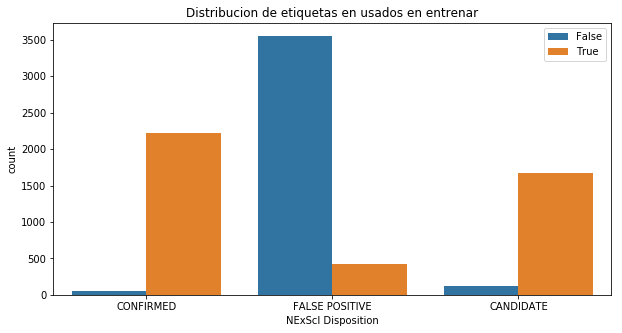

In [11]:
df_aux = pd.read_csv("../../KOI_Data/kepler_dataset.csv")

plt.figure(figsize=(10,5))
sns.countplot(df_aux["NExScI Disposition"],hue=mask_transit)
plt.title("Distribucion de etiquetas en usados en entrenar")
plt.show()

In [5]:
df_meta_transit = df_meta_obj[mask_transit]

Y_transit = Y_values[mask_transit] 

from sklearn.preprocessing import StandardScaler, RobustScaler
std_metadata = StandardScaler()
Ystd_transit = std_metadata.fit_transform(Y_transit)
Ystd_values = std_metadata.transform(Y_values)
Ystd_transit.shape

(4317, 7)

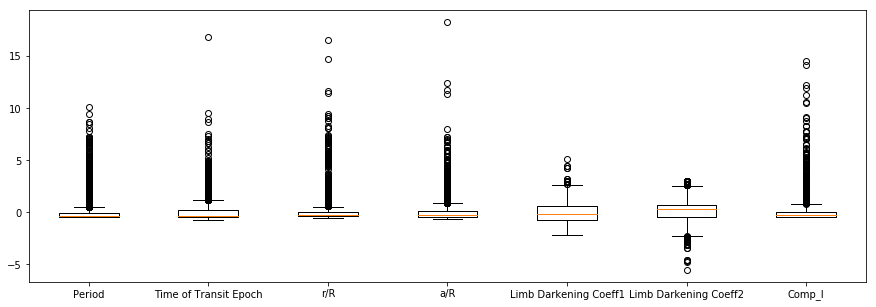

,Period,Time of Transit Epoch,r/R,a/R,Limb Darkening Coeff1,Limb Darkening Coeff2,Comp_I
count,4.317000e+03,4.317000e+03,4.317000e+03,4.317000e+03,4.317000e+03,4.317000e+03,4.317000e+03
mean,-1.221271e-15,1.357882e-16,-1.009565e-14,-1.107703e-15,-6.795666e-14,2.273342e-14,-1.759486e-15
std,1.000116e+00,1.000116e+00,1.000116e+00,1.000116e+00,1.000116e+00,1.000116e+00,1.000116e+00
min,-5.099800e-01,-7.408946e-01,-5.942639e-01,-6.773441e-01,-2.152509e+00,-5.511089e+00,-5.048422e-01
25%,-4.378714e-01,-4.702747e-01,-3.762669e-01,-4.956933e-01,-7.659136e-01,-5.118451e-01,-4.563009e-01
50%,-3.326228e-01,-3.798154e-01,-2.309356e-01,-3.150803e-01,-1.857072e-01,2.584311e-01,-3.009685e-01
75%,-5.882125e-02,1.718955e-01,-1.293854e-02,6.226389e-02,6.010135e-01,6.813278e-01,5.435417e-02
max,1.011195e+01,1.679164e+01,1.653061e+01,1.820062e+01,5.055819e+00,2.977053e+00,1.454880e+01


In [6]:
### boxplot de las variables..
aux_pl = df_meta_obj.drop(del_val, axis=1).columns
plt.figure(figsize=(15,5))
plt.boxplot(Ystd_transit)
plt.xticks(np.arange(Ystd_transit.shape[1])+1, aux_pl )
plt.show()
aux_df = pd.DataFrame(Ystd_transit)
aux_df.columns = aux_pl
aux_df.describe()

### Create dataset

#### Representación Global Folded ya está generada y guardada

In [6]:
!ls data/

LC_global_200T.npy   LC_globalA_300T.npy     Time_global_200T.npy
LC_global_300T.npy   LC_globalA_400T.npy     Time_global_300T.npy
LC_global_400T.npy   LC_globalA_500T.npy     Time_global_400T.npy
LC_global_500T.npy   LC_globalA_600T.npy     Time_global_500T.npy
LC_global_600T.npy   mask_transit_LC.npy     Time_global_600T.npy
LC_globalA_200T.npy  mask_transit_LC_v2.npy


In [7]:
T = 300 #elegir cantidad de puntos en curva de luz

In [8]:
X_fold_lc = np.load("data/LC_global_%dT.npy"%T)     # curva de luz
X_fold_lc_aug = np.load("data/LC_globalA_%dT.npy"%T)# curva de luz dada vuelta (como data augmented)
X_fold_time = np.load("data/Time_global_%dT.npy"%T) # delta de los tiempos en la representacion de la curva luz
X_fold_lc.shape

(8054, 300)

In [9]:
## NEW : set mask
X_fold_lc_tr = X_fold_lc[mask_transit]
X_fold_lc_aug_tr = X_fold_lc_aug[mask_transit]
X_fold_time_tr = X_fold_time[mask_transit]
N_trans, T = X_fold_lc_tr.shape
print(N_trans,T)

4317 300


In [10]:
## NEW : set mask
X_data_t = np.concatenate([X_fold_time_tr, X_fold_time_tr], axis=0)
X_data = np.concatenate([X_fold_lc_tr, X_fold_lc_aug_tr], axis=0)

if Ystd_transit.shape[0] != X_data.shape[0]:
    Ystd_transit = np.tile(Ystd_transit, (2,1)) #utilizando data augmentation
    Y_transit = np.tile(Y_transit, (2,1)) #utilizando data augmentation

X_data_t = np.expand_dims(X_data_t, axis=-1)
X_data = np.expand_dims(X_data, axis=-1)

print("X train shape: ",X_data.shape)
print("X train time shape: ",X_data_t.shape)
print("Y train shape: ",Ystd_transit.shape)

X train shape:  (8634, 300, 1)
X train time shape:  (8634, 300, 1)
Y train shape:  (8634, 7)


### Escalar

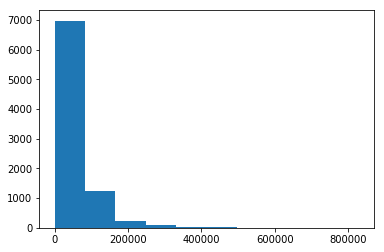

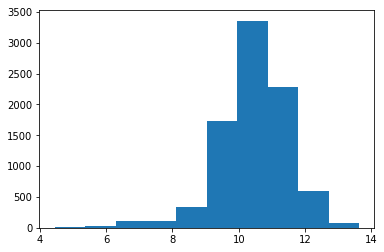

In [11]:
from sklearn.metrics import mean_squared_error

Sinv_data = 1/np.std(X_data, axis=1)

Sinv_mu = np.mean(Sinv_data)
Sinv_std = np.std(Sinv_data) 

plt.hist(Sinv_data)
plt.show()
plt.hist(np.log(Sinv_data))
plt.show()

In [11]:
np.mean(np.mean(X_data, axis=1))

-8.436668340988758e-06

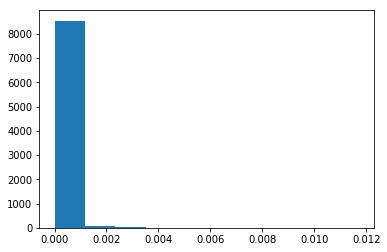

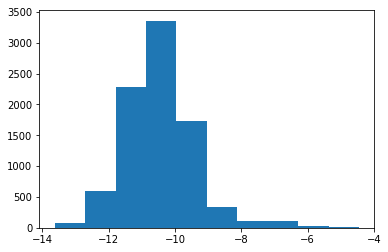

In [11]:
from sklearn.metrics import mean_squared_error

S_data = np.std(X_data, axis=1)
trainingWeights = 1/(S_data**2)

S_mu = np.mean(S_data)
S_std = np.std(S_data) 

plt.hist(S_data)
plt.show()
plt.hist(np.log(S_data))
plt.show()

### Keras models

In [17]:
from keras import backend as K
from keras.models import Sequential, Model
from keras.layers import *

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot

from autoencoder_utils import Recon_eval
Evaluate = Recon_eval()

def evaluate_reconst(x,xhat):
    print("----- EVALUANDO RECONSTRUCCION DE LA CURVA -----")
    res = Evaluate.get_res(x, xhat)
    plt.figure(figsize=(10,4))
    sns.distplot(res.flatten())
    plt.title("Distribucion de residuos promedio")
    plt.show()
    
    print("------------- Error -------------")
    #print("MSE      = ",Evaluate.MSE_LC(None,None, res))
    print("RMSE (+-) = ",Evaluate.RMSE_LC(None,None, res))
    print("MAE  (+-) = ",Evaluate.MAE_LC(None,None, res))
    
    print("------------- Smoothness -------------")
    xhat = np.squeeze(xhat)
    A = np.mean(np.apply_along_axis(Evaluate.autocorr_func, 1, xhat)[:,1])
    print("AutoCorr lag-one = ",A)
    M = np.mean(np.apply_along_axis(Evaluate.mean_diff, 1, xhat))
    print("Diff MEAN = ",M)
    #S = np.mean(np.apply_along_axis(Evaluate.std_diff, 1, xhat))
    #print("Diff STD = ",S)
    
    print("------------- Residual -------------")
    res = np.squeeze(res)
    R = np.mean(np.apply_along_axis(Evaluate.autocorr_func, 1, res)[:,1])
    print("AutoCorr lag-one = ",R)
    perm = np.mean(np.apply_along_axis(Evaluate.series_entropy, 1, res, which='perm'))
    print("Permutation H = ",perm)
    spec = np.mean(np.apply_along_axis(Evaluate.series_entropy, 1, res, which='spec'))
    print("Spectral H = ",spec)
    print("---------------------------------------")
    

def plot_n_lc(real_lc, decoded_lc, n = 10, s=None):
    for _ in range(n):
        n_sampled = np.random.randint(0, real_lc.shape[0])
        real_lc_n = np.squeeze(real_lc[n_sampled])
        decoded_lc_n = np.squeeze(decoded_lc[n_sampled])
        
        if s !=None:
            print("Real scale = %f\nPred scale = %f"%(s[0][n_sampled], s[1][n_sampled] ))
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True,figsize= (15,5))
        ax1.plot(real_lc_n, 'b.-')
        ax1.set_title("Real")
        ax2.plot(decoded_lc_n, 'b.-')
        ax2.set_title("Reconstructed")
        ax3.plot(real_lc_n-decoded_lc_n, 'b.-')
        ax3.set_title("Residuo")
        plt.show()  

        plt.figure(figsize=(15,5))
        plt.plot(real_lc_n, 'bo-', label="Real")
        plt.plot(decoded_lc_n, 'g*-', label="Reconstructed")
        plt.title("Over")
        plt.legend()
        plt.show()
        print("----------------------------------------------------------------")

In [13]:
l = 0.001

batch_size = 128

latent_dim = 32

_, T, channels = X_data.shape
D_dim = Ystd_transit.shape[1] #cantidad de valores en representacion condicional

In [14]:
from autoencoder_utils import define_samp_model

def KL_loss(z_mean,z_log_var):
    #the mean and log-var of the latent distribution
    def KL(y_true, y_pred):
        return - 0.5 * K.sum(1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)
    return KL

def SMSE_loss(s_lc):
    #s is the scale of the data = std
    def SMSE(y_true, y_pred):
        mse_LC = K.mean( K.square( y_true - y_pred ), axis=1) #on time axis..    
        mse_LC = K.flatten(mse_LC)
        weights = 1/K.square(s_lc)[:,0]
        return mse_LC * weights #both values has to be on same shape
    return SMSE

def Norm_L(x,mu,std):
    x = K.log(x+1) #para normalizar un poco valores gigantes
    return Norm(x,mu,std)

def Norm(x,mu,std):
    return (x - mu)/std

def RevertNorm(x,mu,std):
    return std*x + mu

Ylog_mu = np.mean(np.log(Y_values+1))
Ylog_std = np.std(np.log(Y_values+1))

Ylog_mu

1.7384663501762565

In [ ]:
### revisar los boxplot de Y_values con logaritmos normal y con el +1

In [81]:
S_xp = np.clip(np.std(X_MA, axis=-1), 1e-7,np.inf)
S_x = S_data[:N_trans,0]
print("STD data ",S_x)
print("STD M-A ",S_xp)

### MSE al predecir escala
np.mean(np.square(S_xp - S_x))/np.var(S_x)

STD data  [1.21605725e-03 4.48377393e-05 1.17450224e-05 ... 6.44146925e-05
 2.30685257e-05 6.61046365e-05]
STD M-A  [4.29590726e-06 2.90861753e-05 1.68878145e-05 ... 2.22425314e-05
 1.16189403e-05 2.76054082e-05]


3.2879260326359145

In [78]:
### MSE al generar
np.mean(np.square(X_data[:N_trans,:,0]*(S_x/S_xp - 1)[:,None]))

0.018717716975006085

# Conditional VAE 
* https://github.com/nnormandin/Conditional_VAE
* https://wiseodd.github.io/techblog/2016/12/17/conditional-vae/
* Aumentar peso de KL... para que sample sirva
* Sacar metadata de encoder

### X_g = (X - mean(X_mean))/mean(S) 
Para que inputs esten escalados sobre los pesos de las red neuronal
modelo reconstruye X_g, luego yo invierto transformación y dejo X

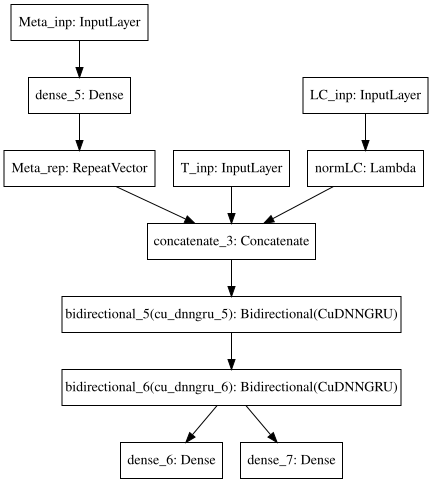

In [18]:
##### INPUTS ENCODER ######
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")
s_lc = Input(shape= (1,), name="scale_inp") #para pesar loss
y_lc = Input(shape = (D_dim,) , name ="Meta_inp")

x_lc_s = Lambda(Norm, arguments={'mu':0,'std':S_mu}, name="normLC")(x_lc) 

##### CODIFY  METADATA ######
y_rep = Dense(10, activation='tanh')(y_lc)
y_rept = RepeatVector(T, name="Meta_rep")(y_rep)

##### CONCATENATE TIME + LC + METADATA-> CODIFY ######
x = Concatenate(axis=-1)([x_t, x_lc_s, y_rept]) #has to be concatenate on axis -1
f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

##### CGET THE LATENT VARIABLE ######
z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc, y_lc], [z_mean,z_log_var], name="encoder")
samp_model = define_samp_model(latent_dim) #model to sample

##### INPUTS DECODER ######
decoder_input = Input(shape=(latent_dim,), name="latent_inp")
decoder_inp_rep = RepeatVector(T, name="Enc_rep")(decoder_input)

##### CONCATENATE TIME + LATENT VARIABLE + CONDITIONAL -> DECODIFY LIGHT CURVE ######
decode = Concatenate(axis=-1)([x_t, decoder_inp_rep, y_rept]) #add time and metadata to decode
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
#decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

#####  RECONSTRUCT LIGHT CURVE BY SCALE  ######
decode = TimeDistributed(Dense(1, activation='linear'))(decode)
decode = Lambda(RevertNorm, arguments={'mu':0,'std':S_mu},name="revnormLC")(decode) #NEW: volver a escala normal 
generator = Model([x_t, decoder_input, y_lc], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_model(encoder([x_t, x_lc, y_lc])), y_lc ])
Cvae = Model([x_t, x_lc, y_lc, s_lc], out)

#define loss functions over model components
smse_LC = SMSE_loss(s_lc)
#mse_LC = MSE_loss
kl_loss = KL_loss(z_mean, z_log_var)

def Wvae_loss(y_true, y_pred):    
    return smse_LC(y_true, y_pred) + l*kl_loss(y_true, y_pred)
Cvae.compile(optimizer='adam', loss=Wvae_loss, metrics = [smse_LC, kl_loss])

Cvae.get_layer("encoder").load_weights("./models/C-VAEscaleV2_MA5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").load_weights("./models/C-VAEscaleV2_MA5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

SVG(model_to_dot(Cvae.get_layer("encoder")).create(prog='dot', format='svg'))

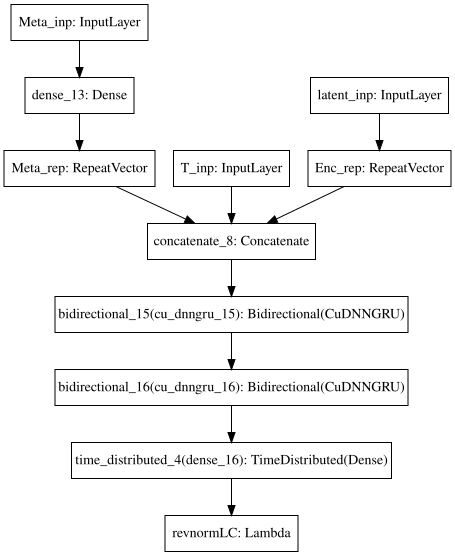

In [32]:
SVG(model_to_dot(Cvae.get_layer("generator")).create(prog='dot', format='svg'))

seria necesario hacer un esquema o dibujo para entender.. la metadata se repite por cada instante de tiempo para hacer las codificaciones y reconstrucciones necesarias.. (le da la información de la metadata a cada instante..)

In [33]:
Cvae.fit([X_data_t, X_data, Ystd_transit, S_data], X_data, epochs=400, batch_size=batch_size)

Epoch 1/400
8634/8634 [==============================] - 22s 3ms/step - loss: 3.2323 - SMSE: 3.2314 - KL: 0.9023
Epoch 2/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.3458 - SMSE: 1.3445 - KL: 1.2514
Epoch 3/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.1984 - SMSE: 1.1969 - KL: 1.5205
Epoch 4/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.1485 - SMSE: 1.1466 - KL: 1.9404
Epoch 5/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0874 - SMSE: 1.0848 - KL: 2.6795
Epoch 6/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0411 - SMSE: 1.0375 - KL: 3.6068
Epoch 7/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0446 - SMSE: 1.0402 - KL: 4.3543
Epoch 8/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0544 - SMSE: 1.0491 - KL: 5.3041
Epoch 9/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0309 - SMSE: 1.0

8634/8634 [==============================] - 18s 2ms/step - loss: 1.0029 - SMSE: 1.0028 - KL: 0.1331
Epoch 144/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0033 - SMSE: 1.0031 - KL: 0.1605
Epoch 145/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0031 - SMSE: 1.0029 - KL: 0.2255
Epoch 146/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0037 - SMSE: 1.0033 - KL: 0.3557
Epoch 147/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0028 - SMSE: 1.0027 - KL: 0.0842
Epoch 148/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0026 - SMSE: 1.0025 - KL: 0.0937
Epoch 149/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0029 - SMSE: 1.0028 - KL: 0.0883
Epoch 150/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0027 - SMSE: 1.0026 - KL: 0.0886
Epoch 151/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0028 - SMSE:

8634/8634 [==============================] - 18s 2ms/step - loss: 0.7611 - SMSE: 0.7494 - KL: 11.7346
Epoch 285/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7817 - SMSE: 0.7704 - KL: 11.2887
Epoch 286/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7616 - SMSE: 0.7493 - KL: 12.3153
Epoch 287/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7615 - SMSE: 0.7494 - KL: 12.1276
Epoch 288/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7472 - SMSE: 0.7348 - KL: 12.3849
Epoch 289/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7607 - SMSE: 0.7489 - KL: 11.7371
Epoch 290/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7548 - SMSE: 0.7427 - KL: 12.1700
Epoch 291/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7578 - SMSE: 0.7458 - KL: 11.9799
Epoch 292/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7573

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


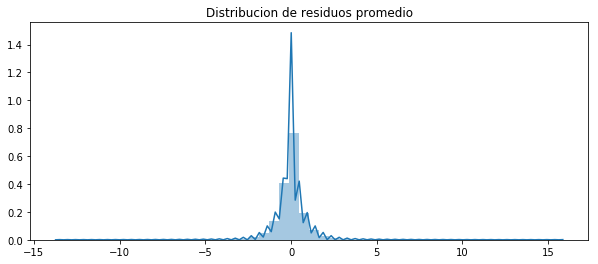

------------- Error -------------
RMSE (+-) =  0.7580391761203119
MAE  (+-) =  0.5020756846869628
------------- Smoothness -------------
AutoCorr lag-one =  0.8057174474024112
Diff MEAN =  0.0440233157600628
------------- Residual -------------
AutoCorr lag-one =  0.012961920210266141
Permutation H =  0.995707373560081
Spectral H =  0.8927296318221208
---------------------------------------


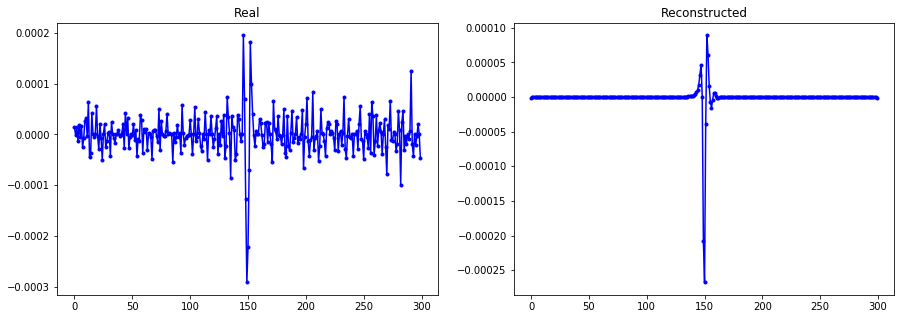

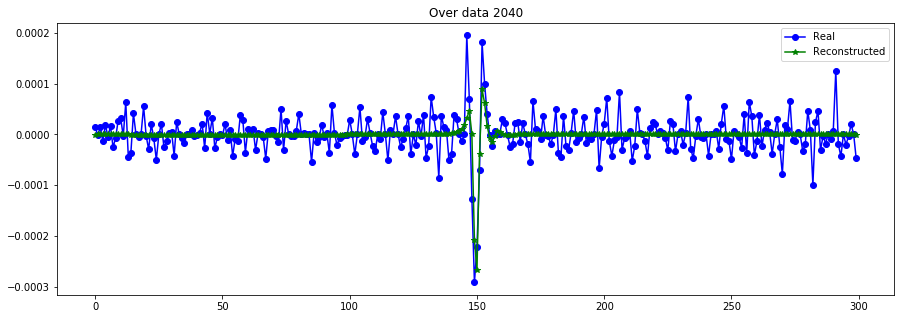

----------------------------------------------------------------


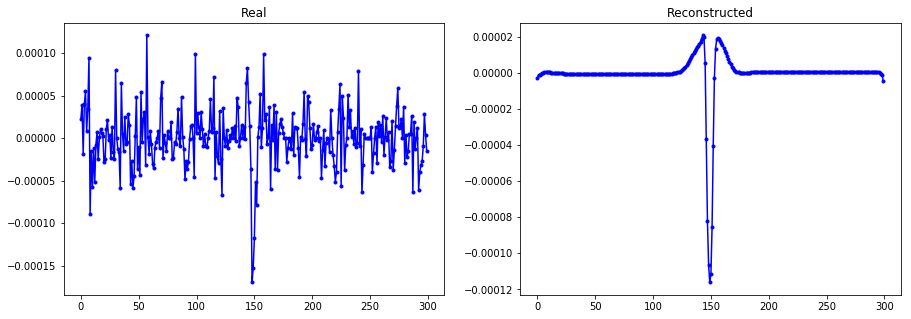

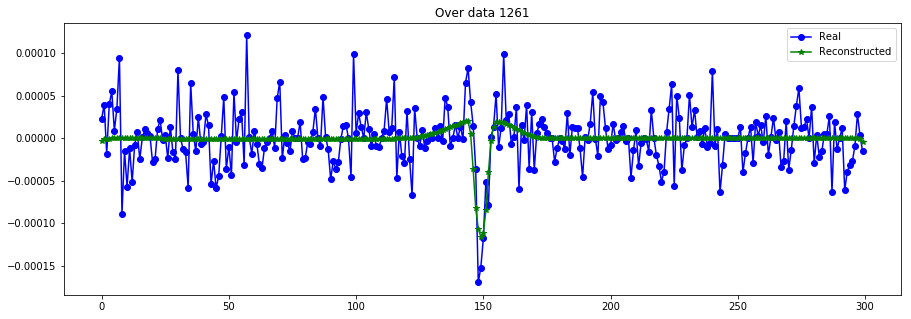

----------------------------------------------------------------


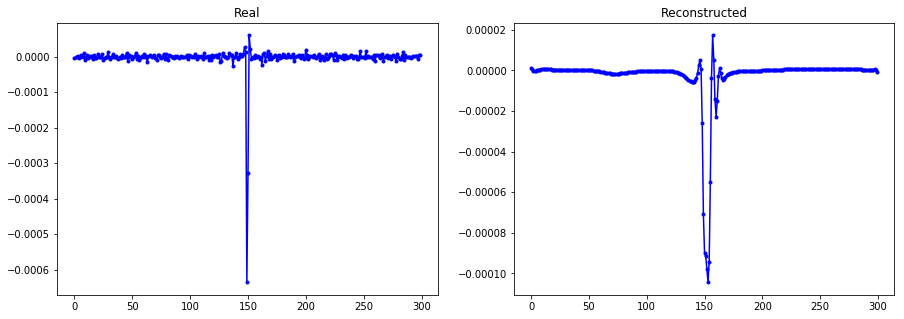

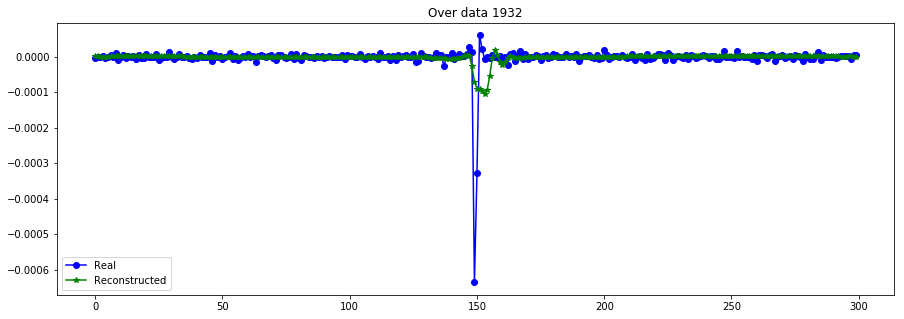

----------------------------------------------------------------


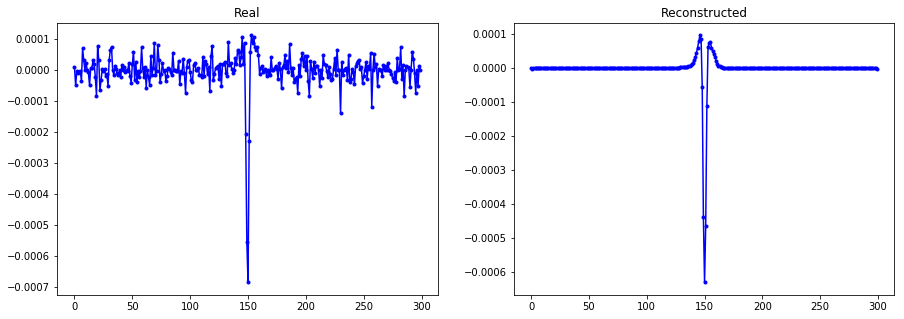

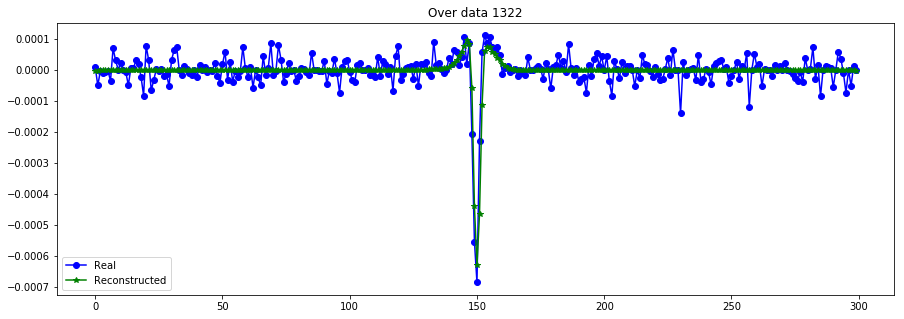

----------------------------------------------------------------


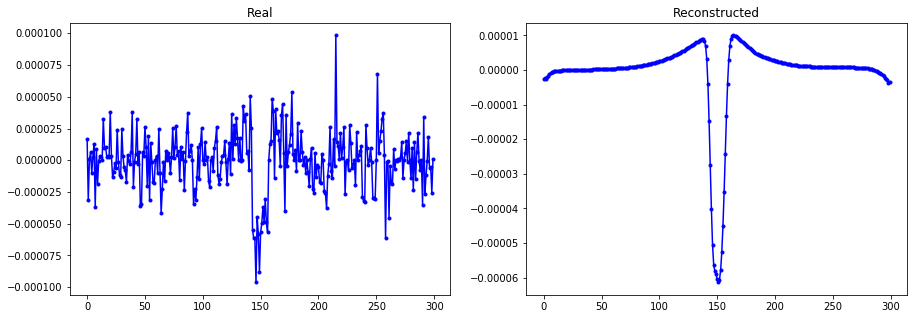

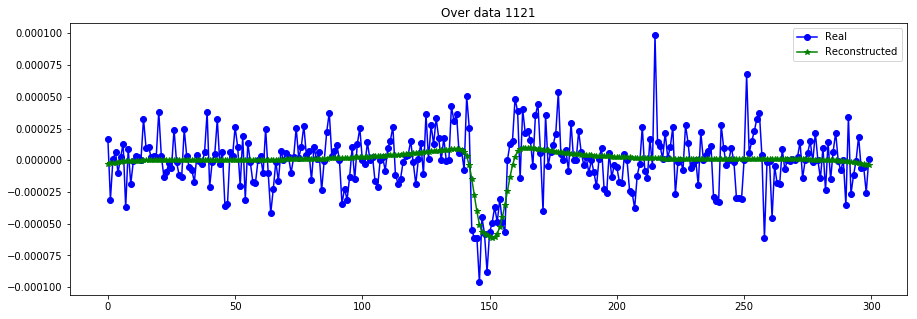

----------------------------------------------------------------


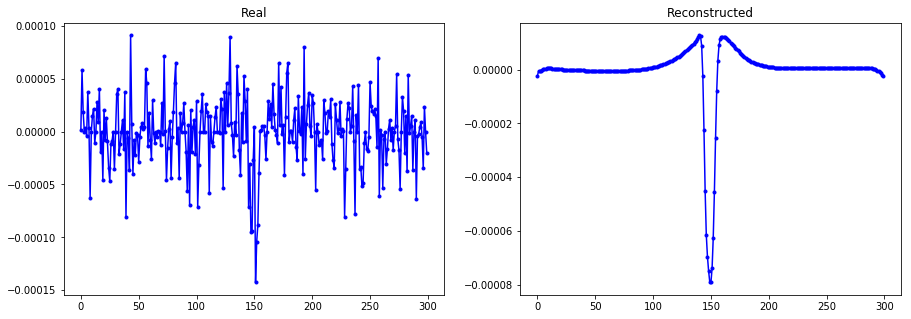

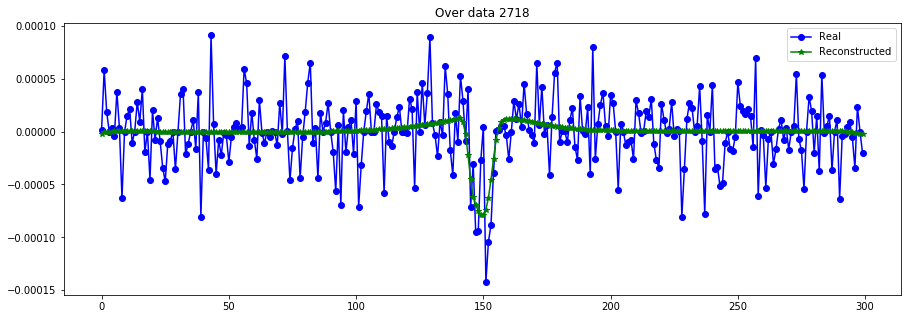

----------------------------------------------------------------


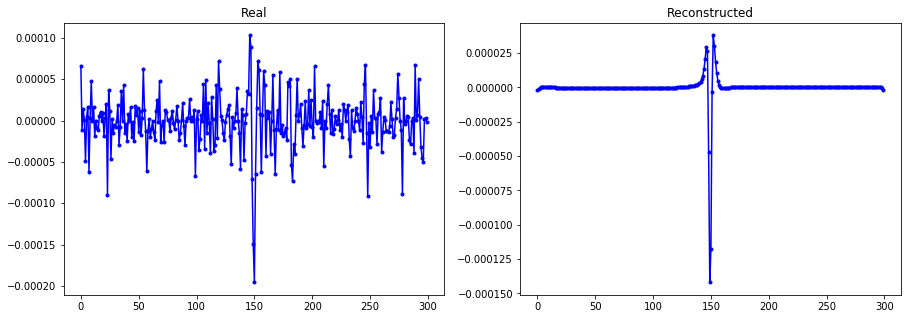

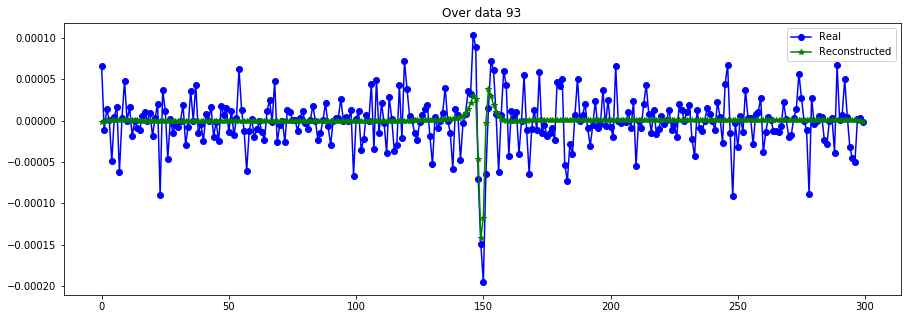

----------------------------------------------------------------


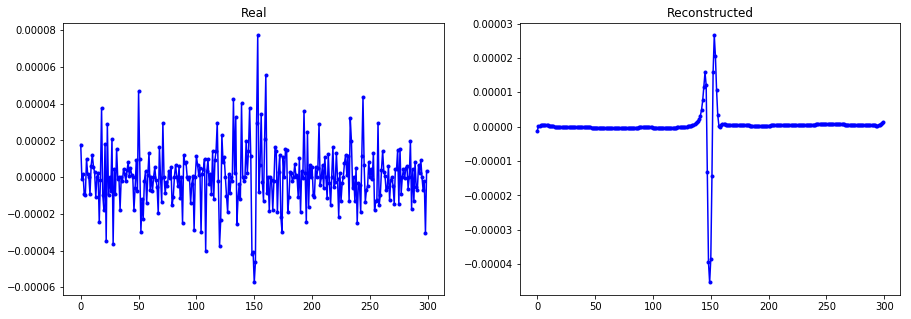

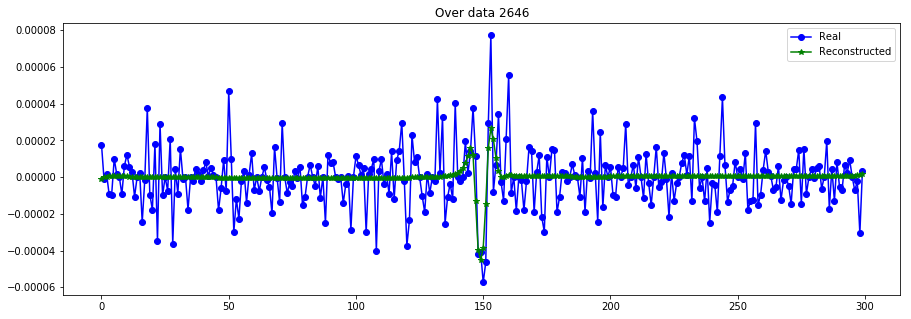

----------------------------------------------------------------


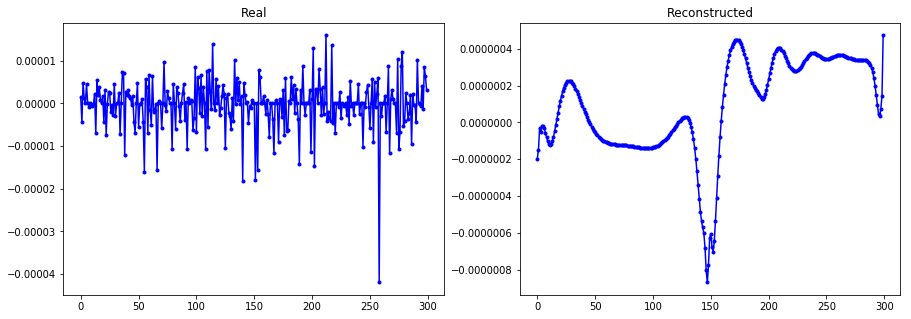

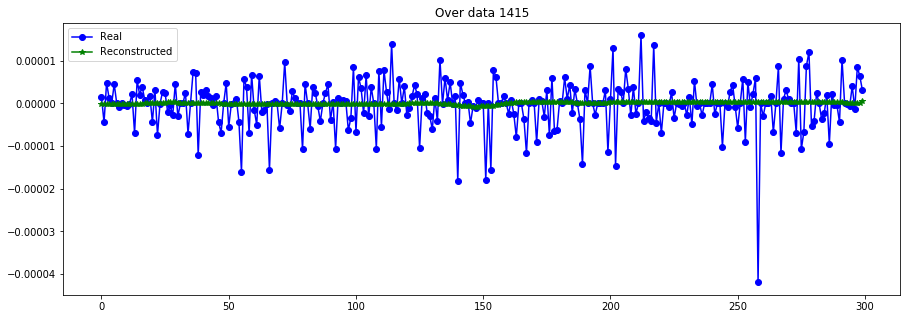

----------------------------------------------------------------


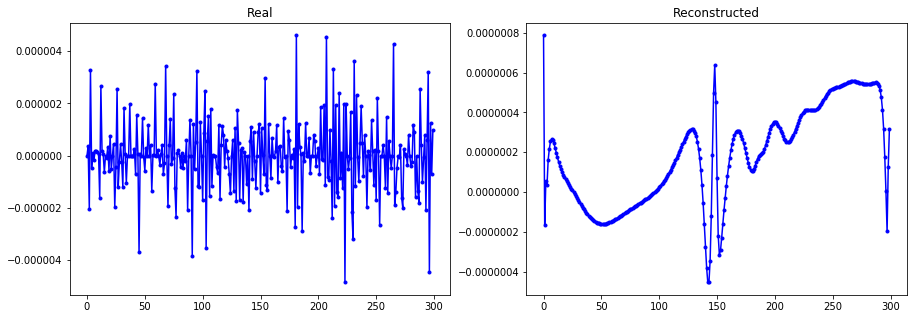

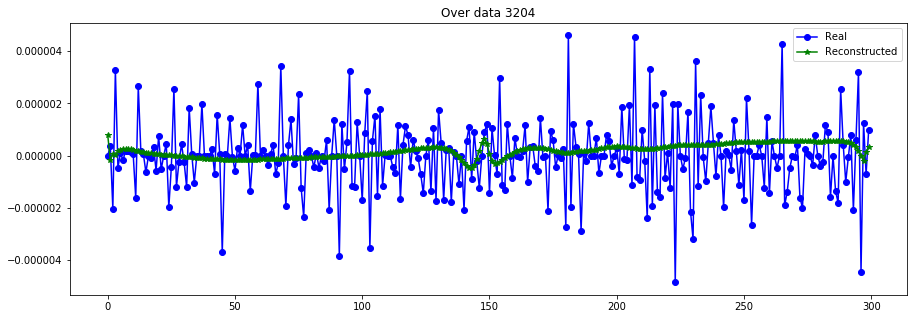

----------------------------------------------------------------


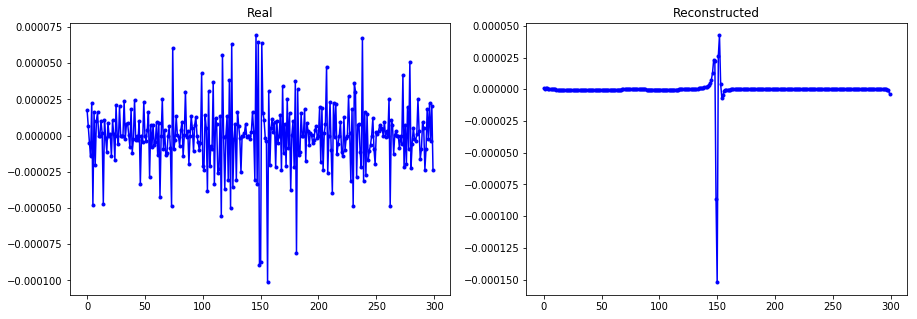

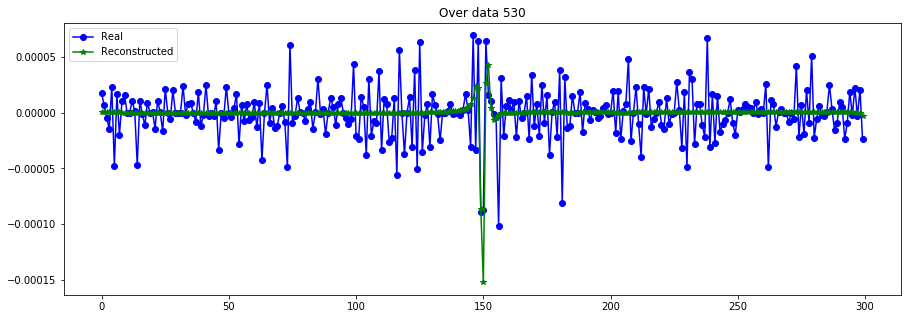

----------------------------------------------------------------


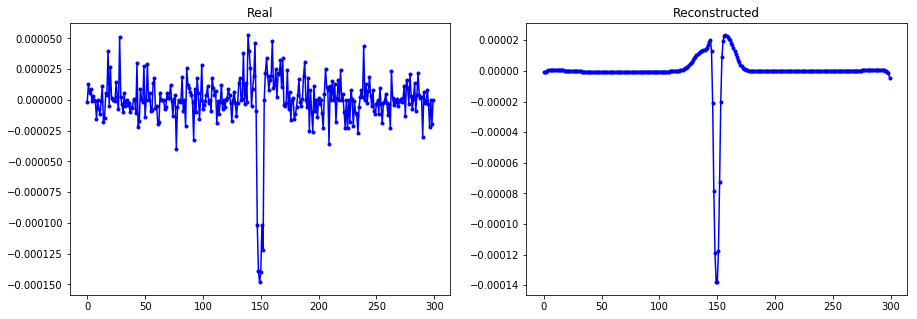

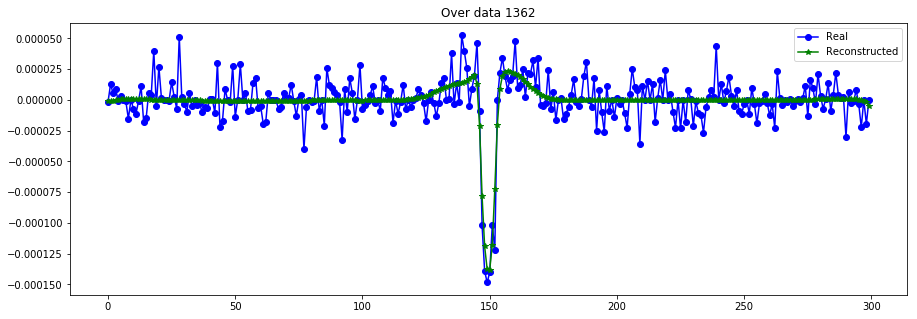

----------------------------------------------------------------


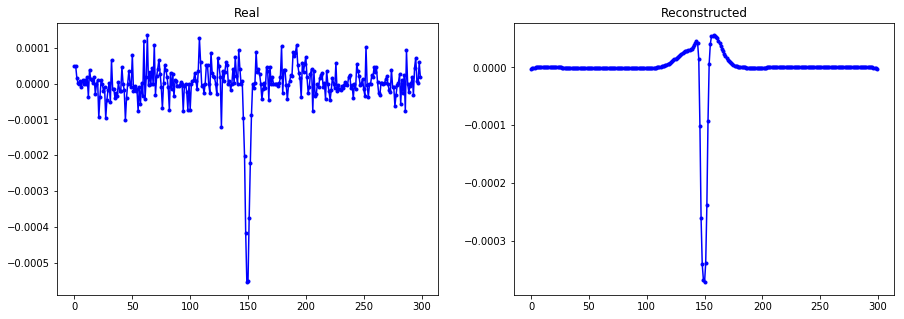

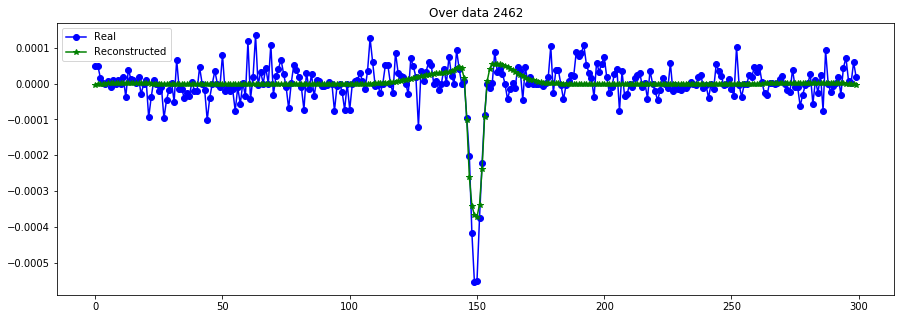

----------------------------------------------------------------


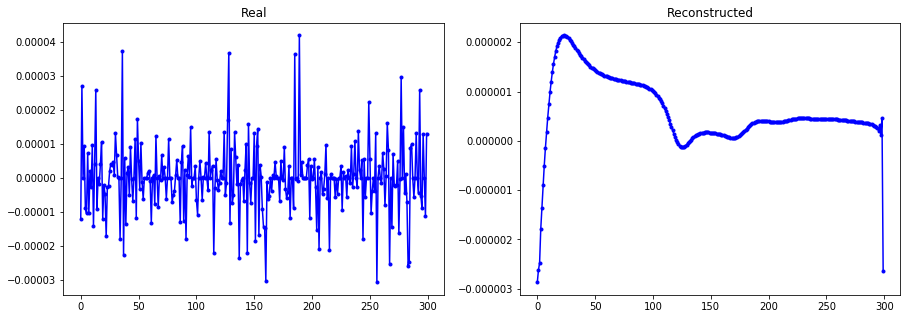

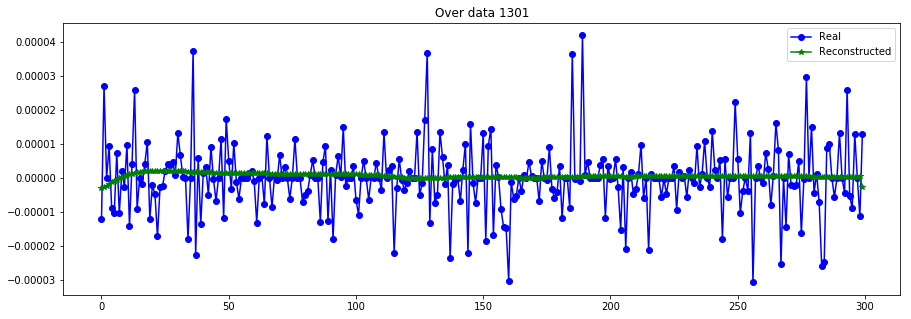

----------------------------------------------------------------


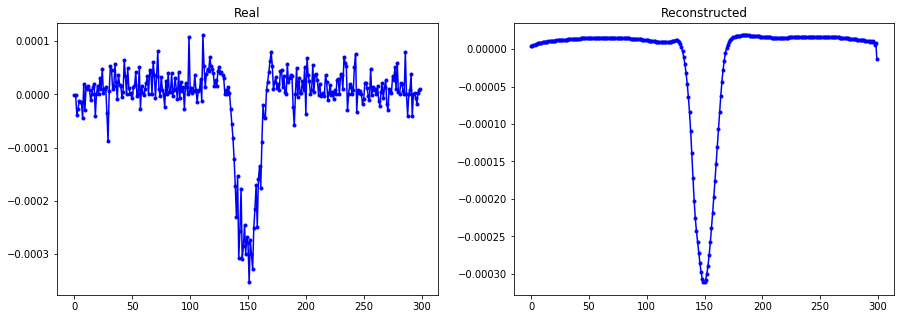

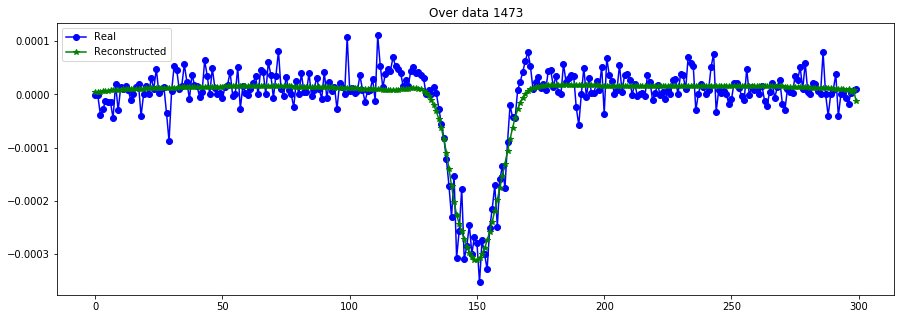

----------------------------------------------------------------


In [19]:
X_data_hat = Cvae.predict([X_data_t[:N_trans], X_data[:N_trans], Ystd_transit[:N_trans], S_data[:N_trans]], batch_size=512)
evaluate_reconst(X_data[:N_trans]/S_data[:N_trans,None,:], X_data_hat/S_data[:N_trans,None,:])

plot_n_lc(X_data[:N_trans,:,0], X_data_hat, n= 15)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


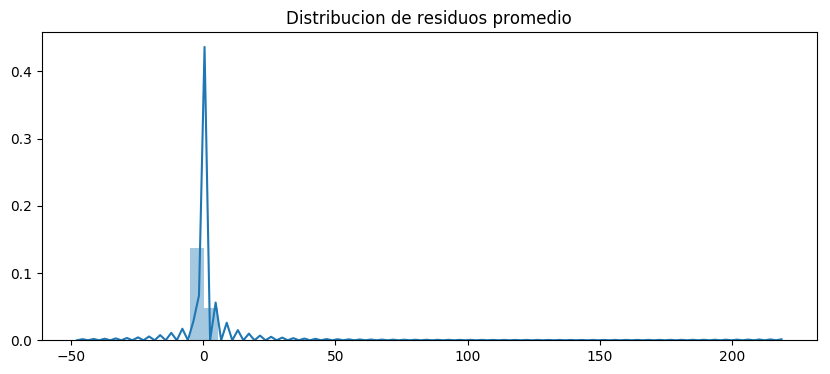

------------- Error -------------
RMSE (+-) =  1.361025853020764
MAE  (+-) =  0.6546460385286539
------------- Smoothness -------------
AutoCorr lag-one =  0.7920587541166784
Diff MEAN =  0.09281371318221145
------------- Residual -------------
AutoCorr lag-one =  0.3170994668064512
Permutation H =  0.9955184298299223
Spectral H =  0.8429050318095481
---------------------------------------


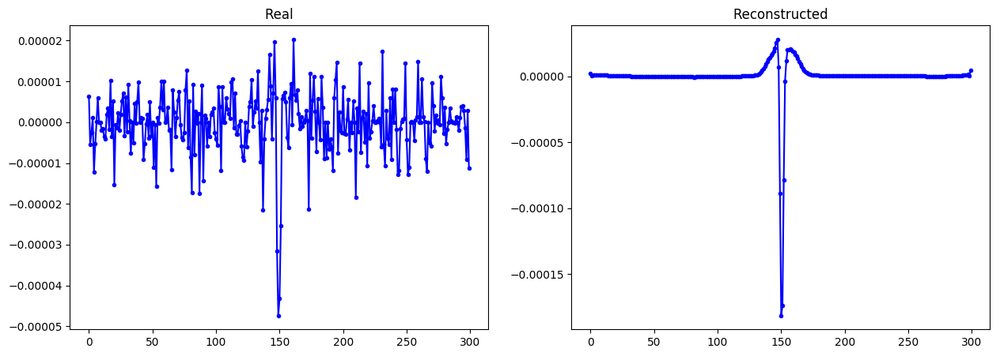

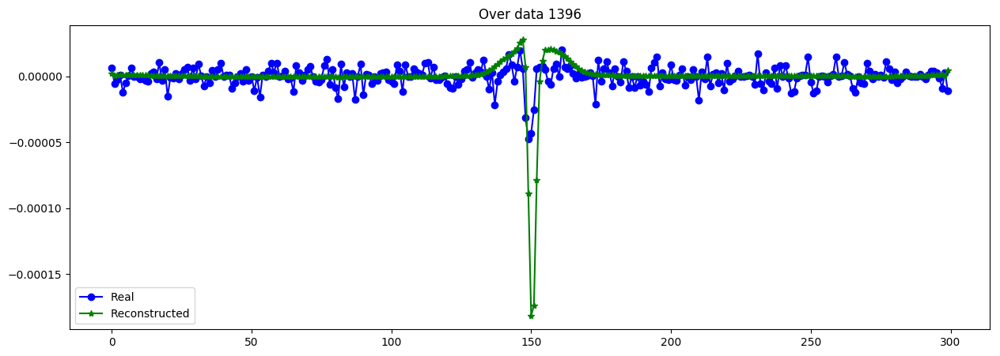

----------------------------------------------------------------


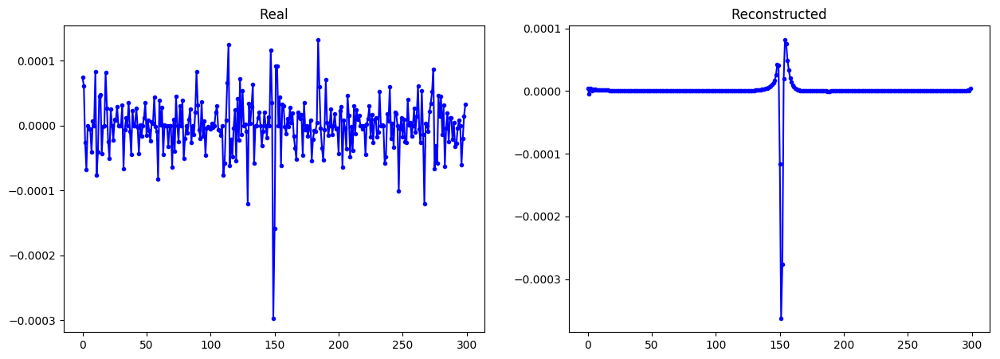

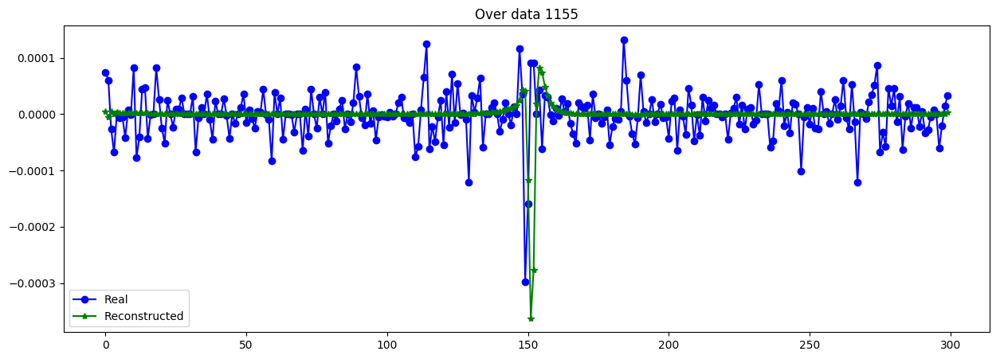

----------------------------------------------------------------


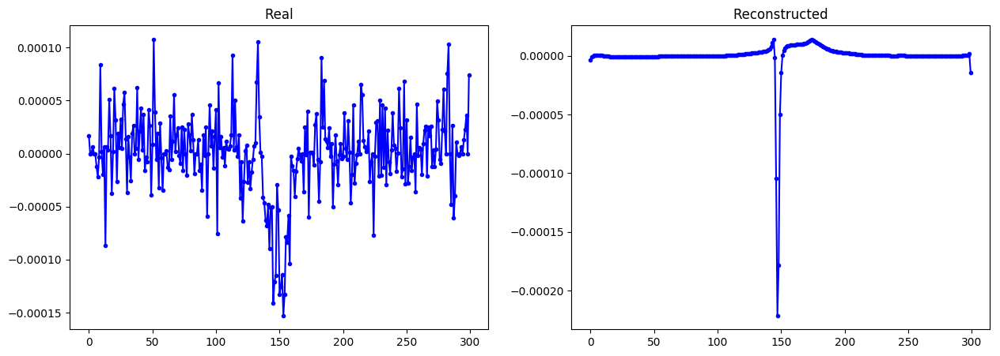

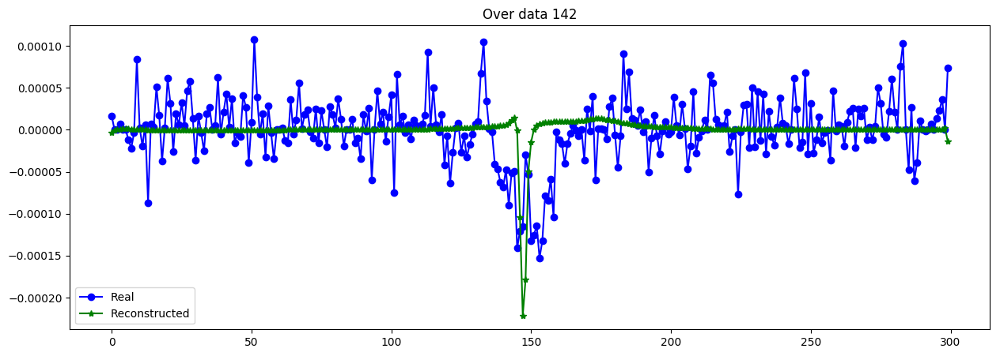

----------------------------------------------------------------


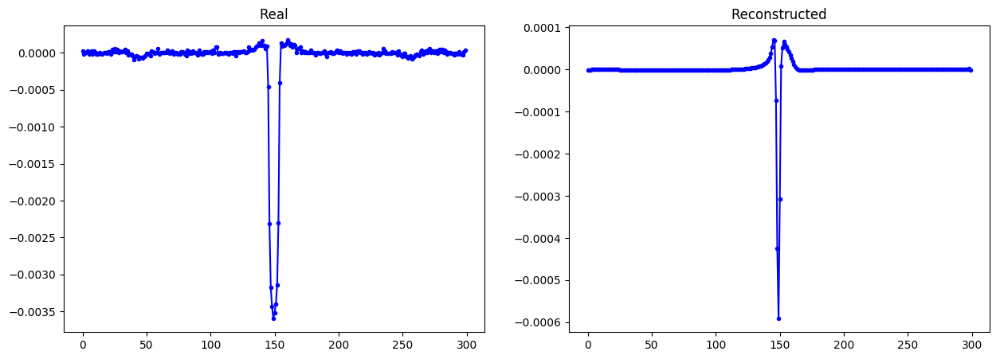

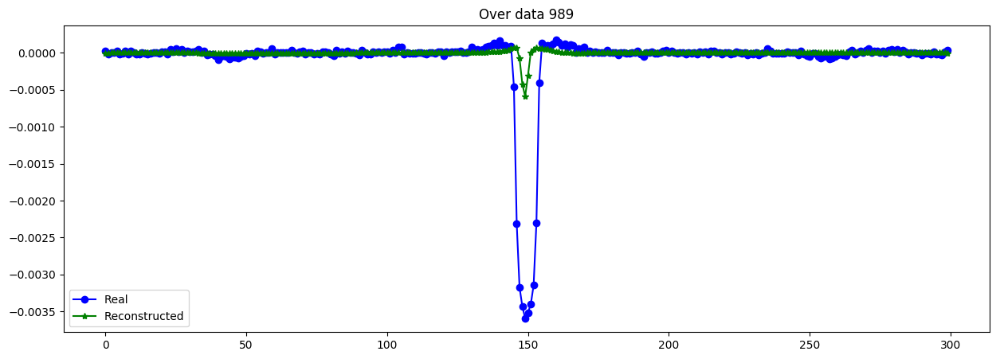

----------------------------------------------------------------


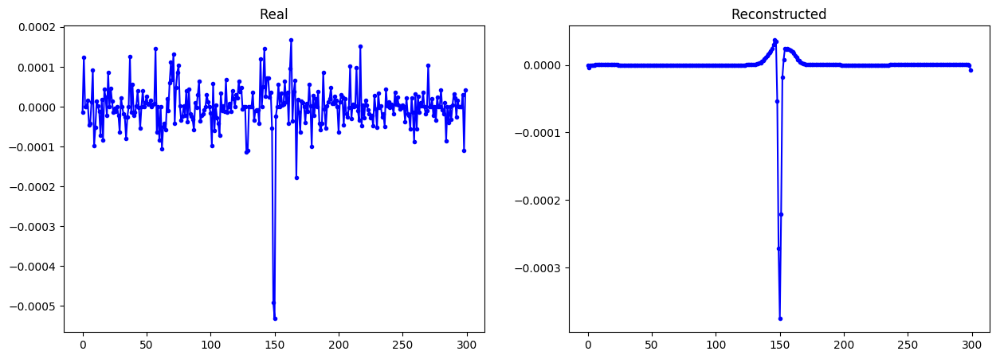

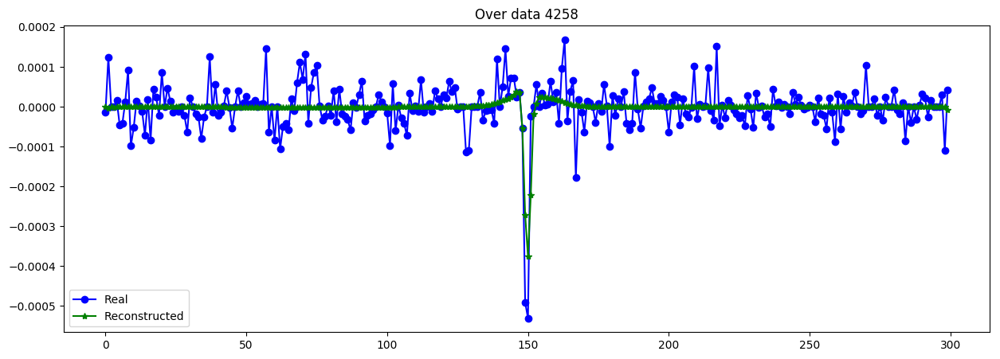

----------------------------------------------------------------


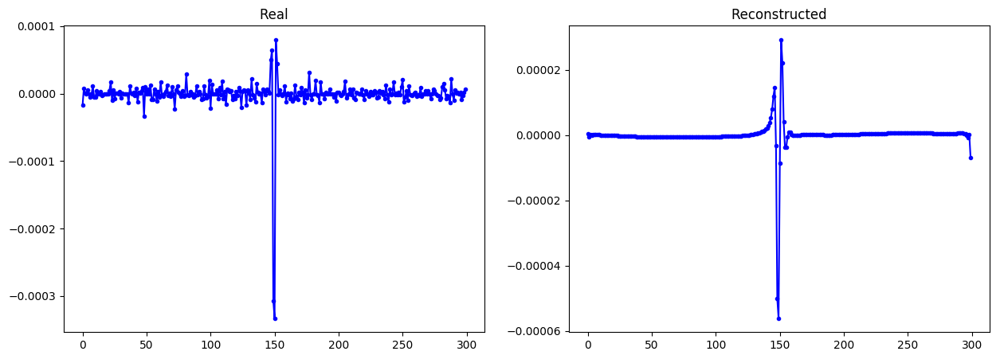

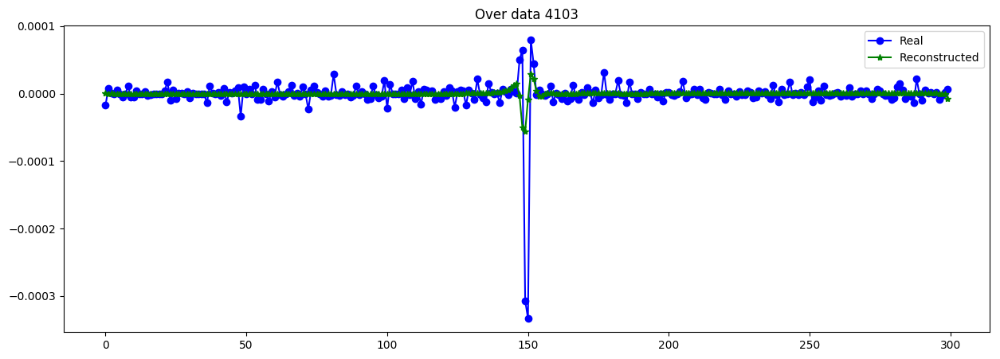

----------------------------------------------------------------


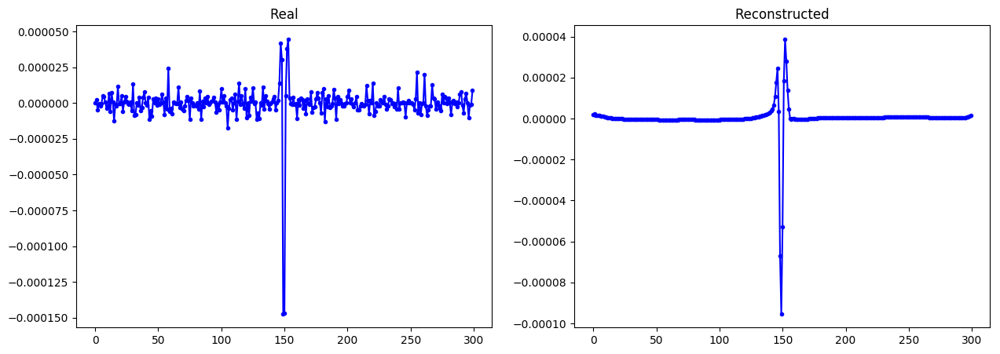

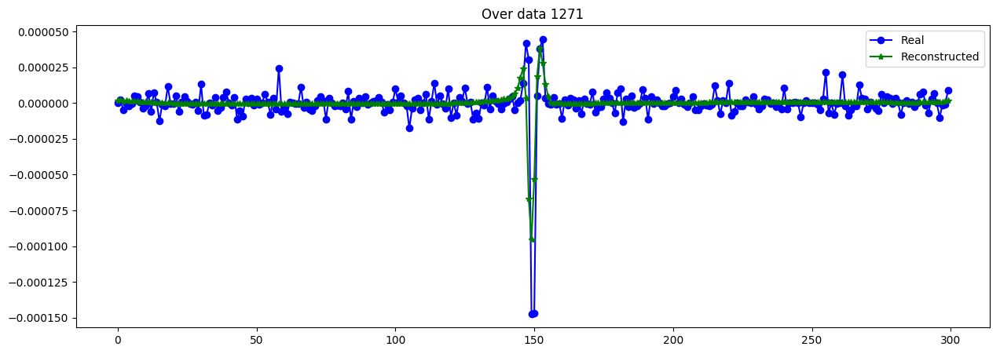

----------------------------------------------------------------


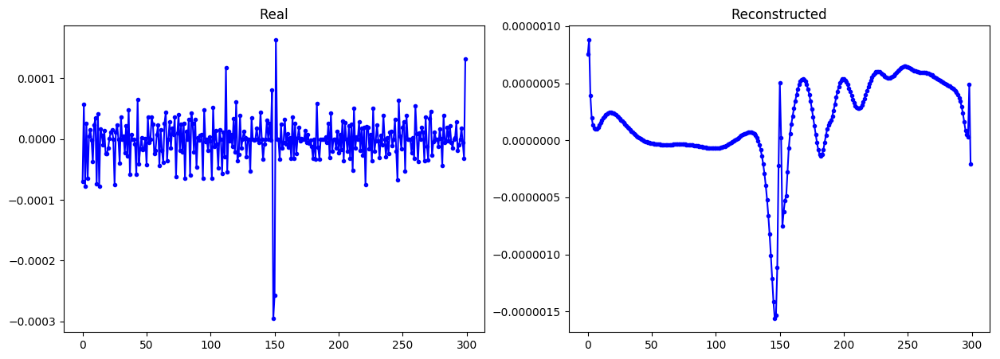

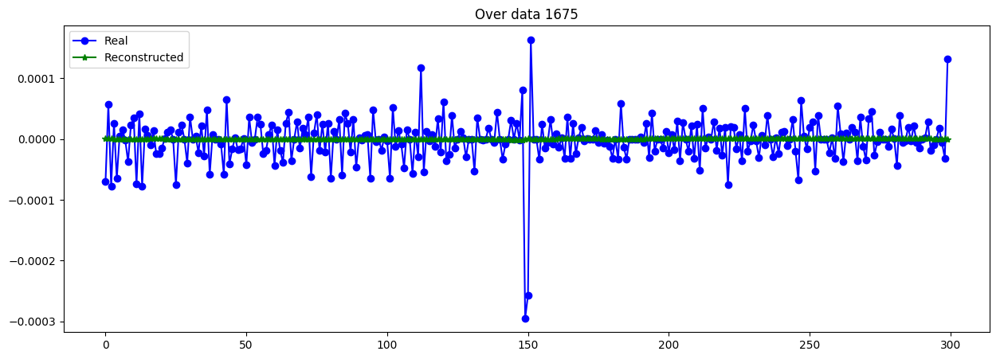

----------------------------------------------------------------


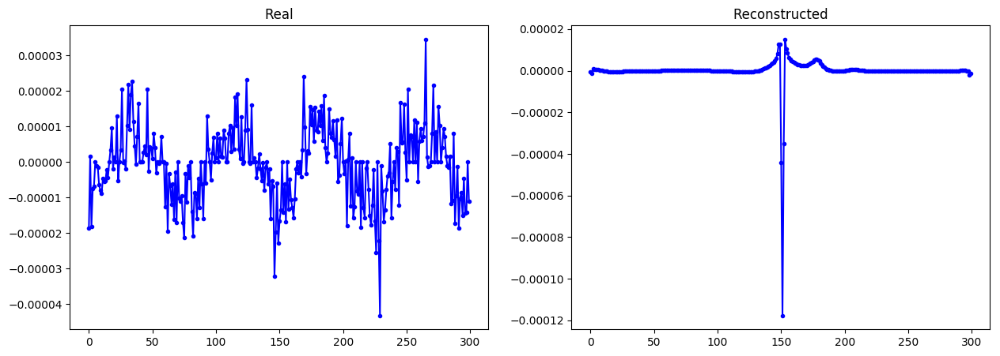

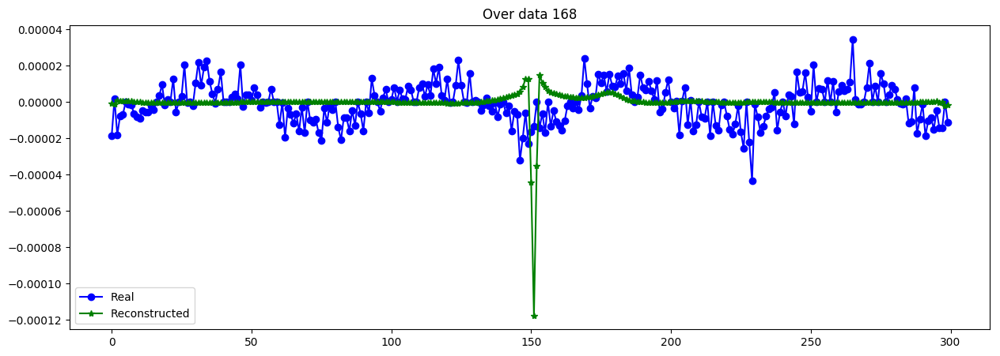

----------------------------------------------------------------


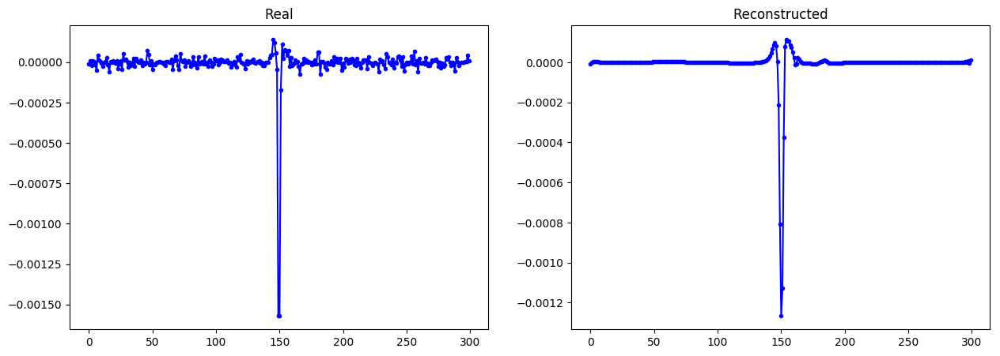

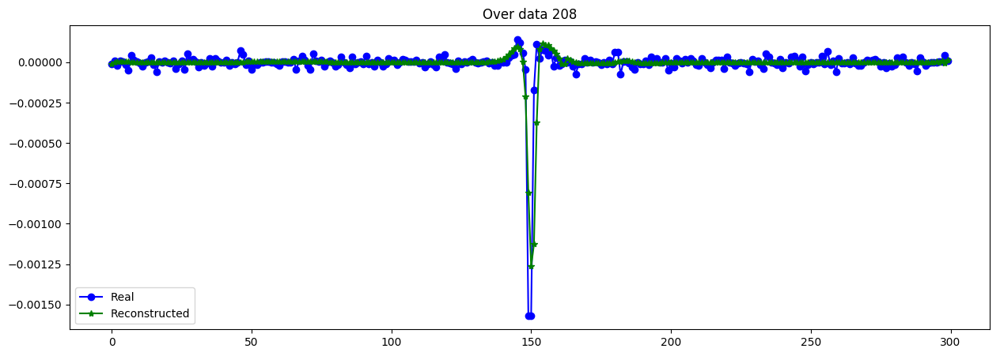

----------------------------------------------------------------


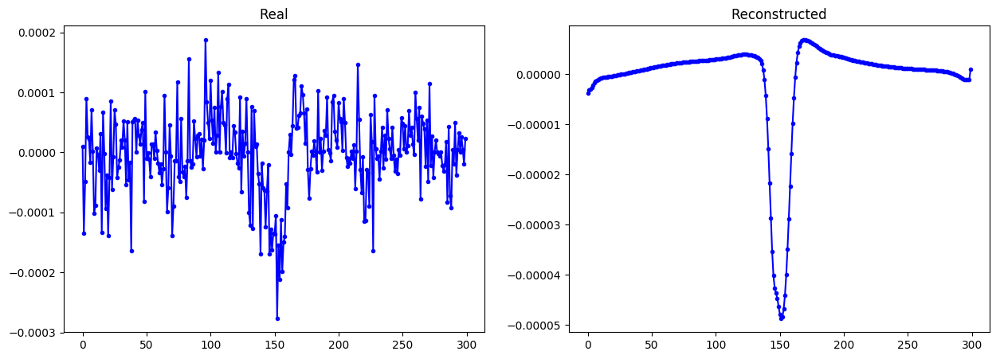

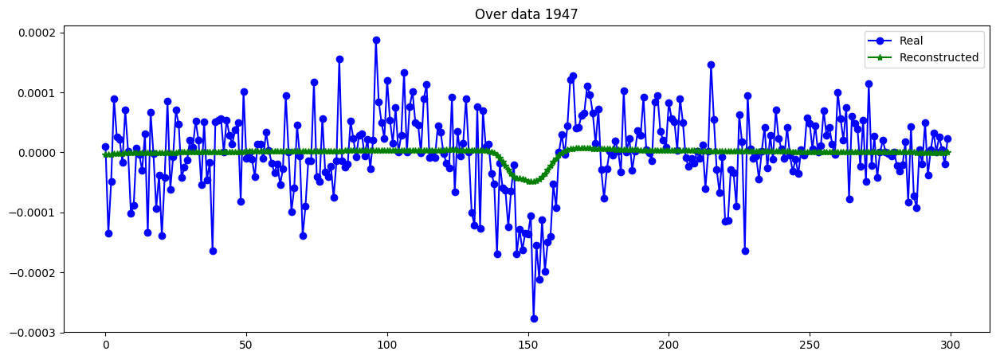

----------------------------------------------------------------


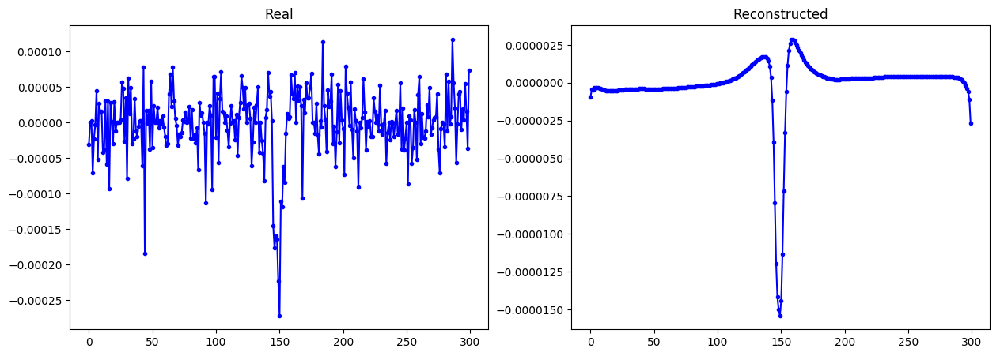

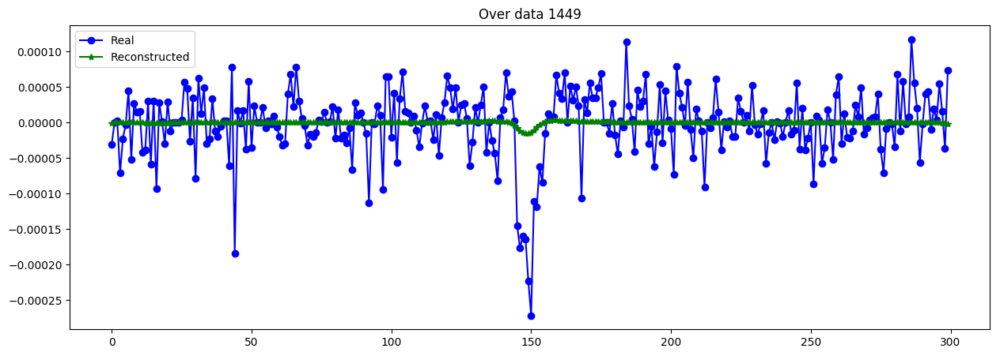

----------------------------------------------------------------


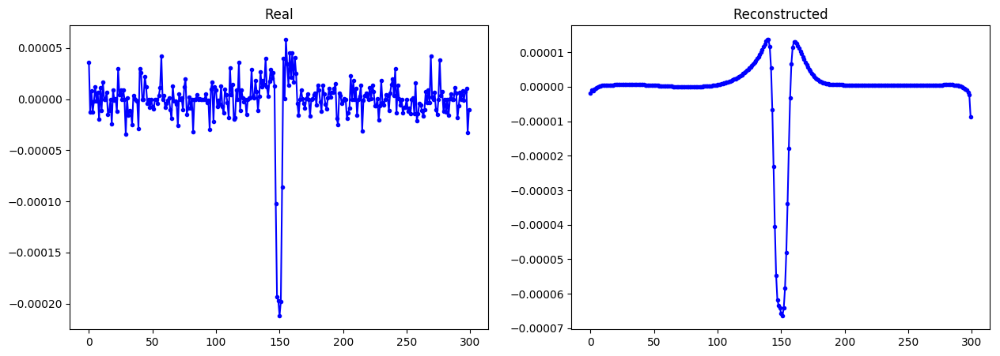

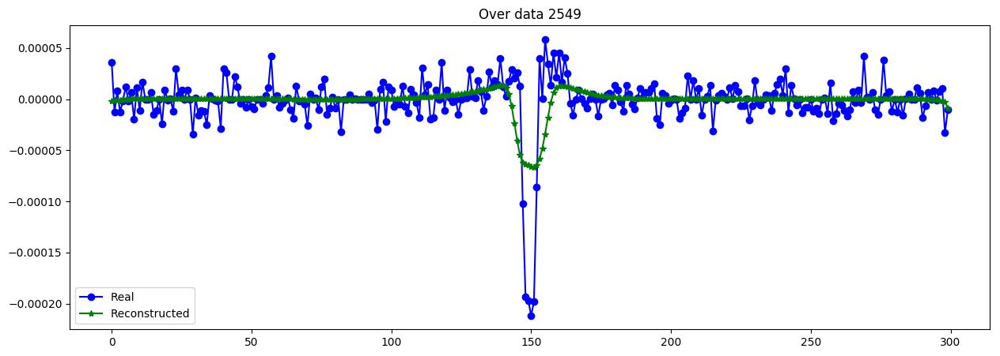

----------------------------------------------------------------


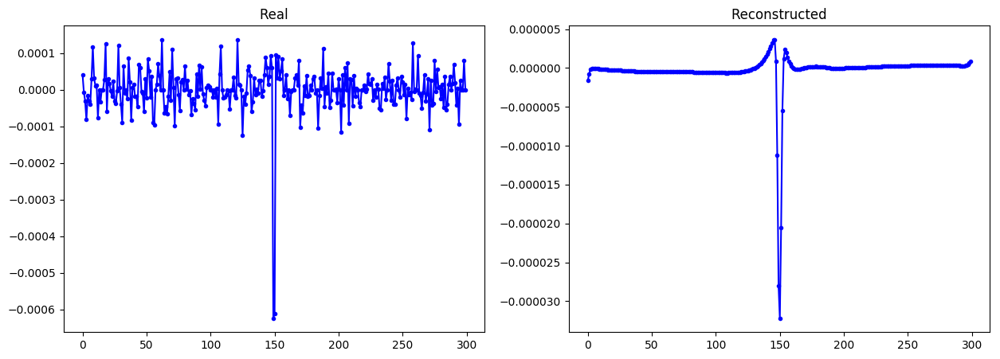

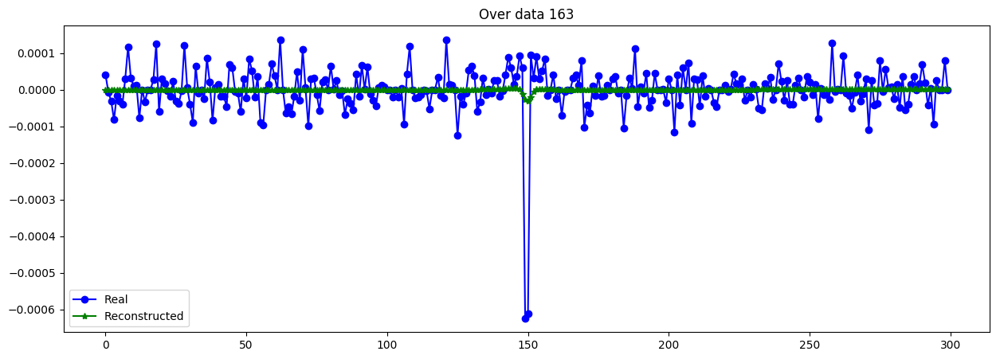

----------------------------------------------------------------


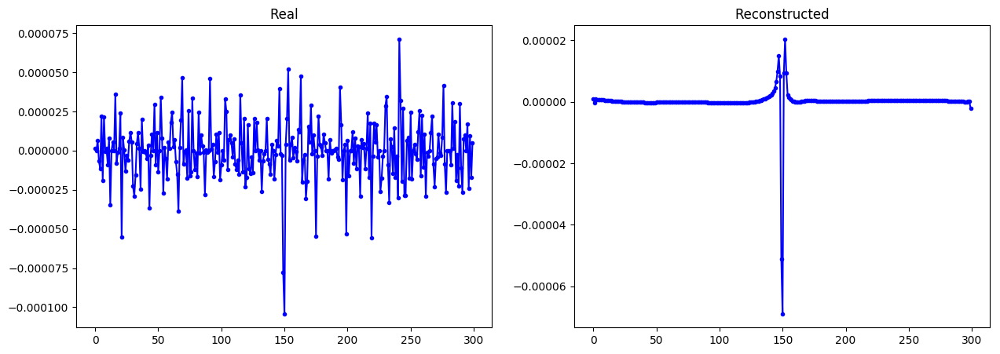

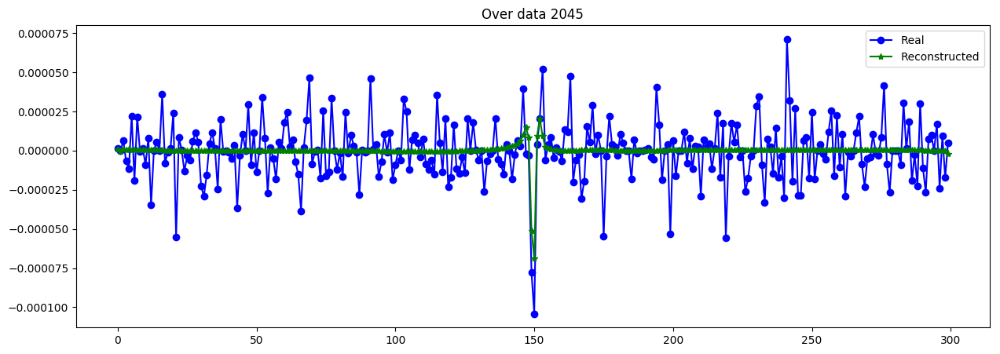

----------------------------------------------------------------


In [22]:
X_CVAE = simulate_CVAE(Cvae.get_layer("generator"), time_all, Ystd_values, batch_size=256)
X_data_CVAE = X_CVAE[mask_transit]

evaluate_reconst(X_data[:N_trans,:]/S_data[:N_trans,None], X_data_CVAE/S_data[:N_trans,None])

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15) #as MA-1

In [36]:
Cvae.get_layer("encoder").save_weights("./models/C-VAEscaleV2_MA5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").save_weights("./models/C-VAEscaleV2_MA5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

### X_s como input.. reconstruye a X_g (luego a X)
es necesario recuperar X a la salida

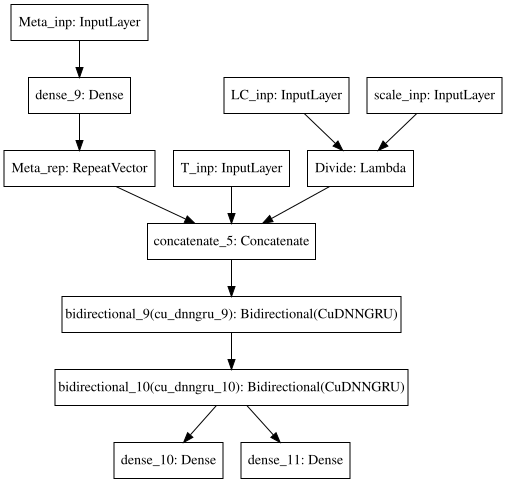

In [23]:
##### INPUTS ENCODER ######
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")
s_lc = Input(shape= (1,), name="scale_inp") #para pesar loss
y_lc = Input(shape = (D_dim,) , name ="Meta_inp")

x_lc_s = Lambda(Divide_layer, name="Divide")([x_lc, s_lc]) #quitar escala del dato (o escalar a una version normal)

##### CODIFY  METADATA ######
y_rep = Dense(10, activation='tanh')(y_lc)
y_rept = RepeatVector(T, name="Meta_rep")(y_rep)

##### CONCATENATE TIME + LC + METADATA-> CODIFY ######
x = Concatenate(axis=-1)([x_t, x_lc_s, y_rept]) #has to be concatenate on axis -1
f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

##### CGET THE LATENT VARIABLE ######
z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc, y_lc, s_lc], [z_mean,z_log_var], name="encoder")
samp_model = define_samp_model(latent_dim) #model to sample

##### INPUTS DECODER ######
decoder_input = Input(shape=(latent_dim,), name="latent_inp")
decoder_inp_rep = RepeatVector(T, name="Enc_rep")(decoder_input)

##### CONCATENATE TIME + LATENT VARIABLE + CONDITIONAL -> DECODIFY LIGHT CURVE ######
decode = Concatenate(axis=-1)([x_t, decoder_inp_rep, y_rept]) #add time and metadata to decode
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
#decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

#####  RECONSTRUCT LIGHT CURVE BY SCALE  ######
decode = TimeDistributed(Dense(1, activation='linear'))(decode)
decode = Lambda(RevertNorm, arguments={'mu':0,'std':S_mu},name="revnormLC")(decode) #NEW: volver a escala normal 
generator = Model([x_t, decoder_input, y_lc], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_model(encoder([x_t, x_lc, y_lc, s_lc])), y_lc ])
Cvae = Model([x_t, x_lc, y_lc, s_lc], out)

#define loss functions over model components
smse_LC = SMSE_loss(s_lc)
kl_loss = KL_loss(z_mean, z_log_var)

def Wvae_loss(y_true, y_pred):    
    return smse_LC(y_true, y_pred) + l*kl_loss(y_true, y_pred)
Cvae.compile(optimizer='adam', loss=Wvae_loss, metrics = [smse_LC, kl_loss])

Cvae.get_layer("encoder").load_weights("./models/C-VAEscaleV3_MA5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").load_weights("./models/C-VAEscaleV3_MA5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

SVG(model_to_dot(Cvae.get_layer("encoder")).create(prog='dot', format='svg'))

In [38]:
Cvae.fit([X_data_t, X_data, Ystd_transit, S_data], X_data, epochs=400, batch_size=batch_size)

Epoch 1/400
8634/8634 [==============================] - 22s 2ms/step - loss: 4.1731 - SMSE: 4.1720 - KL: 1.1586
Epoch 2/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.4262 - SMSE: 1.4249 - KL: 1.3188
Epoch 3/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.2938 - SMSE: 1.2926 - KL: 1.2443
Epoch 4/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.2352 - SMSE: 1.2339 - KL: 1.3358
Epoch 5/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.1324 - SMSE: 1.1308 - KL: 1.5921
Epoch 6/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0909 - SMSE: 1.0890 - KL: 1.8776
Epoch 7/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.1241 - SMSE: 1.1218 - KL: 2.2415
Epoch 8/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0731 - SMSE: 1.0703 - KL: 2.8323
Epoch 9/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0446 - SMSE: 1.0

8634/8634 [==============================] - 18s 2ms/step - loss: 1.0027 - SMSE: 1.0022 - KL: 0.4751
Epoch 144/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0038 - SMSE: 1.0032 - KL: 0.5452
Epoch 145/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0040 - SMSE: 1.0033 - KL: 0.7180
Epoch 146/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0024 - SMSE: 1.0019 - KL: 0.4852
Epoch 147/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0024 - SMSE: 1.0019 - KL: 0.4581
Epoch 148/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0027 - SMSE: 1.0022 - KL: 0.4766
Epoch 149/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0029 - SMSE: 1.0024 - KL: 0.5430
Epoch 150/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0041 - SMSE: 1.0034 - KL: 0.6641
Epoch 151/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0030 - SMSE:

8634/8634 [==============================] - 17s 2ms/step - loss: 0.7287 - SMSE: 0.7223 - KL: 6.4032
Epoch 286/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7579 - SMSE: 0.7513 - KL: 6.5808
Epoch 287/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7331 - SMSE: 0.7263 - KL: 6.8115
Epoch 288/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7496 - SMSE: 0.7432 - KL: 6.4130
Epoch 289/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7446 - SMSE: 0.7380 - KL: 6.5265
Epoch 290/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7577 - SMSE: 0.7510 - KL: 6.6402
Epoch 291/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7462 - SMSE: 0.7393 - KL: 6.8729
Epoch 292/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7400 - SMSE: 0.7336 - KL: 6.3572
Epoch 293/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7309 - SMSE:

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


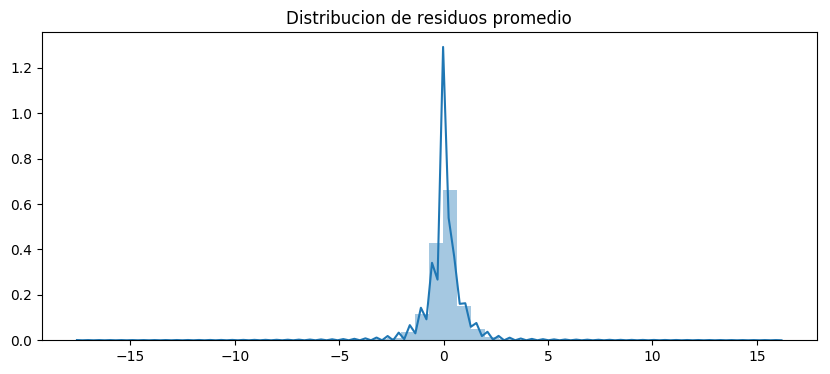

------------- Error -------------
RMSE (+-) =  0.864039352330015
MAE  (+-) =  0.5250296352073268
------------- Smoothness -------------
AutoCorr lag-one =  0.7088093002772167
Diff MEAN =  0.04436935342384661
------------- Residual -------------
AutoCorr lag-one =  0.09776784994664922
Permutation H =  0.9955913681260892
Spectral H =  0.8847969279187371
---------------------------------------


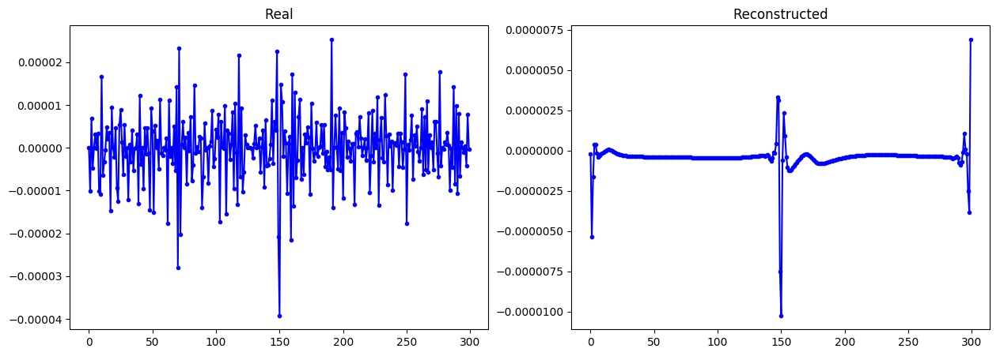

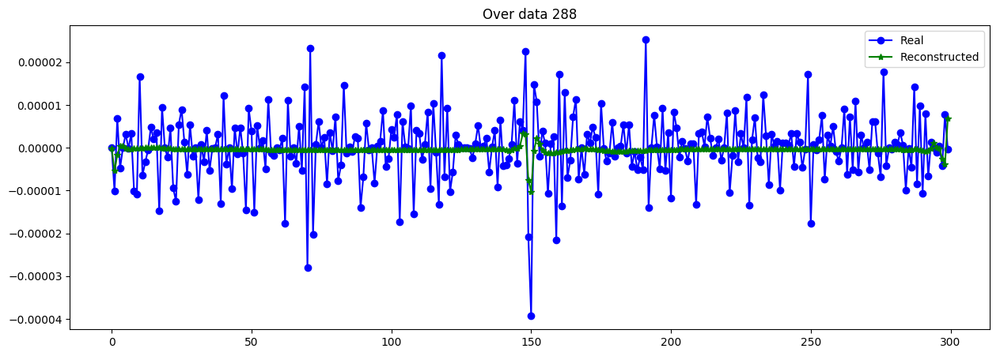

----------------------------------------------------------------


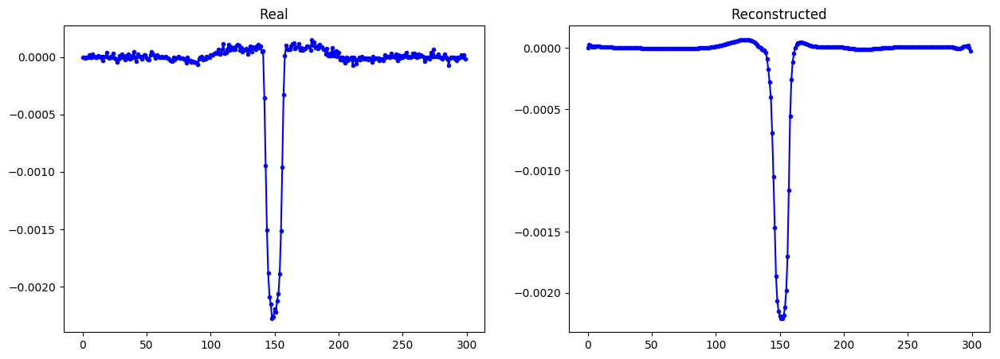

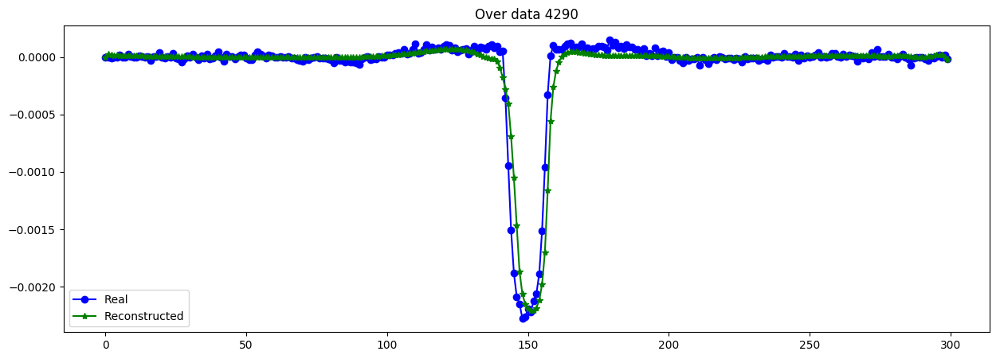

----------------------------------------------------------------


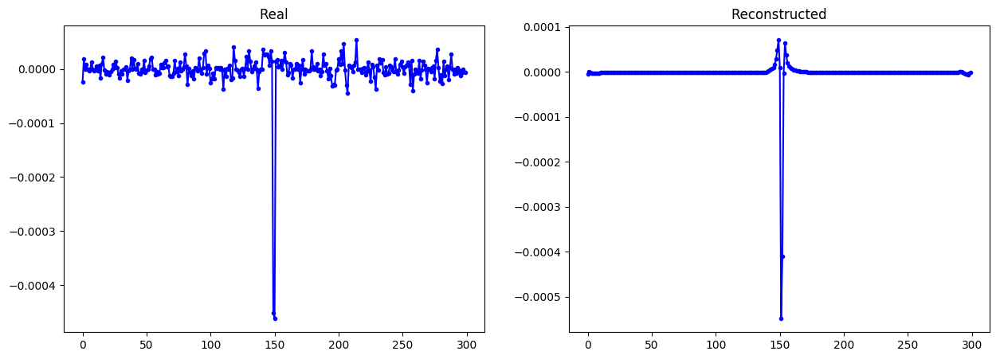

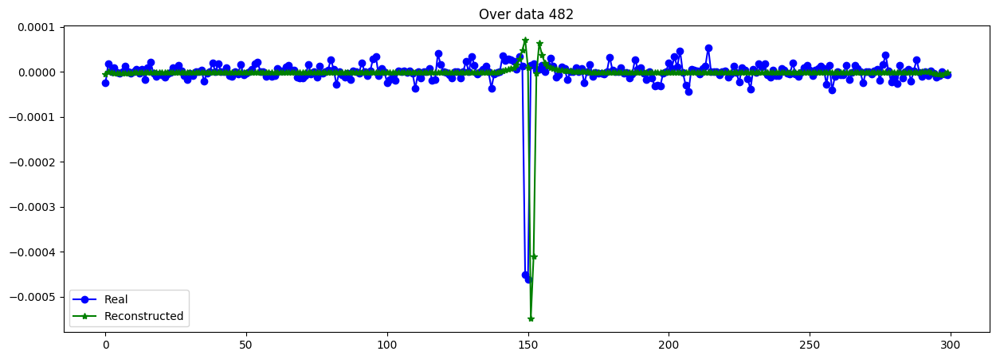

----------------------------------------------------------------


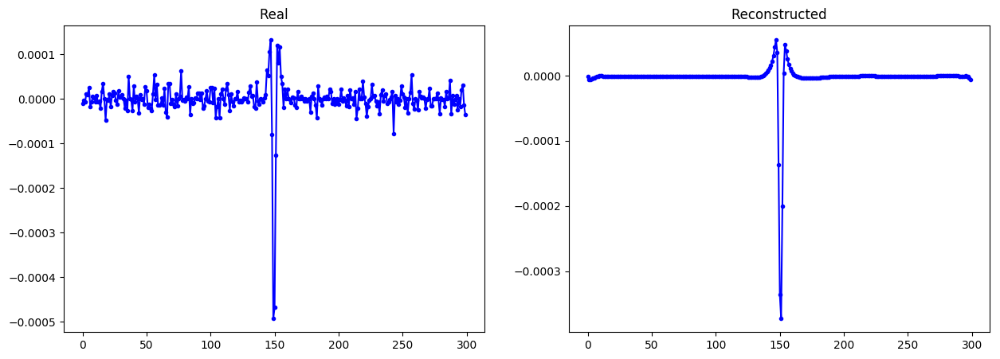

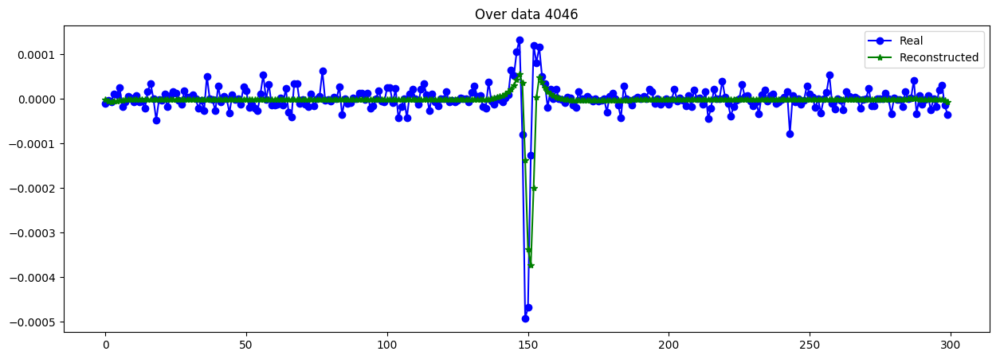

----------------------------------------------------------------


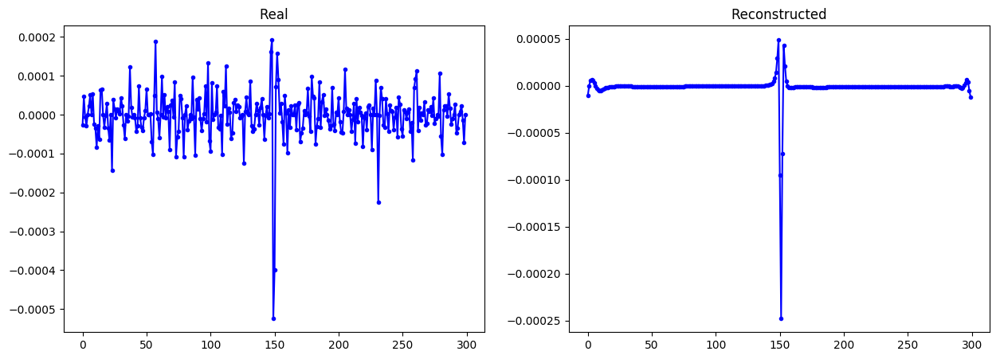

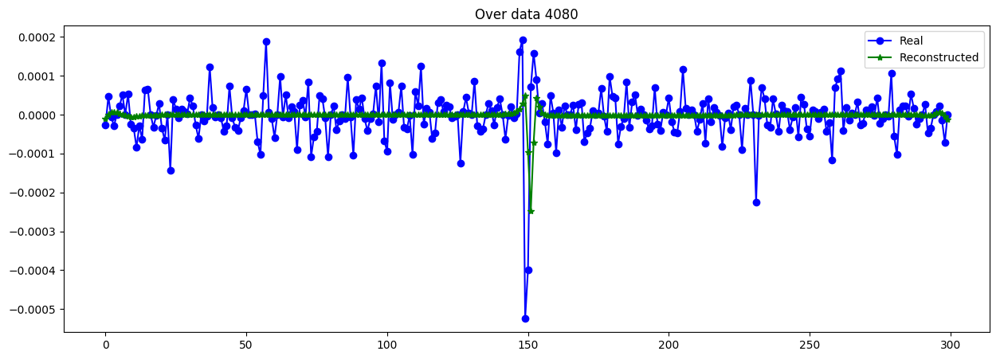

----------------------------------------------------------------


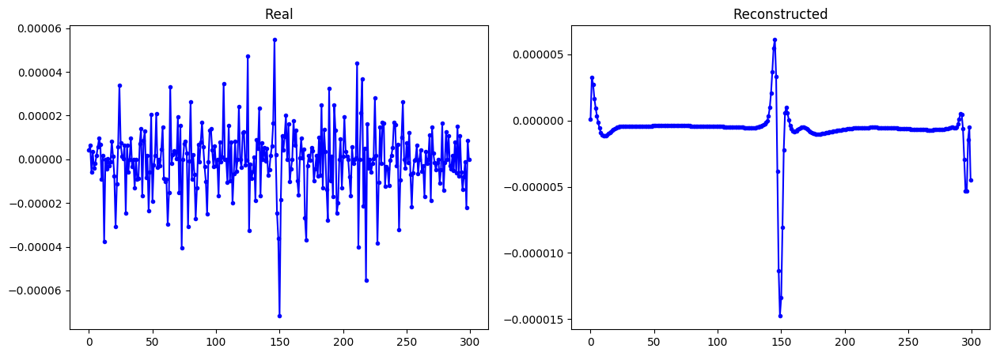

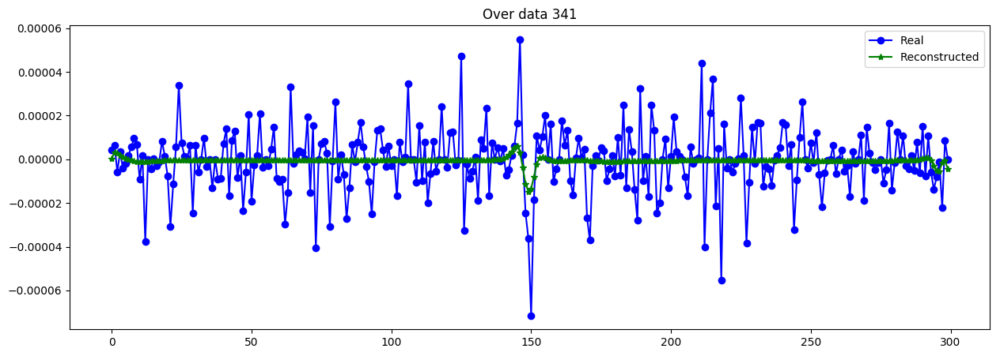

----------------------------------------------------------------


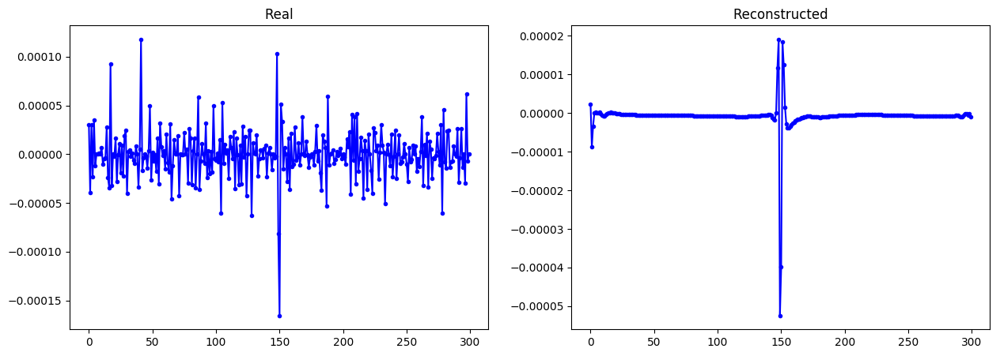

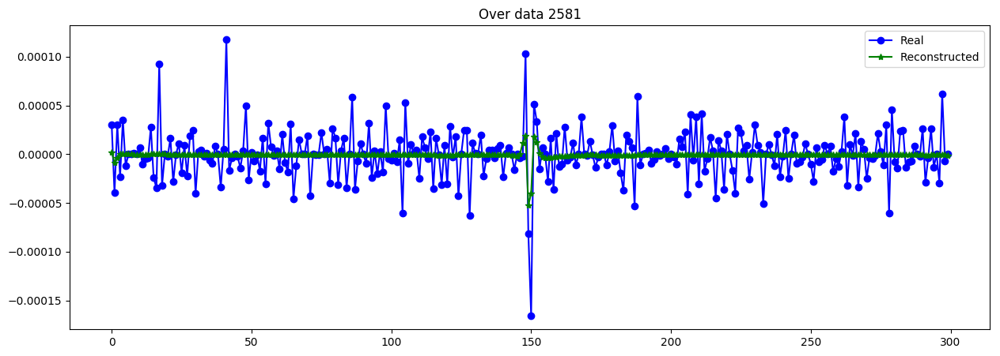

----------------------------------------------------------------


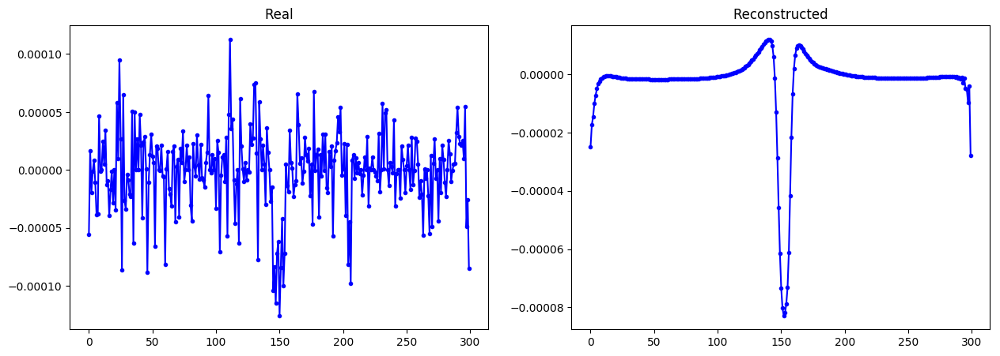

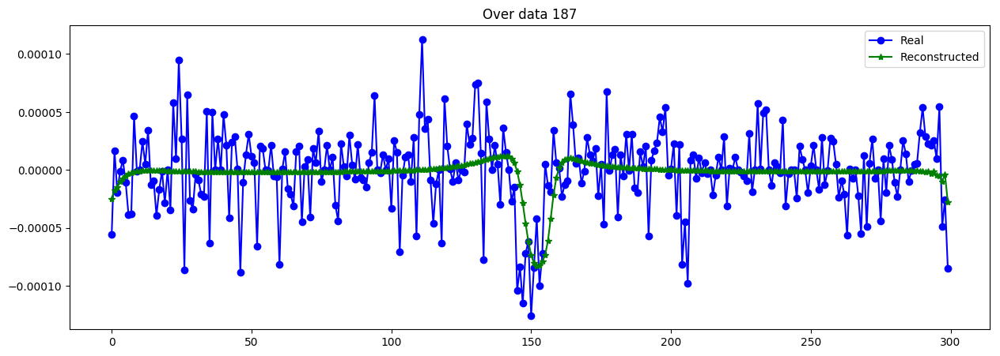

----------------------------------------------------------------


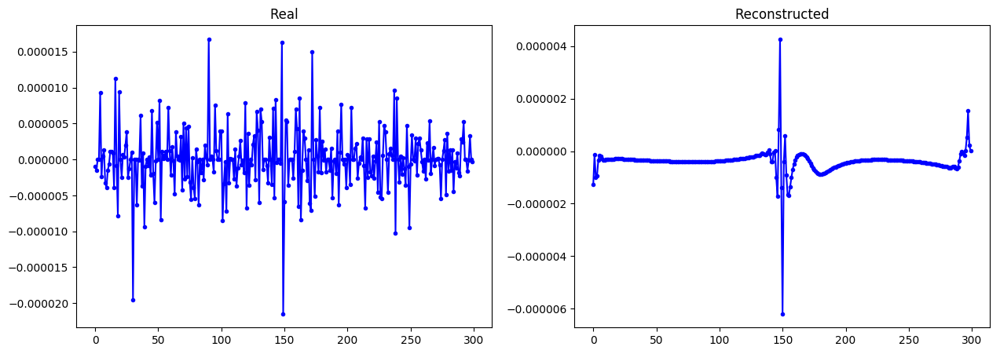

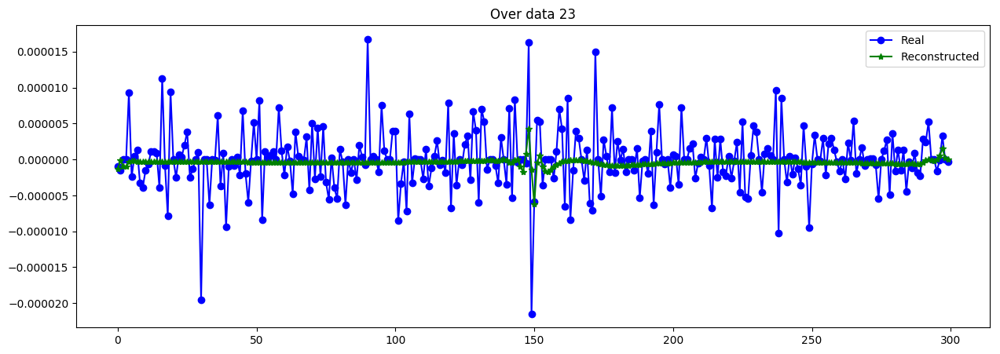

----------------------------------------------------------------


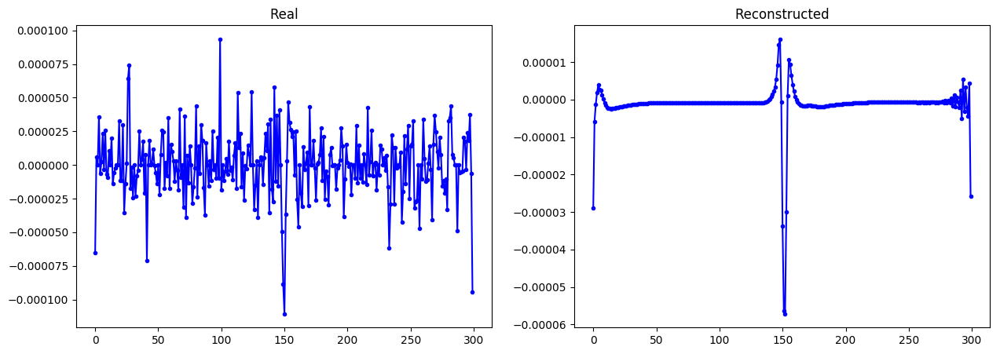

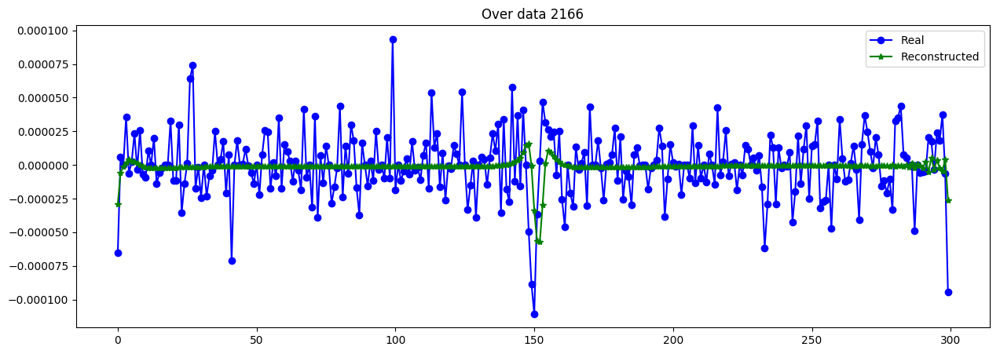

----------------------------------------------------------------


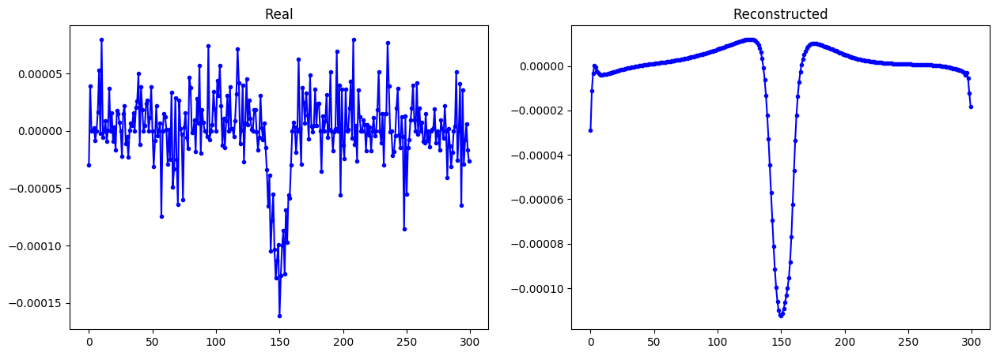

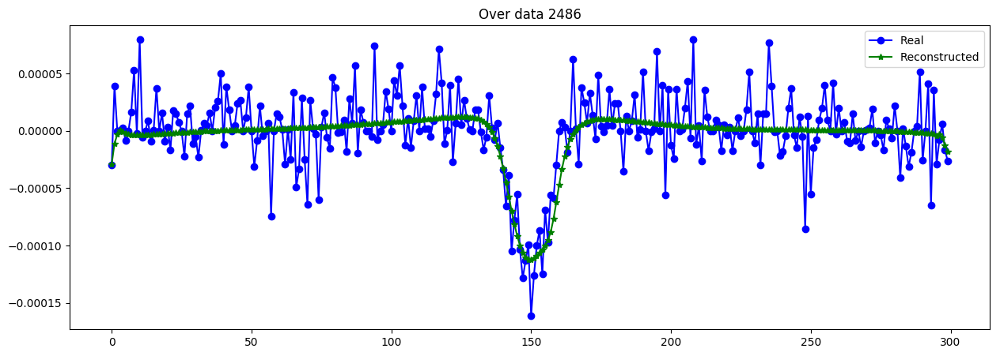

----------------------------------------------------------------


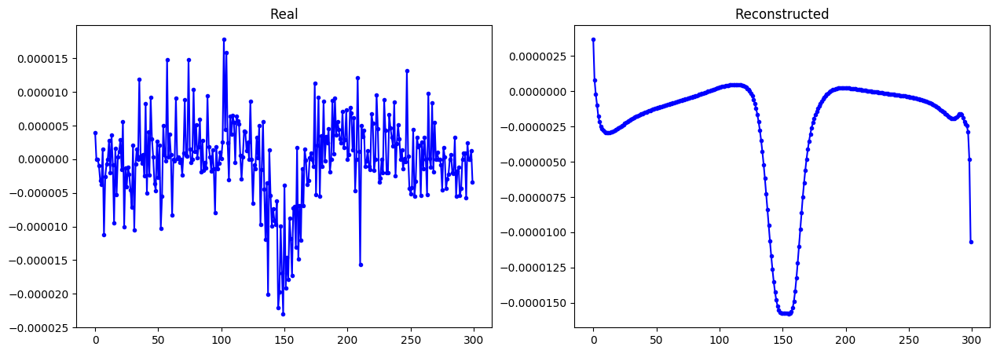

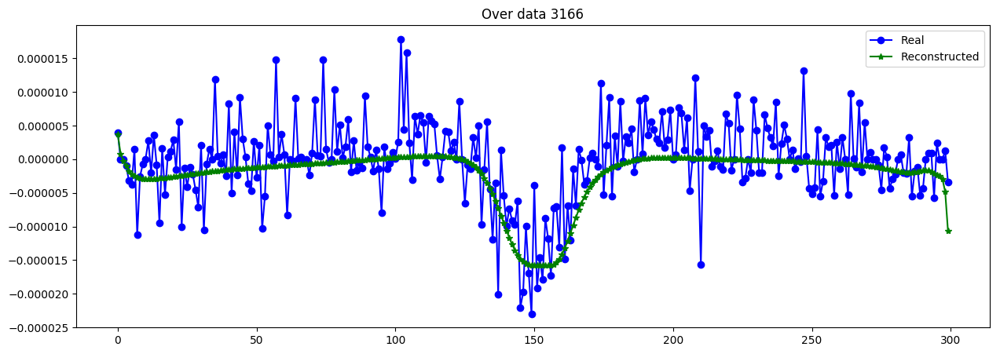

----------------------------------------------------------------


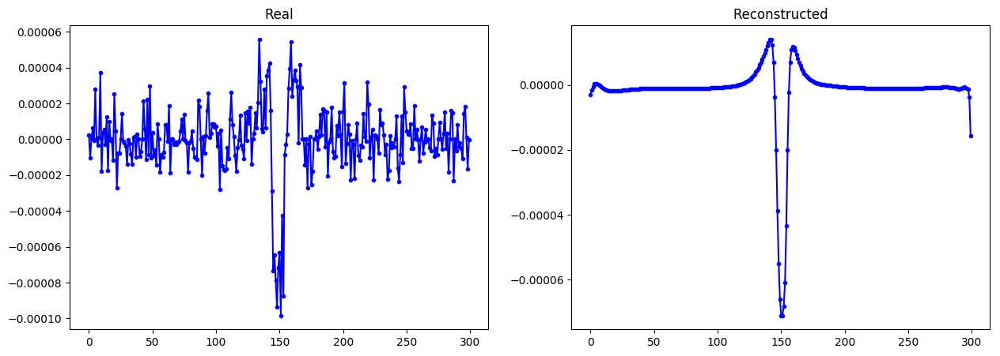

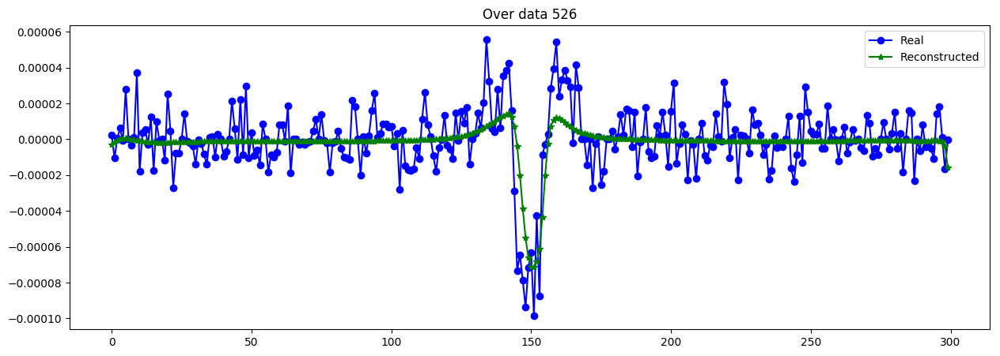

----------------------------------------------------------------


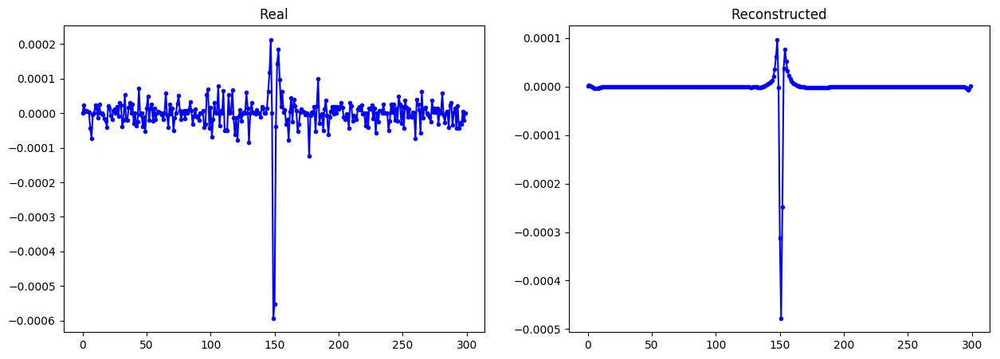

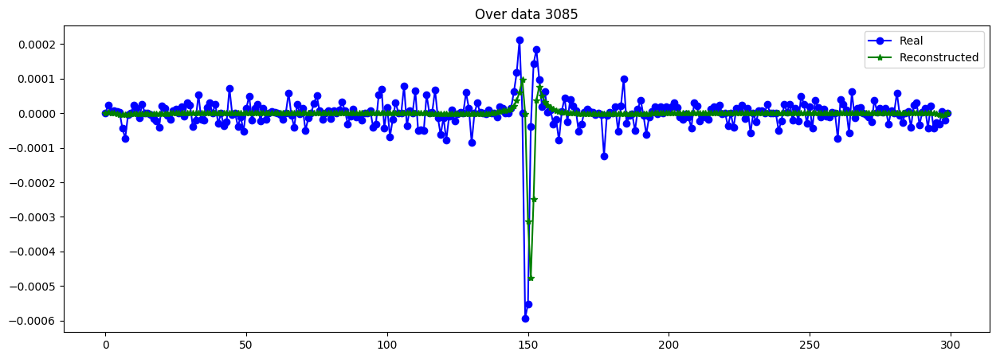

----------------------------------------------------------------


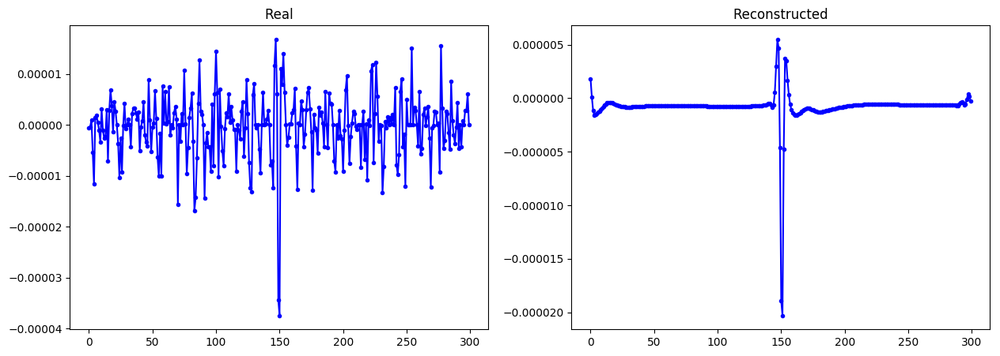

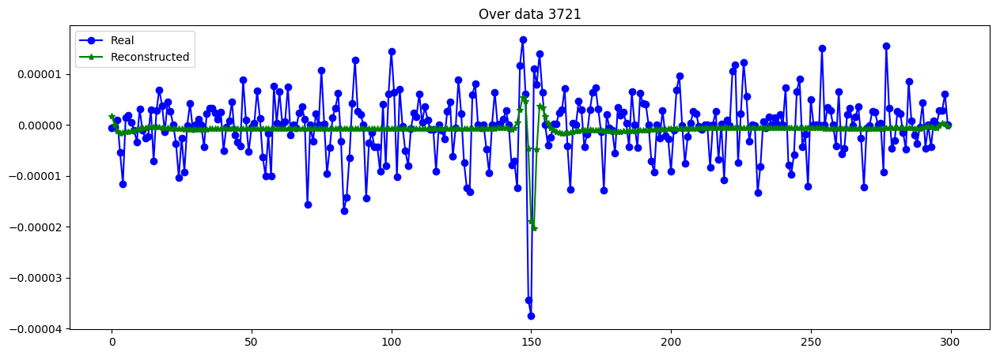

----------------------------------------------------------------


In [24]:
X_data_hat = Cvae.predict([X_data_t[:N_trans], X_data[:N_trans], Ystd_transit[:N_trans], S_data[:N_trans]], batch_size=512)
evaluate_reconst(X_data[:N_trans]/S_data[:N_trans,None,:], X_data_hat/S_data[:N_trans,None,:])

plot_n_lc(X_data[:N_trans,:,0], X_data_hat, n= 15)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


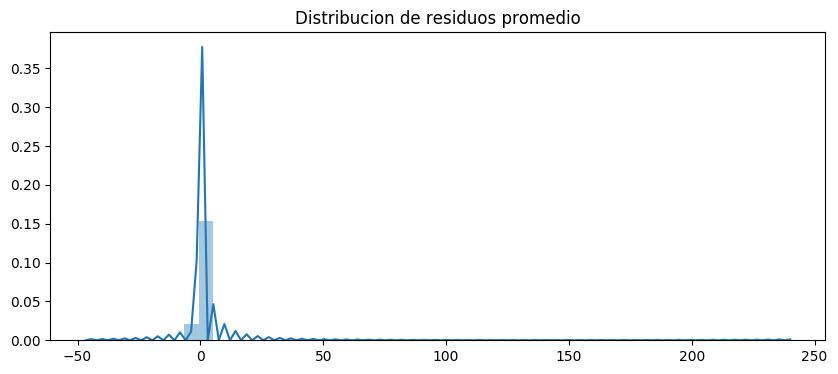

------------- Error -------------
RMSE (+-) =  1.0618064303481314
MAE  (+-) =  0.5809573404360924
------------- Smoothness -------------
AutoCorr lag-one =  0.7517162088874513
Diff MEAN =  0.05631993996707084
------------- Residual -------------
AutoCorr lag-one =  0.22982421847815848
Permutation H =  0.9956170641688776
Spectral H =  0.8573342701949338
---------------------------------------


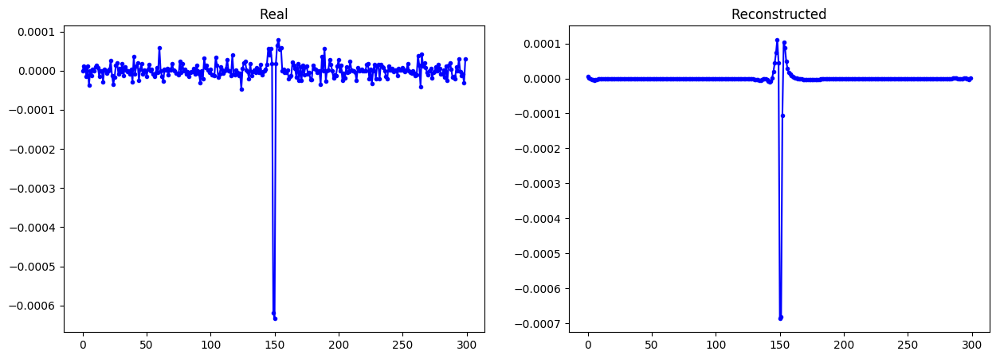

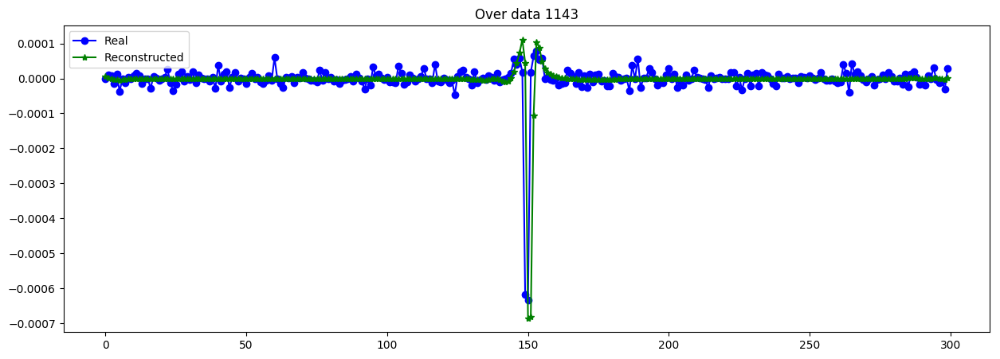

----------------------------------------------------------------


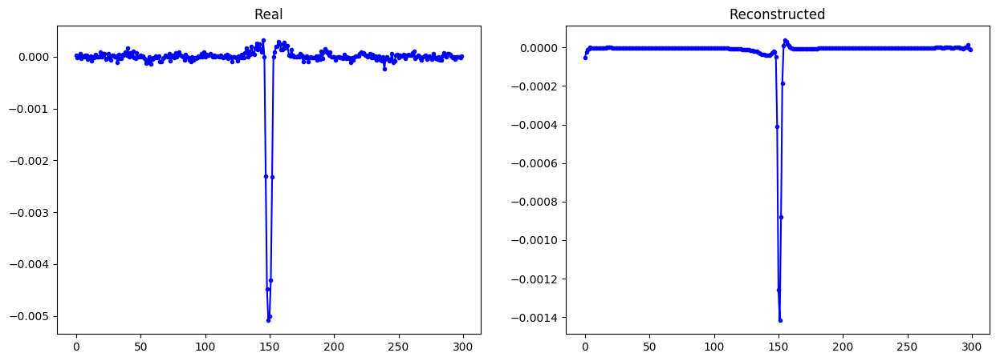

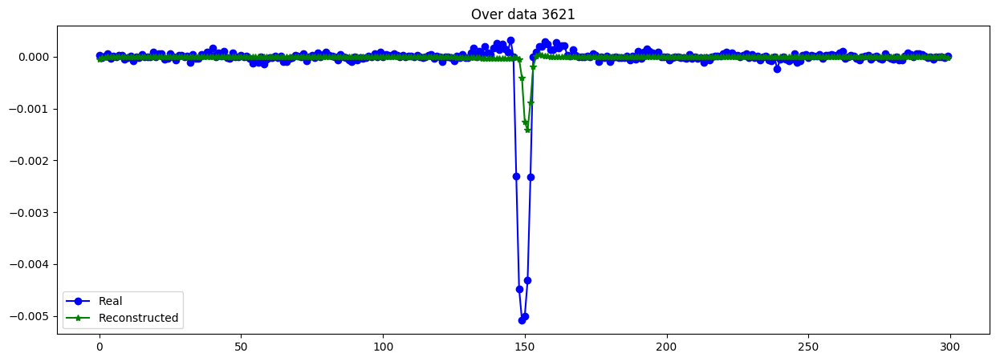

----------------------------------------------------------------


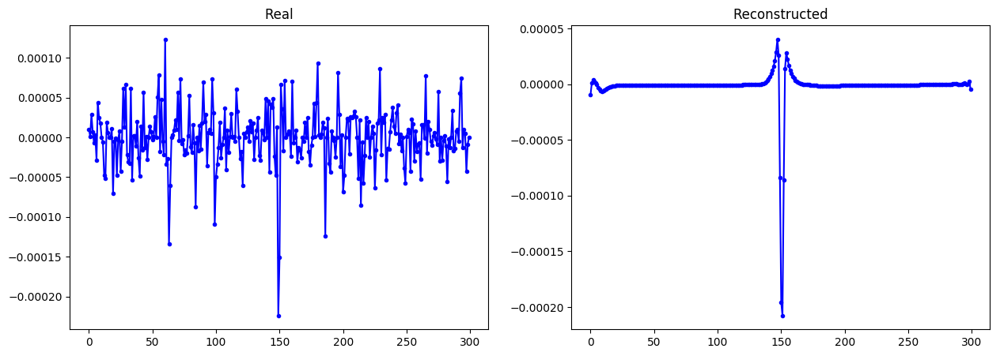

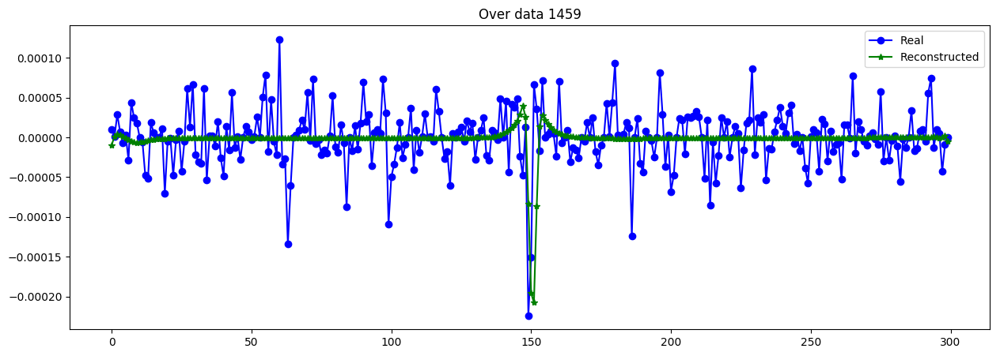

----------------------------------------------------------------


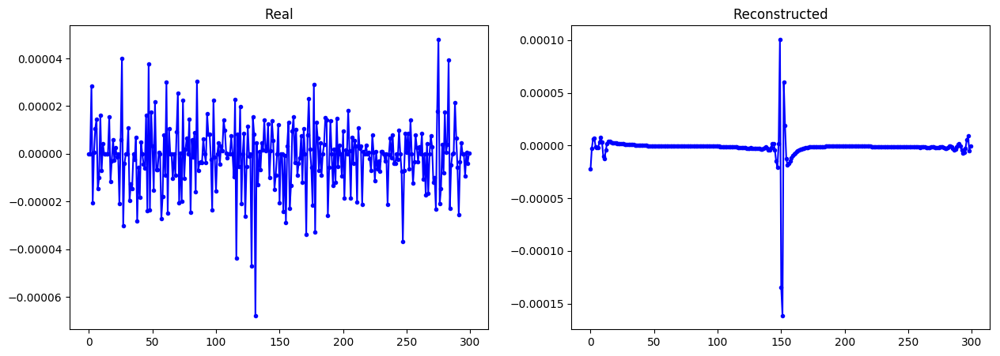

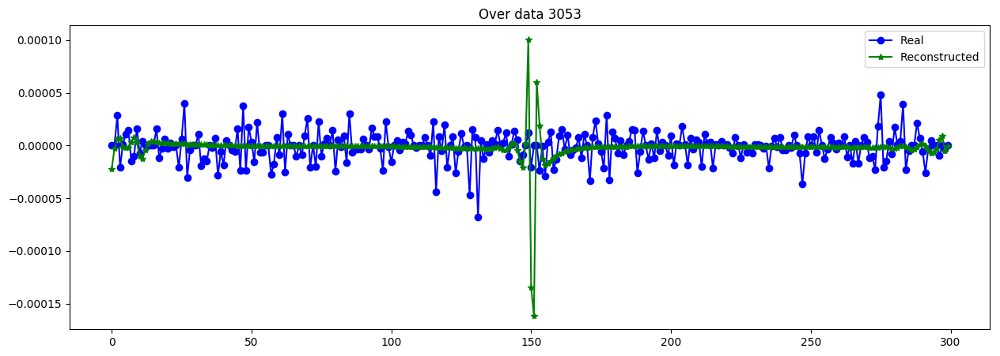

----------------------------------------------------------------


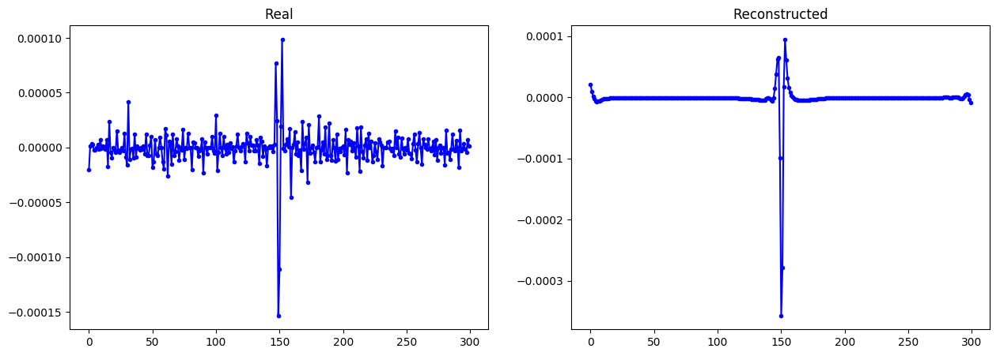

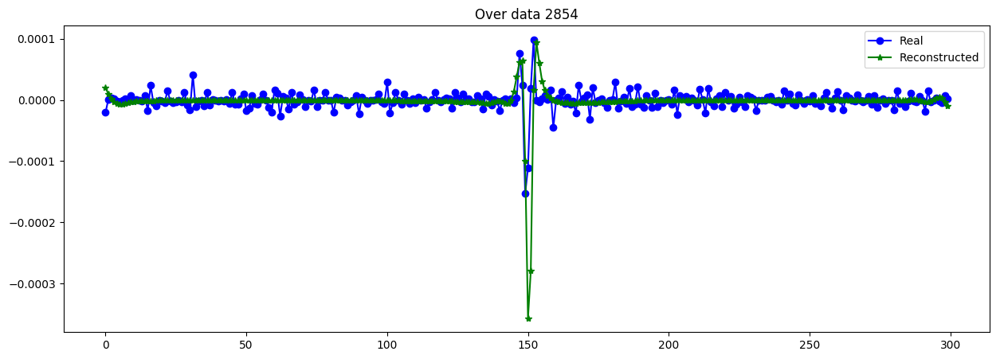

----------------------------------------------------------------


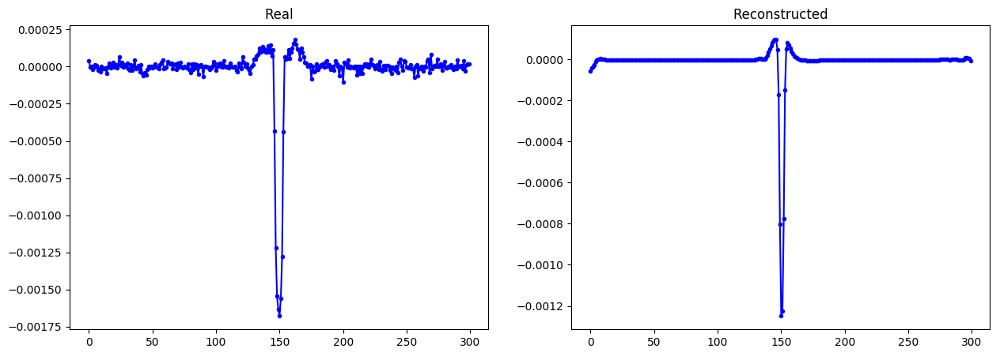

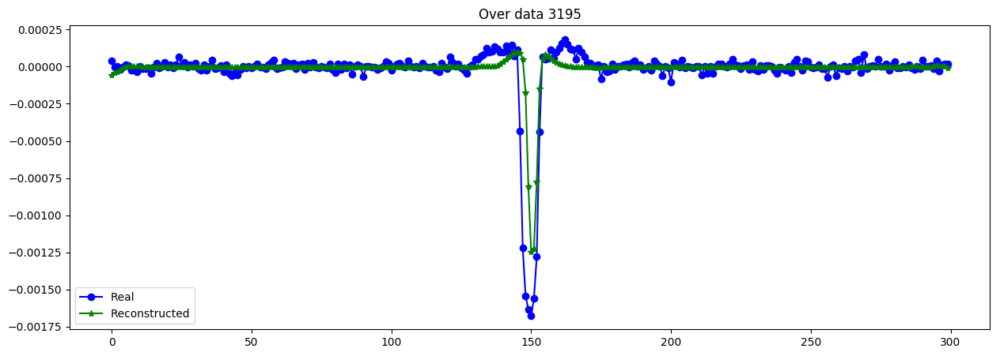

----------------------------------------------------------------


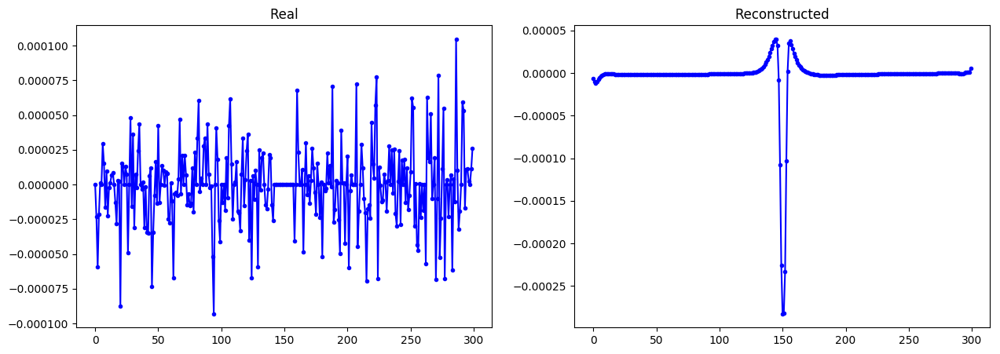

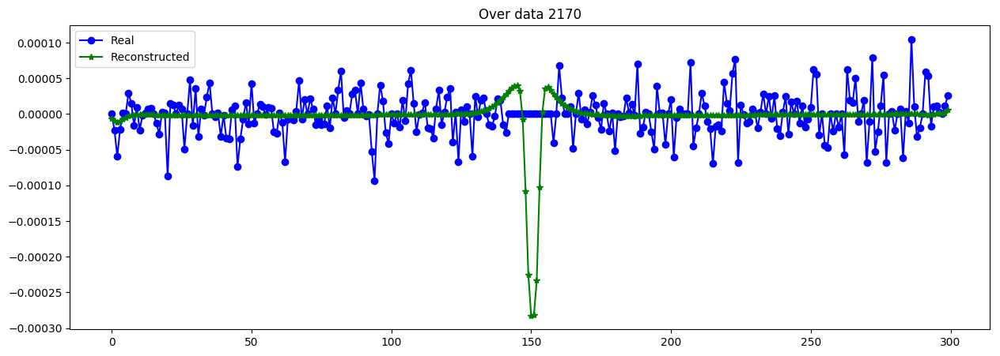

----------------------------------------------------------------


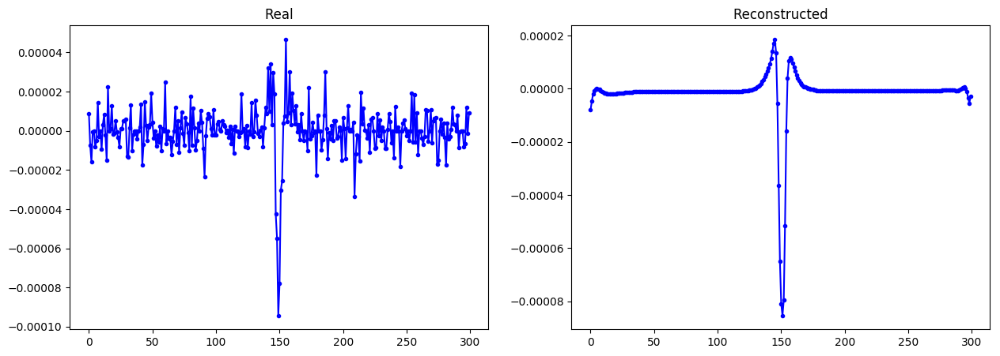

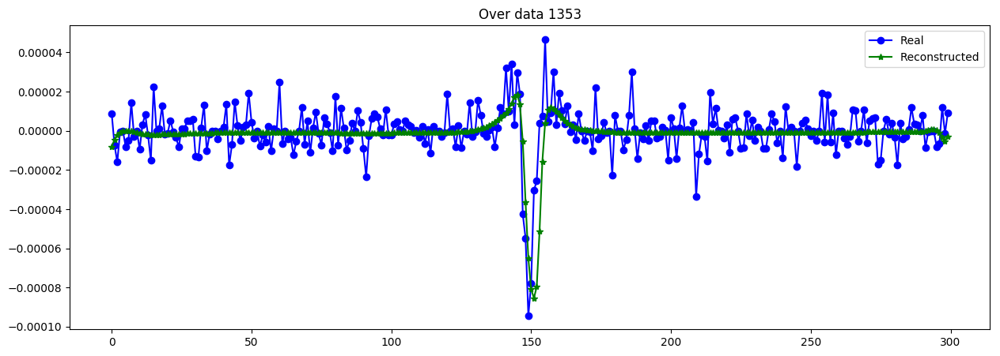

----------------------------------------------------------------


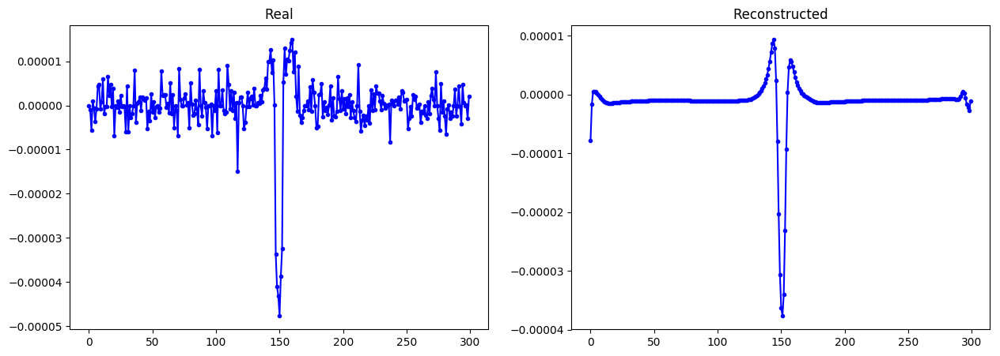

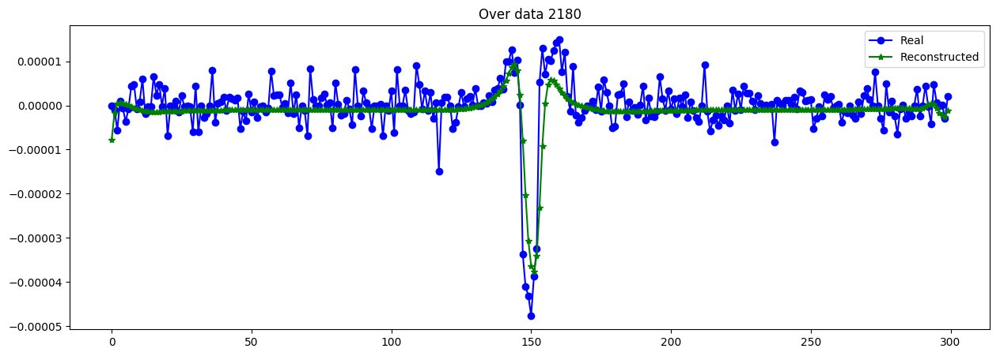

----------------------------------------------------------------


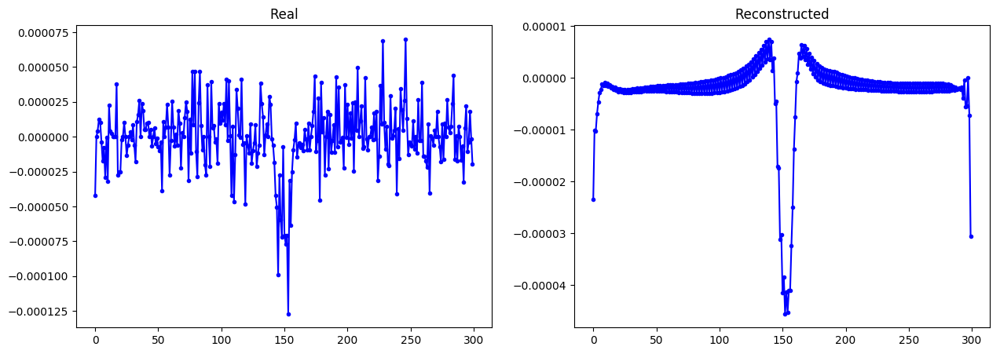

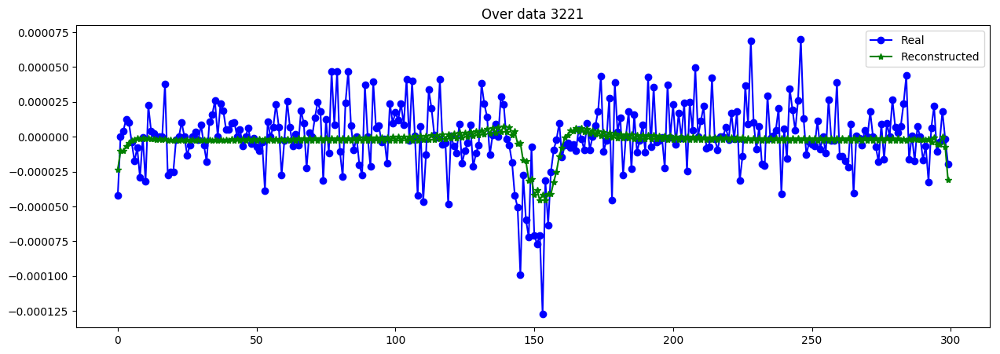

----------------------------------------------------------------


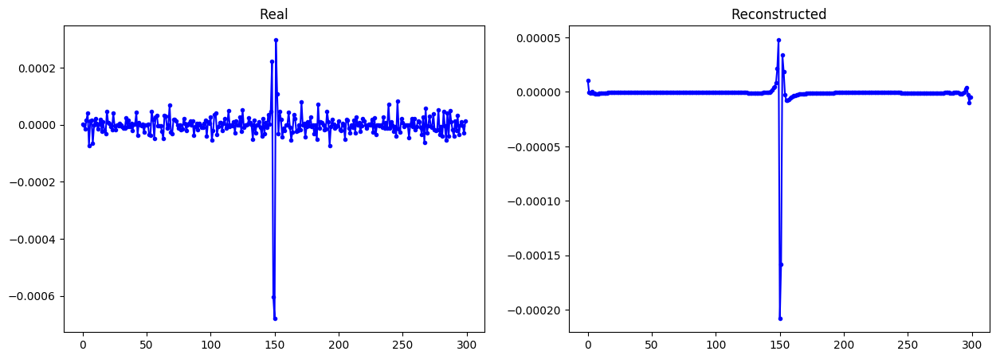

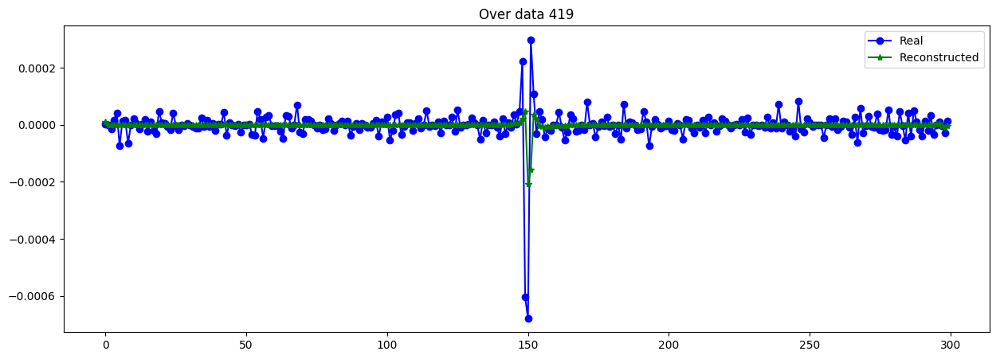

----------------------------------------------------------------


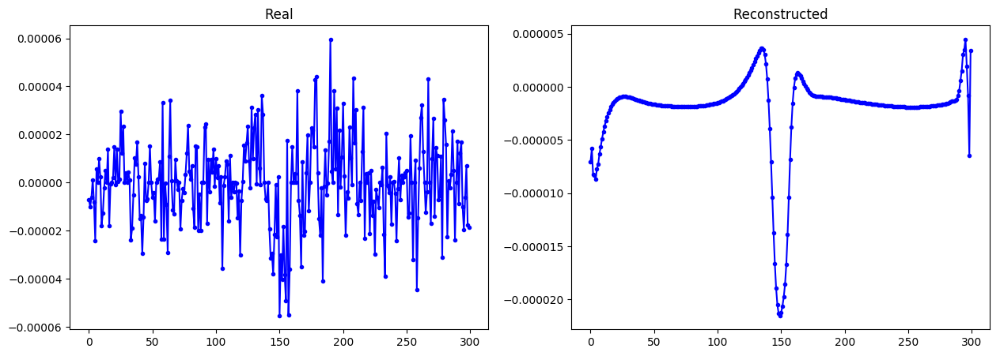

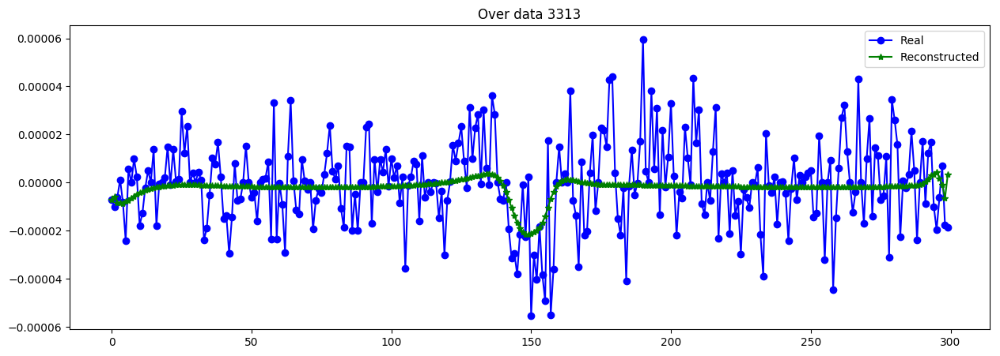

----------------------------------------------------------------


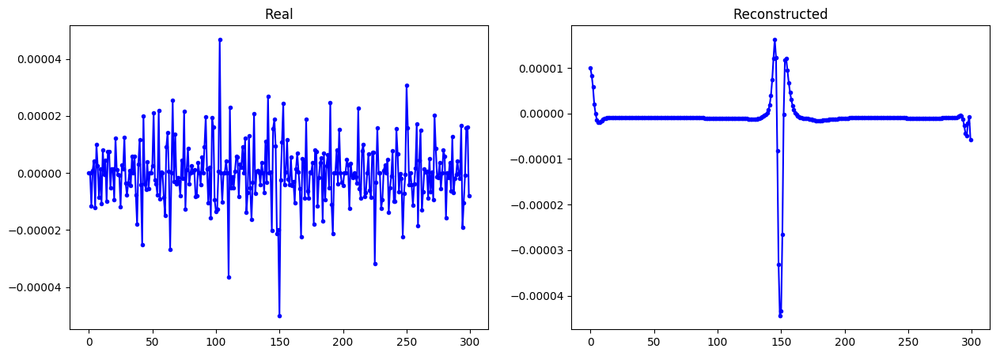

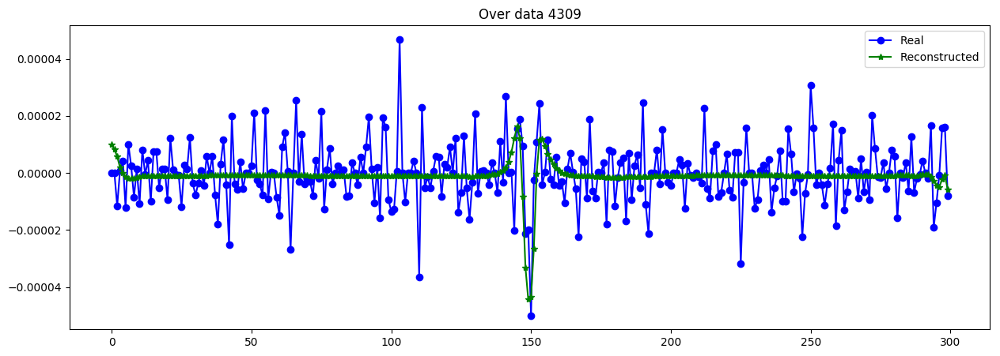

----------------------------------------------------------------


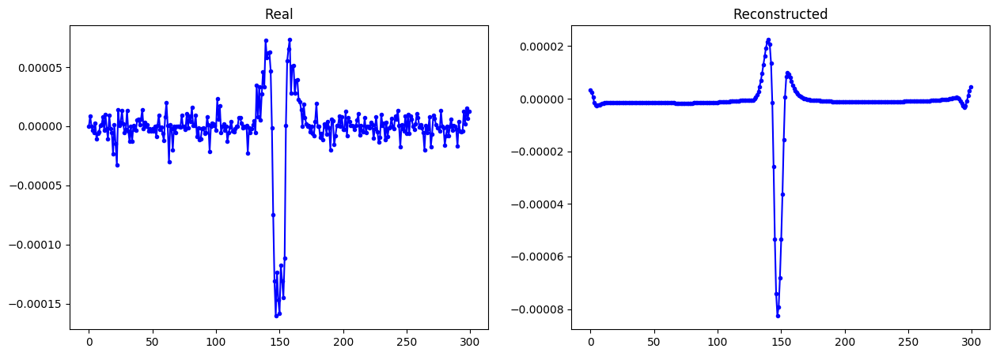

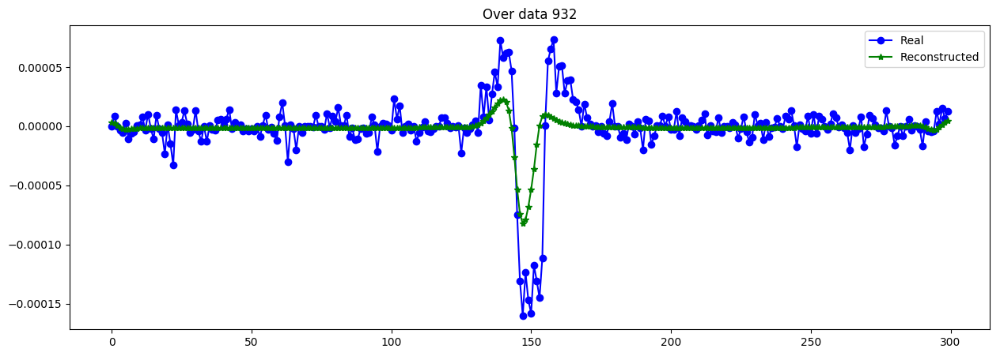

----------------------------------------------------------------


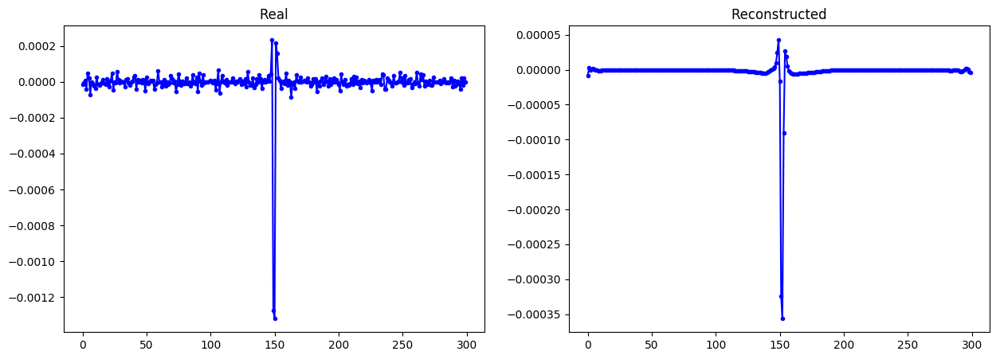

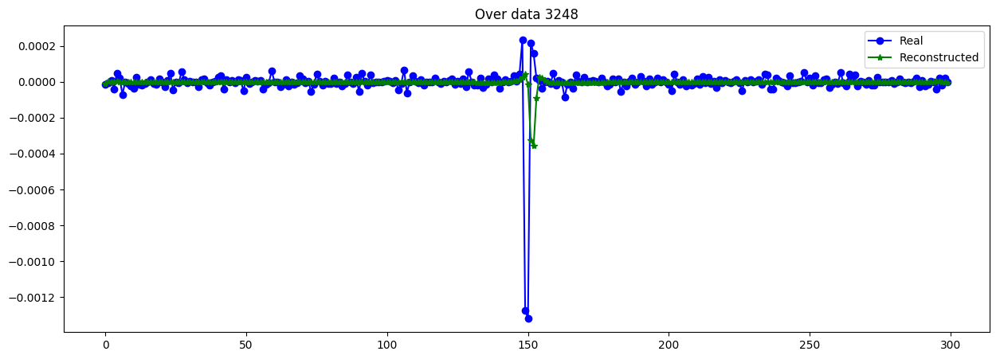

----------------------------------------------------------------


In [25]:
X_CVAE = simulate_CVAE(Cvae.get_layer("generator"), time_all, Ystd_values, batch_size=256)
X_data_CVAE = X_CVAE[mask_transit]

evaluate_reconst(X_data[:N_trans,:]/S_data[:N_trans,None], X_data_CVAE/S_data[:N_trans,None])

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15) #as MA-1

In [41]:
Cvae.get_layer("encoder").save_weights("./models/C-VAEscaleV3_MA5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").save_weights("./models/C-VAEscaleV3_MA5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

## Metadata con logaritmo...

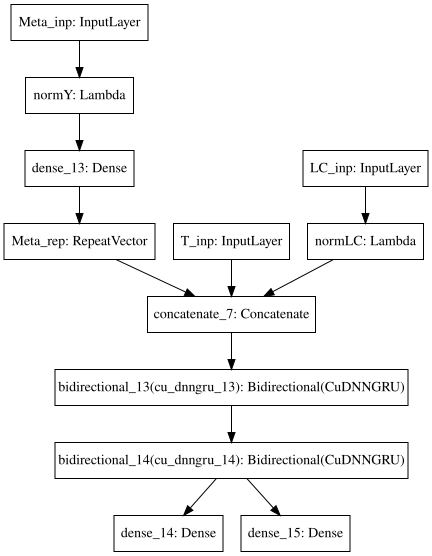

In [26]:
##### INPUTS ENCODER ######
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")
s_lc = Input(shape= (1,), name="scale_inp") #para pesar loss
y_lc = Input(shape = (D_dim,) , name ="Meta_inp")

x_lc_s = Lambda(Norm, arguments={'mu':0,'std':S_mu}, name="normLC")(x_lc) 

##### CODIFY  METADATA ######
y_rep = Lambda(Norm_L, arguments={'mu':Ylog_mu,'std':Ylog_std}, name="normY")(y_lc)
y_rep = Dense(10, activation='tanh')(y_rep)
y_rept = RepeatVector(T, name="Meta_rep")(y_rep)

##### CONCATENATE TIME + LC + METADATA-> CODIFY ######
x = Concatenate(axis=-1)([x_t, x_lc_s, y_rept]) #has to be concatenate on axis -1
f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

##### CGET THE LATENT VARIABLE ######
z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc, y_lc], [z_mean,z_log_var], name="encoder")
samp_model = define_samp_model(latent_dim) #model to sample

##### INPUTS DECODER ######
decoder_input = Input(shape=(latent_dim,), name="latent_inp")
decoder_inp_rep = RepeatVector(T, name="Enc_rep")(decoder_input)

##### CONCATENATE TIME + LATENT VARIABLE + CONDITIONAL -> DECODIFY LIGHT CURVE ######
decode = Concatenate(axis=-1)([x_t, decoder_inp_rep, y_rept]) #add time and metadata to decode
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
#decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

#####  RECONSTRUCT LIGHT CURVE BY SCALE  ######
decode = TimeDistributed(Dense(1, activation='linear'))(decode)
decode = Lambda(RevertNorm, arguments={'mu':0,'std':S_mu},name="revnormLC")(decode) #NEW: volver a escala normal 
generator = Model([x_t, decoder_input, y_lc], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_model(encoder([x_t, x_lc, y_lc])), y_lc ])
Cvae = Model([x_t, x_lc, y_lc, s_lc], out)

#define loss functions over model components
smse_LC = SMSE_loss(s_lc)
kl_loss = KL_loss(z_mean, z_log_var)

def Wvae_loss(y_true, y_pred):    
    return smse_LC(y_true, y_pred) + l*kl_loss(y_true, y_pred)
Cvae.compile(optimizer='adam', loss=Wvae_loss, metrics = [smse_LC, kl_loss])

Cvae.get_layer("encoder").load_weights("./models/C-VAEscaleV2_MAL5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").load_weights("./models/C-VAEscaleV2_MAL5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

SVG(model_to_dot(Cvae.get_layer("encoder")).create(prog='dot', format='svg'))

In [43]:
Cvae.fit([X_data_t, X_data, Y_transit, S_data], X_data, epochs=400, batch_size=batch_size)

Epoch 1/400
8634/8634 [==============================] - 22s 3ms/step - loss: 2.7705 - SMSE: 2.7663 - KL: 4.1985
Epoch 2/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.3649 - SMSE: 1.3575 - KL: 7.3753
Epoch 3/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0704 - SMSE: 1.0590 - KL: 11.4550
Epoch 4/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0481 - SMSE: 1.0339 - KL: 14.2264
Epoch 5/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0324 - SMSE: 1.0178 - KL: 14.6410
Epoch 6/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0293 - SMSE: 1.0146 - KL: 14.7000
Epoch 7/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0324 - SMSE: 1.0175 - KL: 14.9287
Epoch 8/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0480 - SMSE: 1.0331 - KL: 14.9324
Epoch 9/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0270 - SMS

8634/8634 [==============================] - 17s 2ms/step - loss: 0.8333 - SMSE: 0.8153 - KL: 18.0169
Epoch 144/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8373 - SMSE: 0.8200 - KL: 17.3373
Epoch 145/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.8202 - SMSE: 0.8040 - KL: 16.2231
Epoch 146/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.8278 - SMSE: 0.8106 - KL: 17.1979
Epoch 147/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.8183 - SMSE: 0.8011 - KL: 17.2493
Epoch 148/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8240 - SMSE: 0.8073 - KL: 16.6219
Epoch 149/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8132 - SMSE: 0.7969 - KL: 16.2687
Epoch 150/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8204 - SMSE: 0.8040 - KL: 16.3869
Epoch 151/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.8118

8634/8634 [==============================] - 18s 2ms/step - loss: 0.7212 - SMSE: 0.7077 - KL: 13.5060
Epoch 284/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7408 - SMSE: 0.7263 - KL: 14.4710
Epoch 285/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7429 - SMSE: 0.7289 - KL: 14.0159
Epoch 286/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7223 - SMSE: 0.7078 - KL: 14.5112
Epoch 287/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7228 - SMSE: 0.7086 - KL: 14.2111
Epoch 288/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7256 - SMSE: 0.7119 - KL: 13.7785
Epoch 289/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7166 - SMSE: 0.7029 - KL: 13.7236
Epoch 290/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7218 - SMSE: 0.7081 - KL: 13.6318
Epoch 291/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7320

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


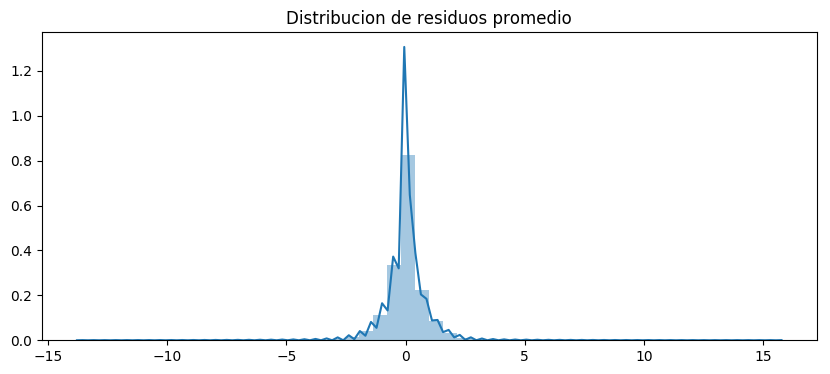

------------- Error -------------
RMSE (+-) =  0.7655069853344655
MAE  (+-) =  0.5013616177140219
------------- Smoothness -------------
AutoCorr lag-one =  0.7828486045812698
Diff MEAN =  0.052097067262171184
------------- Residual -------------
AutoCorr lag-one =  0.00634909473741623
Permutation H =  0.9957708152890238
Spectral H =  0.8968679740496039
---------------------------------------


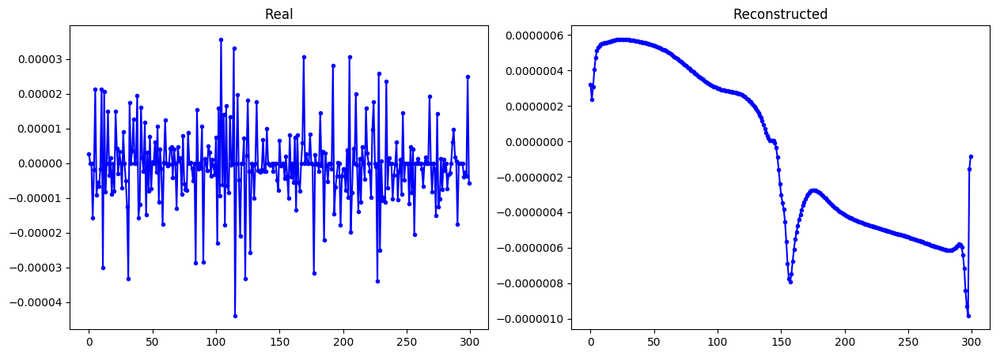

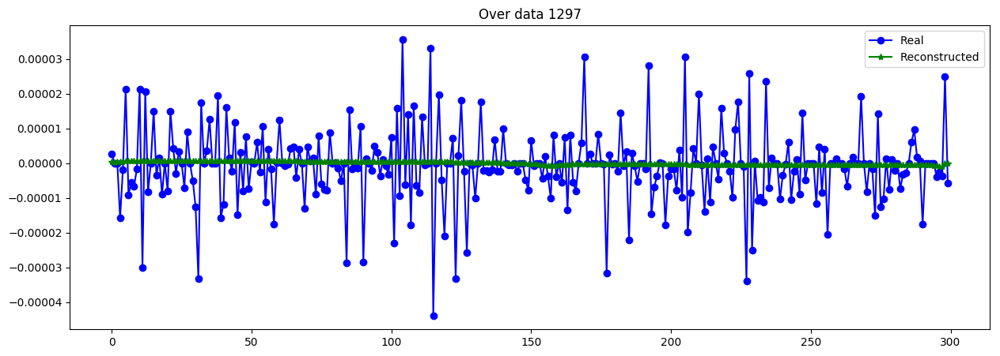

----------------------------------------------------------------


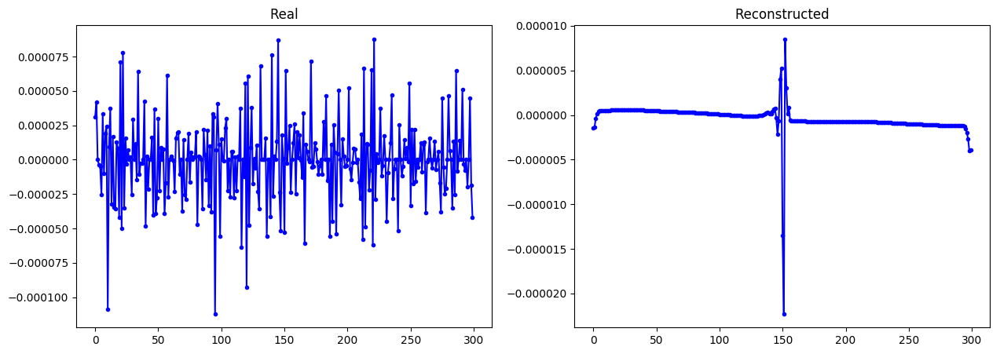

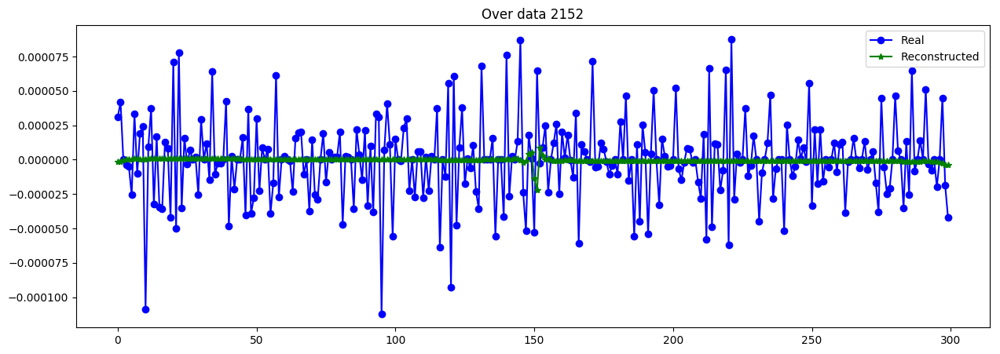

----------------------------------------------------------------


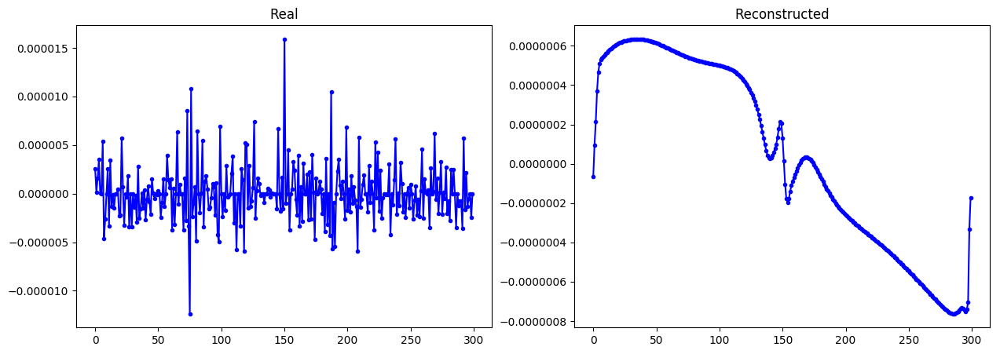

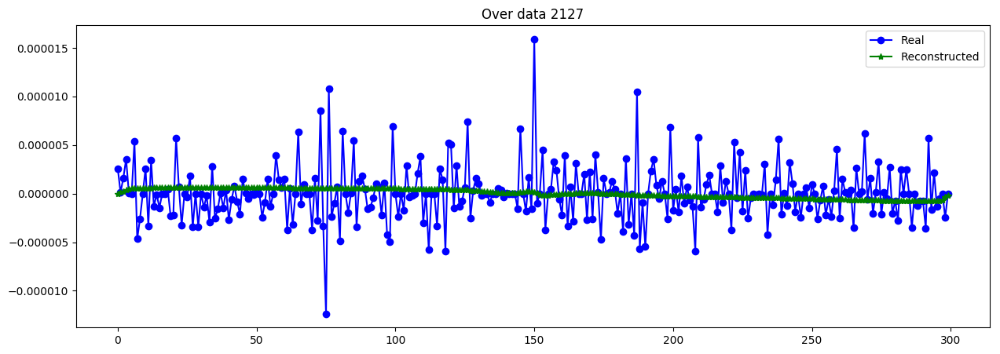

----------------------------------------------------------------


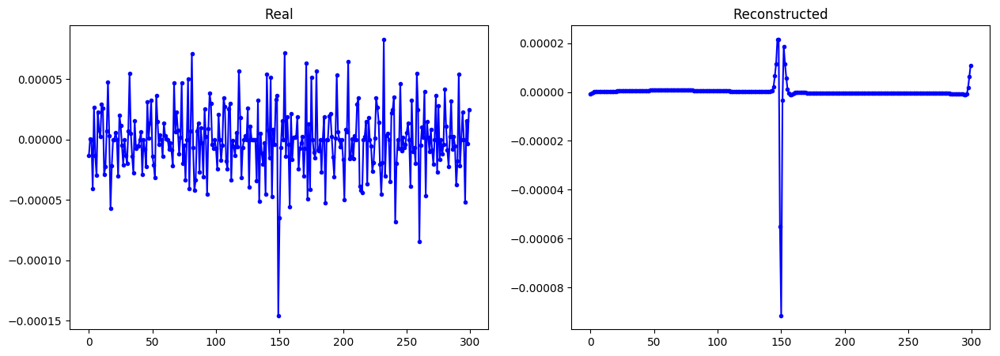

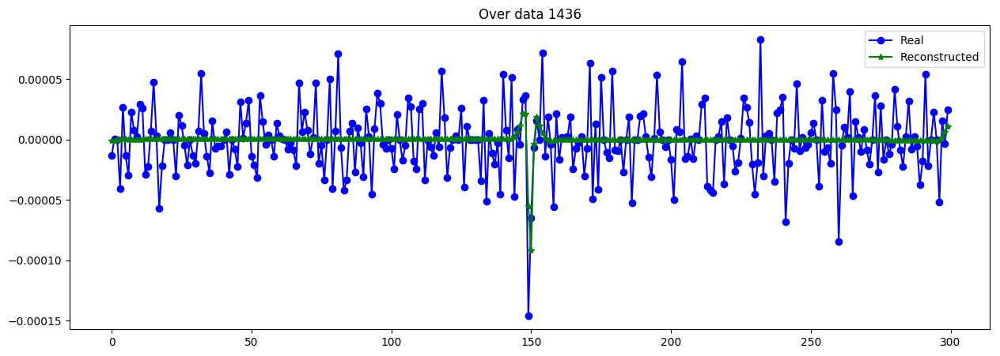

----------------------------------------------------------------


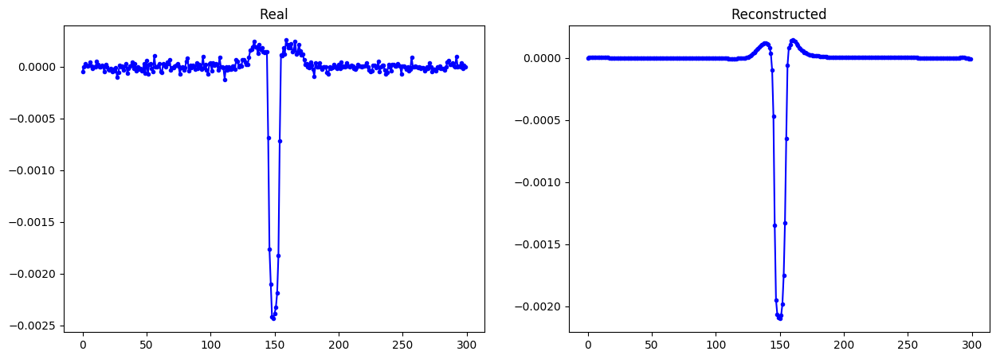

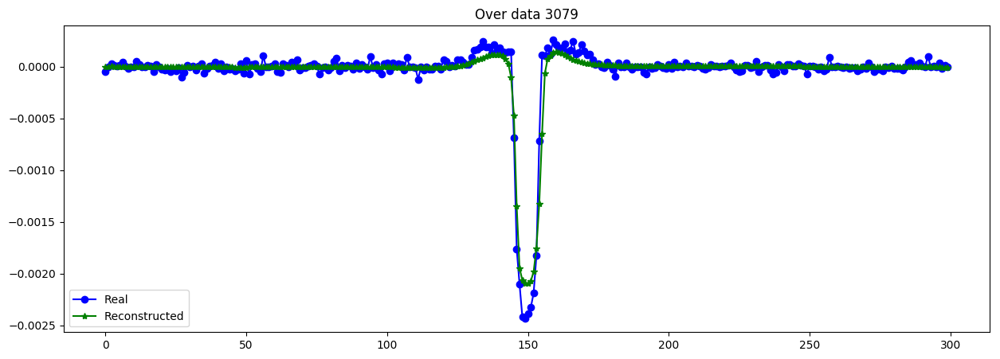

----------------------------------------------------------------


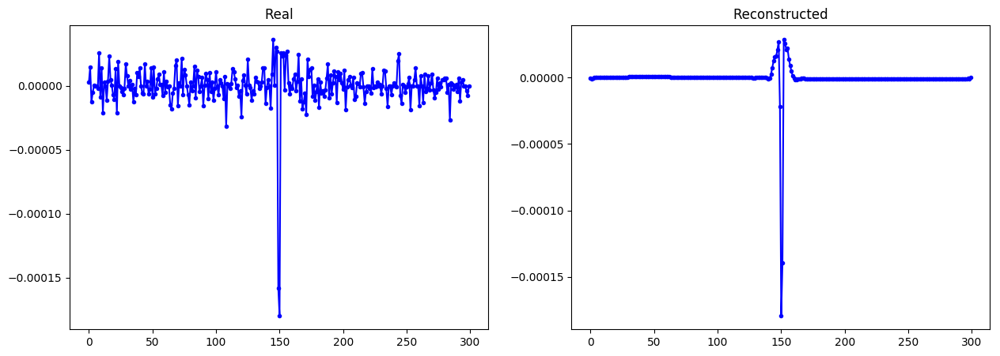

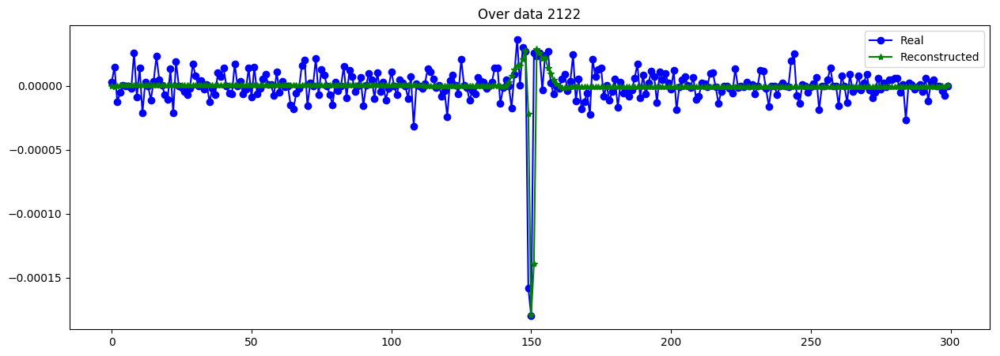

----------------------------------------------------------------


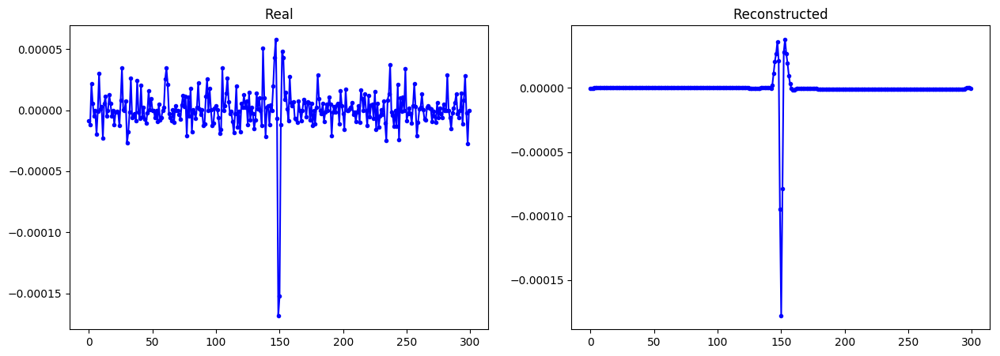

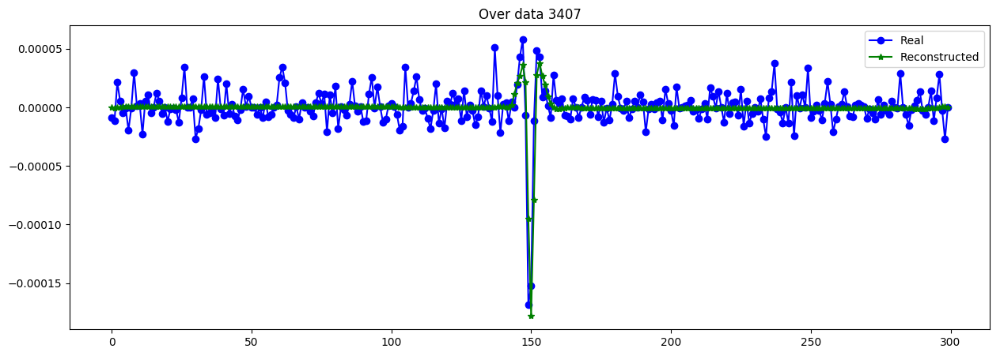

----------------------------------------------------------------


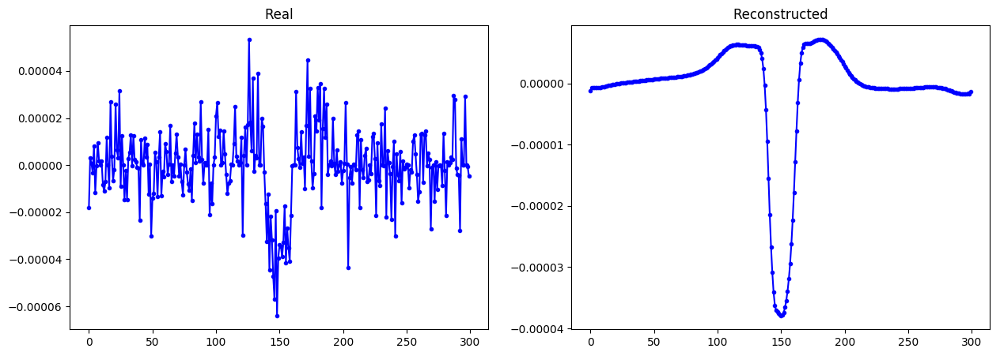

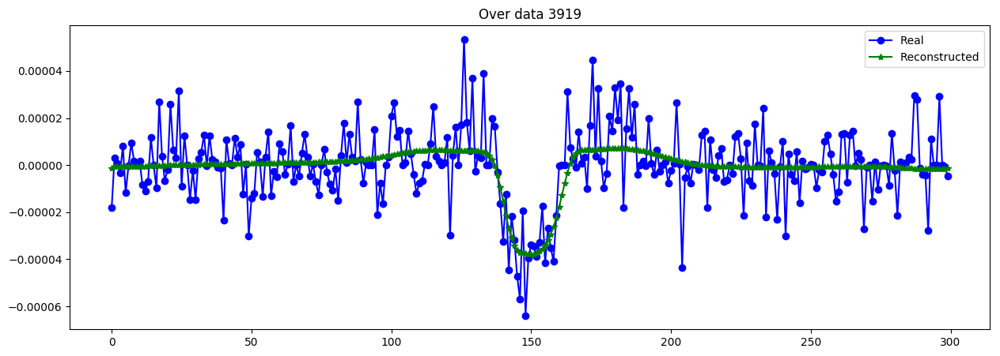

----------------------------------------------------------------


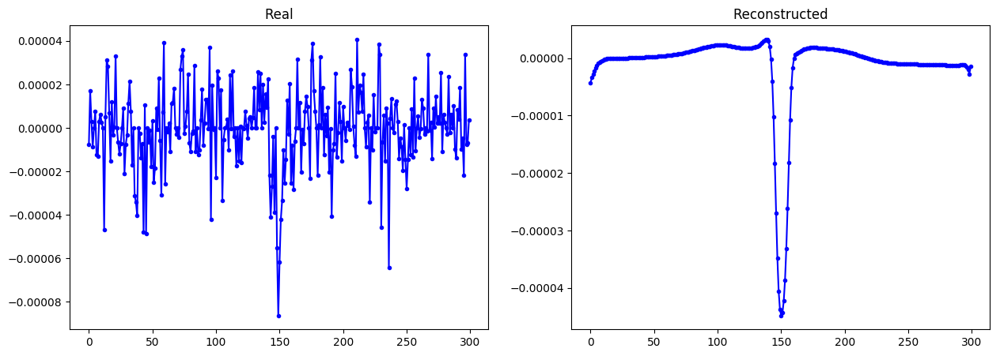

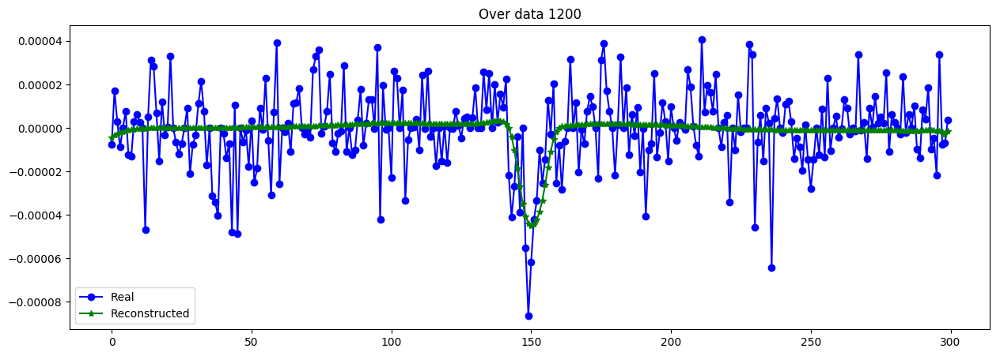

----------------------------------------------------------------


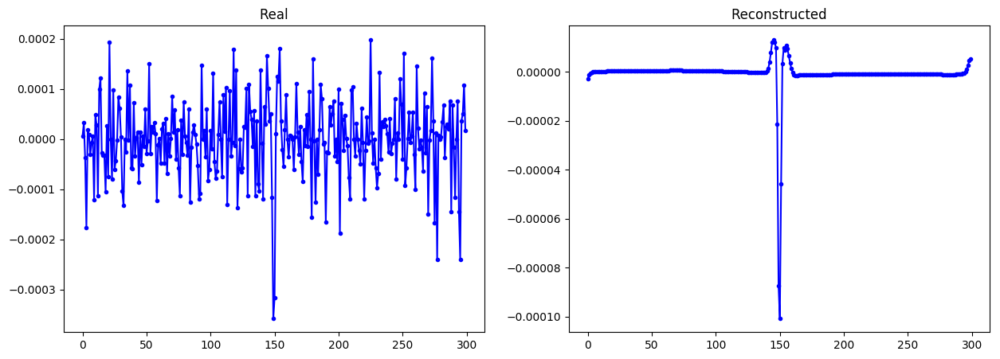

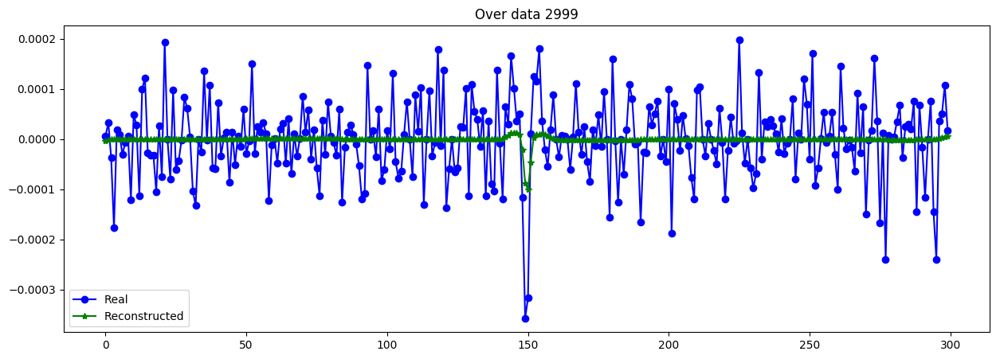

----------------------------------------------------------------


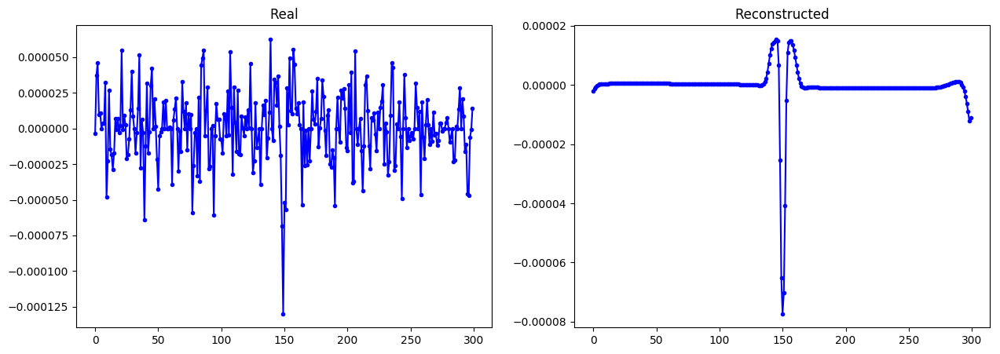

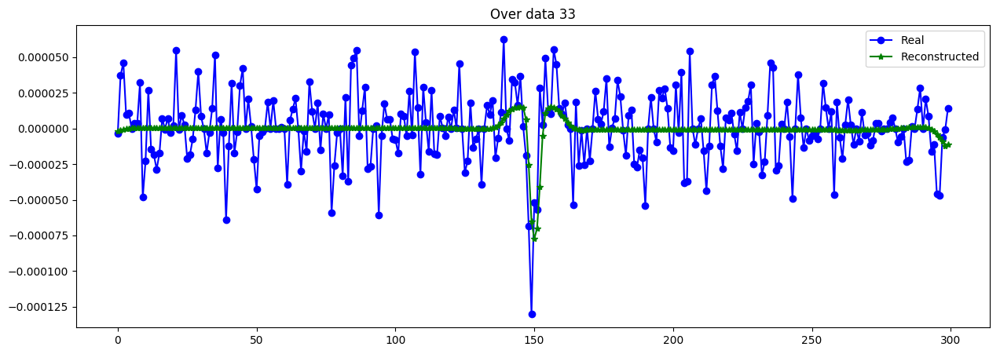

----------------------------------------------------------------


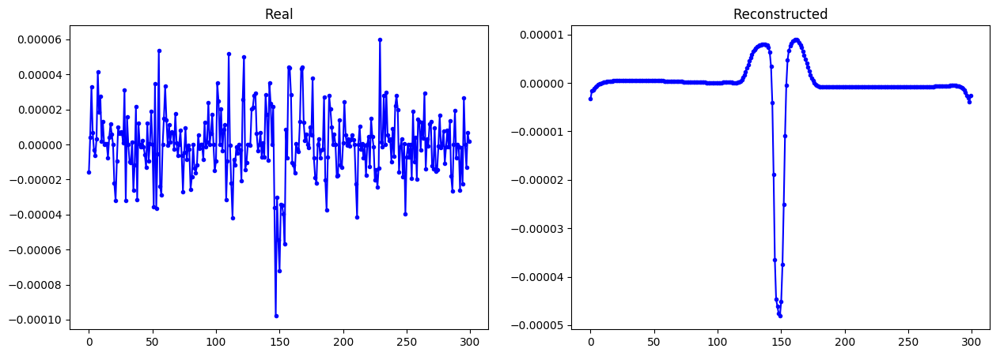

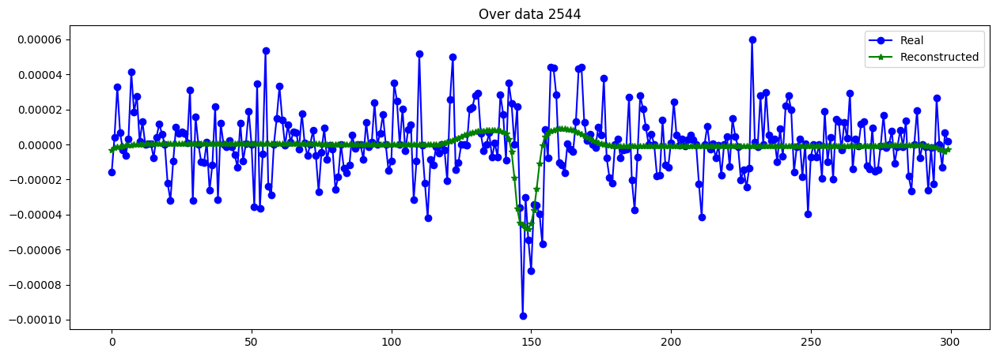

----------------------------------------------------------------


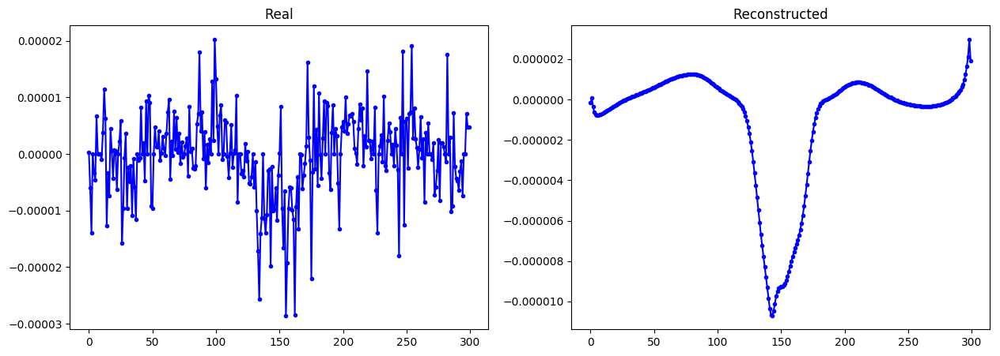

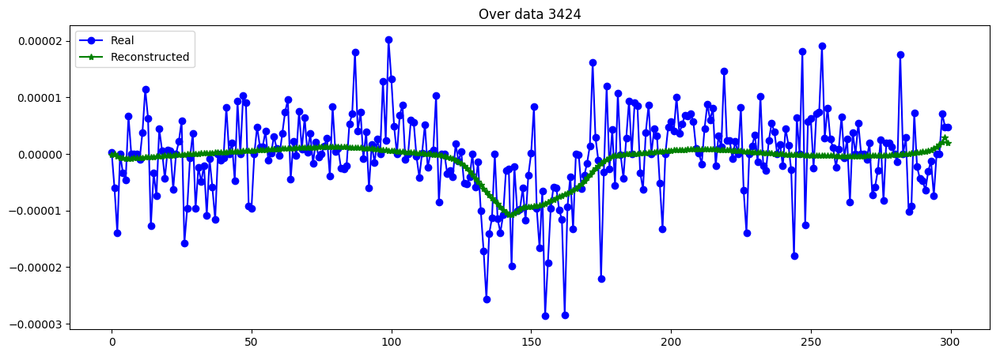

----------------------------------------------------------------


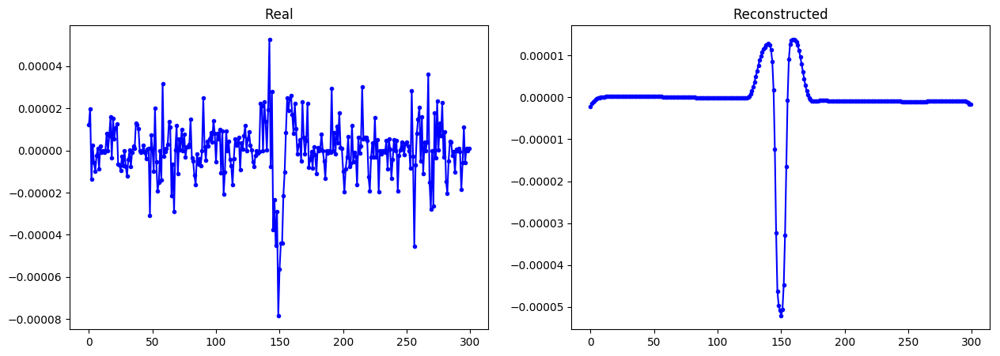

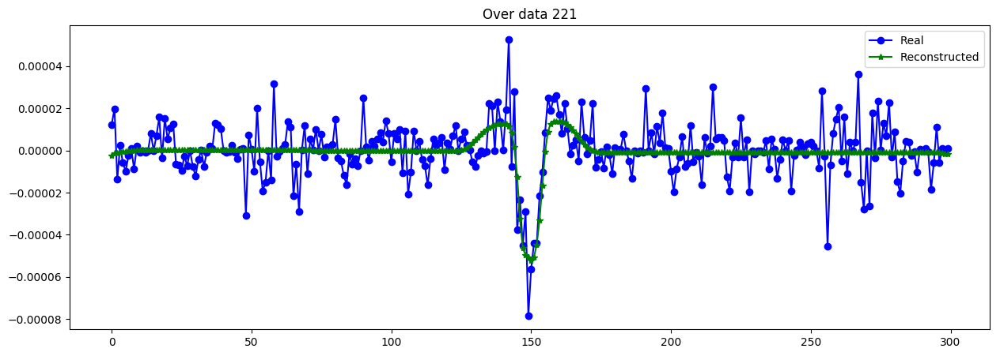

----------------------------------------------------------------


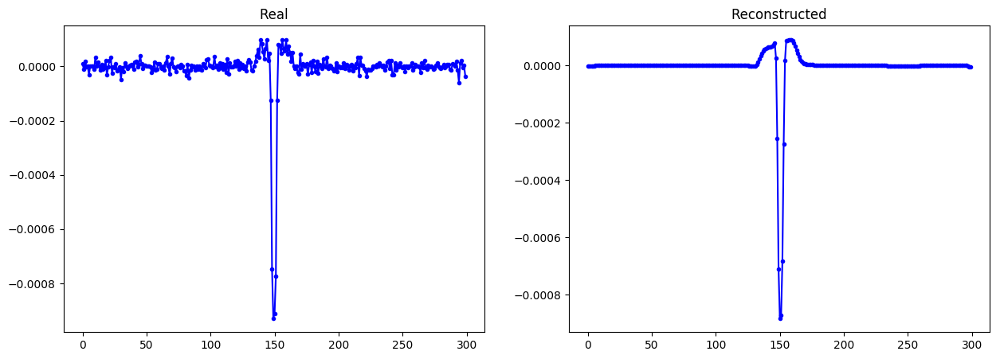

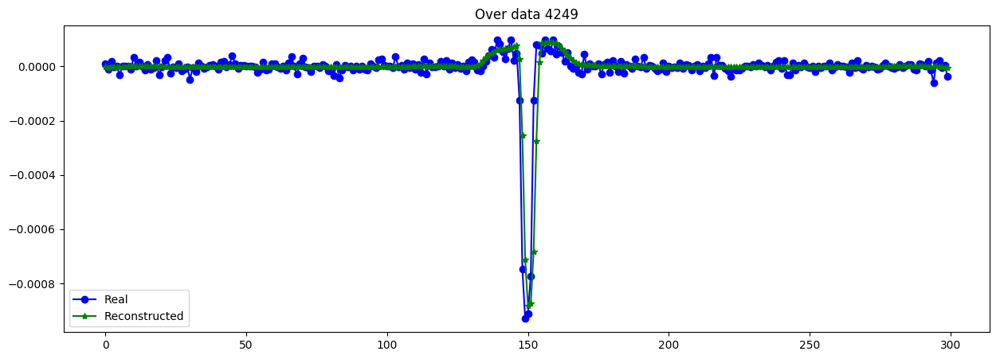

----------------------------------------------------------------


In [27]:
X_data_hat = Cvae.predict([X_data_t[:N_trans], X_data[:N_trans], Y_transit[:N_trans], S_data[:N_trans]], batch_size=512)
evaluate_reconst(X_data[:N_trans]/S_data[:N_trans,None,:], X_data_hat/S_data[:N_trans,None,:])

plot_n_lc(X_data[:N_trans,:,0], X_data_hat, n= 15)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


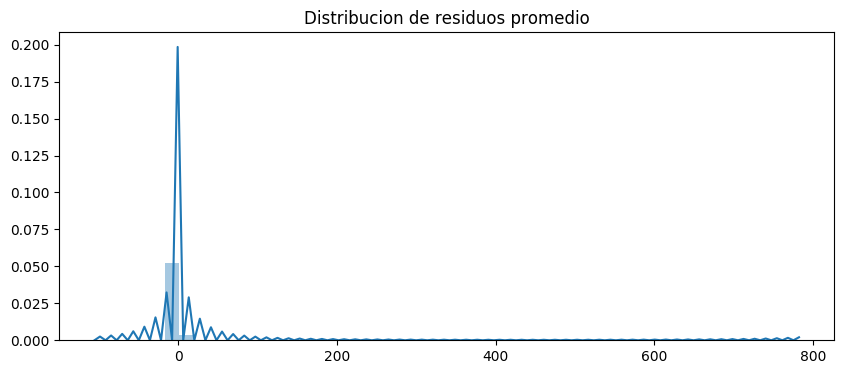

------------- Error -------------
RMSE (+-) =  2.834425063043044
MAE  (+-) =  0.941588551364428
------------- Smoothness -------------
AutoCorr lag-one =  0.8023704593574504
Diff MEAN =  0.2049755825334785
------------- Residual -------------
AutoCorr lag-one =  0.420017887872772
Permutation H =  0.9954987425992977
Spectral H =  0.8242656695788961
---------------------------------------


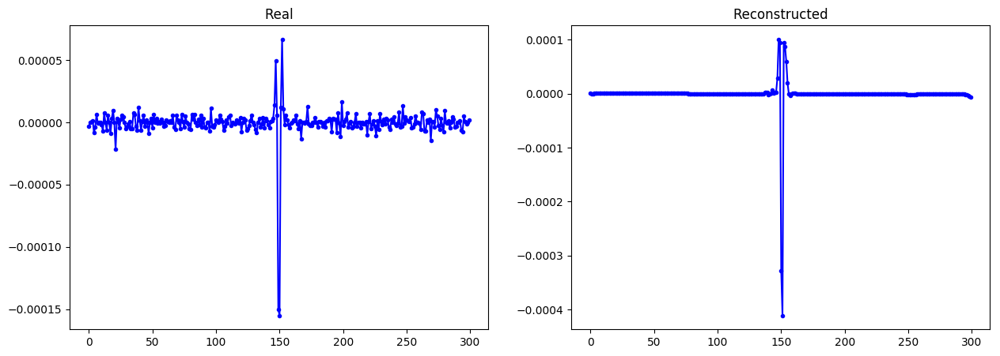

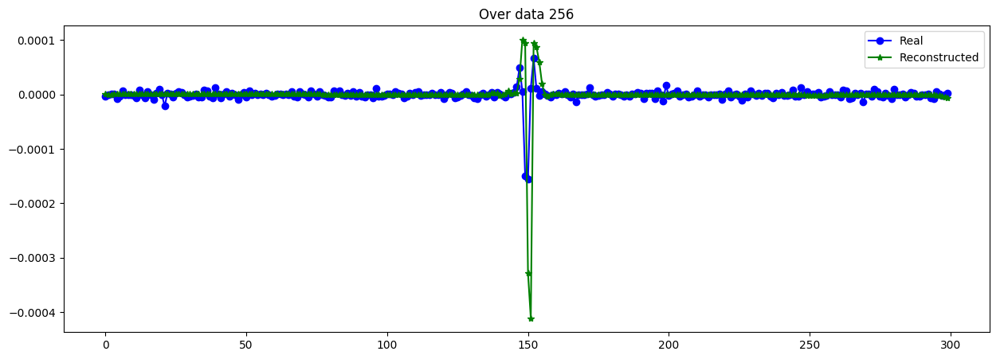

----------------------------------------------------------------


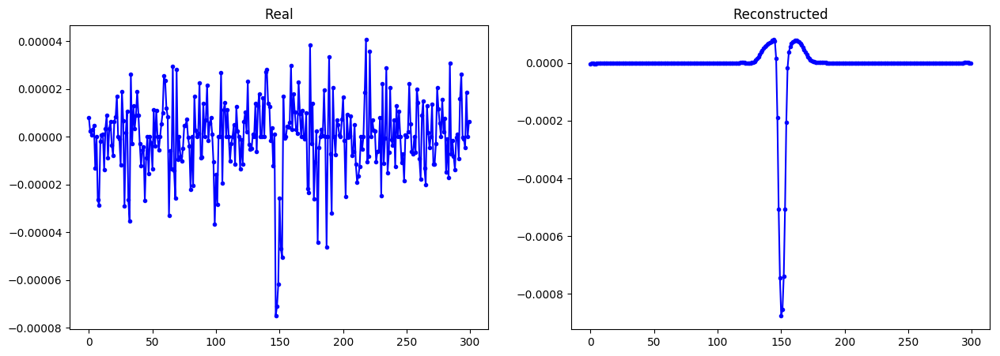

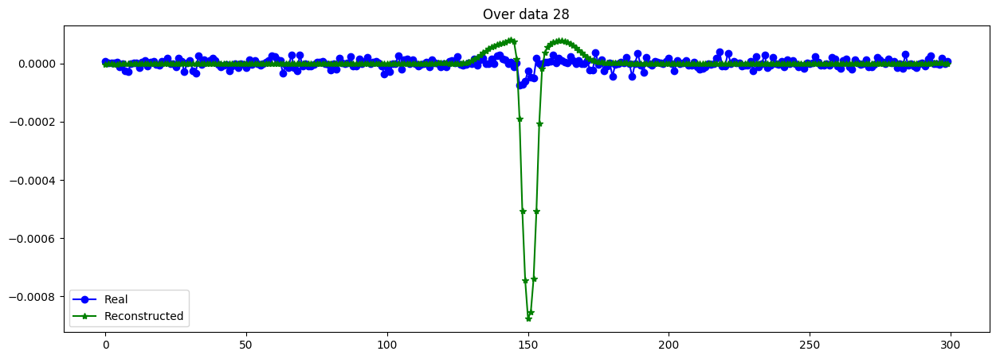

----------------------------------------------------------------


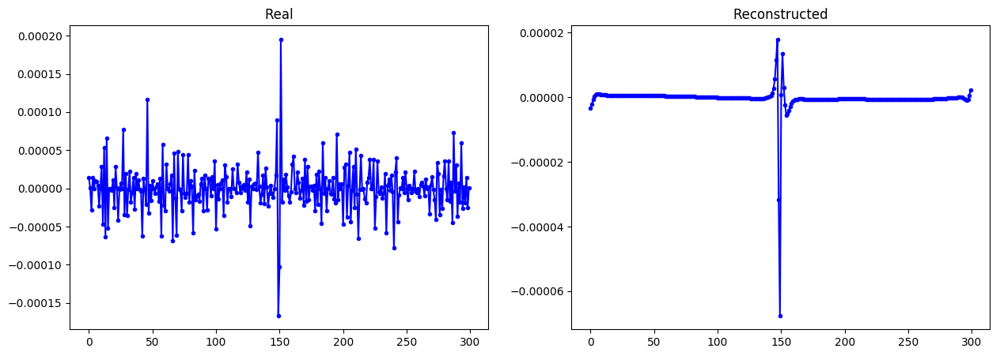

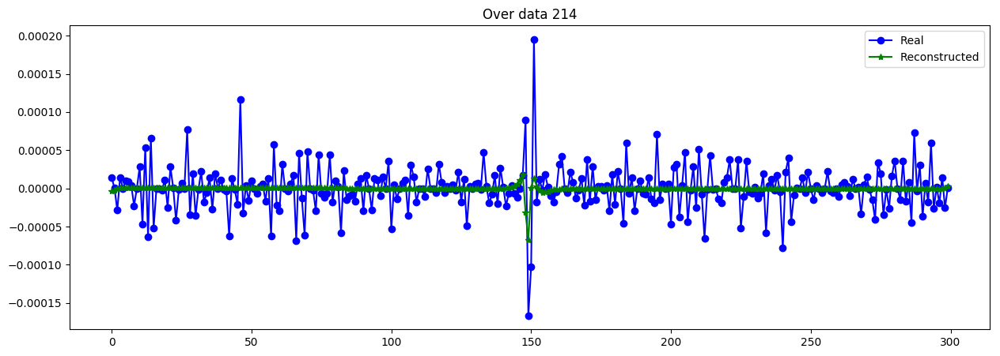

----------------------------------------------------------------


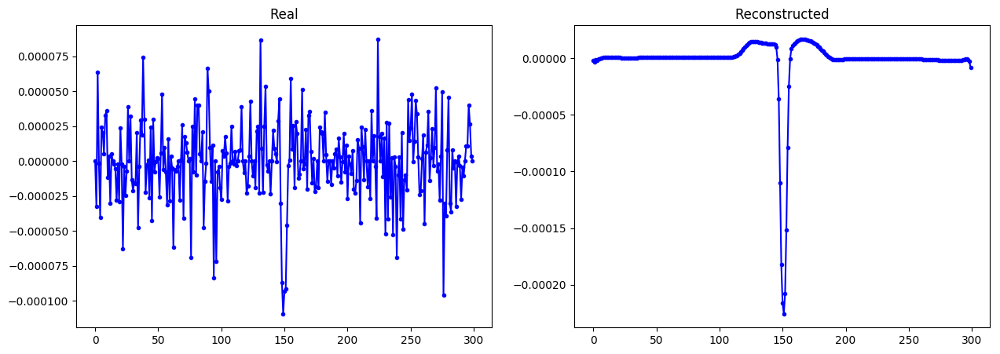

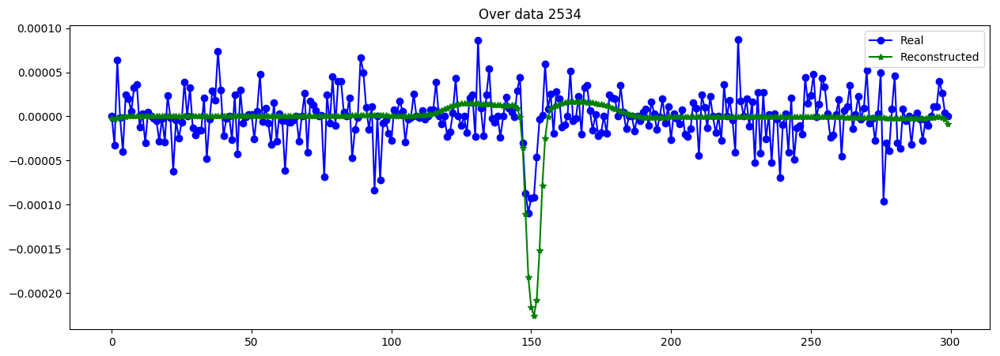

----------------------------------------------------------------


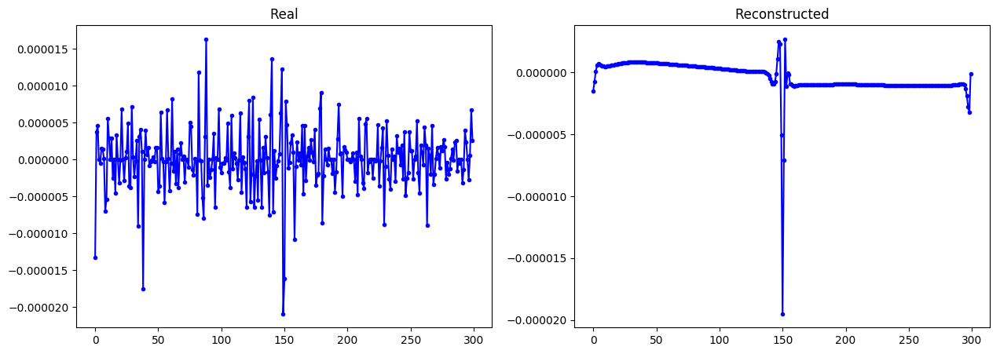

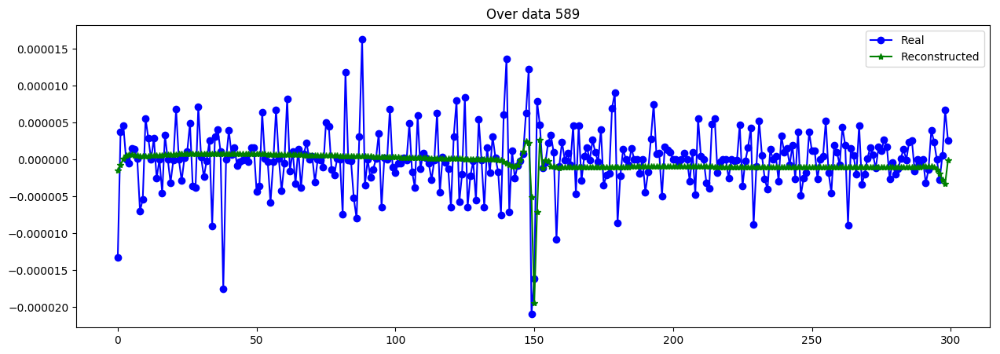

----------------------------------------------------------------


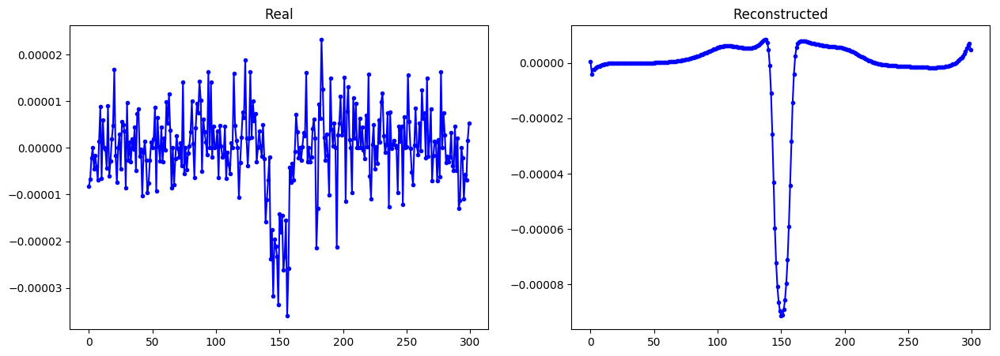

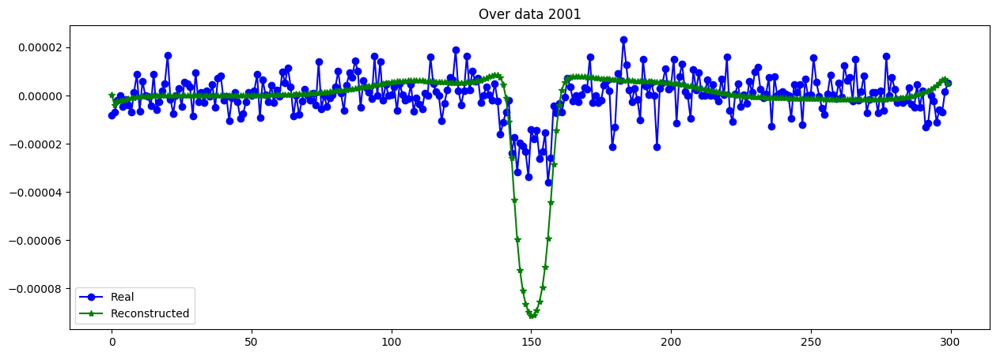

----------------------------------------------------------------


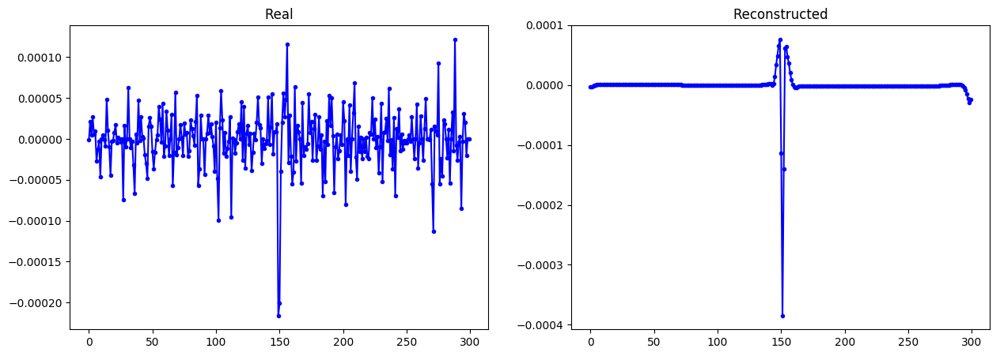

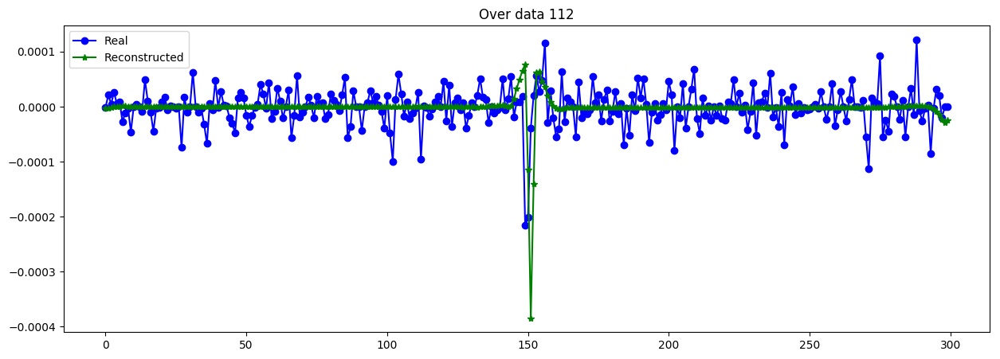

----------------------------------------------------------------


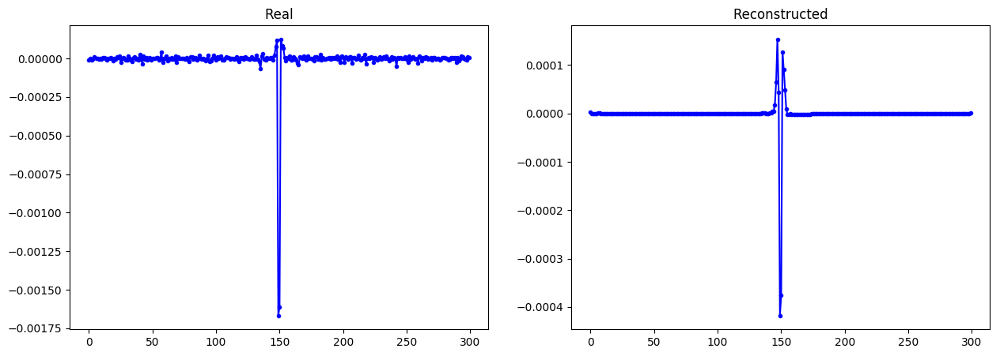

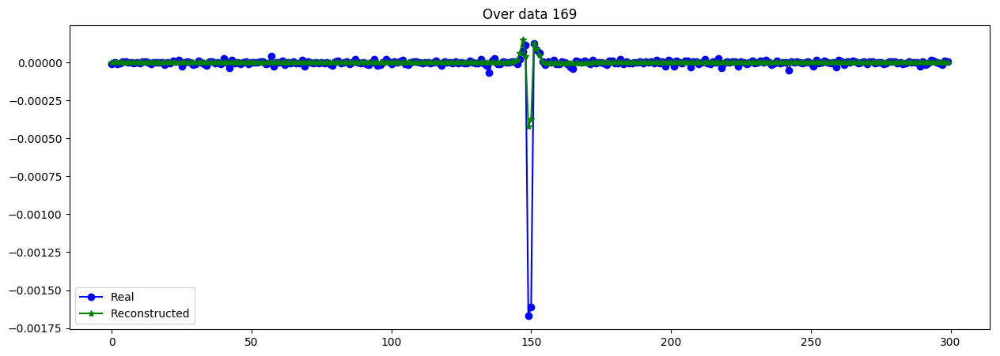

----------------------------------------------------------------


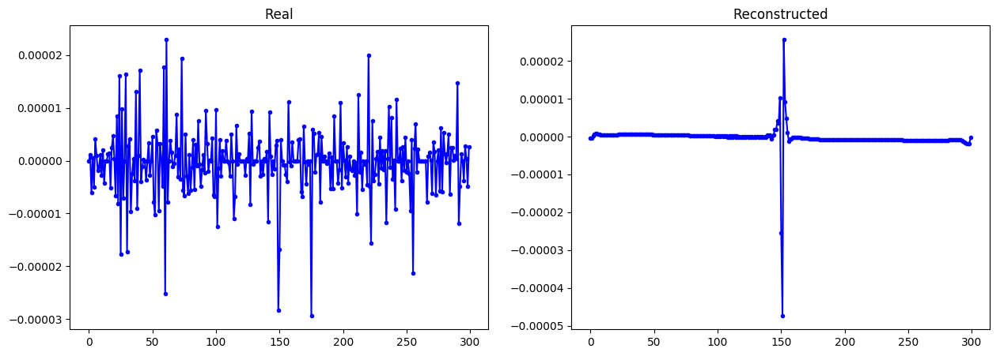

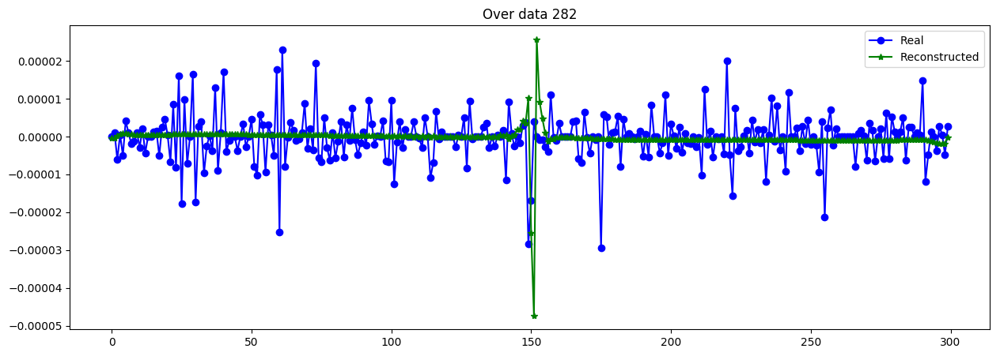

----------------------------------------------------------------


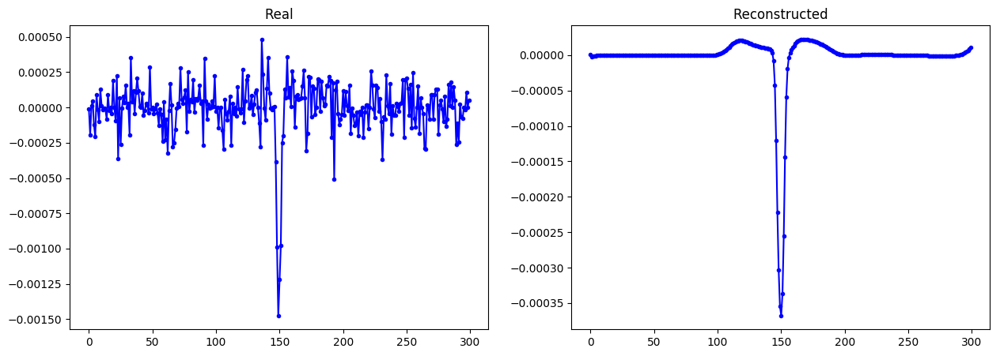

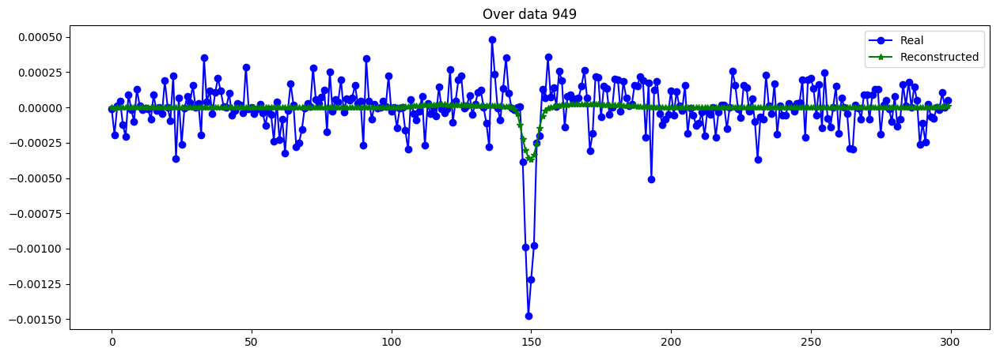

----------------------------------------------------------------


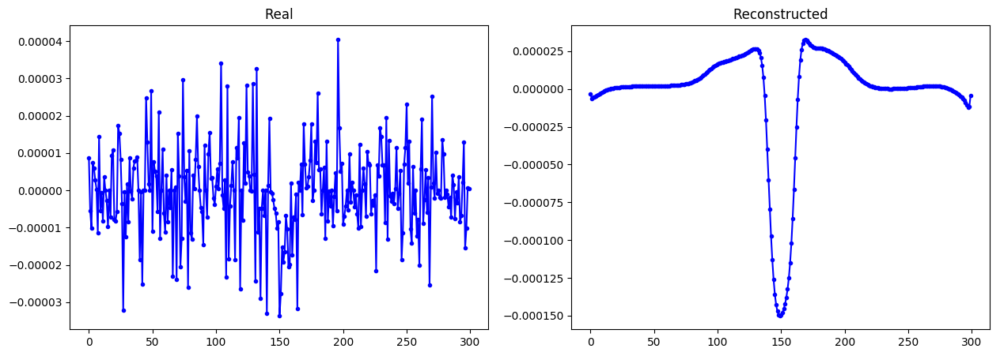

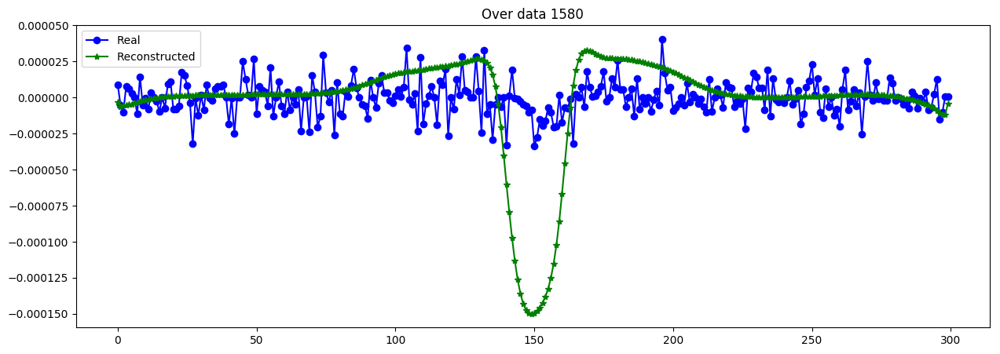

----------------------------------------------------------------


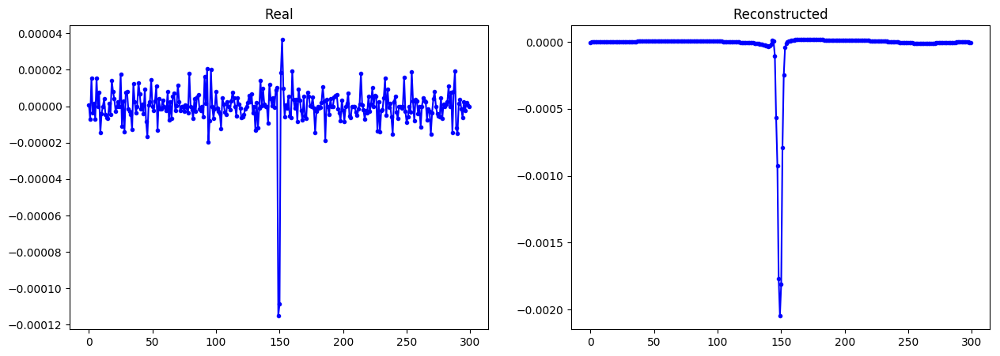

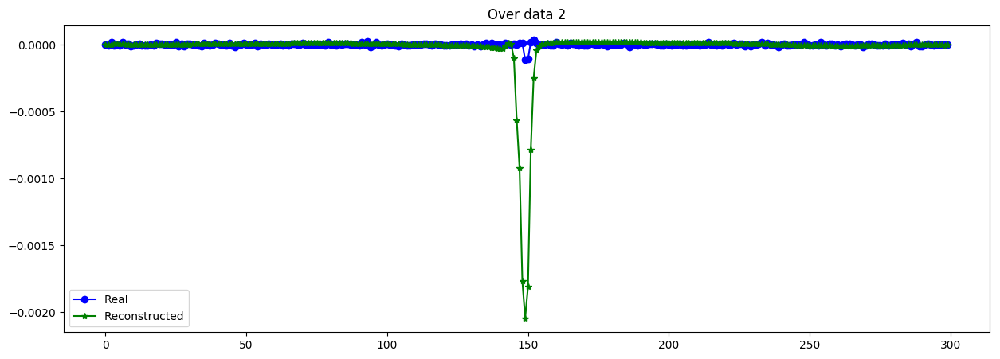

----------------------------------------------------------------


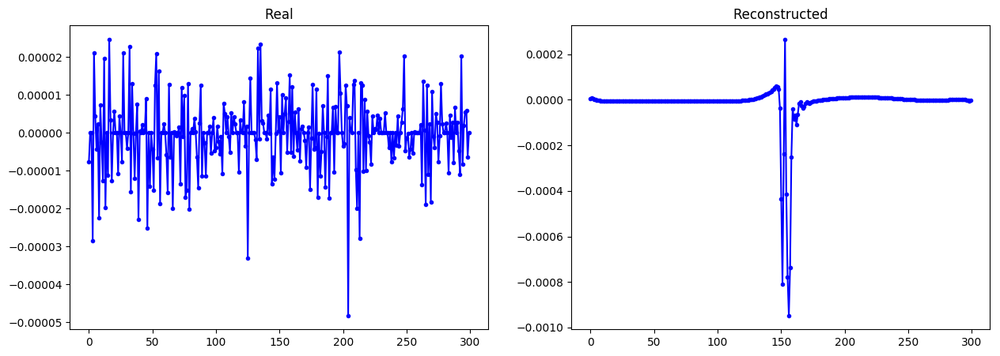

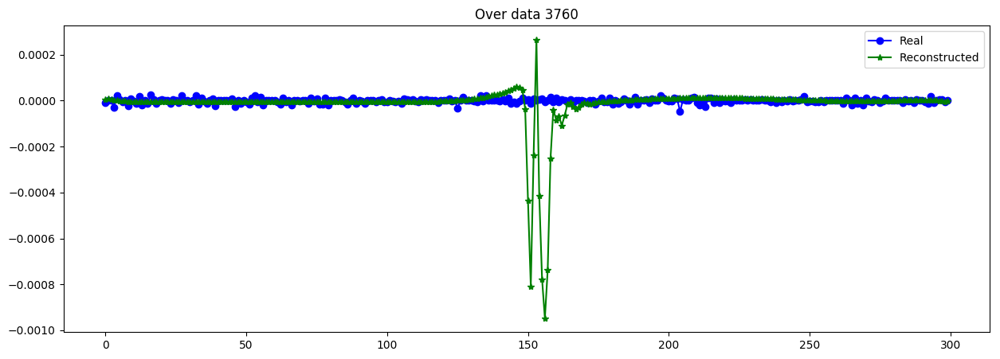

----------------------------------------------------------------


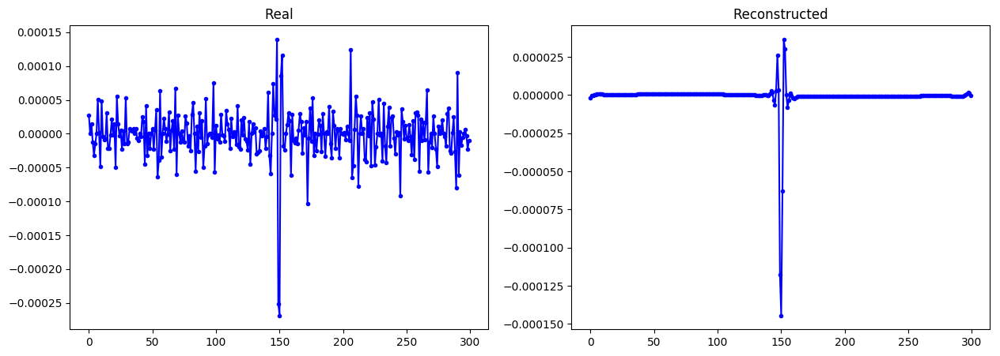

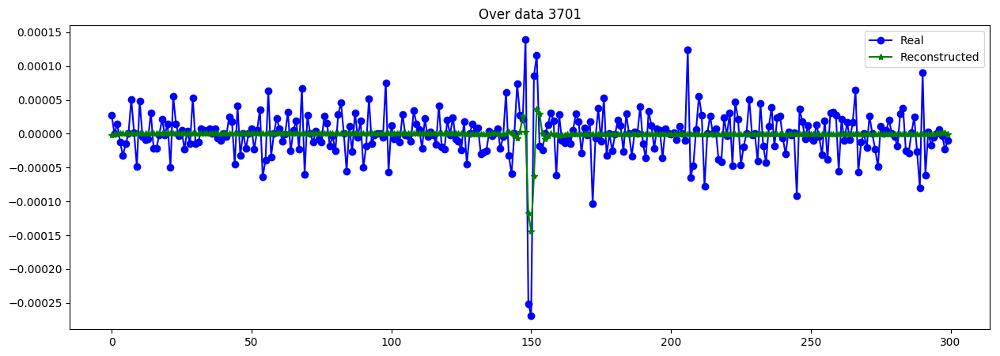

----------------------------------------------------------------


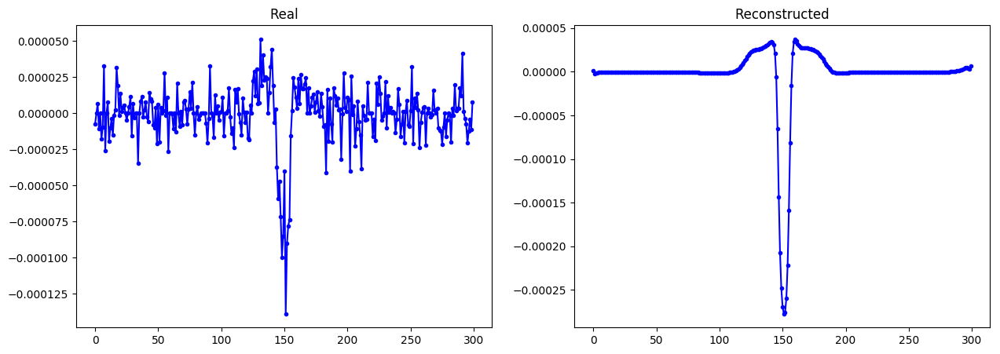

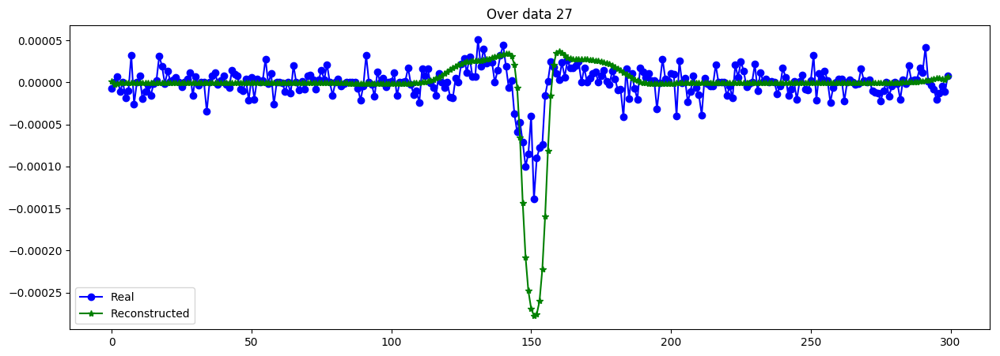

----------------------------------------------------------------


In [28]:
X_CVAE = simulate_CVAE(Cvae.get_layer("generator"), time_all, Y_values, batch_size=256)
X_data_CVAE = X_CVAE[mask_transit]

evaluate_reconst(X_data[:N_trans,:]/S_data[:N_trans,None], X_data_CVAE/S_data[:N_trans,None])

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15) #as MA-1

In [46]:
Cvae.get_layer("encoder").save_weights("./models/C-VAEscaleV2_MAL5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").save_weights("./models/C-VAEscaleV2_MAL5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

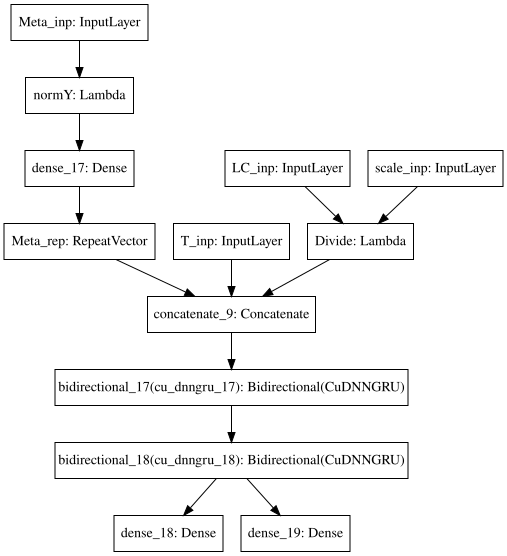

In [29]:
##### INPUTS ENCODER ######
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")
s_lc = Input(shape= (1,), name="scale_inp") #para pesar loss
y_lc = Input(shape = (D_dim,) , name ="Meta_inp")

x_lc_s = Lambda(Divide_layer, name="Divide")([x_lc, s_lc]) #quitar escala del dato (o escalar a una version normal)

##### CODIFY  METADATA ######
y_rep = Lambda(Norm_L, arguments={'mu':Ylog_mu,'std':Ylog_std}, name="normY")(y_lc)
y_rep = Dense(10, activation='tanh')(y_rep)
y_rept = RepeatVector(T, name="Meta_rep")(y_rep)

##### CONCATENATE TIME + LC + METADATA-> CODIFY ######
x = Concatenate(axis=-1)([x_t, x_lc_s, y_rept]) #has to be concatenate on axis -1
f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

##### CGET THE LATENT VARIABLE ######
z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc, y_lc, s_lc], [z_mean,z_log_var], name="encoder")
samp_model = define_samp_model(latent_dim) #model to sample

##### INPUTS DECODER ######
decoder_input = Input(shape=(latent_dim,), name="latent_inp")
decoder_inp_rep = RepeatVector(T, name="Enc_rep")(decoder_input)

##### CONCATENATE TIME + LATENT VARIABLE + CONDITIONAL -> DECODIFY LIGHT CURVE ######
decode = Concatenate(axis=-1)([x_t, decoder_inp_rep, y_rept]) #add time and metadata to decode
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
#decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

#####  RECONSTRUCT LIGHT CURVE BY SCALE  ######
decode = TimeDistributed(Dense(1, activation='linear'))(decode)
decode = Lambda(RevertNorm, arguments={'mu':0,'std':S_mu},name="revnormLC")(decode) #NEW: volver a escala normal 
generator = Model([x_t, decoder_input, y_lc], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_model(encoder([x_t, x_lc, y_lc, s_lc])), y_lc ])
Cvae = Model([x_t, x_lc, y_lc, s_lc], out)

#define loss functions over model components
smse_LC = SMSE_loss(s_lc)
kl_loss = KL_loss(z_mean, z_log_var)

def Wvae_loss(y_true, y_pred):    
    return smse_LC(y_true, y_pred) + l*kl_loss(y_true, y_pred)
Cvae.compile(optimizer='adam', loss=Wvae_loss, metrics = [smse_LC, kl_loss])

Cvae.get_layer("encoder").load_weights("./models/C-VAEscaleV3_MAL5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").load_weights("./models/C-VAEscaleV3_MAL5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

SVG(model_to_dot(Cvae.get_layer("encoder")).create(prog='dot', format='svg'))

In [48]:
Cvae.fit([X_data_t, X_data, Y_transit, S_data], X_data, epochs=400, batch_size=batch_size)

Epoch 1/400
8634/8634 [==============================] - 23s 3ms/step - loss: 2.2193 - SMSE: 2.2174 - KL: 1.9252
Epoch 2/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.1712 - SMSE: 1.1659 - KL: 5.2453
Epoch 3/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.1255 - SMSE: 1.1166 - KL: 8.9637
Epoch 4/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0795 - SMSE: 1.0676 - KL: 11.9209
Epoch 5/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0294 - SMSE: 1.0162 - KL: 13.1870
Epoch 6/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0358 - SMSE: 1.0231 - KL: 12.6950
Epoch 7/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0272 - SMSE: 1.0141 - KL: 13.1096
Epoch 8/400
8634/8634 [==============================] - 17s 2ms/step - loss: 1.0448 - SMSE: 1.0327 - KL: 12.0278
Epoch 9/400
8634/8634 [==============================] - 18s 2ms/step - loss: 1.0459 - SMSE

8634/8634 [==============================] - 17s 2ms/step - loss: 0.9039 - SMSE: 0.8917 - KL: 12.1995
Epoch 144/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.9000 - SMSE: 0.8885 - KL: 11.5186
Epoch 145/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.9026 - SMSE: 0.8913 - KL: 11.3109
Epoch 146/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.9077 - SMSE: 0.8967 - KL: 10.9597
Epoch 147/400
8634/8634 [==============================] - 18s 2ms/step - loss: 0.8998 - SMSE: 0.8882 - KL: 11.6170
Epoch 148/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8950 - SMSE: 0.8836 - KL: 11.4224
Epoch 149/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8967 - SMSE: 0.8849 - KL: 11.8751
Epoch 150/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.9027 - SMSE: 0.8921 - KL: 10.5632
Epoch 151/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.8933

8634/8634 [==============================] - 17s 2ms/step - loss: 0.7462 - SMSE: 0.7320 - KL: 14.2141
Epoch 284/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7509 - SMSE: 0.7362 - KL: 14.7395
Epoch 285/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7332 - SMSE: 0.7188 - KL: 14.3776
Epoch 286/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7362 - SMSE: 0.7218 - KL: 14.4089
Epoch 287/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7406 - SMSE: 0.7264 - KL: 14.2521
Epoch 288/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7449 - SMSE: 0.7304 - KL: 14.5669
Epoch 289/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7474 - SMSE: 0.7327 - KL: 14.6762
Epoch 290/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7555 - SMSE: 0.7405 - KL: 15.0088
Epoch 291/400
8634/8634 [==============================] - 17s 2ms/step - loss: 0.7421

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


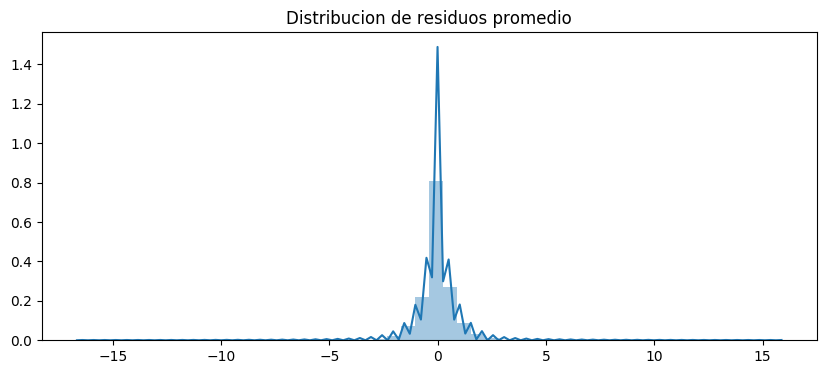

------------- Error -------------
RMSE (+-) =  0.7336620576366537
MAE  (+-) =  0.4932532436879404
------------- Smoothness -------------
AutoCorr lag-one =  0.691467521211431
Diff MEAN =  0.05221280839750047
------------- Residual -------------
AutoCorr lag-one =  0.0008439389155561205
Permutation H =  0.9958019731223932
Spectral H =  0.8941770190960702
---------------------------------------


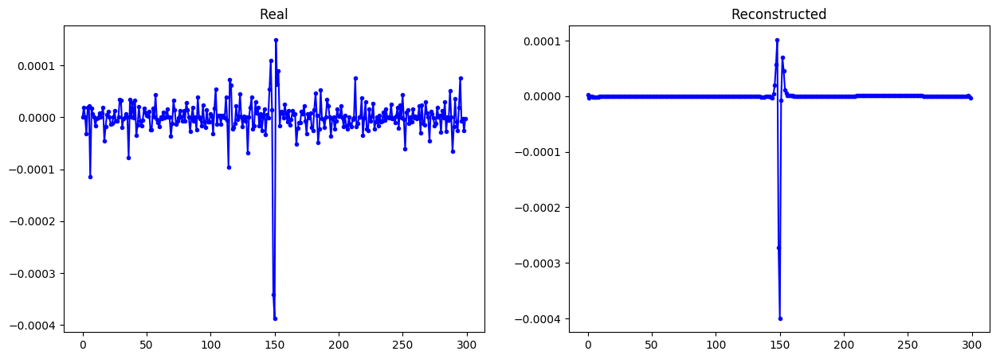

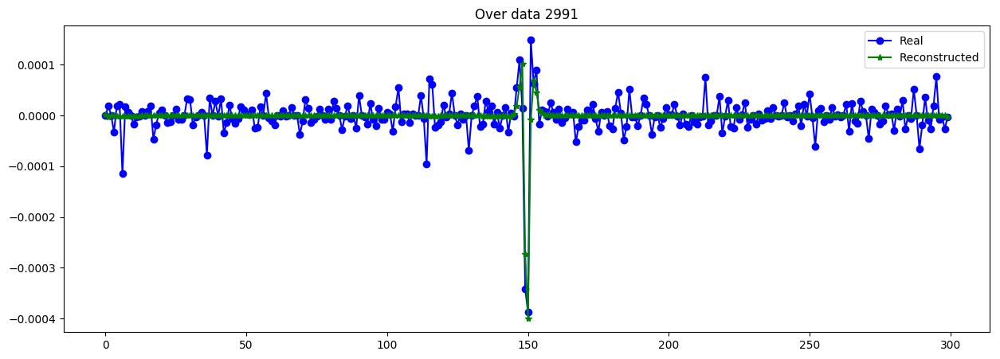

----------------------------------------------------------------


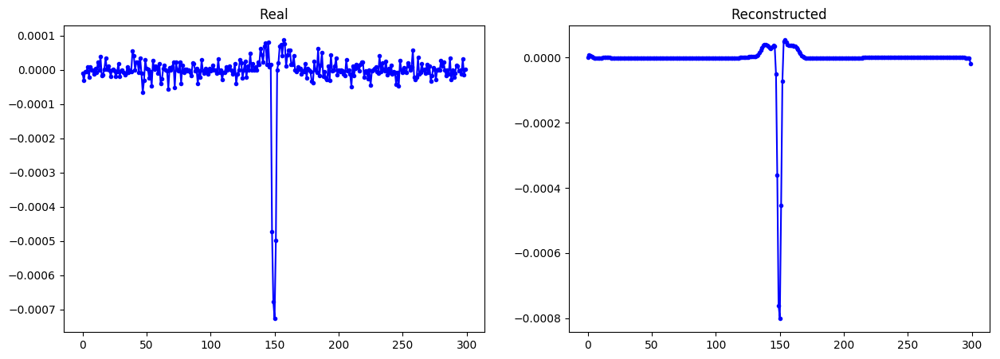

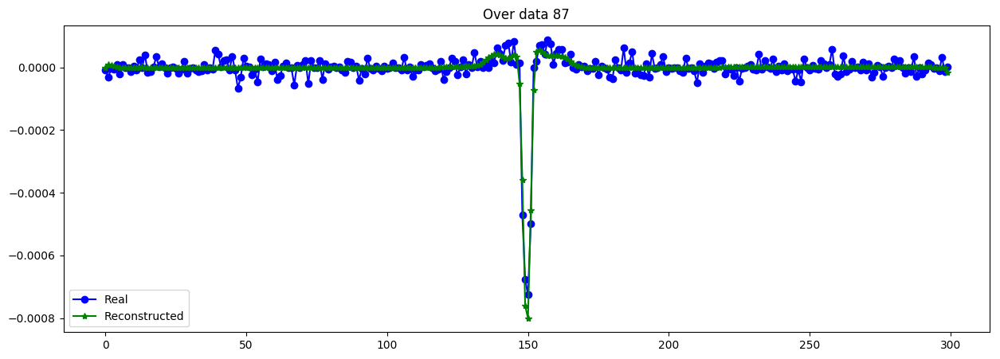

----------------------------------------------------------------


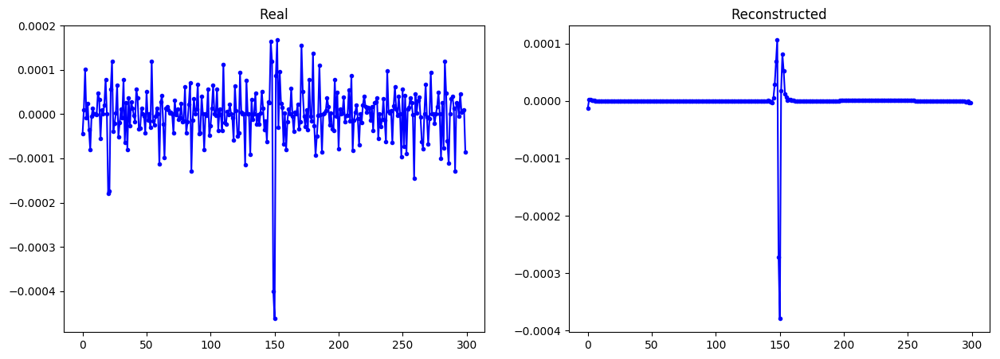

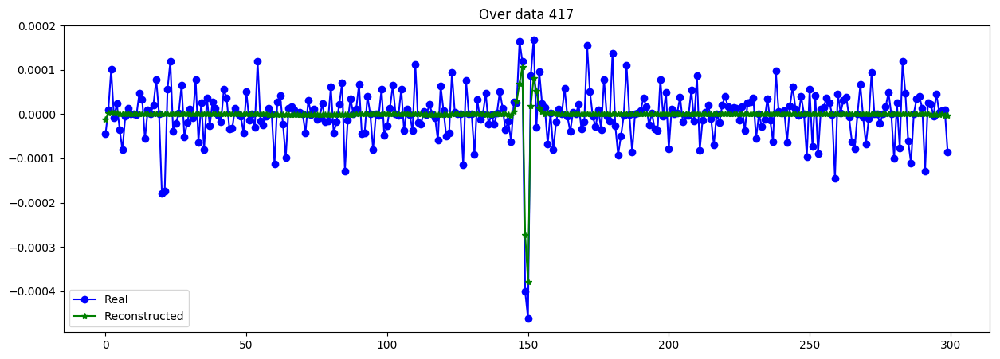

----------------------------------------------------------------


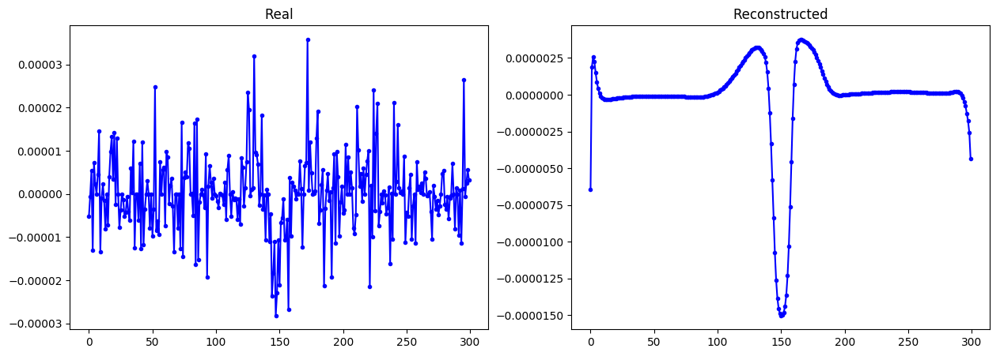

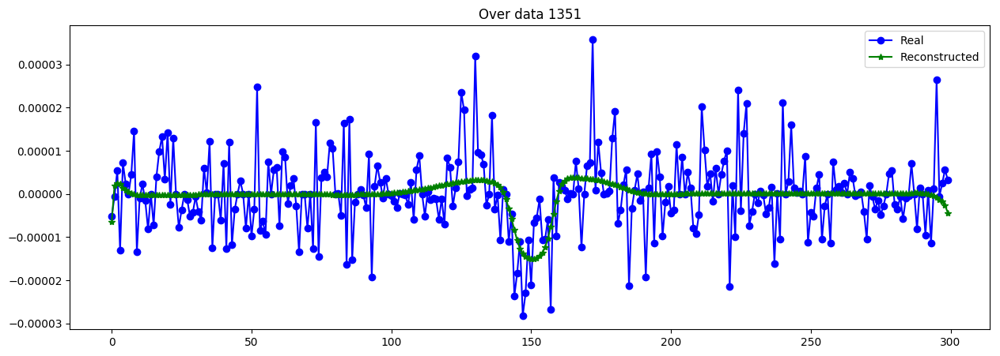

----------------------------------------------------------------


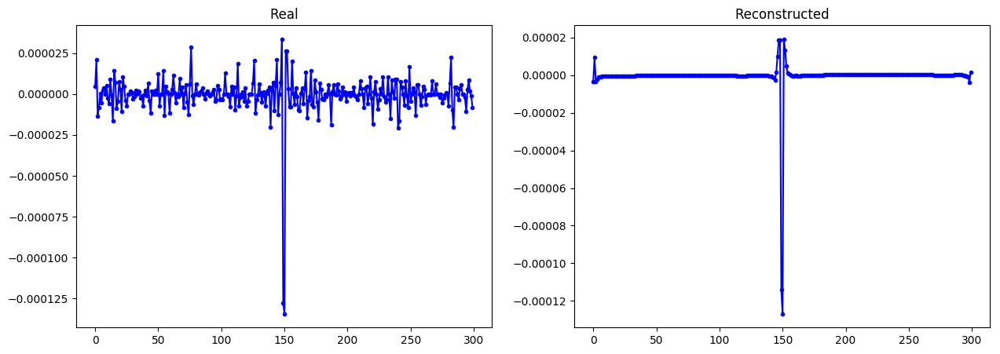

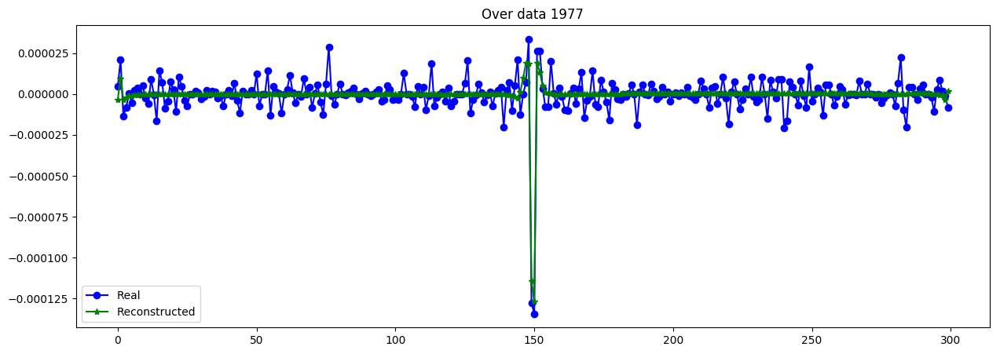

----------------------------------------------------------------


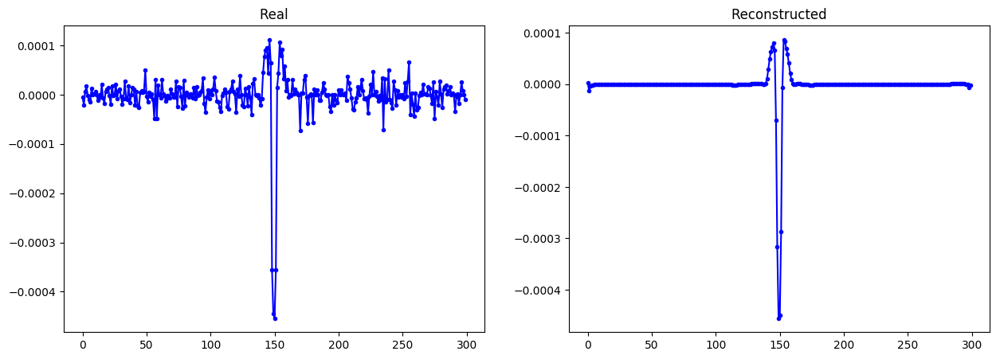

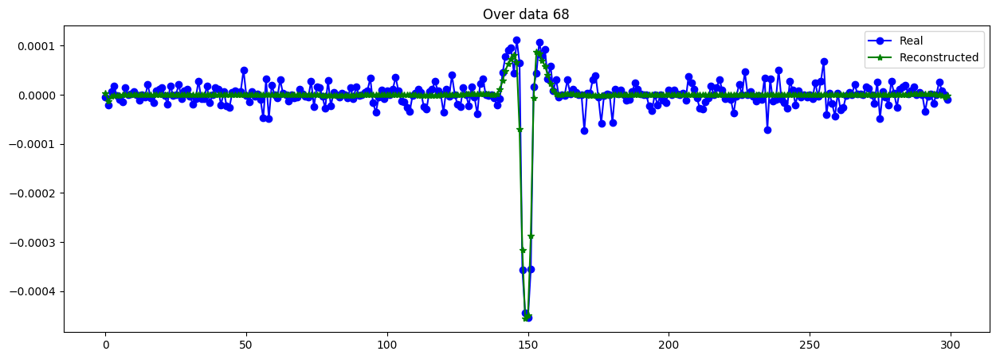

----------------------------------------------------------------


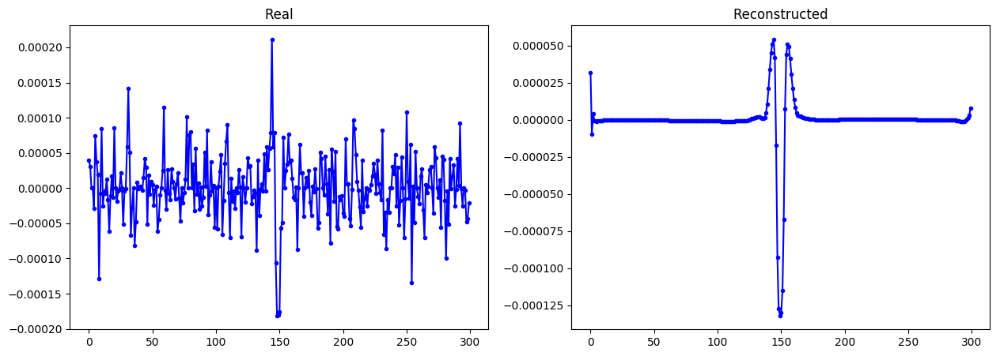

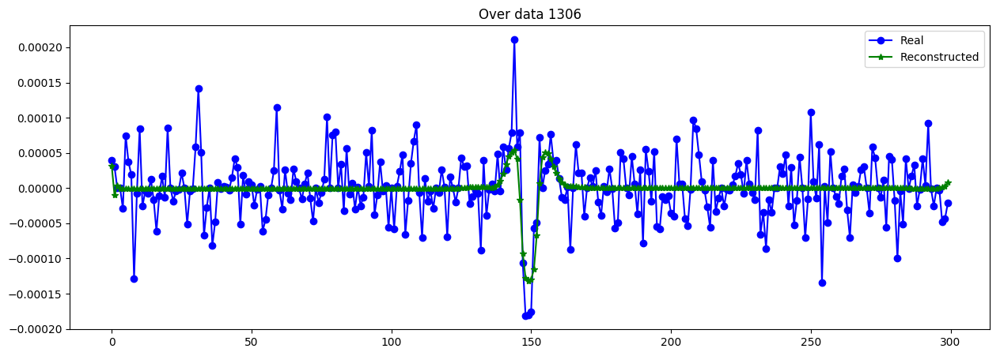

----------------------------------------------------------------


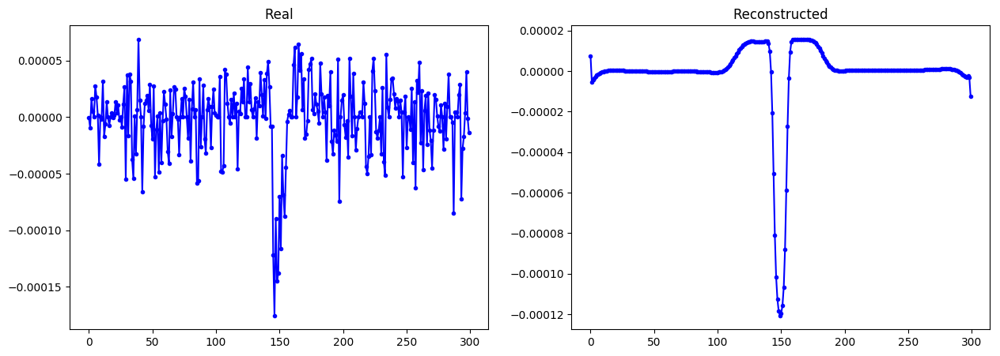

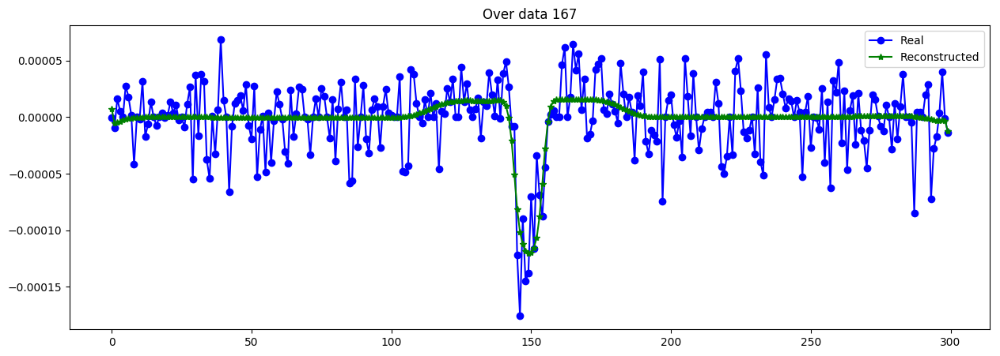

----------------------------------------------------------------


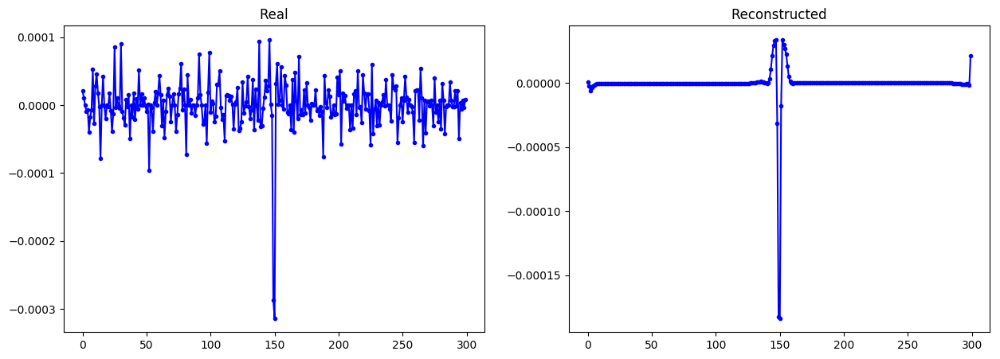

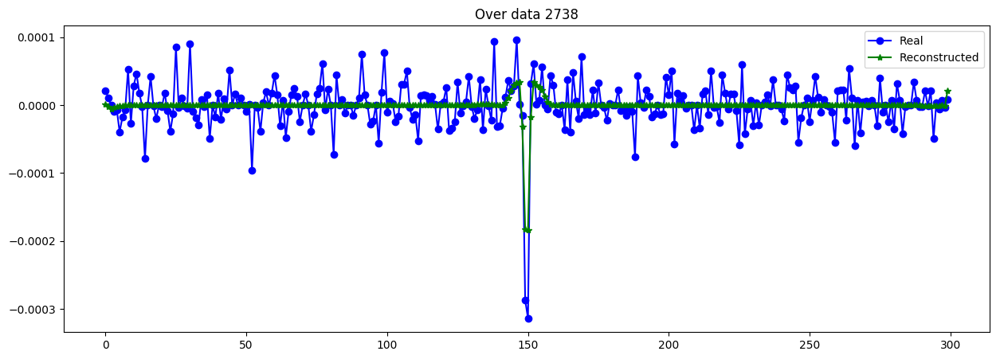

----------------------------------------------------------------


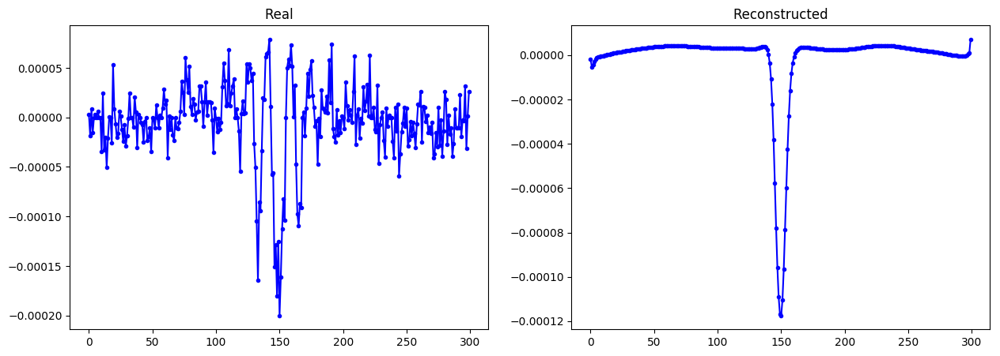

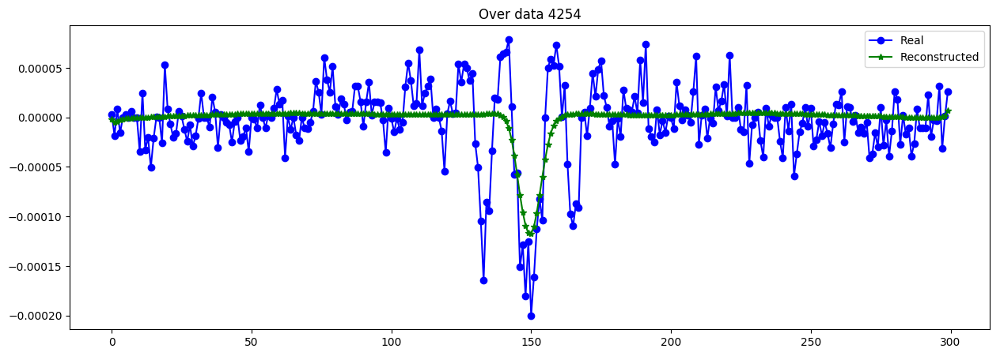

----------------------------------------------------------------


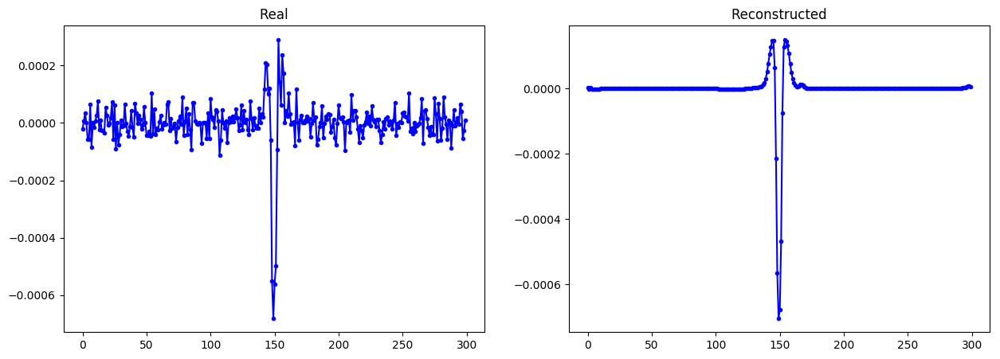

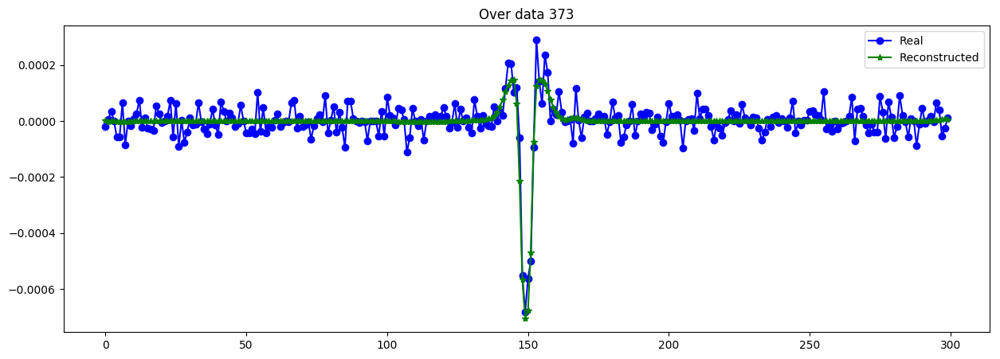

----------------------------------------------------------------


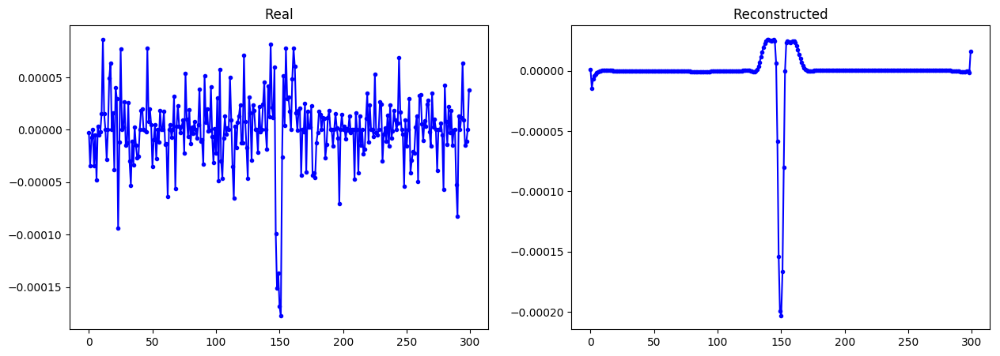

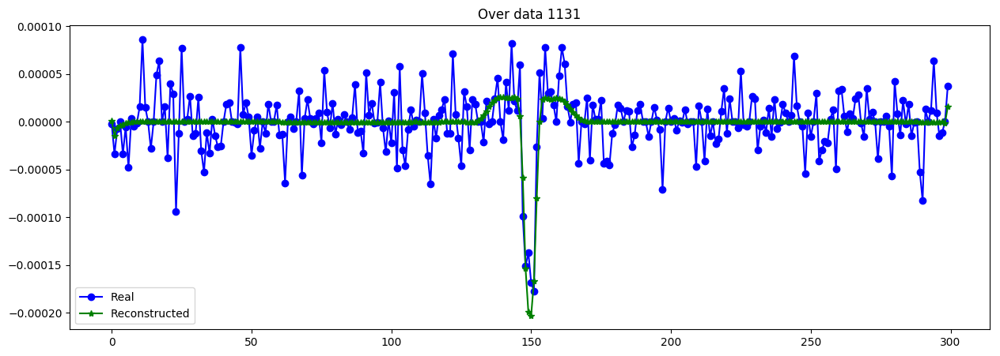

----------------------------------------------------------------


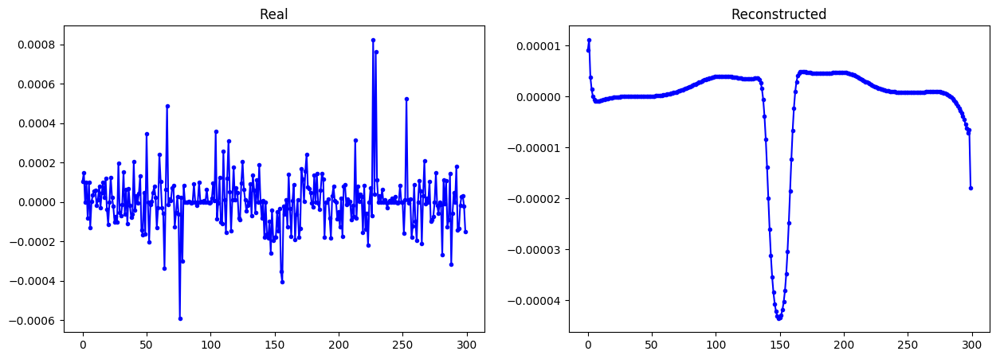

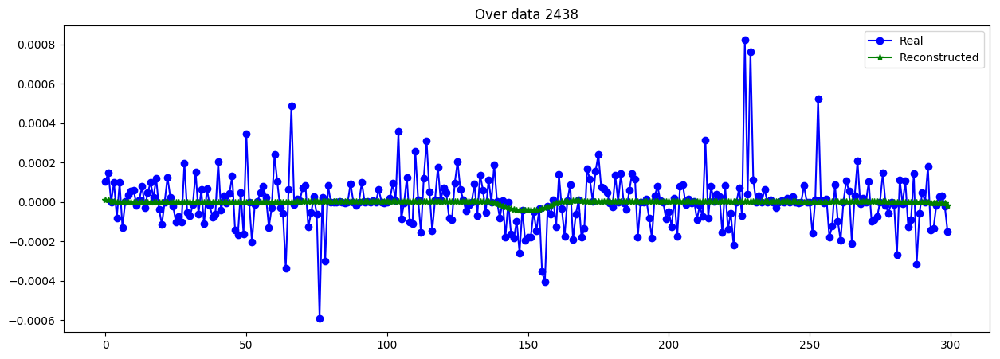

----------------------------------------------------------------


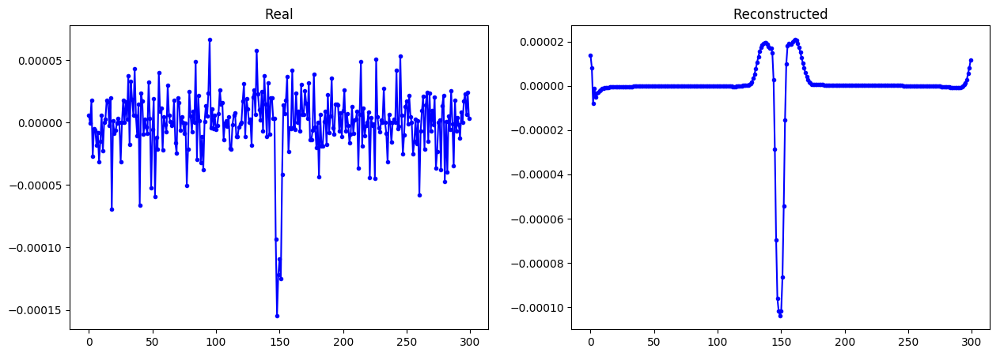

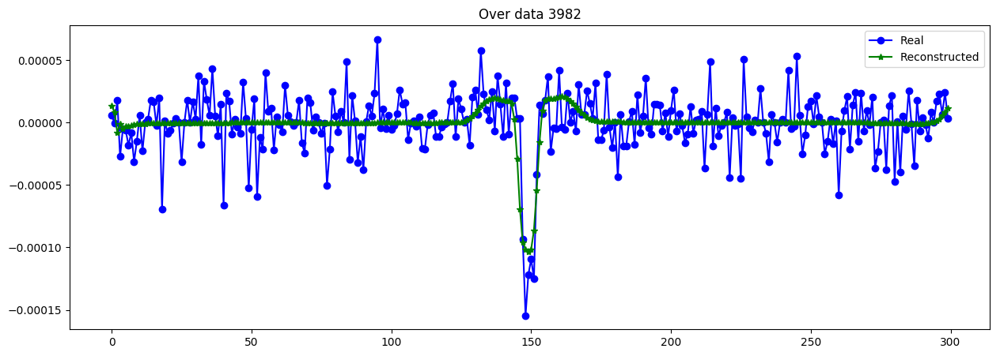

----------------------------------------------------------------


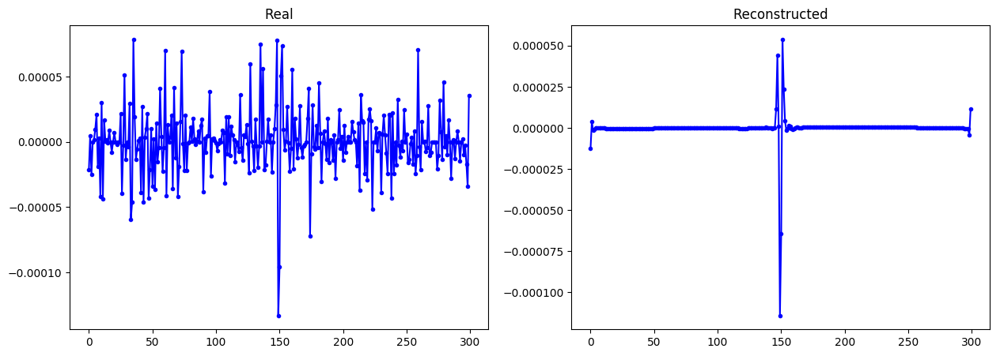

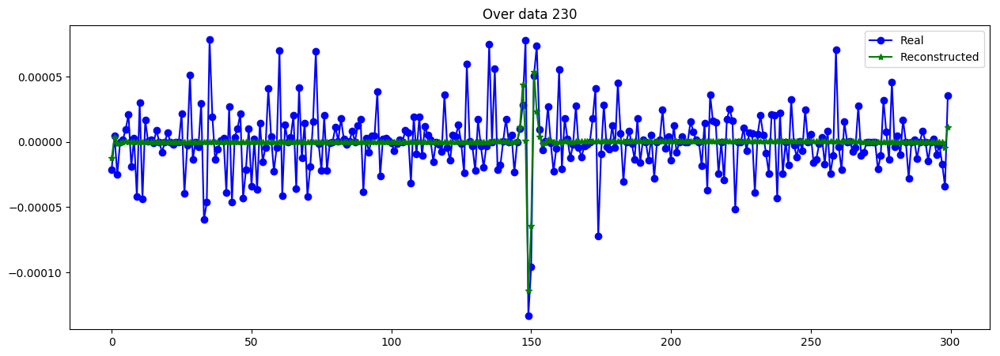

----------------------------------------------------------------


In [30]:
X_data_hat = Cvae.predict([X_data_t[:N_trans], X_data[:N_trans], Y_transit[:N_trans], S_data[:N_trans]], batch_size=512)
evaluate_reconst(X_data[:N_trans]/S_data[:N_trans,None,:], X_data_hat/S_data[:N_trans,None,:])

plot_n_lc(X_data[:N_trans,:,0], X_data_hat, n= 15)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


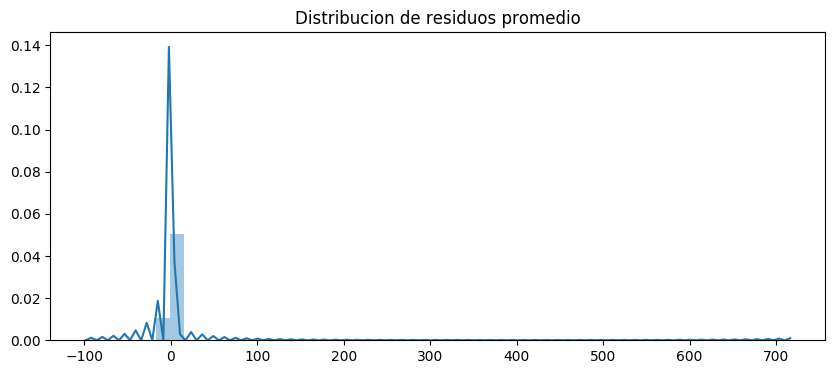

------------- Error -------------
RMSE (+-) =  2.5788315102874098
MAE  (+-) =  0.9621959988703415
------------- Smoothness -------------
AutoCorr lag-one =  0.7366871452809076
Diff MEAN =  0.18291081522783273
------------- Residual -------------
AutoCorr lag-one =  0.3942100228262051
Permutation H =  0.9953706596203656
Spectral H =  0.812995942938877
---------------------------------------


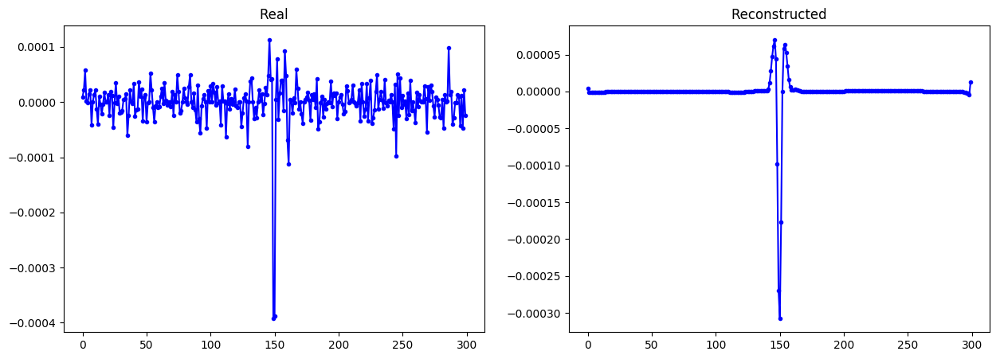

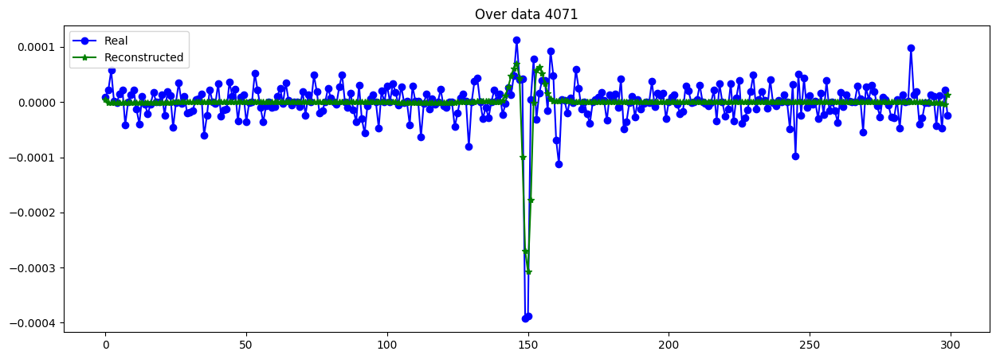

----------------------------------------------------------------


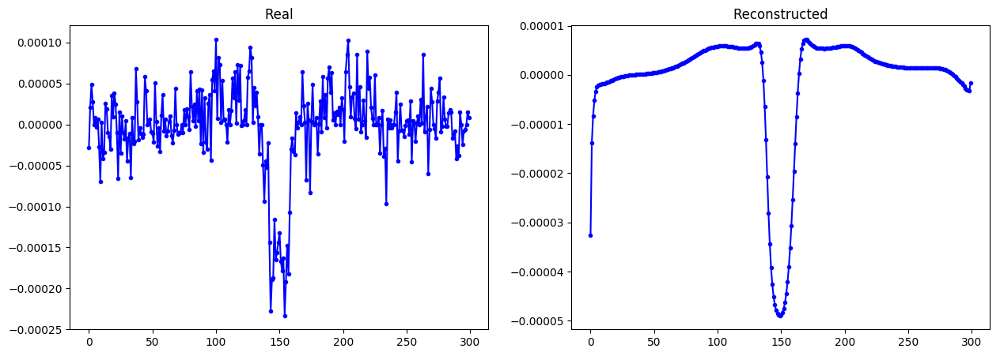

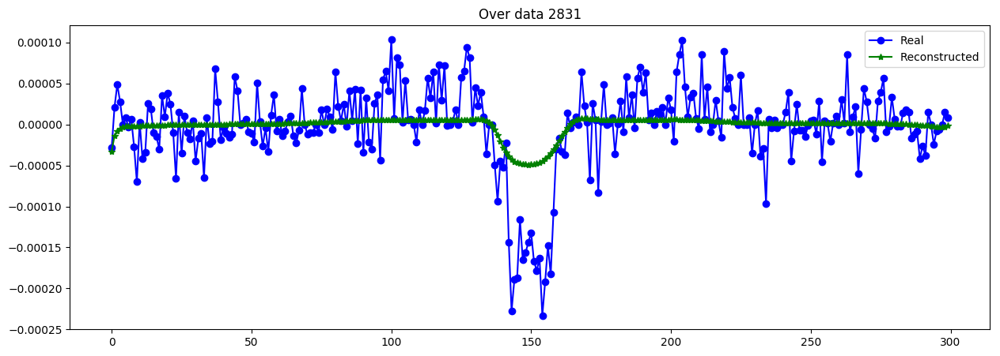

----------------------------------------------------------------


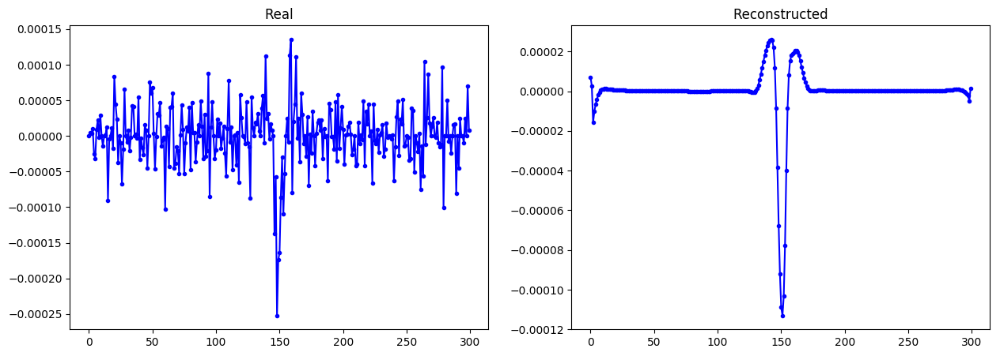

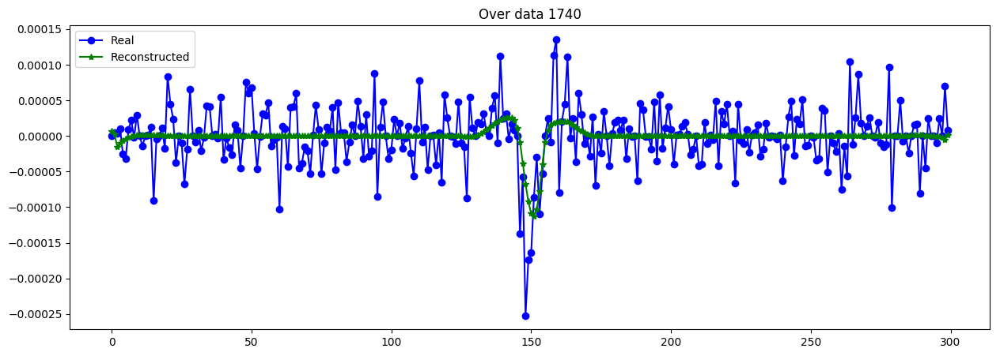

----------------------------------------------------------------


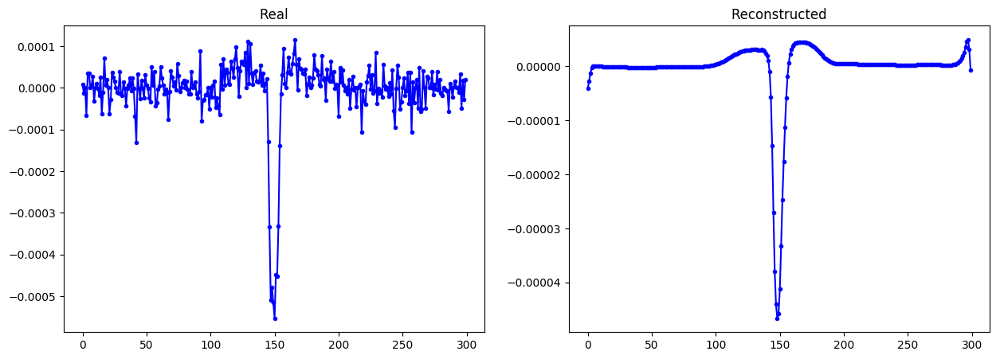

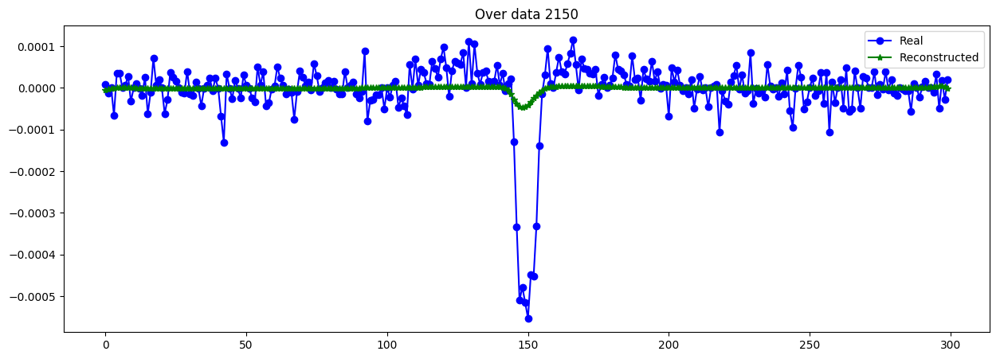

----------------------------------------------------------------


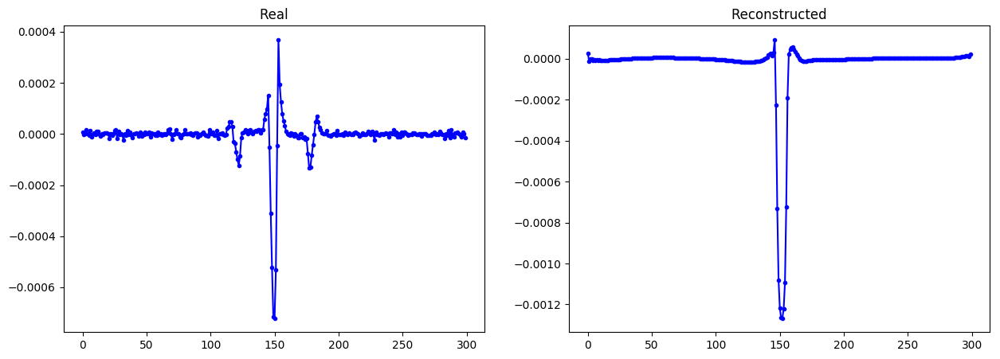

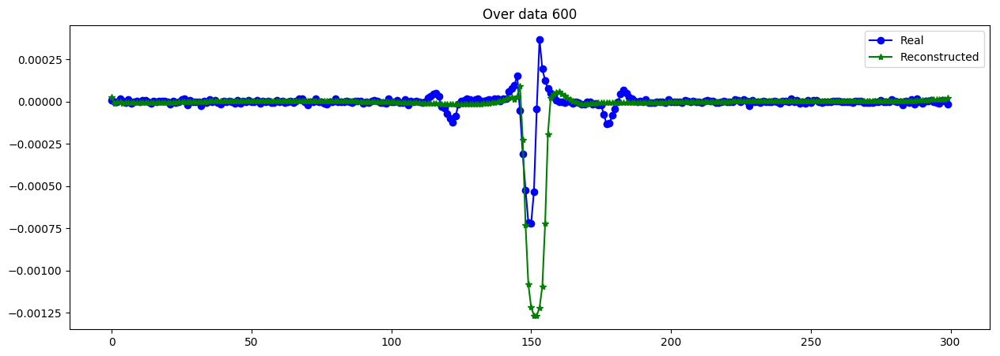

----------------------------------------------------------------


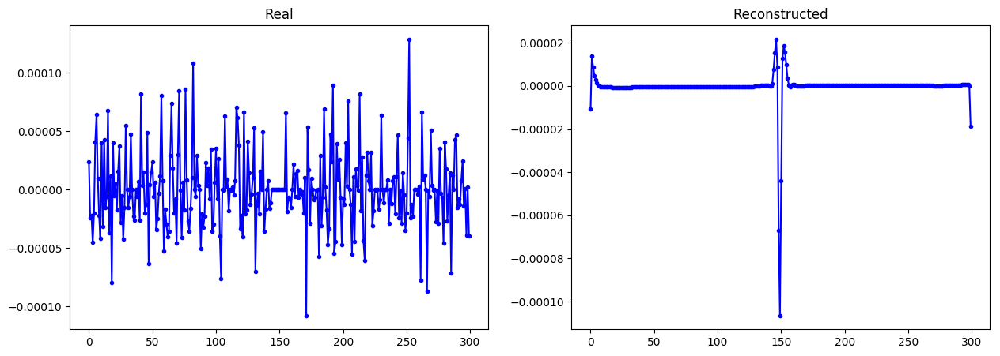

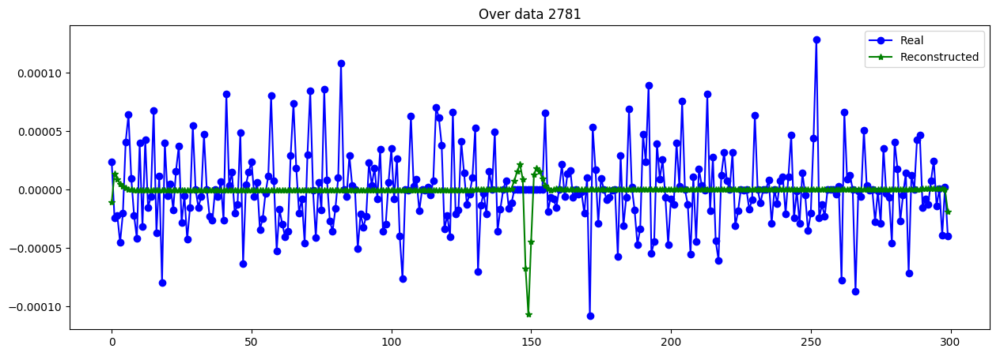

----------------------------------------------------------------


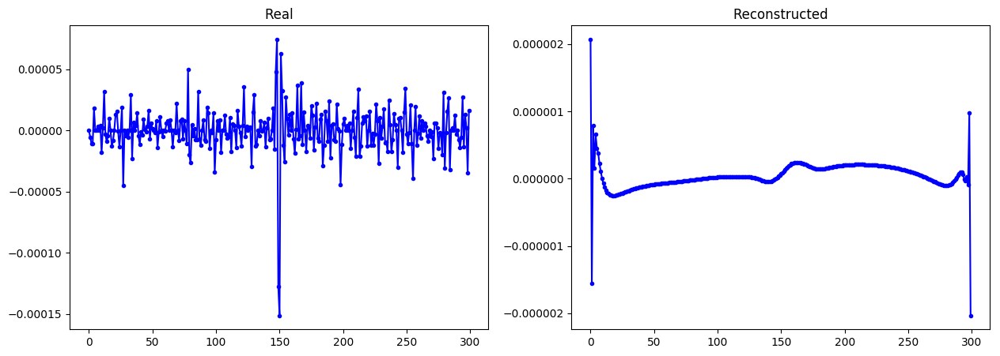

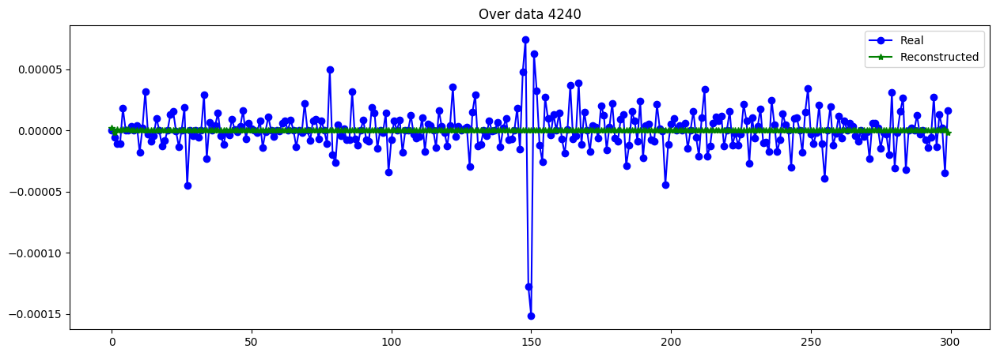

----------------------------------------------------------------


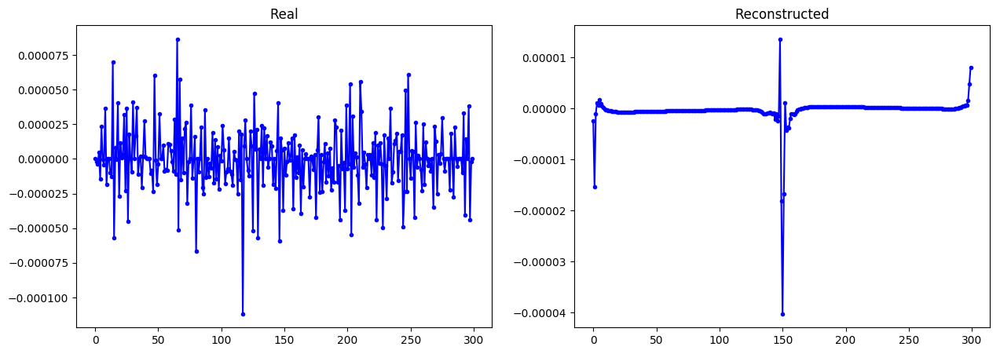

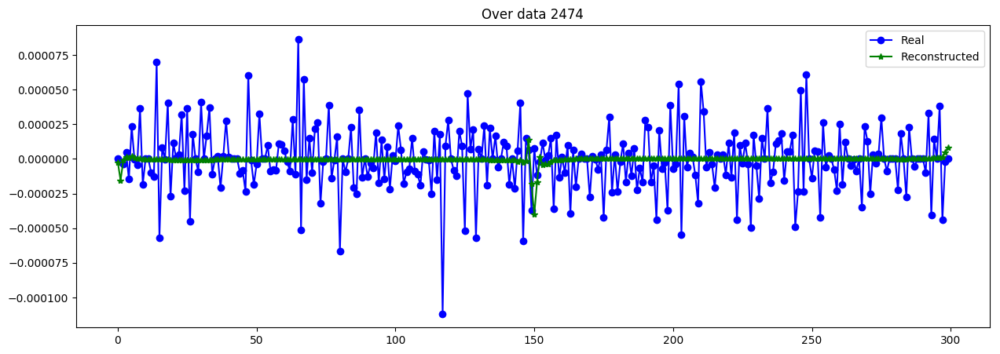

----------------------------------------------------------------


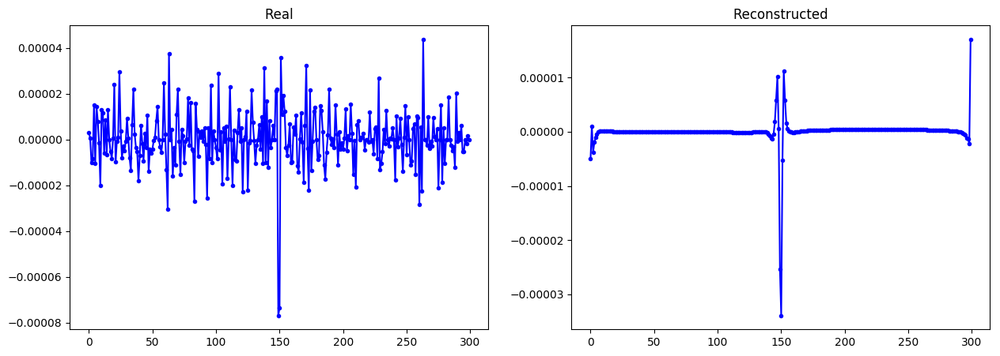

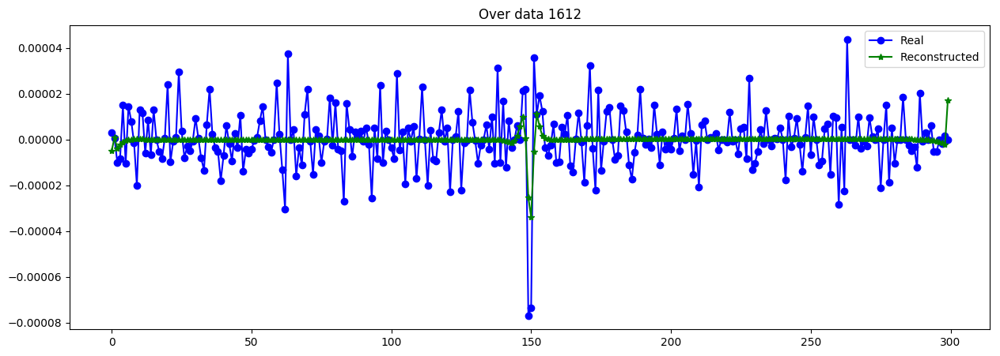

----------------------------------------------------------------


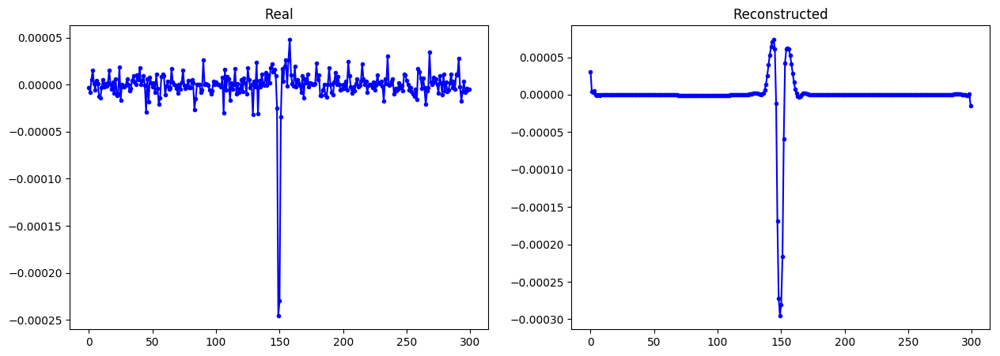

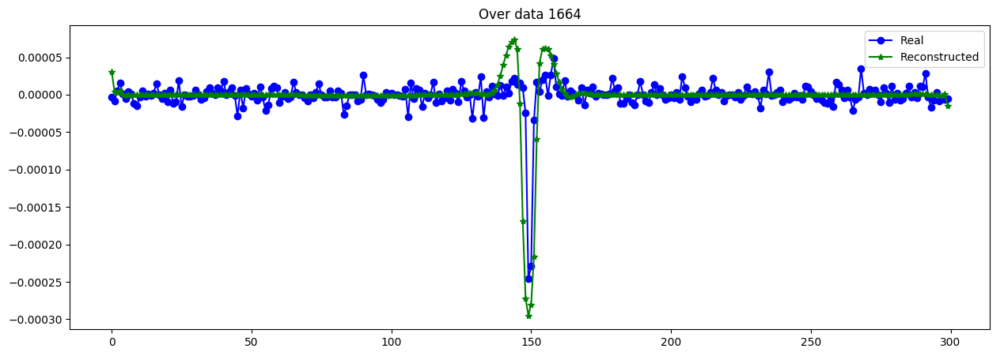

----------------------------------------------------------------


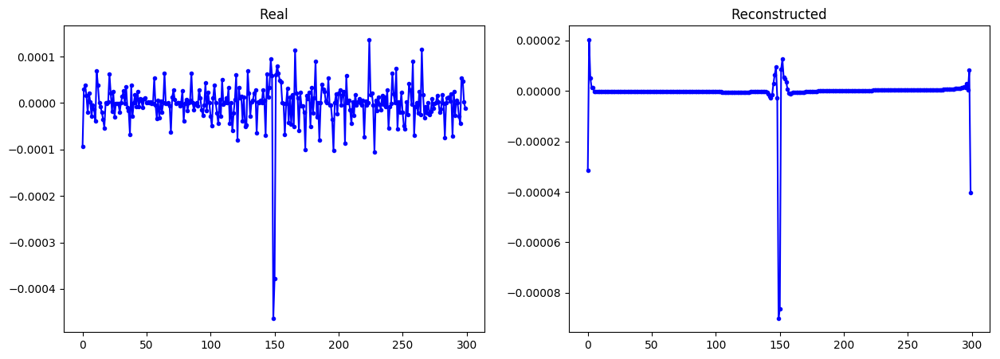

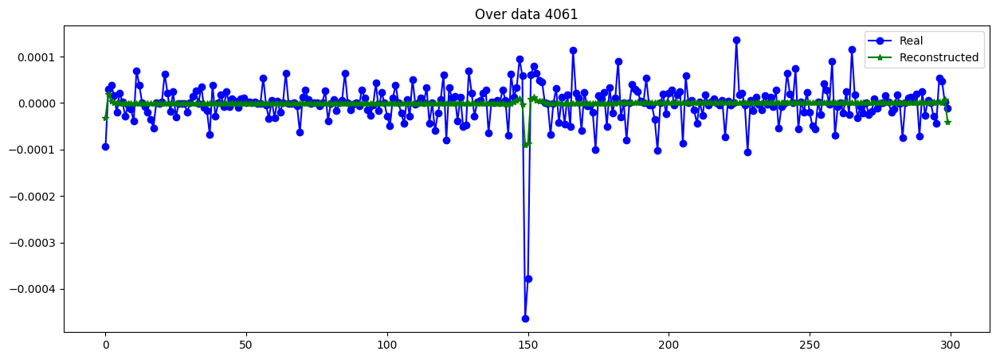

----------------------------------------------------------------


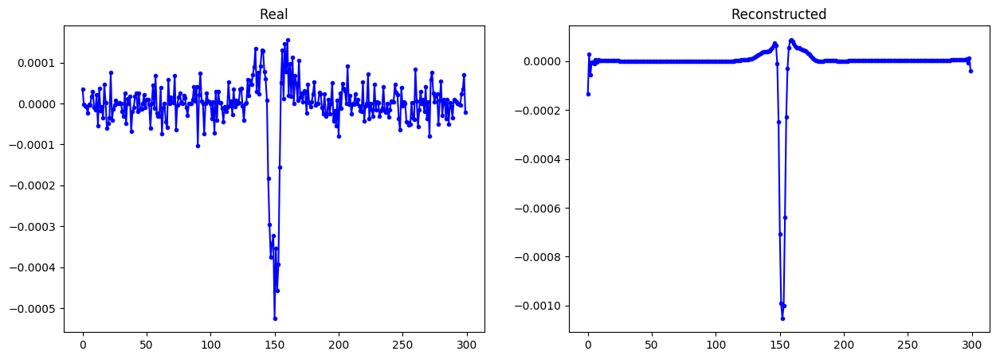

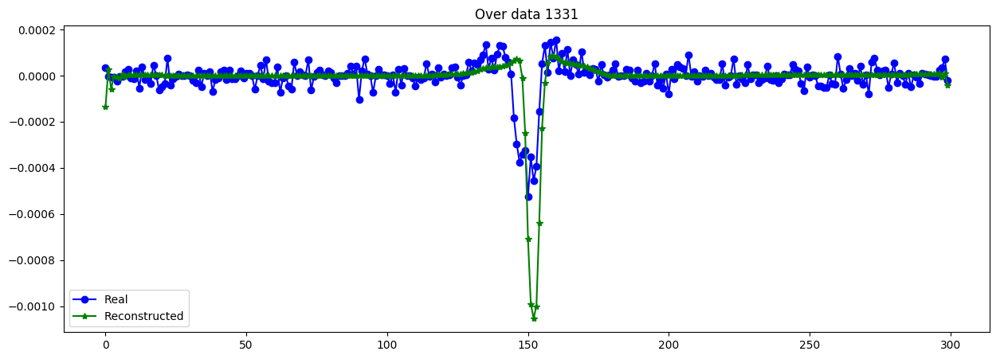

----------------------------------------------------------------


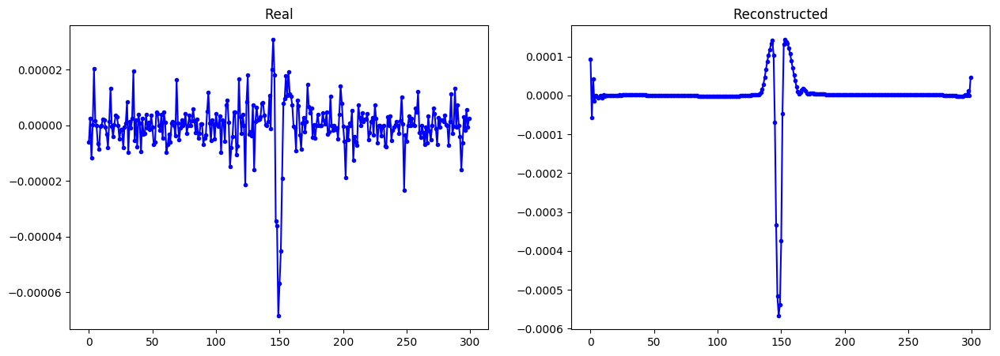

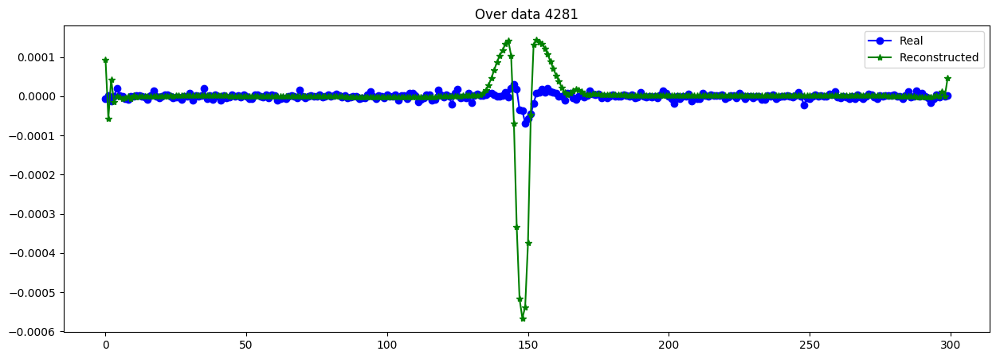

----------------------------------------------------------------


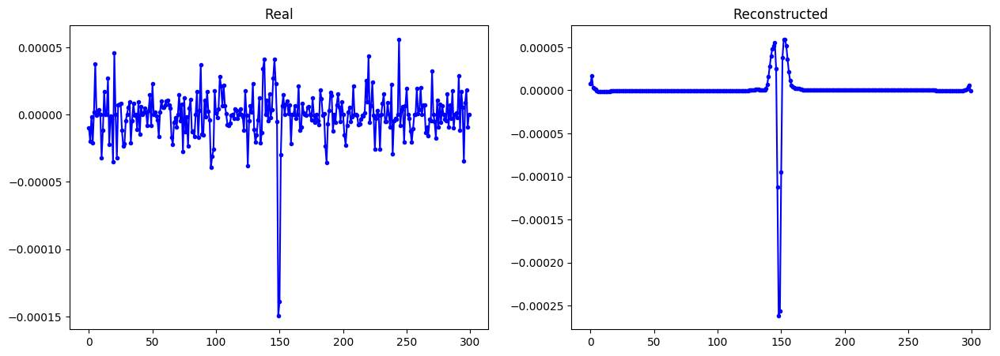

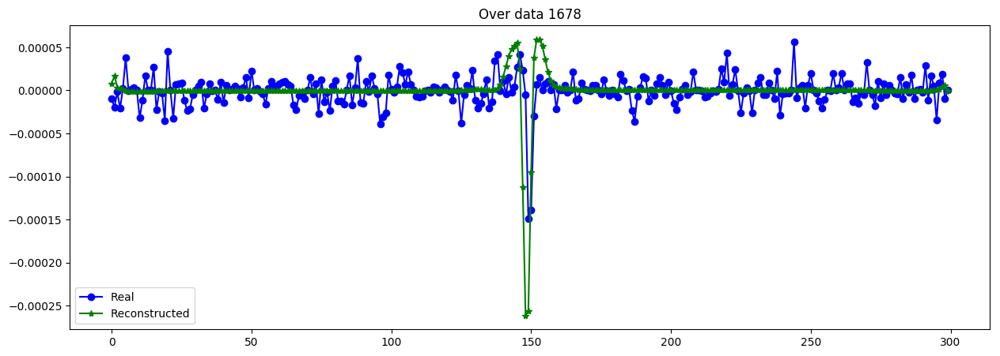

----------------------------------------------------------------


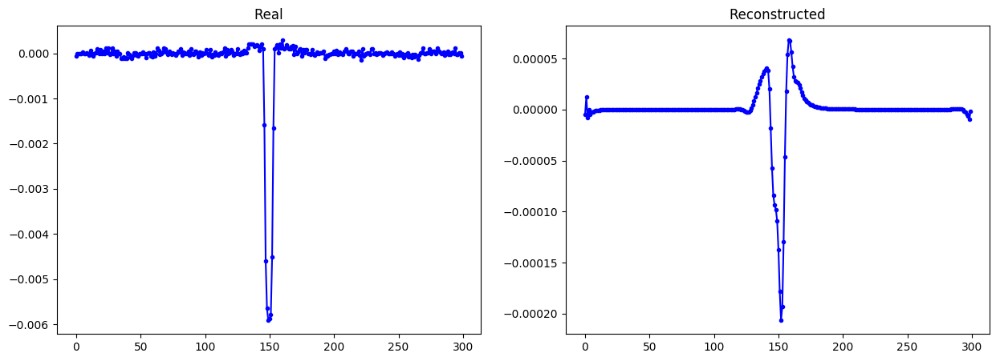

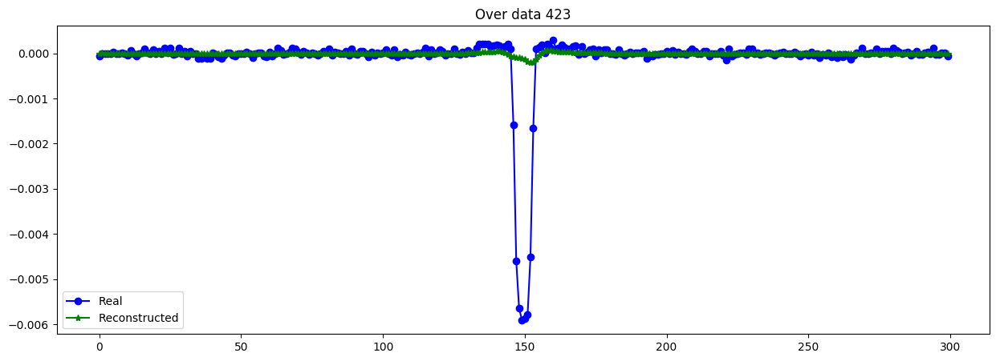

----------------------------------------------------------------


In [31]:
X_CVAE = simulate_CVAE(Cvae.get_layer("generator"), time_all, Y_values, batch_size=256)
X_data_CVAE = X_CVAE[mask_transit]

evaluate_reconst(X_data[:N_trans,:]/S_data[:N_trans,None], X_data_CVAE/S_data[:N_trans,None])

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15) #as MA-1

In [51]:
Cvae.get_layer("encoder").save_weights("./models/C-VAEscaleV3_MAL5_%dT_%dD_%de_E.h5"%(T,latent_dim,400))
Cvae.get_layer("generator").save_weights("./models/C-VAEscaleV3_MAL5_%dT_%dD_%de_D.h5"%(T,latent_dim,400))

## Generar:
* ver los casos en que muere MA (depende del a libreria)

In [20]:
def transform_delta(t):
    return np.hstack([[0],np.diff(t)])

def set_time_T(t,T):
    return np.interp(np.linspace(0, len(t),T), np.arange(len(t)), t)

from mandelagol_sim import simulate_MA, get_MA_sim_names
        
MA_sim_names = get_MA_sim_names()

Cannot import pytransit library 


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/pylightcurve/_0imports.py:20: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/home/casapanshop/anaconda2/envs/py3/lib/python3.5/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/home/casapanshop/anaconda2/envs/py3/lib/python3.5/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/ipykernel/__main__.py", line 3, in <module>
    app.launch_new_instance()
  File "/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/casapanshop/anac

In [21]:
def simulate_CVAE(generator, time, Y, batch_size=128):
    #checek shapes of time and Y
    latent_dim = generator.get_layer("latent_inp").input_shape[-1]
    N_all = Y.shape[0]
        
    #Simular con C_VAE
    Dtime_all  = np.apply_along_axis(transform_delta, 1, time)[:,:,None]
    z_samp_all = np.random.normal(0, 1, size=(N_all, latent_dim))
    
    return generator.predict([Dtime_all, z_samp_all, Y], batch_size=batch_size)

time_all = np.cumsum(np.squeeze(X_fold_time), axis=-1)

/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


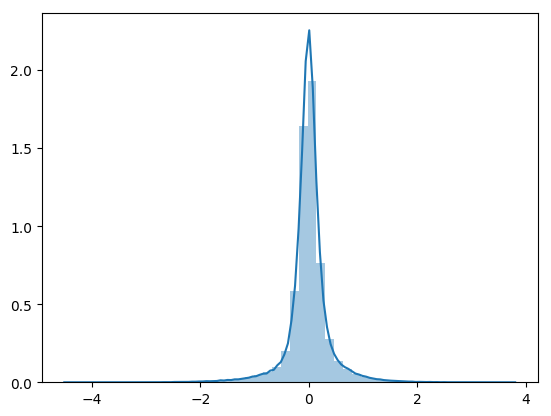

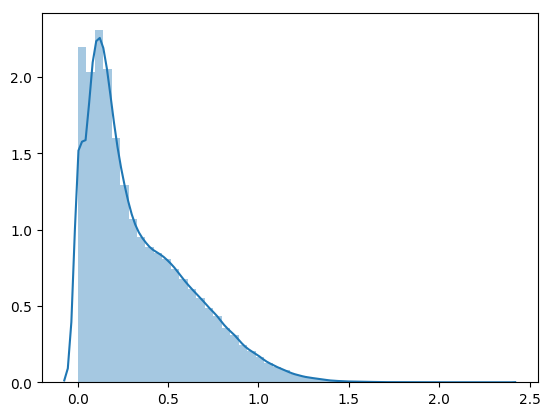

In [96]:
#z_aux, z_var_aux = encoder.predict([X_data_t, X_data, Sinv_data, Ystd_transit], batch_size=512)
z_aux, z_var_aux = encoder.predict([X_data_t, X_data, Sinv_data, Y_transit], batch_size=512)

sns.distplot(z_aux.flatten())
plt.show()
sns.distplot(np.exp(z_var_aux.flatten()))
plt.show()

In [32]:
%%time 
N_all = df_meta_obj.shape[0]
time_all = np.cumsum(np.squeeze(X_fold_time), axis=-1)

#Simular con C_VAE
Dtime_all  = np.apply_along_axis(transform_delta, 1, time_all)[:,:,None]
z_samp_all = np.random.normal(0, 1, size=(N_all, latent_dim))
Y_all      = df_meta_obj.drop(del_val, axis=1).values  
#Y_all = std_metadata.transform(Y_all) #only mdoel 4

X_CVAE = generator.predict([Dtime_all, z_samp_all, Y_all], batch_size=128)

CPU times: user 3.28 s, sys: 75.8 ms, total: 3.36 s
Wall time: 3.28 s


In [33]:
Sinv_data_hat = Model([decoder_input,y_lc], s_out).predict([z_samp_all, Y_all])[mask_transit]

X_data_CVAE = X_CVAE[mask_transit]
X_data_CVAE.shape

(4317, 300, 1)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


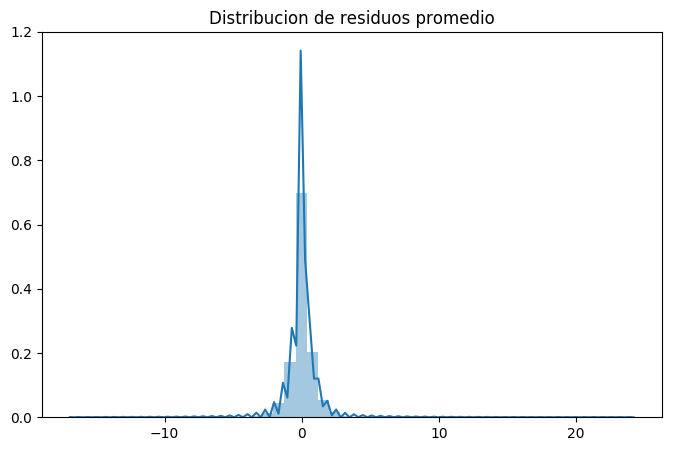

MSE      =  1.0204891043314848
RMSE (+-)=  0.9711064154096537
MAE  (+-)=  0.5701602520704154
--------- Smoothness ------------
AutoCorr lag-one =  0.6745479
Diff MEAN =  0.058970563
Diff STD =  0.3172032
--------- Smoothness ------------
----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


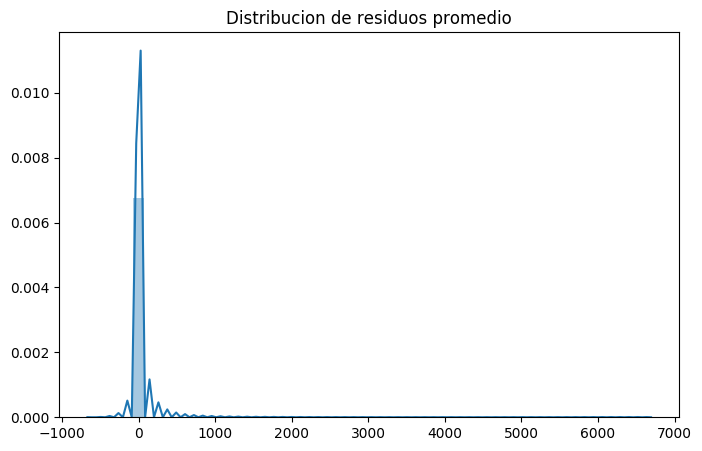

MSE      =  3424.54226865883
RMSE (+-)=  11.392790287477265
MAE  (+-)=  3.7419699138839975
--------- Smoothness ------------
AutoCorr lag-one =  0.6745479428687777
Diff MEAN =  0.917722052284094
Diff STD =  4.005358051767429
--------- Smoothness ------------
MSE de escala escalado=  6.877371114426709
Real scale = 62970.365955
Pred scale = 51759.101562


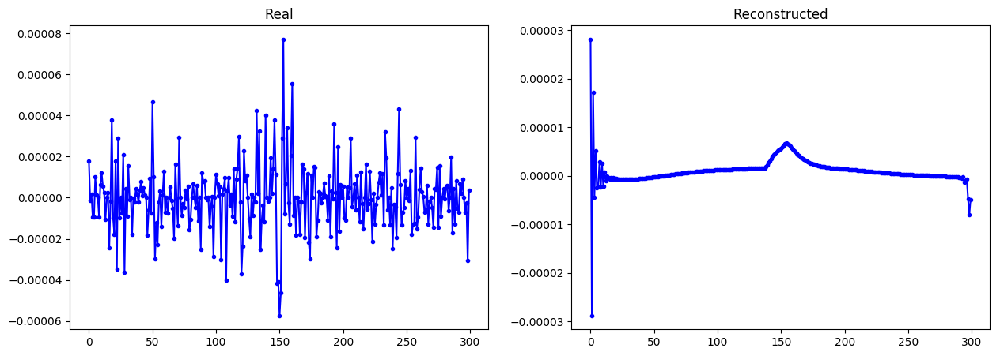

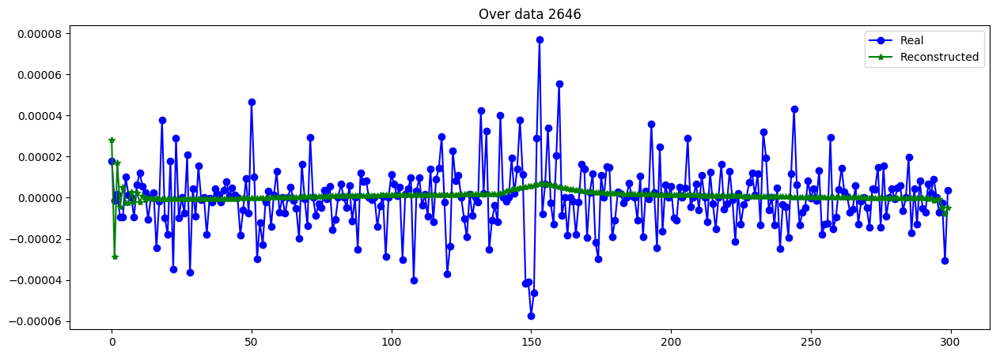

----------------------------------------------------------------
Real scale = 6320.653030
Pred scale = 13057.117188


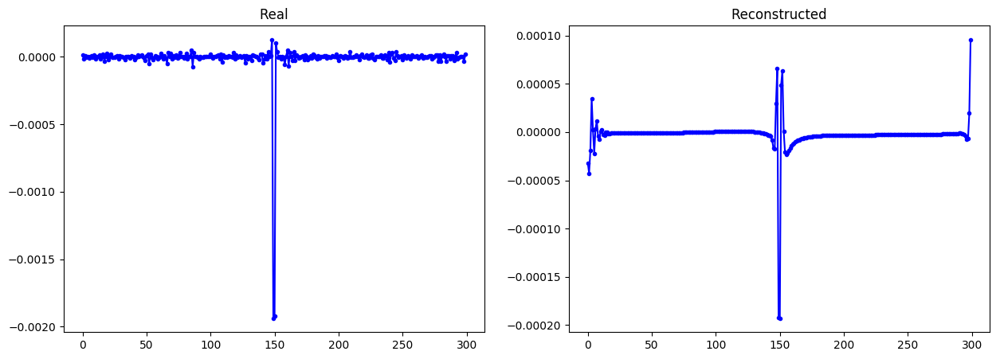

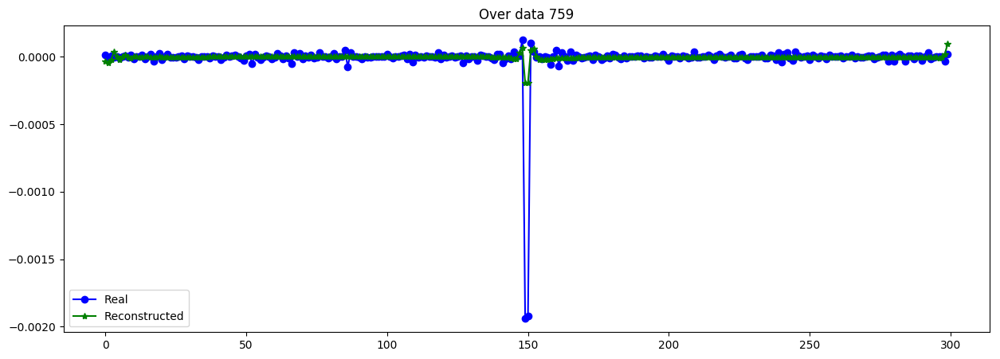

----------------------------------------------------------------
Real scale = 24134.300433
Pred scale = 30076.910156


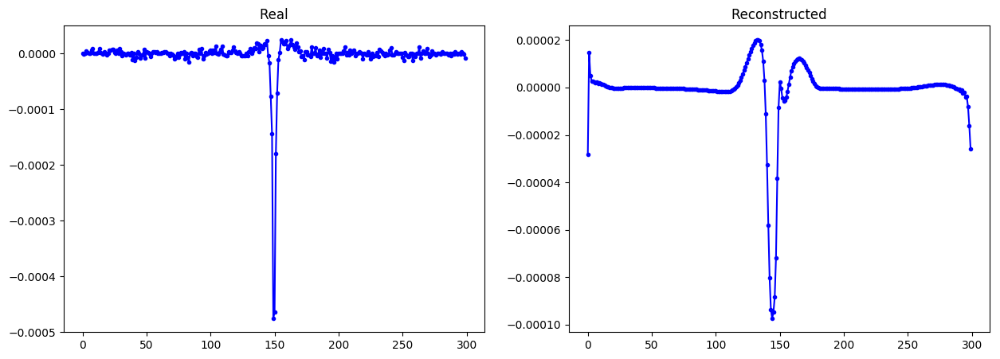

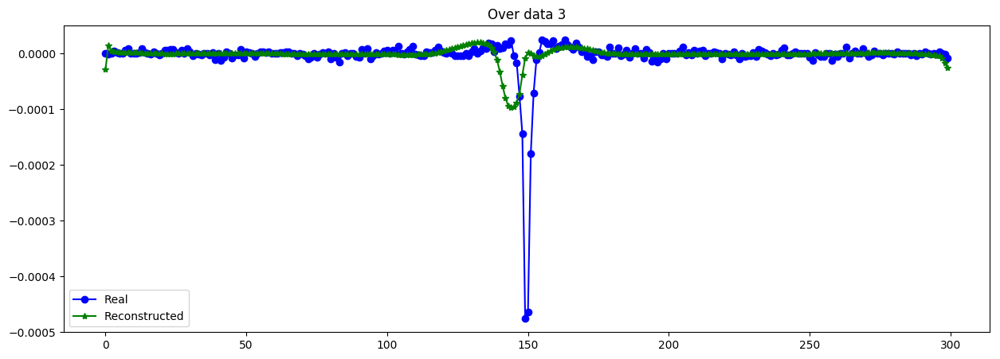

----------------------------------------------------------------
Real scale = 133340.115687
Pred scale = 71799.062500


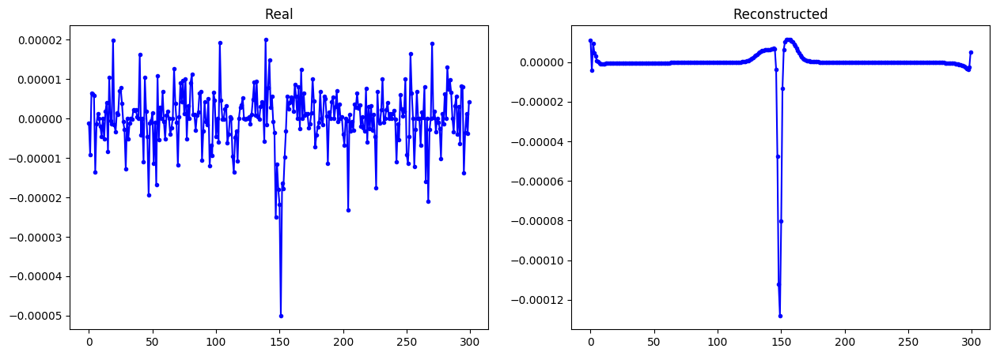

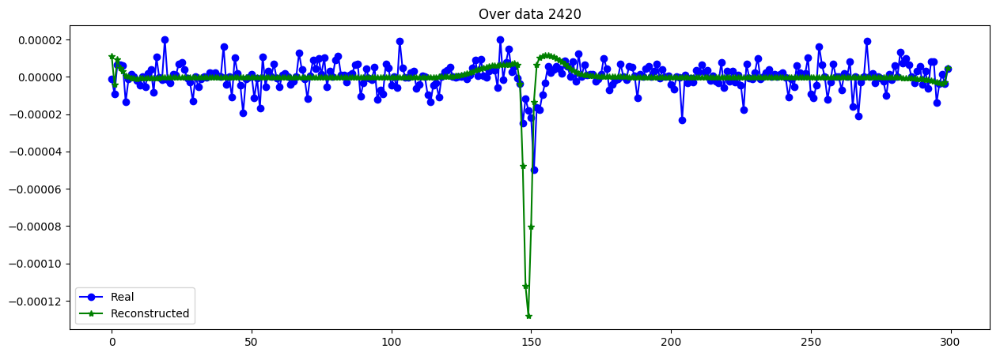

----------------------------------------------------------------
Real scale = 20424.122611
Pred scale = 2608.849365


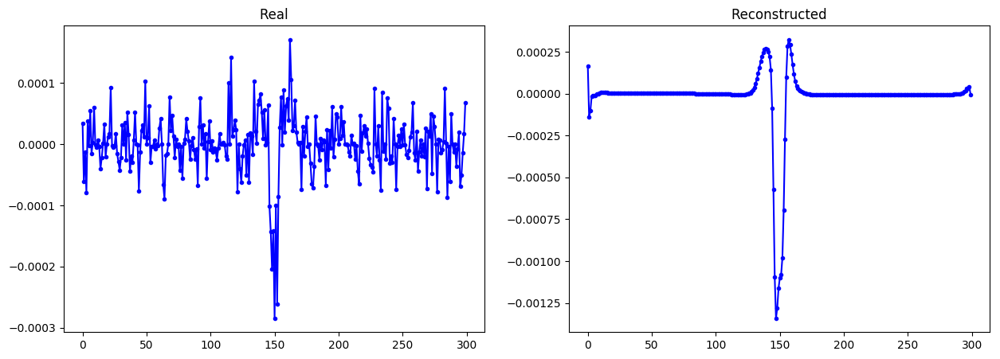

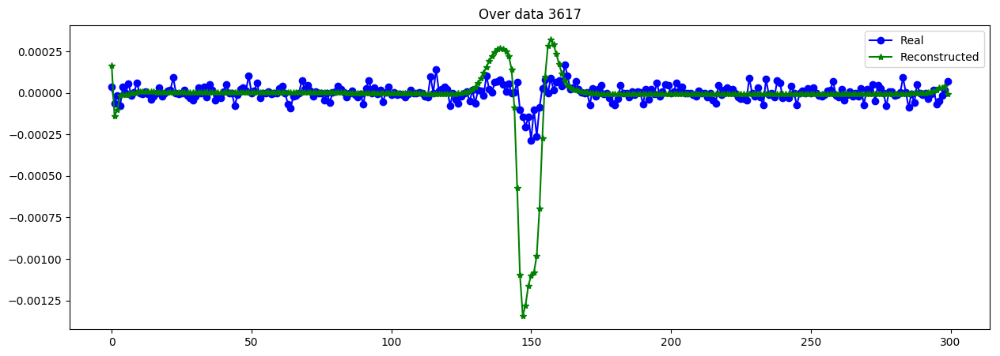

----------------------------------------------------------------
Real scale = 59557.145754
Pred scale = 22492.351562


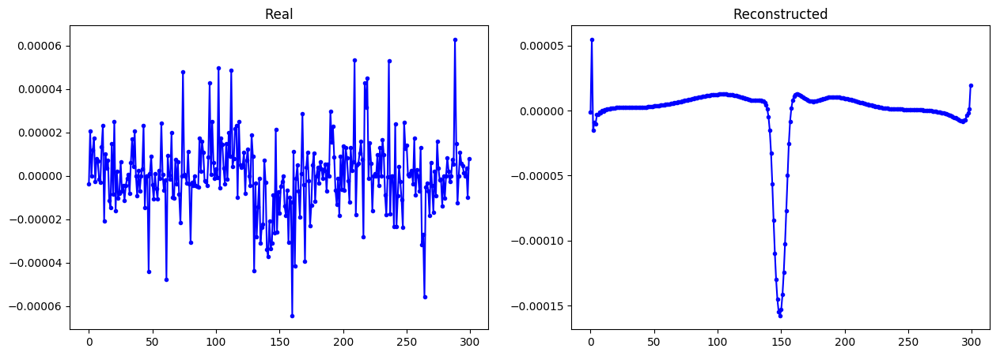

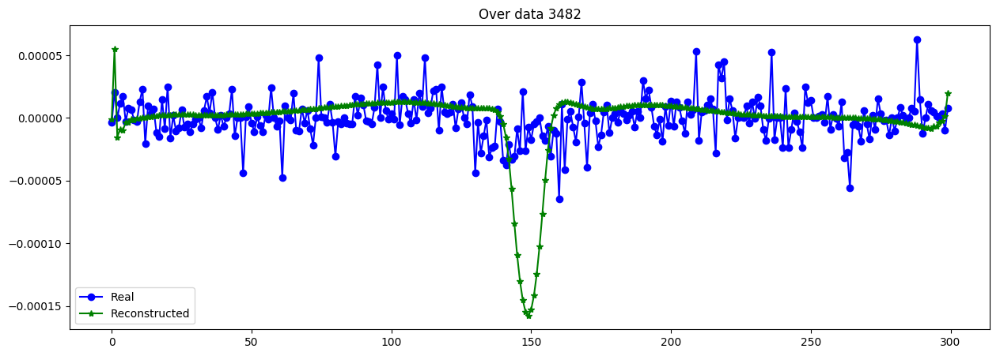

----------------------------------------------------------------
Real scale = 37615.098158
Pred scale = 128841.867188


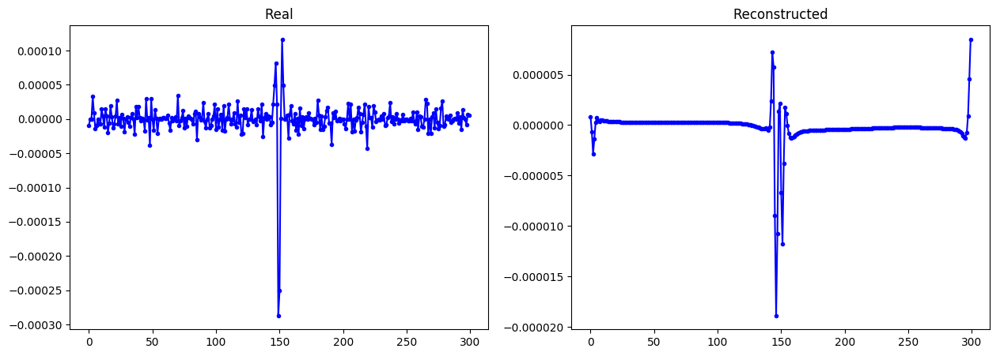

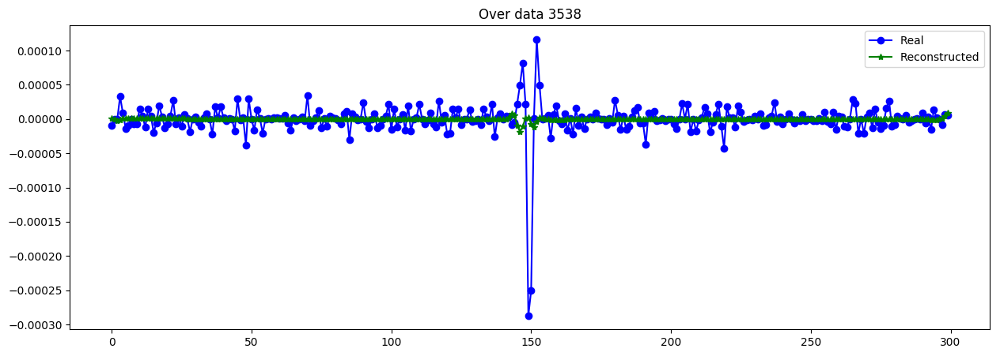

----------------------------------------------------------------
Real scale = 19080.657226
Pred scale = 19545.925781


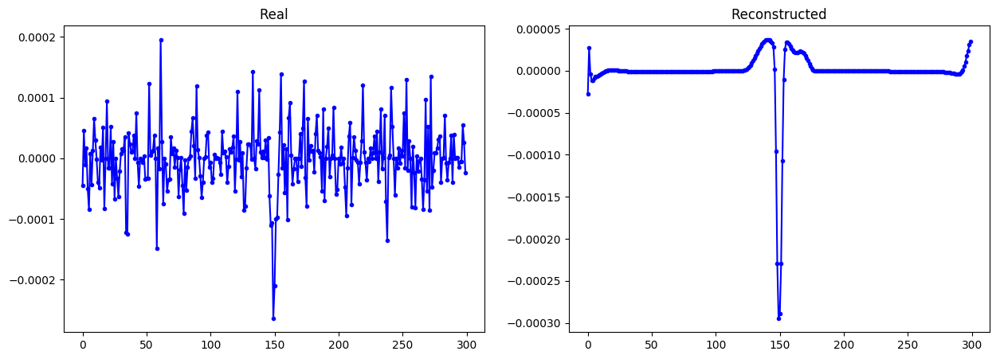

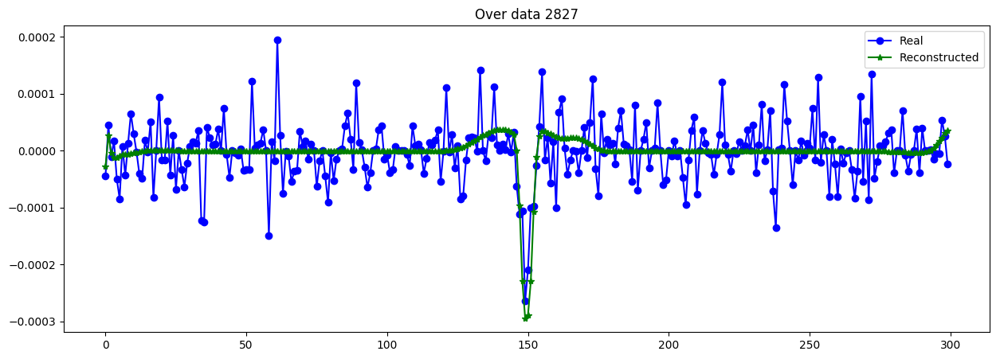

----------------------------------------------------------------
Real scale = 92414.291370
Pred scale = 1282.988159


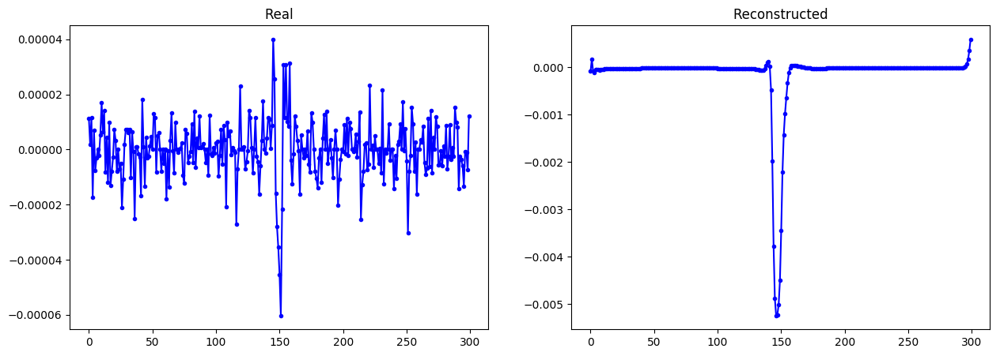

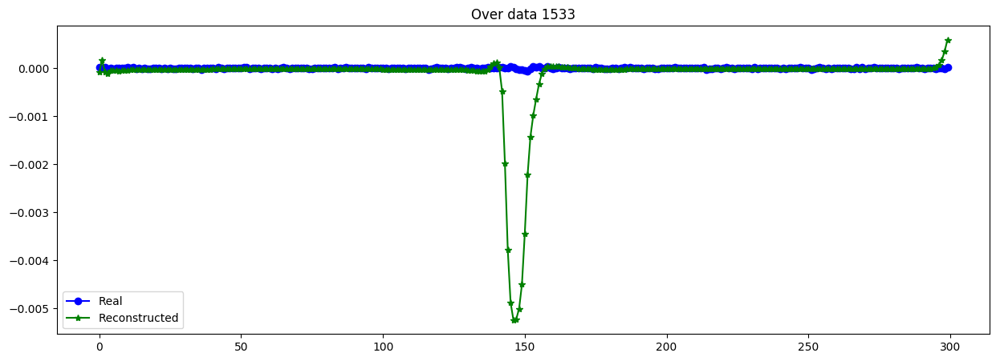

----------------------------------------------------------------
Real scale = 4896.937444
Pred scale = 528.288147


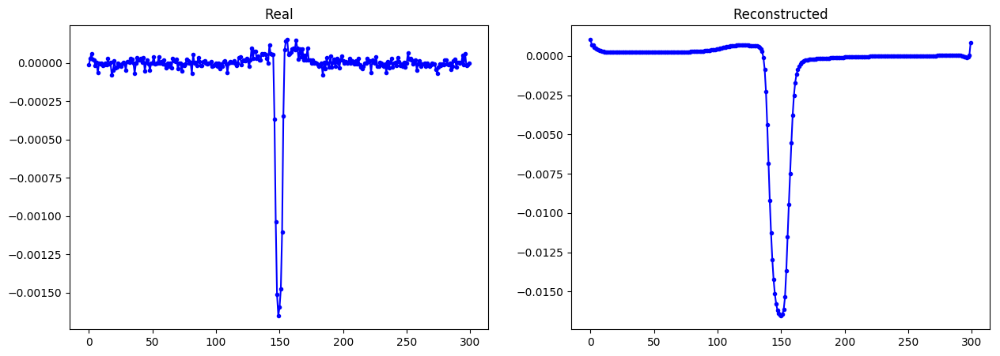

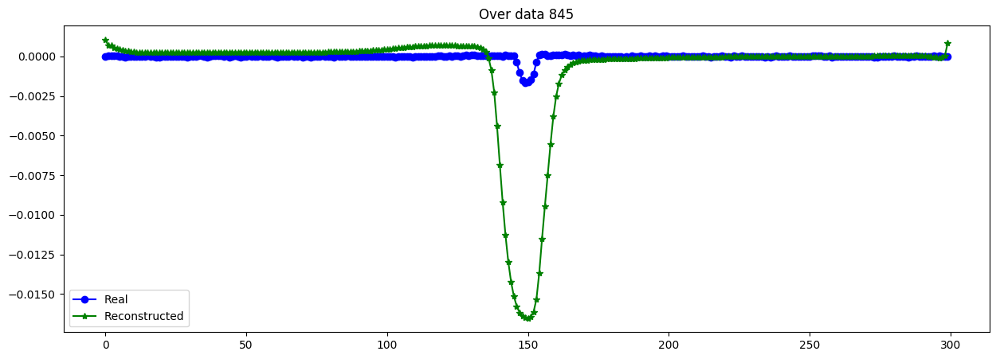

----------------------------------------------------------------
Real scale = 73220.212151
Pred scale = 6905.238281


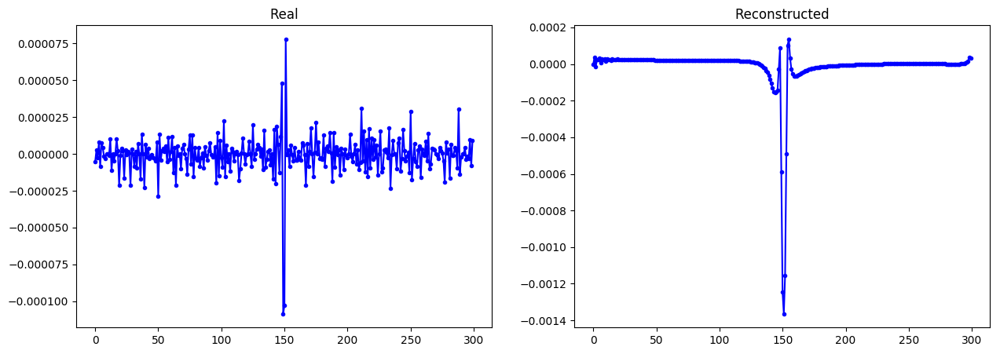

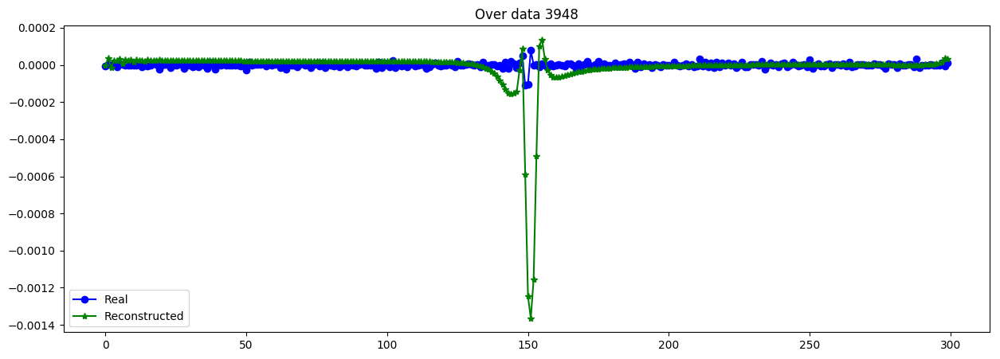

----------------------------------------------------------------
Real scale = 41896.815603
Pred scale = 26499.386719


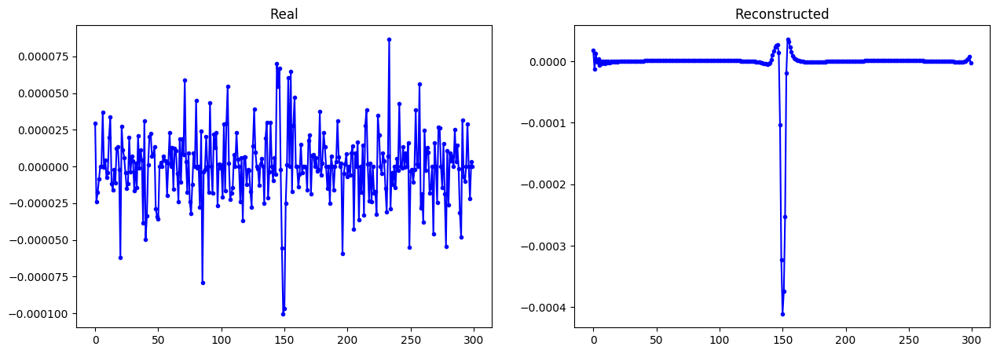

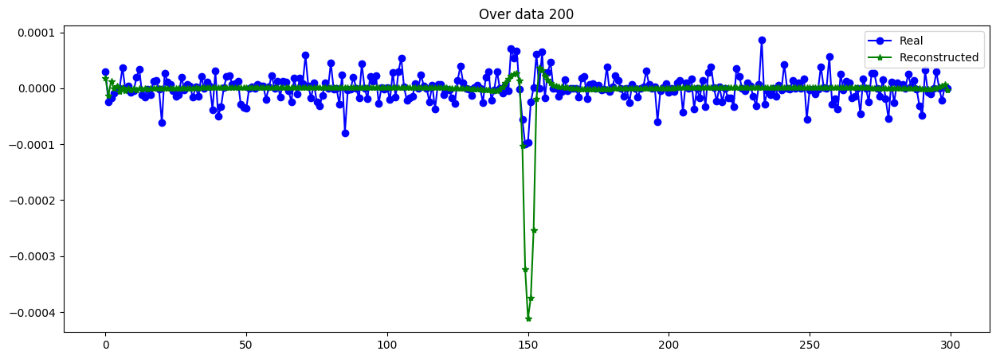

----------------------------------------------------------------
Real scale = 28678.851326
Pred scale = 18493.199219


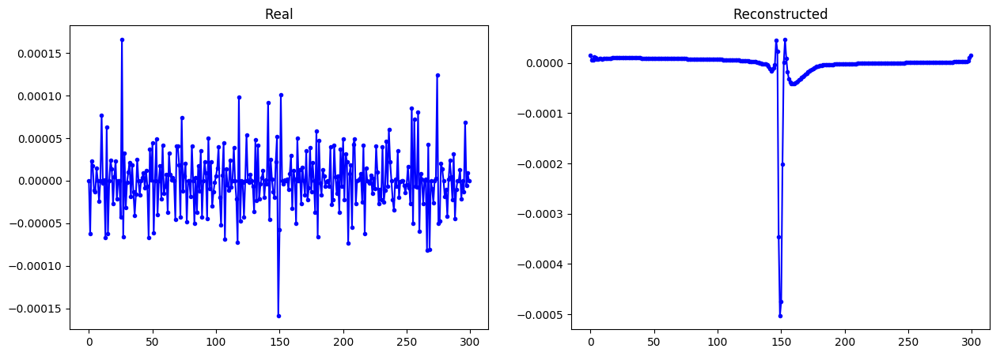

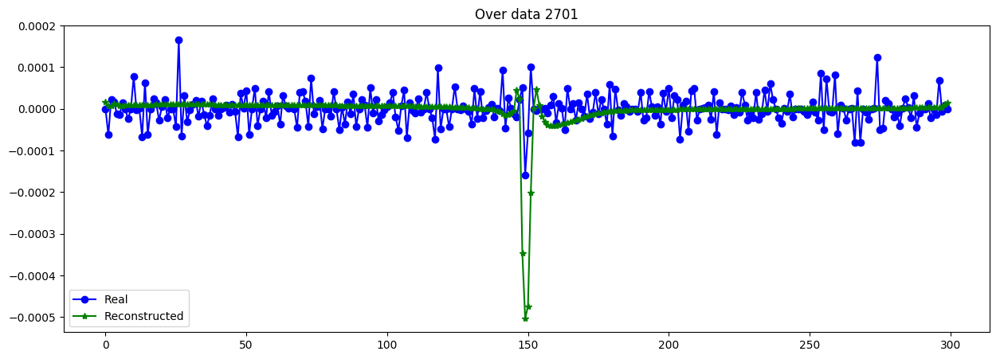

----------------------------------------------------------------
Real scale = 10048.952334
Pred scale = 482634.531250


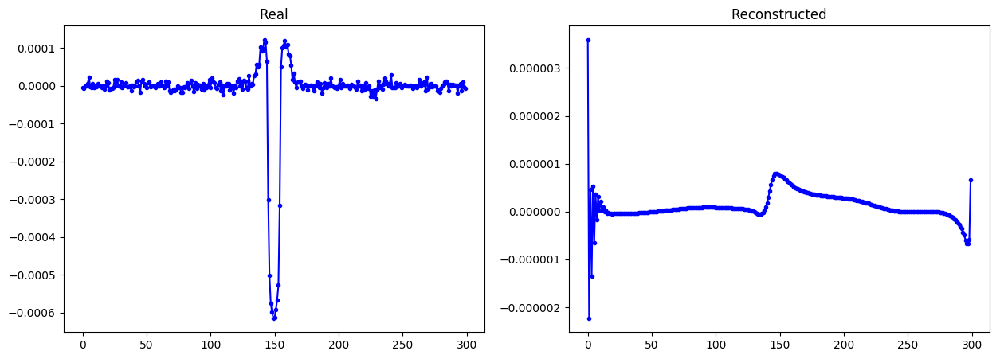

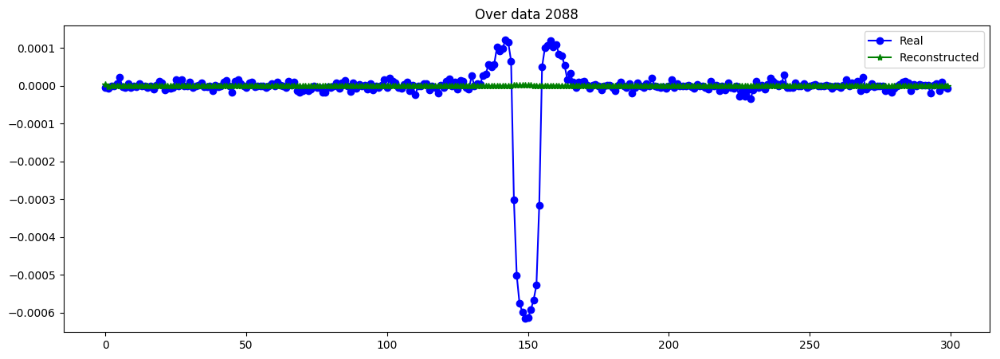

----------------------------------------------------------------
Real scale = 43352.048202
Pred scale = 14092.993164


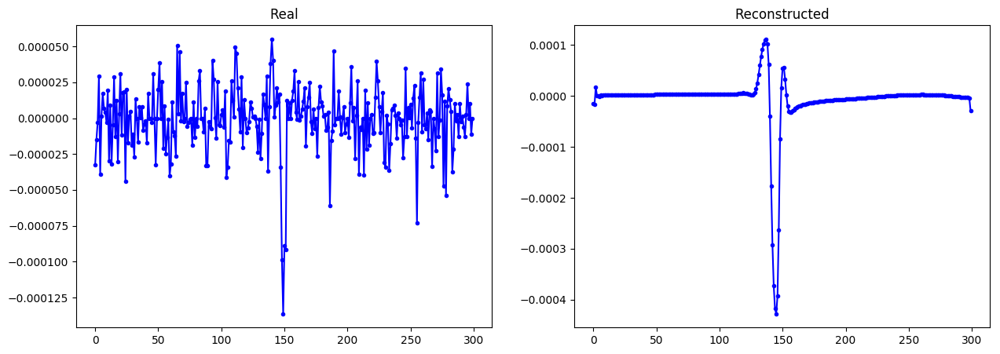

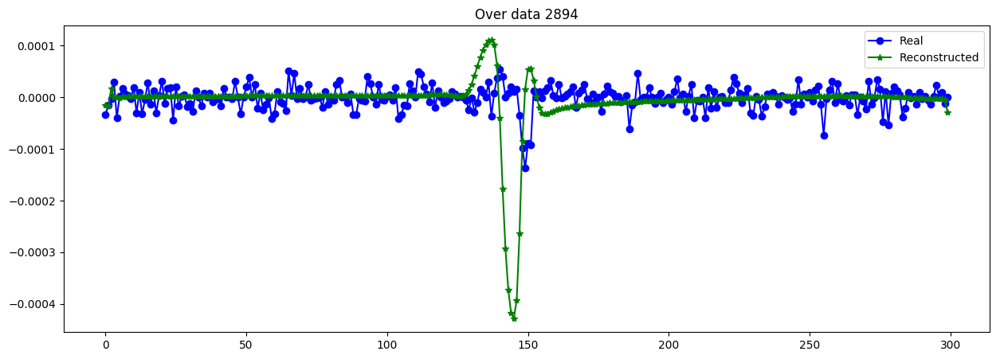

----------------------------------------------------------------


In [30]:
evaluate_reconst(X_data[:N_trans,:]*Sinv_data[:N_trans,None], X_data_CVAE*Sinv_data_hat[:N_trans,None])

evaluate_reconst(X_data[:N_trans,:]*Sinv_data[:N_trans,None], X_data_CVAE*Sinv_data[:N_trans,None])
print("MSE de escala escalado= ",mean_squared_error(Sinv_data[:N_trans],Sinv_data_hat)*(1/Sinv_std)**2)

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15, s=[Sinv_data[:N_trans],Sinv_data_hat]) #as MA-1

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


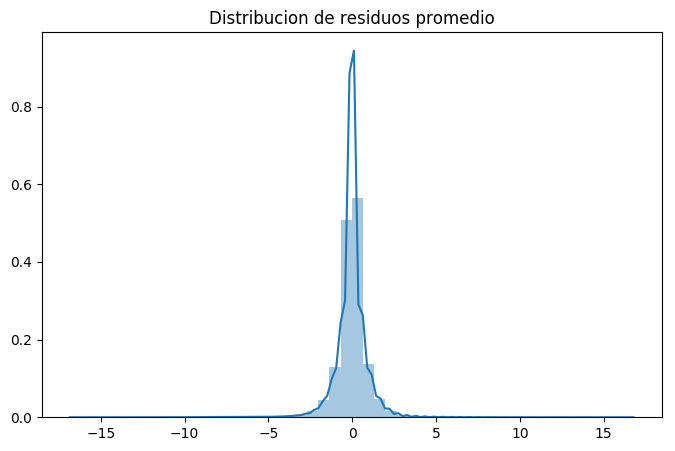

MSE      =  0.9173321150954626
RMSE (+-)=  0.9448783374773474
MAE  (+-)=  0.5593344233043257
--------- Smoothness ------------
AutoCorr lag-one =  0.7141963
Diff MEAN =  0.04232943
Diff STD =  0.20460504
--------- Smoothness ------------
----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


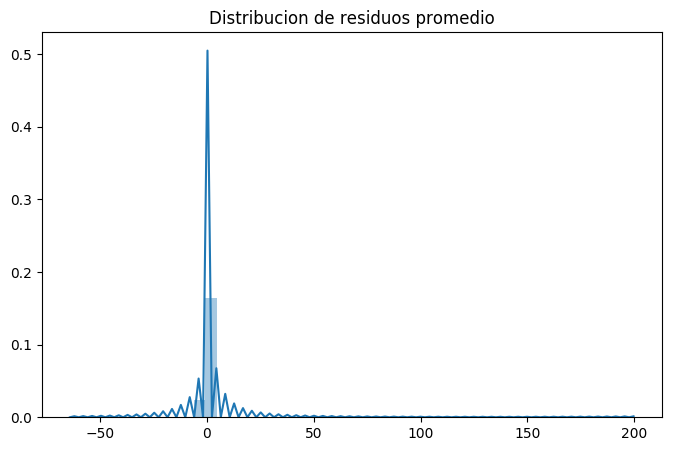

MSE      =  2.237332374671249
RMSE (+-)=  1.1045389587212067
MAE  (+-)=  0.6067760713563233
--------- Smoothness ------------
AutoCorr lag-one =  0.71419636217081
Diff MEAN =  0.053381425939878255
Diff STD =  0.2541161235303527
--------- Smoothness ------------
MSE de escala escalado=  0.8948951090317405
Real scale = 134068.231723
Pred scale = 113406.468750


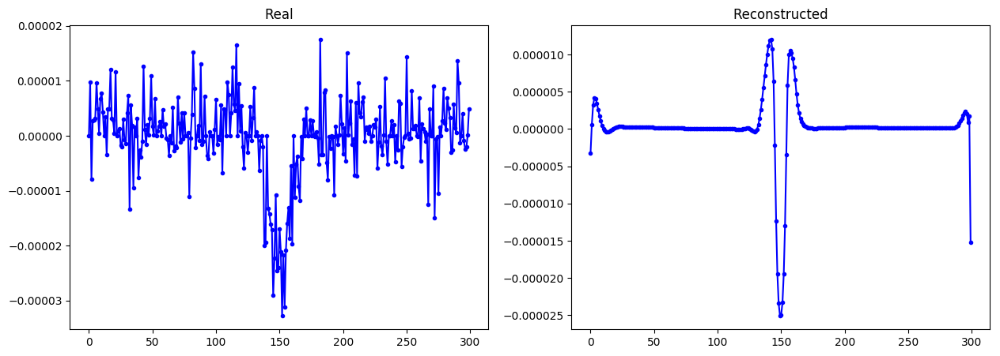

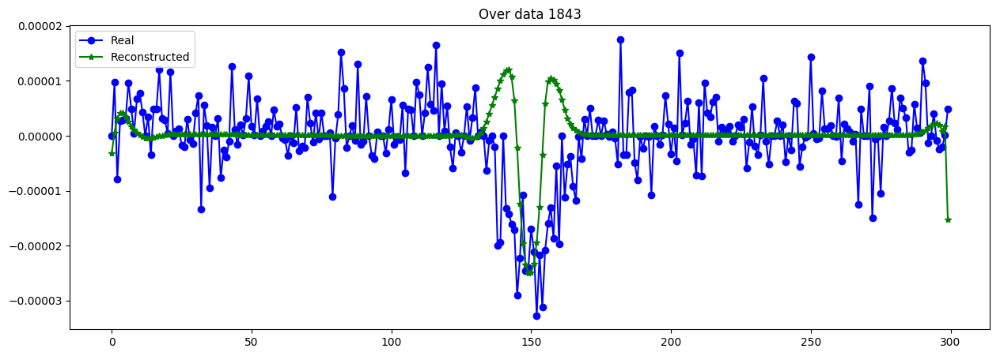

----------------------------------------------------------------
Real scale = 968.377305
Pred scale = 3162.969482


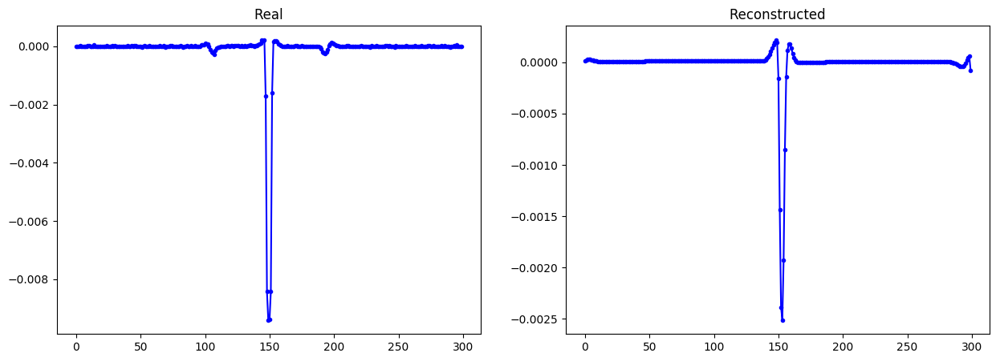

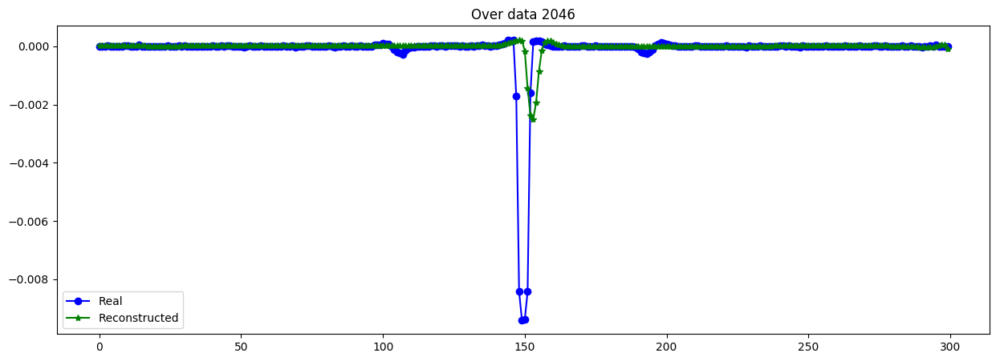

----------------------------------------------------------------
Real scale = 15306.009368
Pred scale = 13609.329102


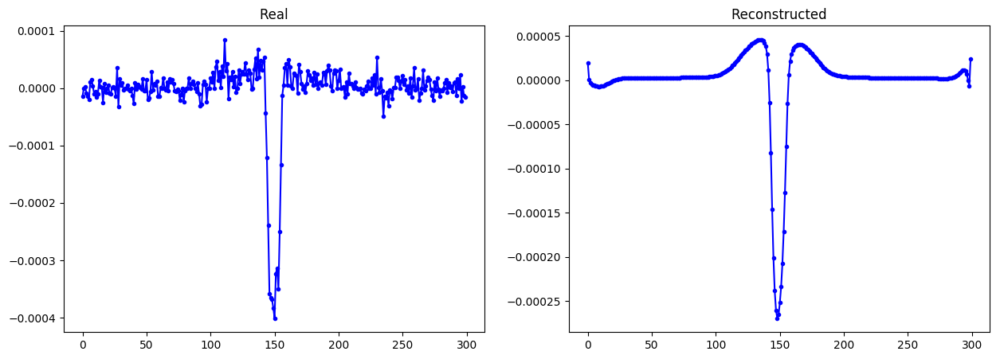

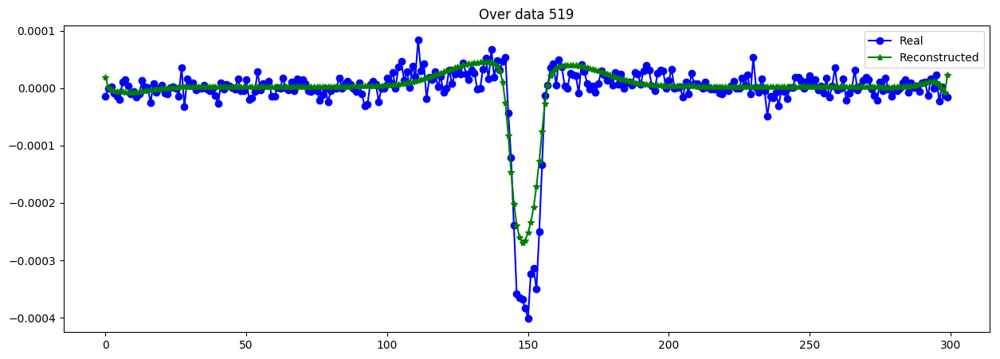

----------------------------------------------------------------
Real scale = 6044.207275
Pred scale = 9525.192383


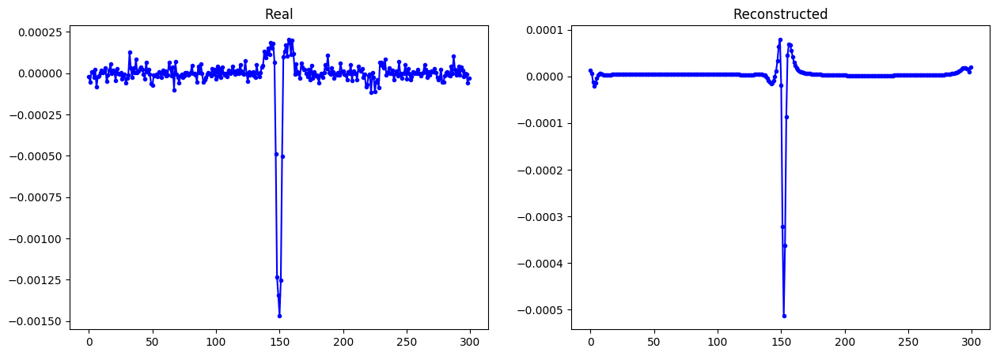

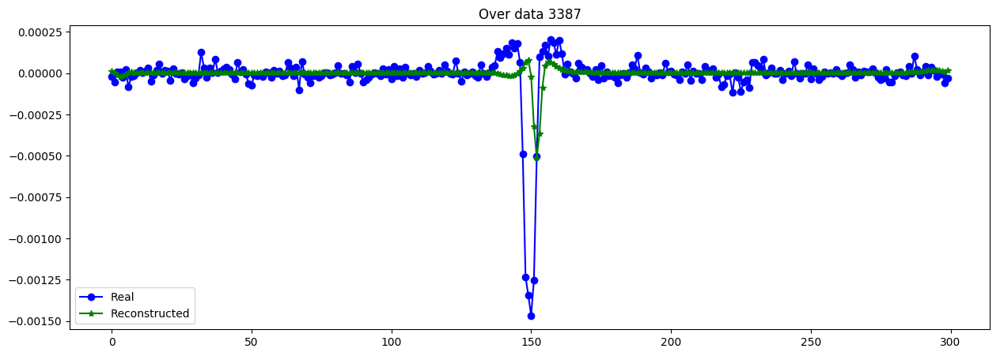

----------------------------------------------------------------
Real scale = 25815.640193
Pred scale = 50456.179688


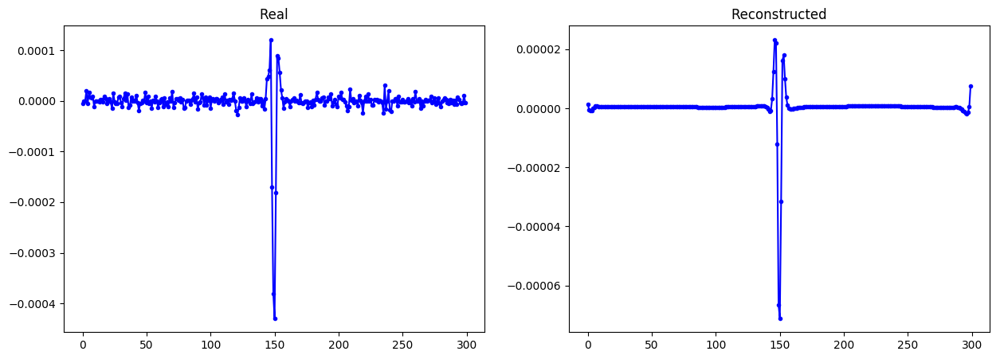

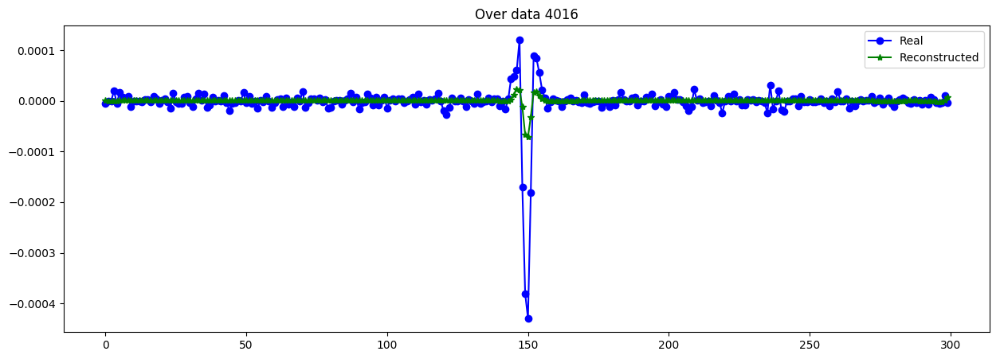

----------------------------------------------------------------
Real scale = 48805.394523
Pred scale = 157593.578125


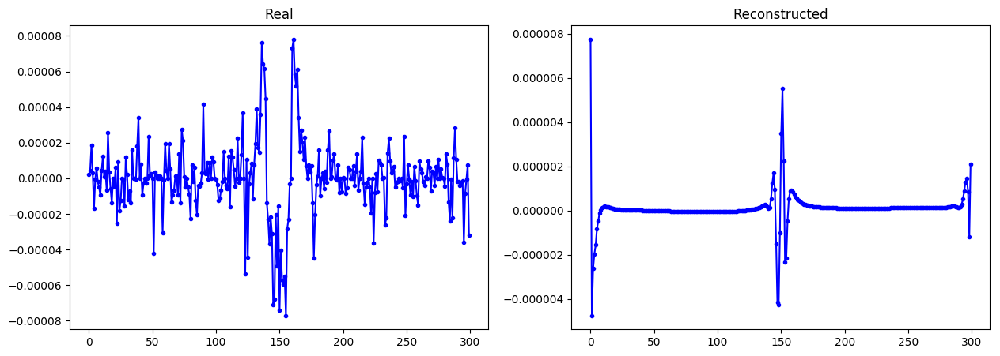

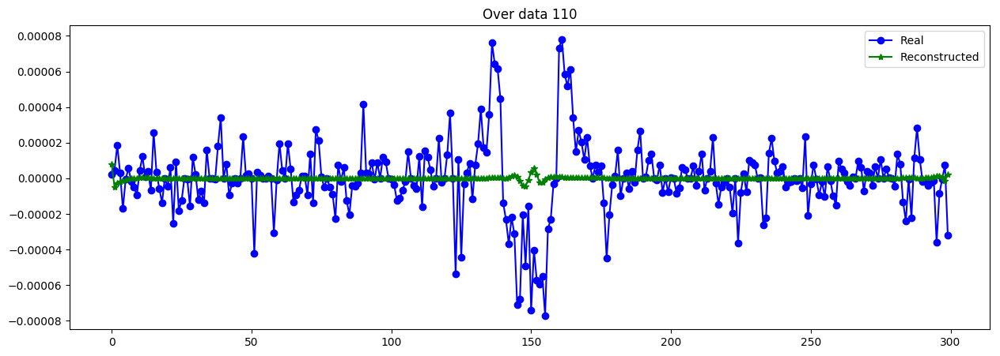

----------------------------------------------------------------
Real scale = 88817.716276
Pred scale = 164581.390625


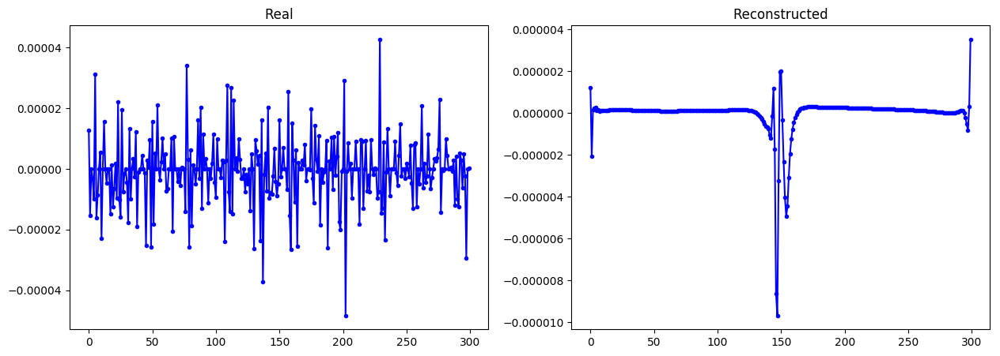

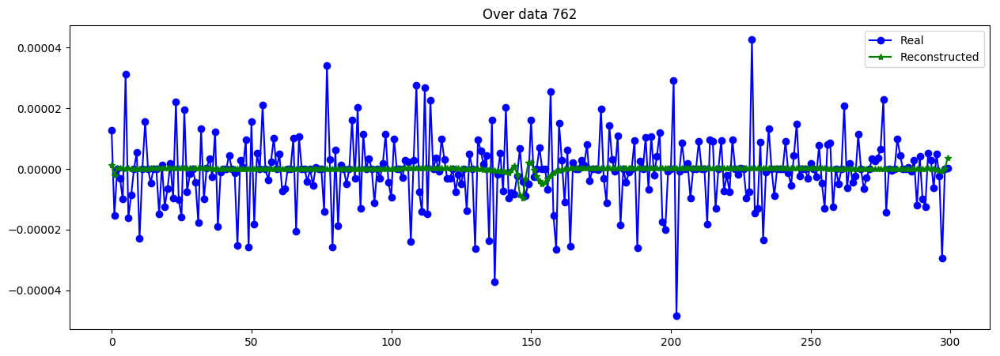

----------------------------------------------------------------
Real scale = 45997.834949
Pred scale = 17784.513672


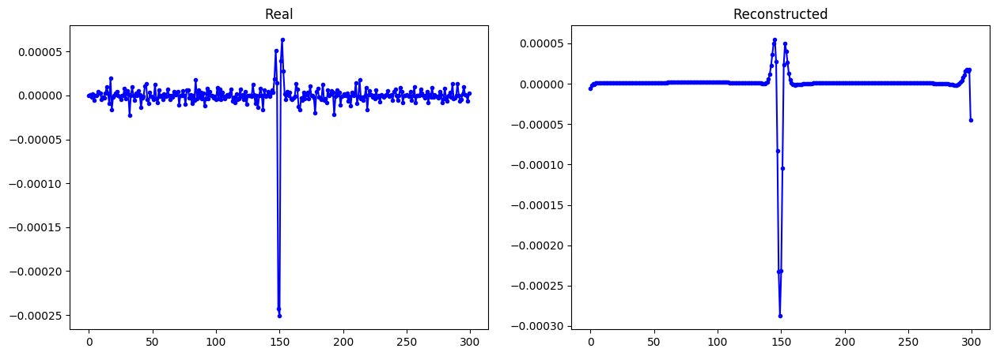

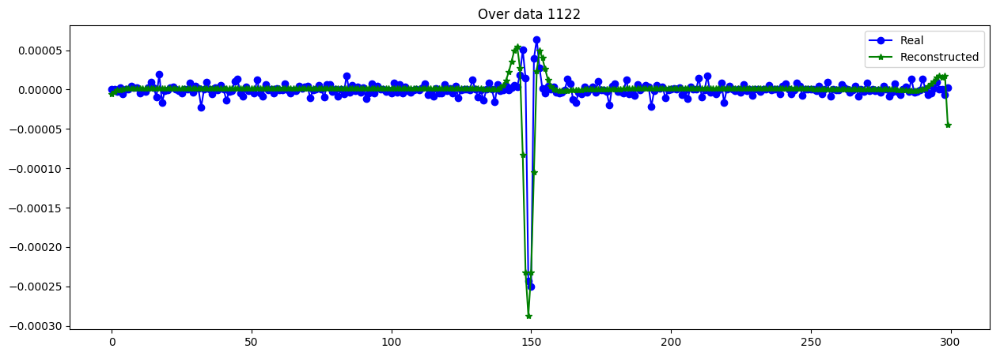

----------------------------------------------------------------
Real scale = 62255.394896
Pred scale = 54302.902344


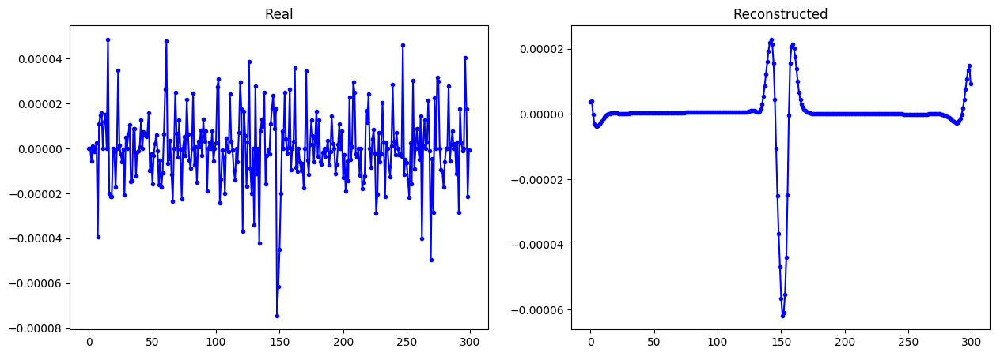

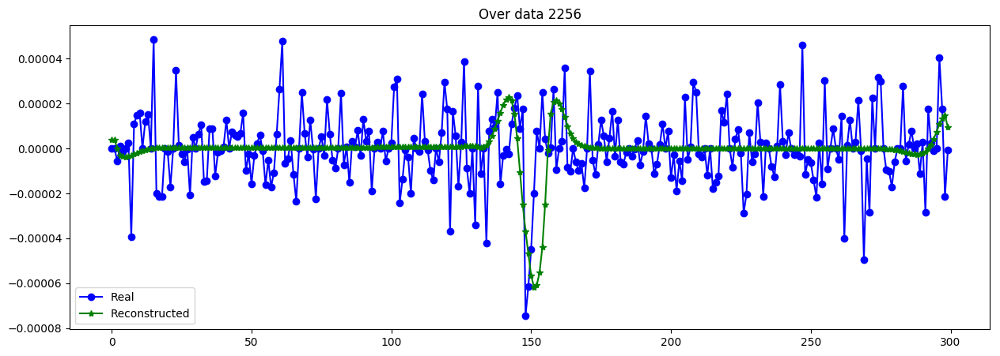

----------------------------------------------------------------
Real scale = 6460.867690
Pred scale = 32632.136719


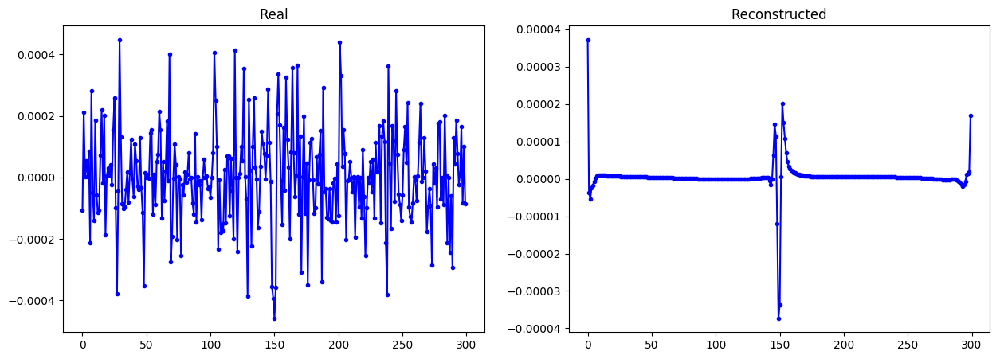

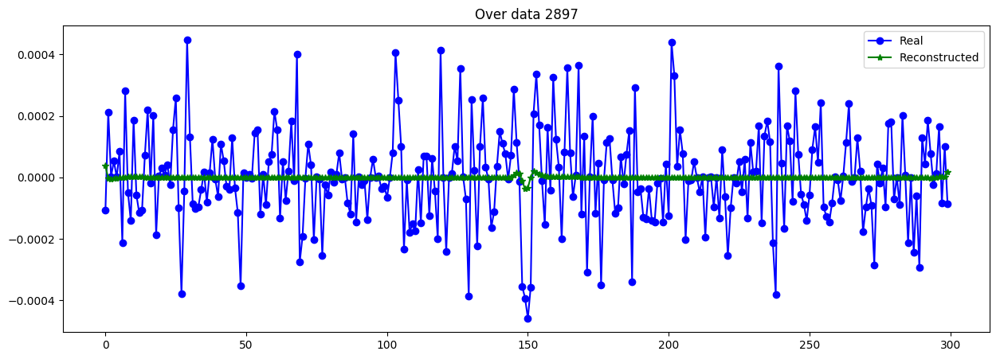

----------------------------------------------------------------
Real scale = 58978.360880
Pred scale = 46496.472656


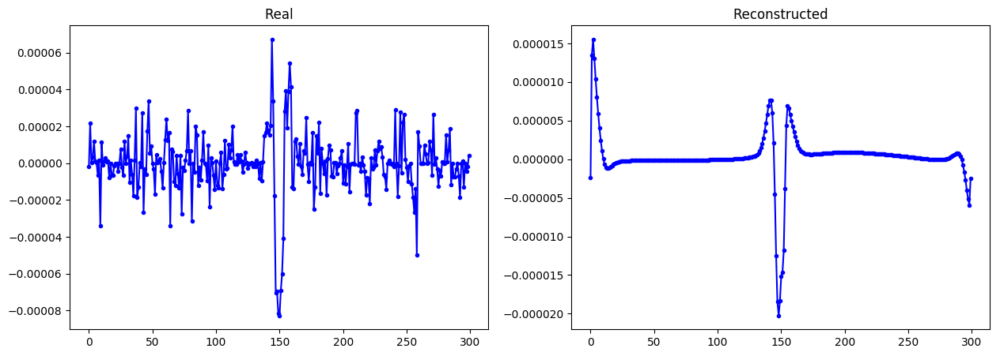

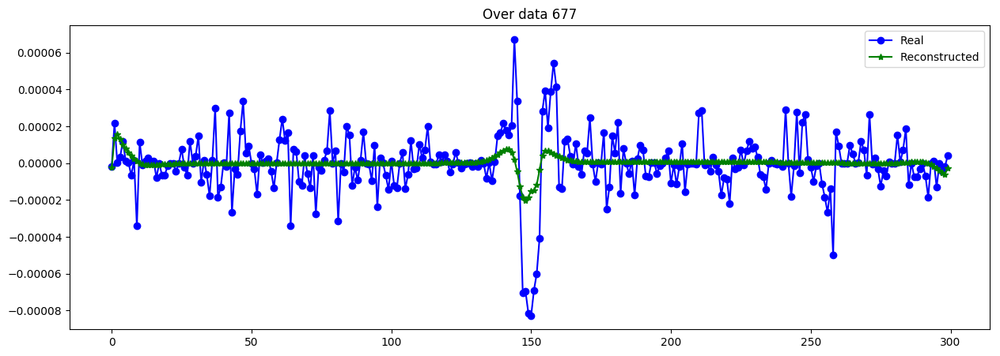

----------------------------------------------------------------
Real scale = 30001.862310
Pred scale = 76413.148438


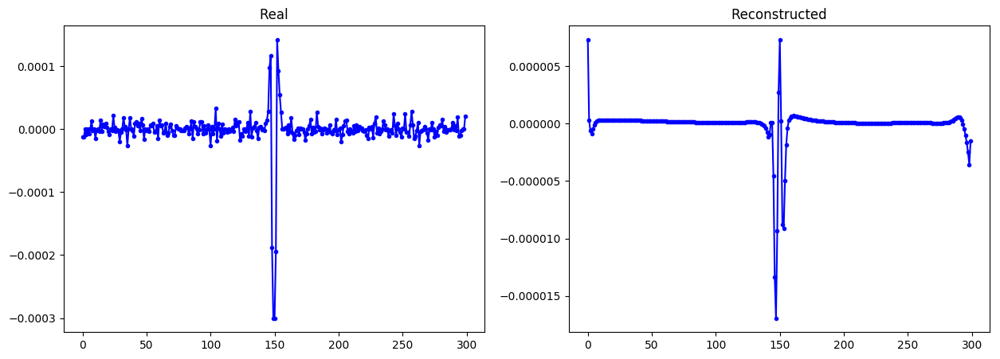

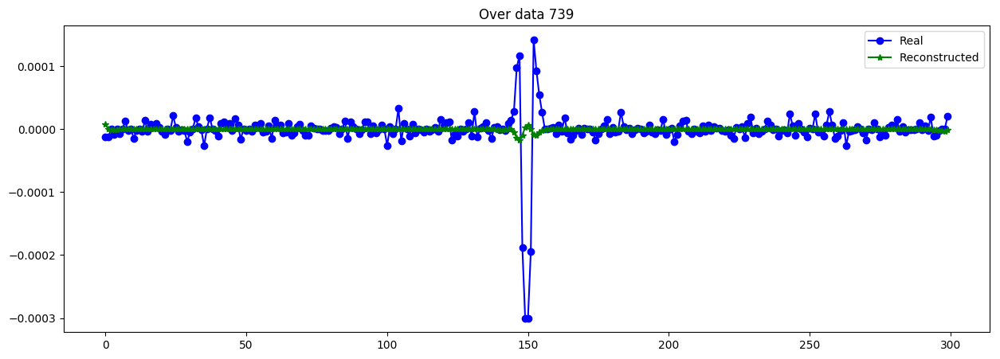

----------------------------------------------------------------
Real scale = 26867.779276
Pred scale = 32250.904297


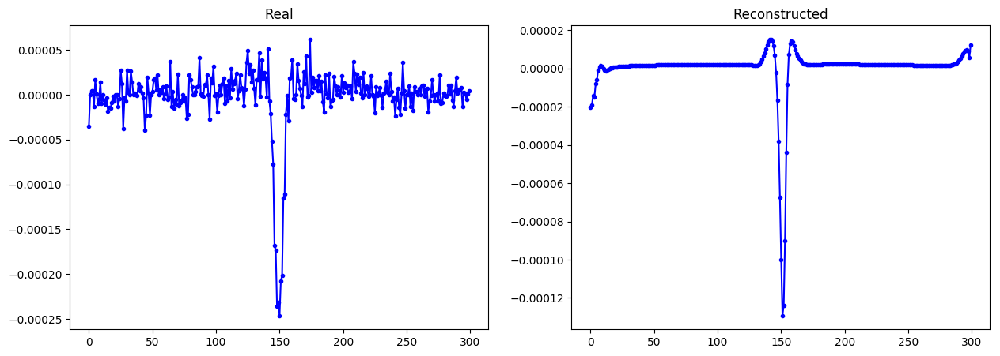

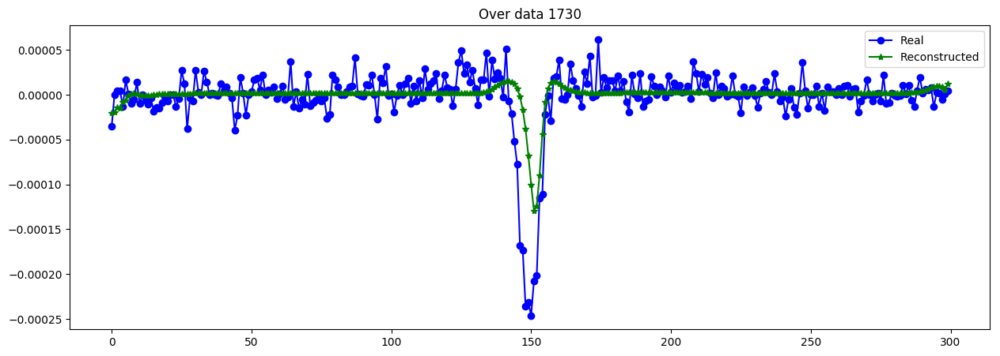

----------------------------------------------------------------
Real scale = 64368.928502
Pred scale = 88639.109375


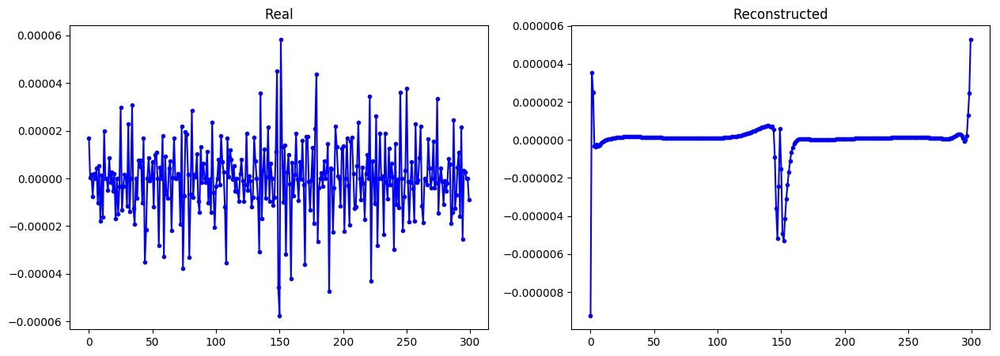

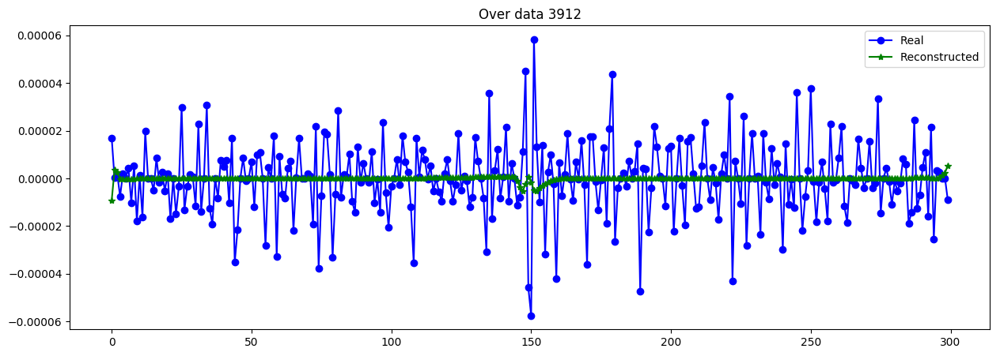

----------------------------------------------------------------
Real scale = 11588.331000
Pred scale = 28779.000000


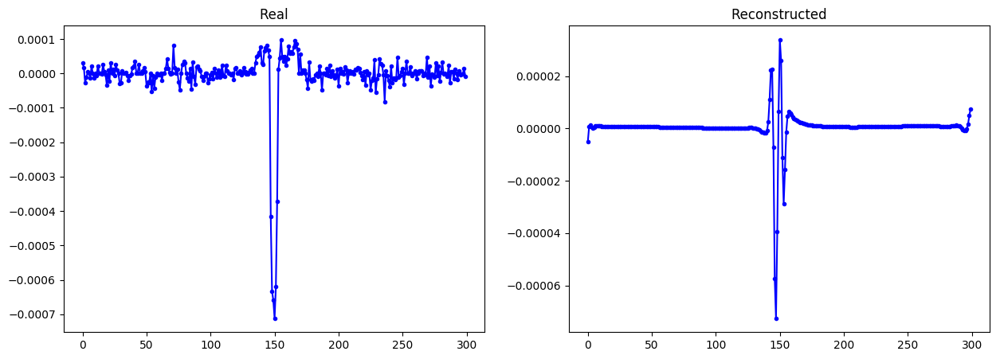

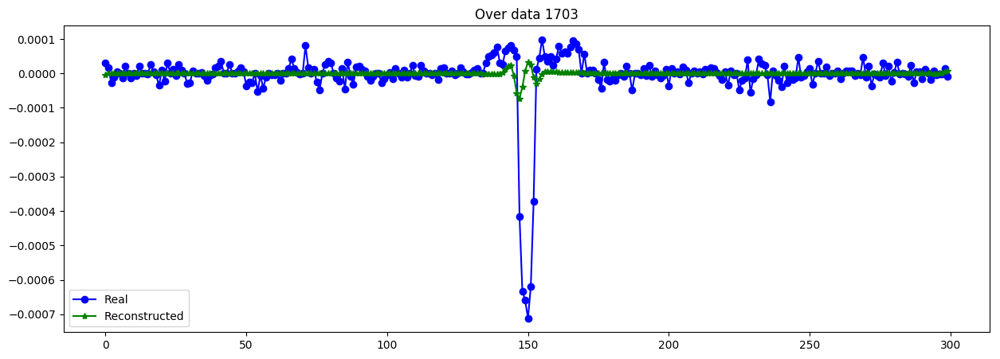

----------------------------------------------------------------


In [23]:
evaluate_reconst(X_data[:N_trans,:]*Sinv_data[:N_trans,None], X_data_CVAE*Sinv_data_hat[:N_trans,None])

evaluate_reconst(X_data[:N_trans,:]*Sinv_data[:N_trans,None], X_data_CVAE*Sinv_data[:N_trans,None])
print("MSE de escala escalado= ",mean_squared_error(Sinv_data[:N_trans],Sinv_data_hat)*(1/Sinv_std)**2)

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15, s=[Sinv_data[:N_trans],Sinv_data_hat]) #as MA-4

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


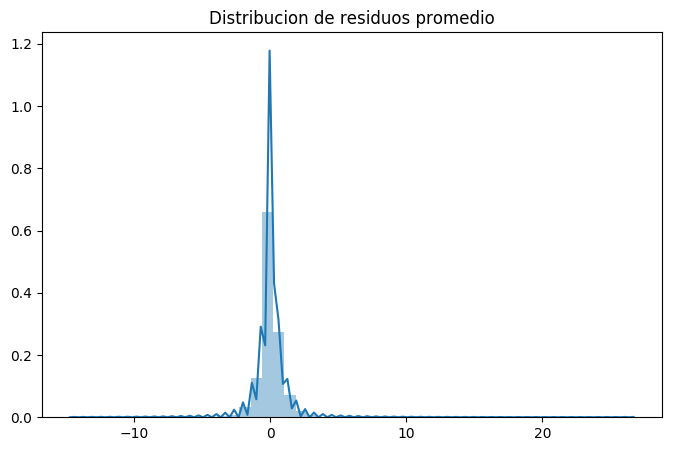

MSE      =  0.8796103116711402
RMSE (+-)=  0.9130729468231391
MAE  (+-)=  0.5528490254191792
--------- Smoothness ------------
AutoCorr lag-one =  0.70130575
Diff MEAN =  0.0659714
Diff STD =  0.34525266
--------- Smoothness ------------
----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


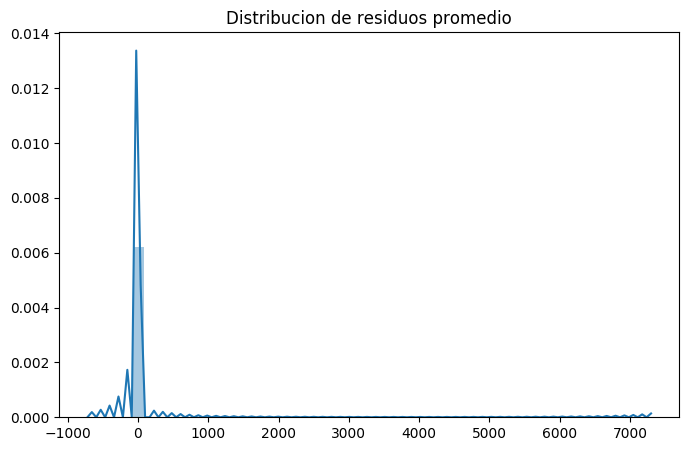

MSE      =  833.0675682424927
RMSE (+-)=  8.532281949716616
MAE  (+-)=  2.322427812434493
--------- Smoothness ------------
AutoCorr lag-one =  0.7013057498000189
Diff MEAN =  0.8236712520853903
Diff STD =  4.410318264138866
--------- Smoothness ------------
MSE de escala escalado=  6.627199553646824
Real scale = 81106.372968
Pred scale = 10867.914062


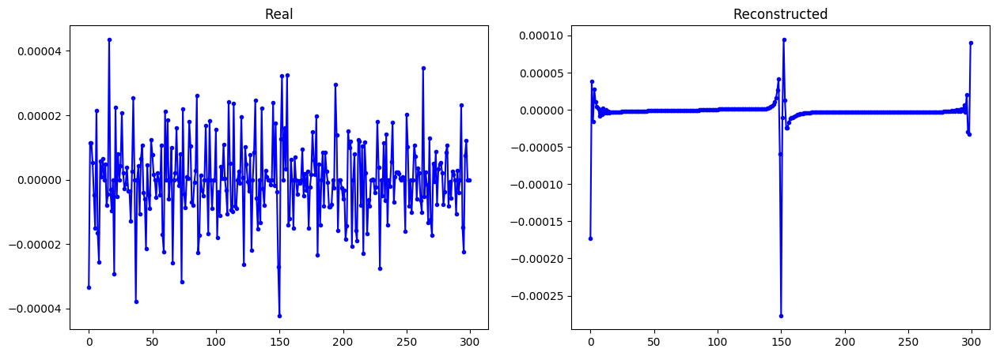

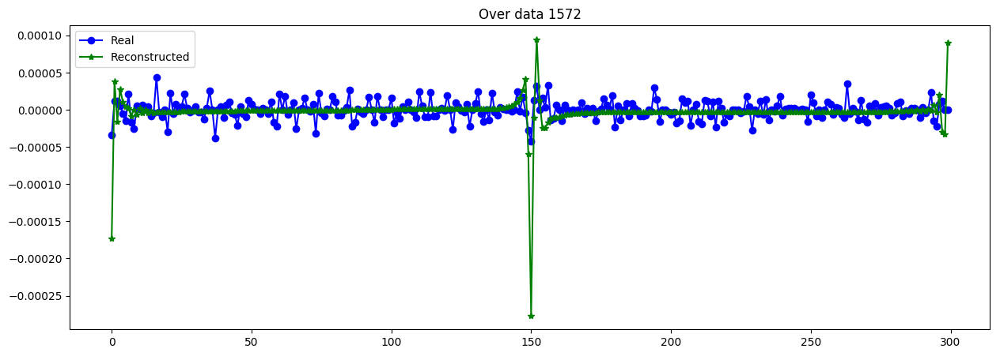

----------------------------------------------------------------
Real scale = 9223.377142
Pred scale = 318106.625000


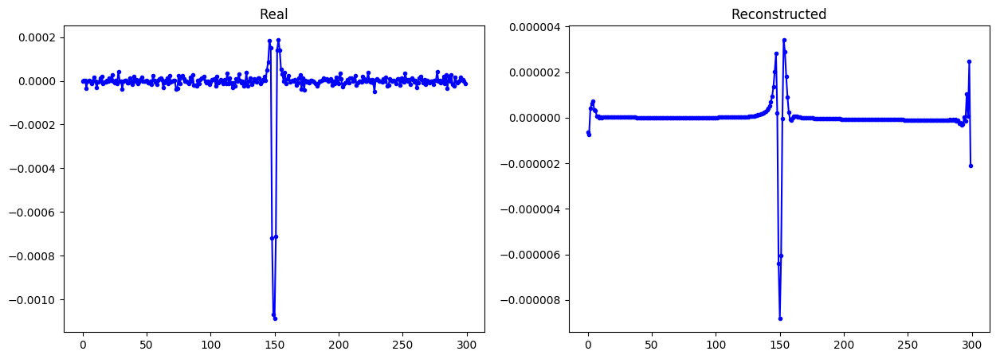

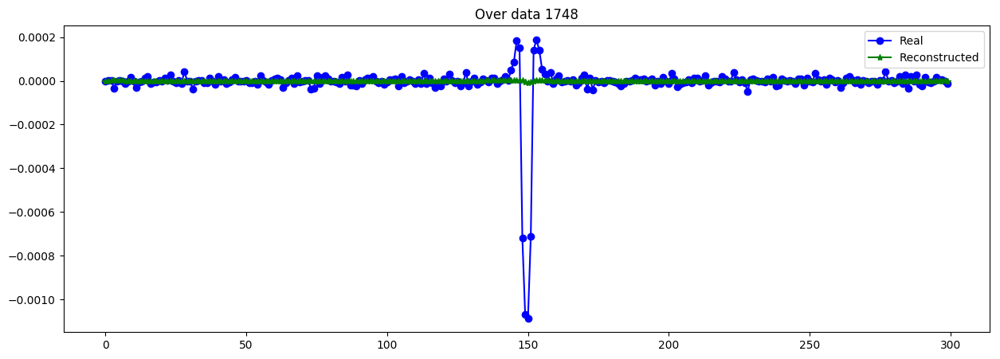

----------------------------------------------------------------
Real scale = 34135.335006
Pred scale = 38188.937500


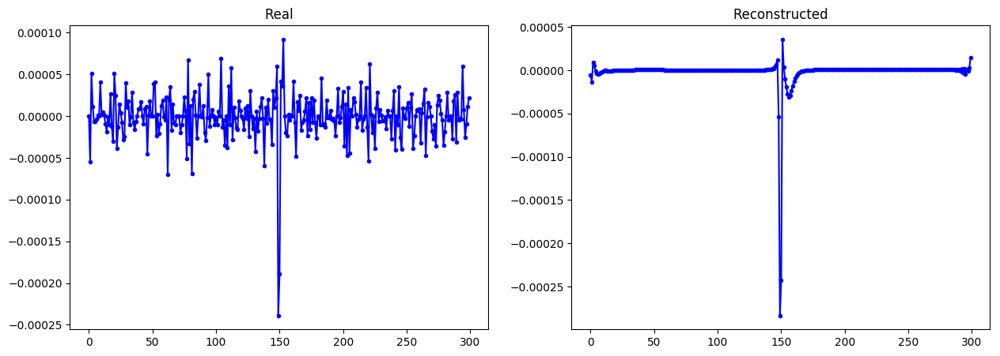

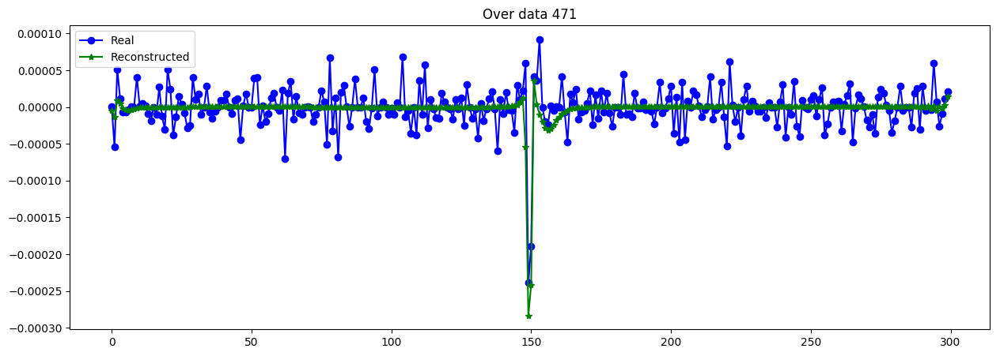

----------------------------------------------------------------
Real scale = 934.036125
Pred scale = 15905.563477


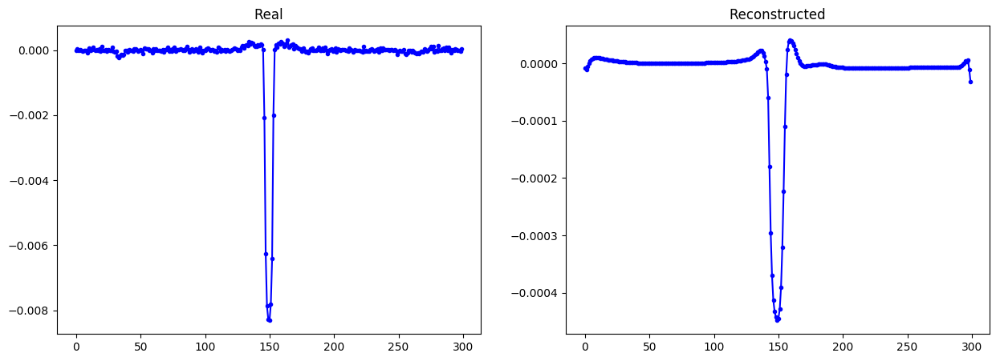

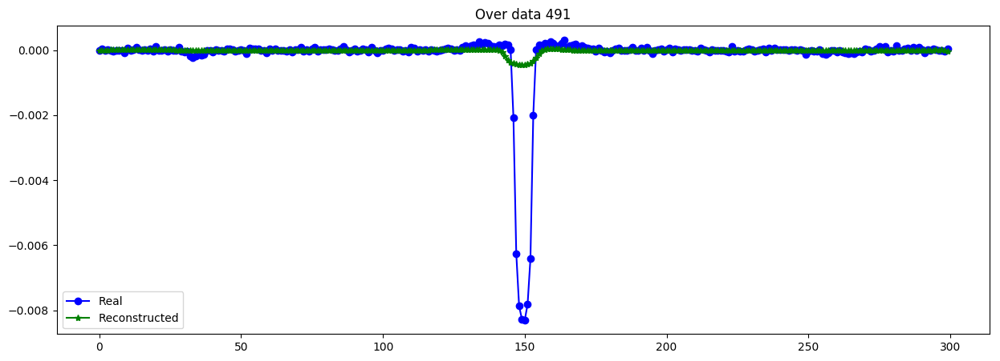

----------------------------------------------------------------
Real scale = 11300.697039
Pred scale = 13426.117188


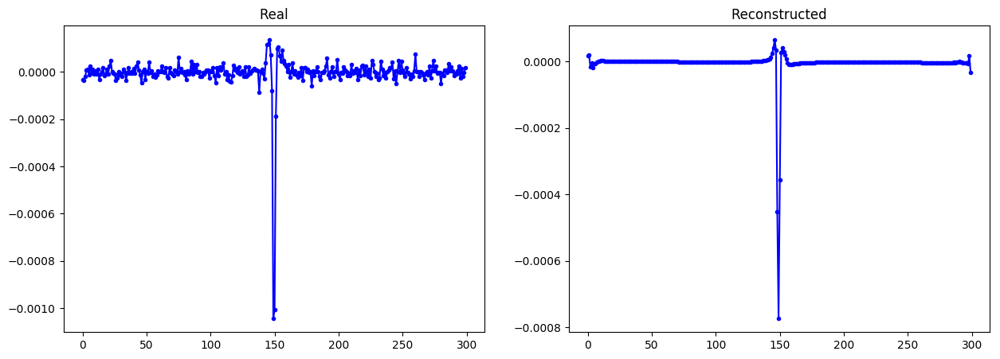

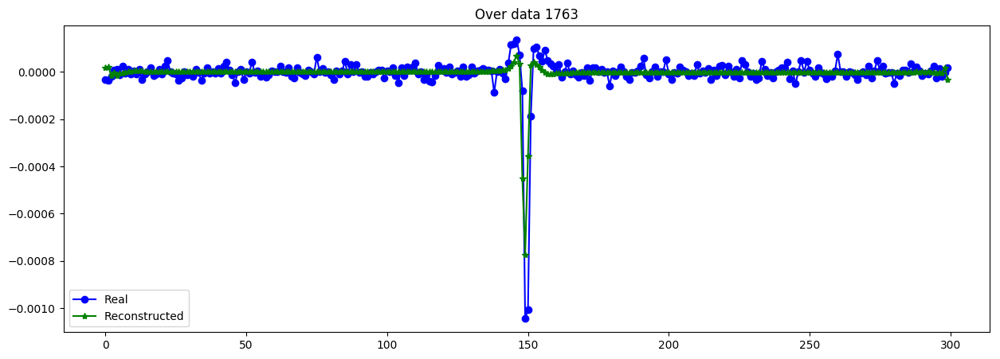

----------------------------------------------------------------
Real scale = 20648.686524
Pred scale = 294133.406250


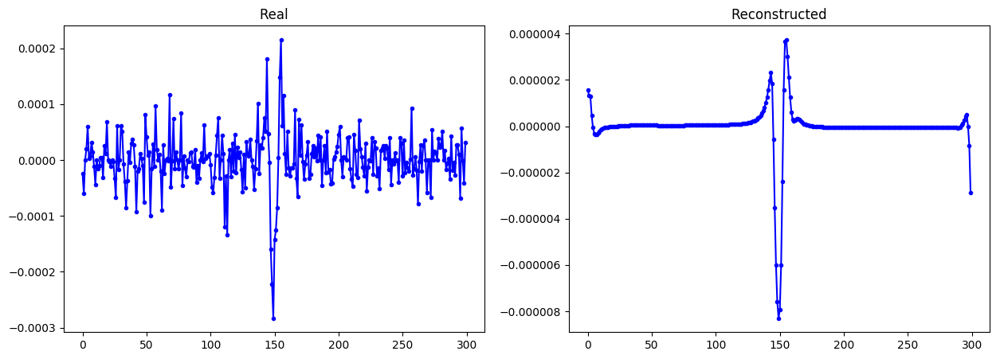

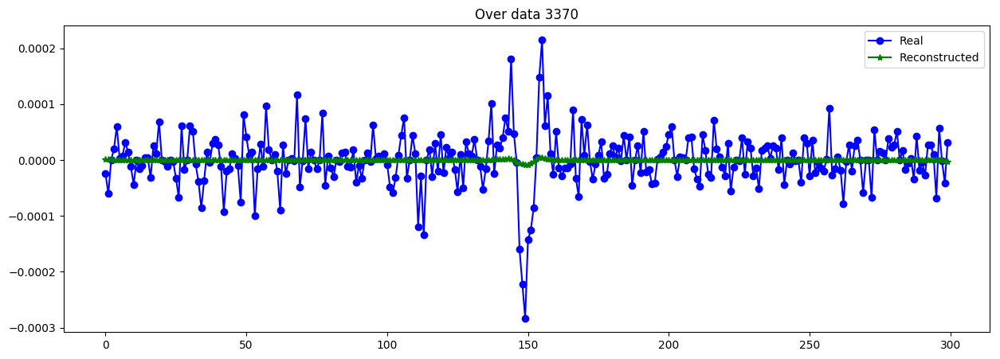

----------------------------------------------------------------
Real scale = 178412.755864
Pred scale = 4018.631104


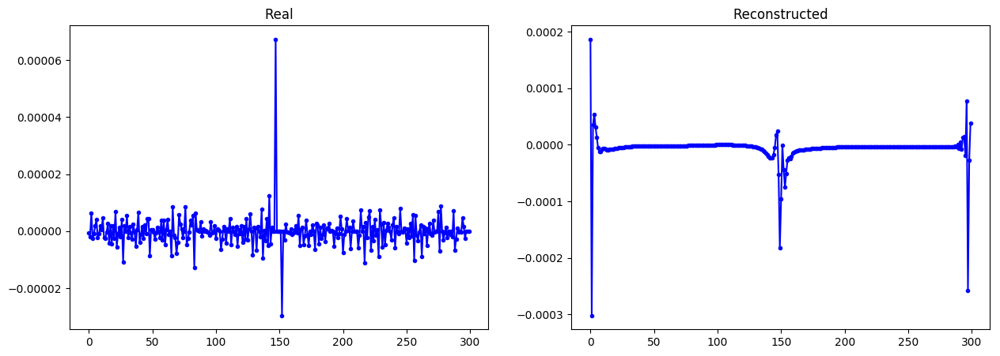

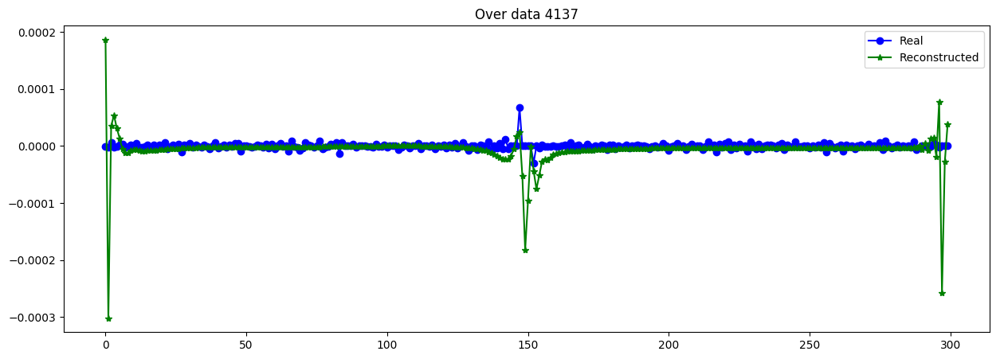

----------------------------------------------------------------
Real scale = 39048.904878
Pred scale = 28913.251953


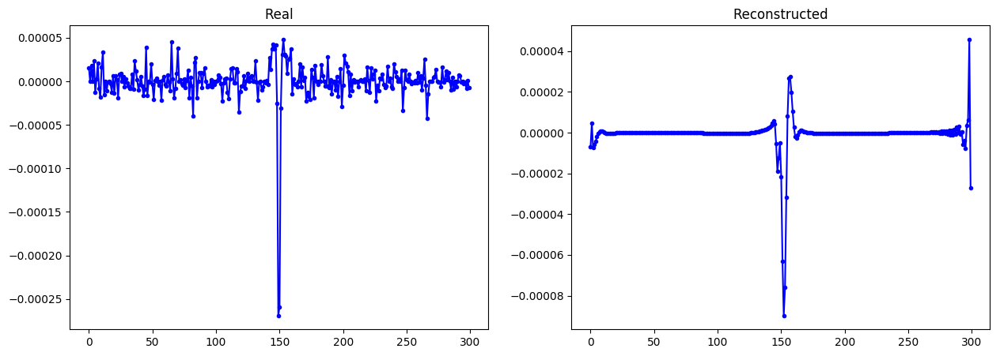

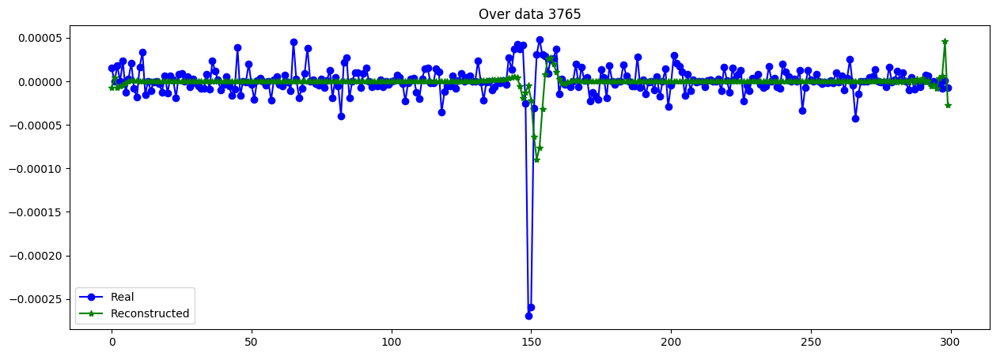

----------------------------------------------------------------
Real scale = 39736.989844
Pred scale = 14008.460938


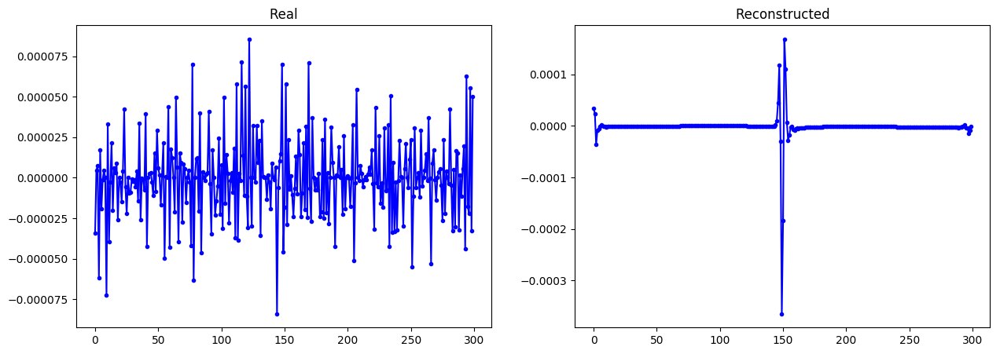

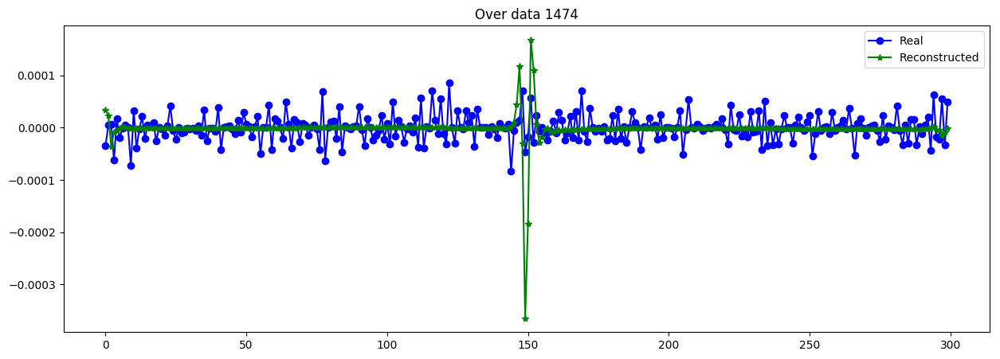

----------------------------------------------------------------
Real scale = 25509.593708
Pred scale = 348601.718750


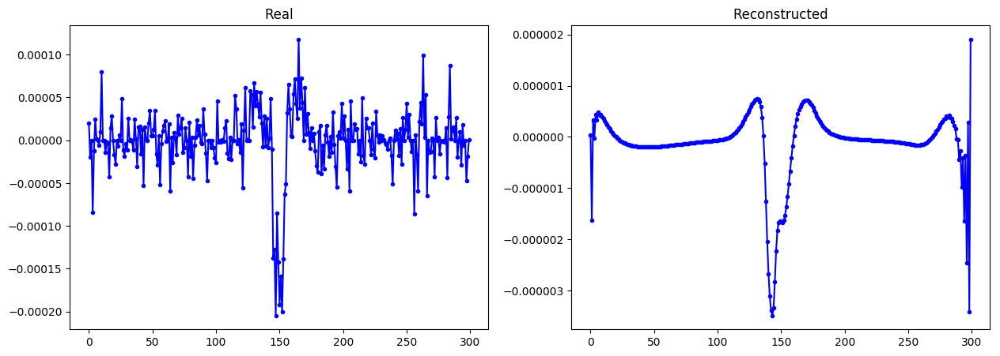

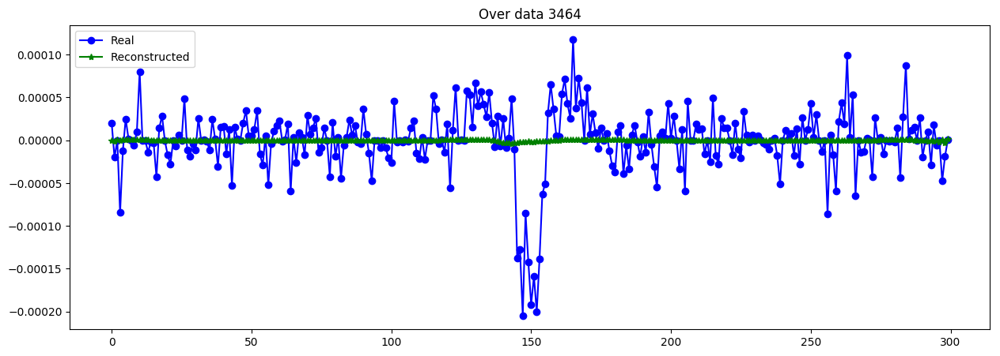

----------------------------------------------------------------
Real scale = 9458.065739
Pred scale = 114049.414062


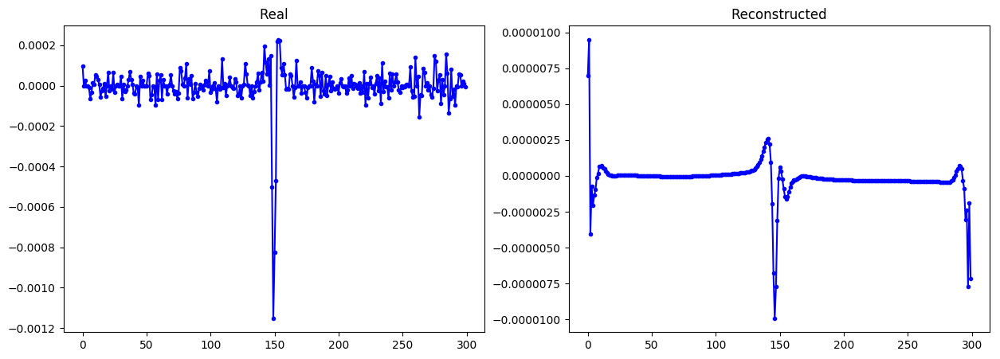

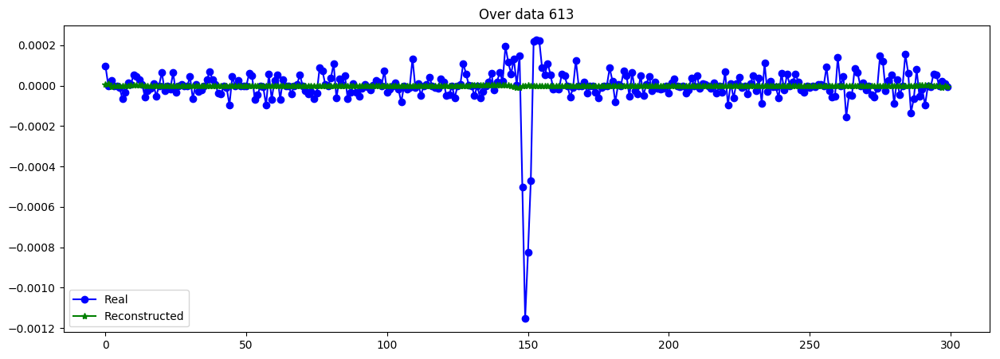

----------------------------------------------------------------
Real scale = 21720.297448
Pred scale = 24306.316406


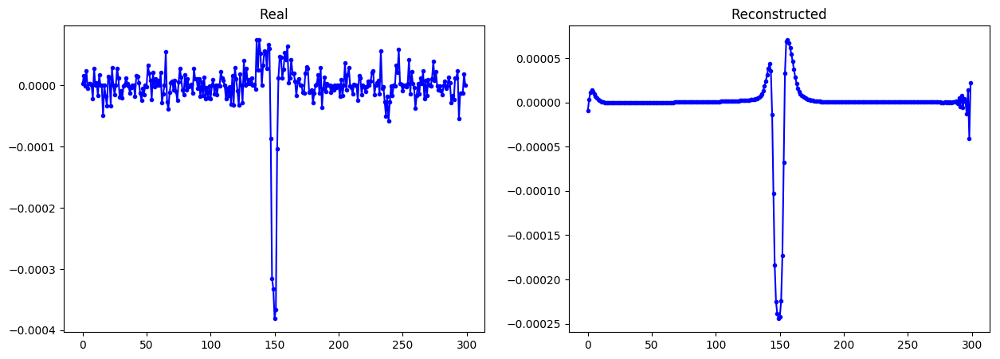

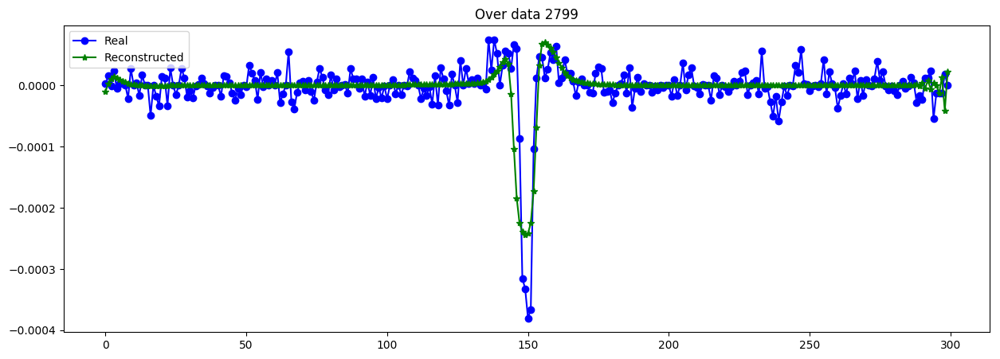

----------------------------------------------------------------
Real scale = 397231.171549
Pred scale = 9218.674805


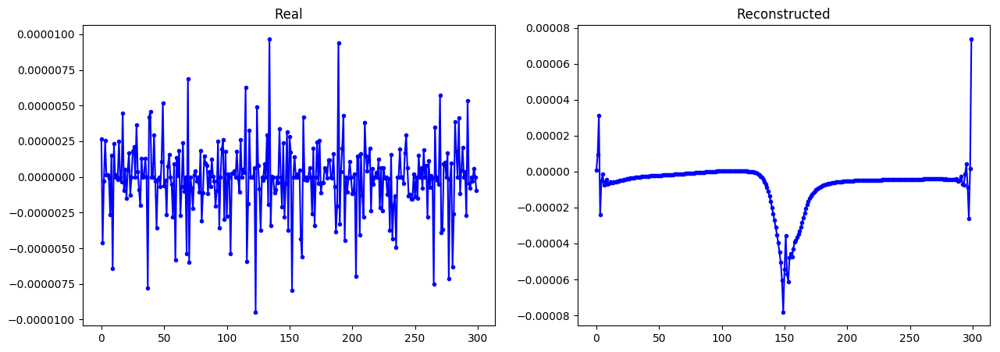

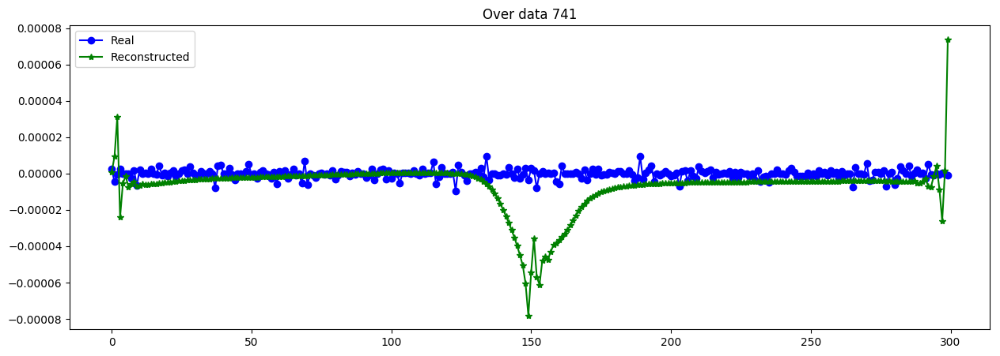

----------------------------------------------------------------
Real scale = 19546.284930
Pred scale = 83619.695312


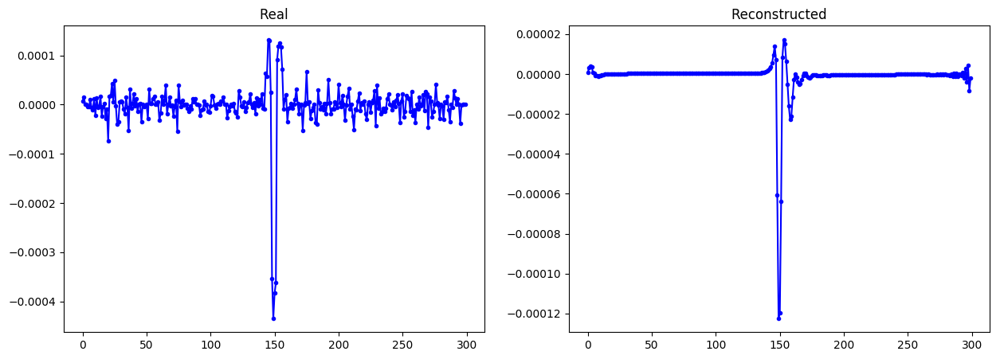

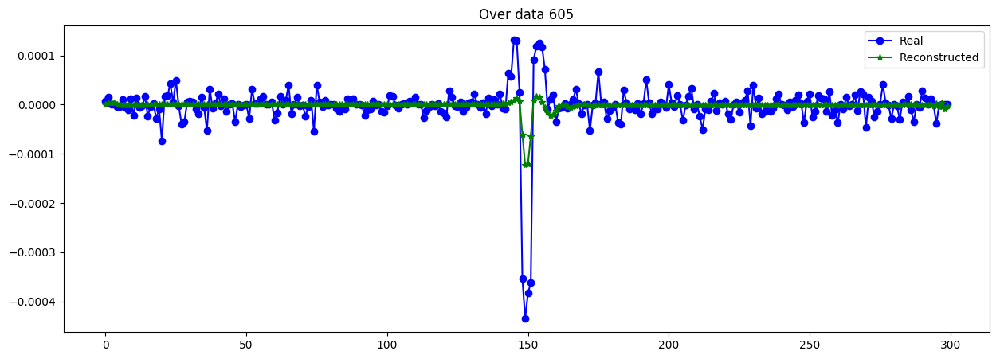

----------------------------------------------------------------
Real scale = 25444.174584
Pred scale = 16185.743164


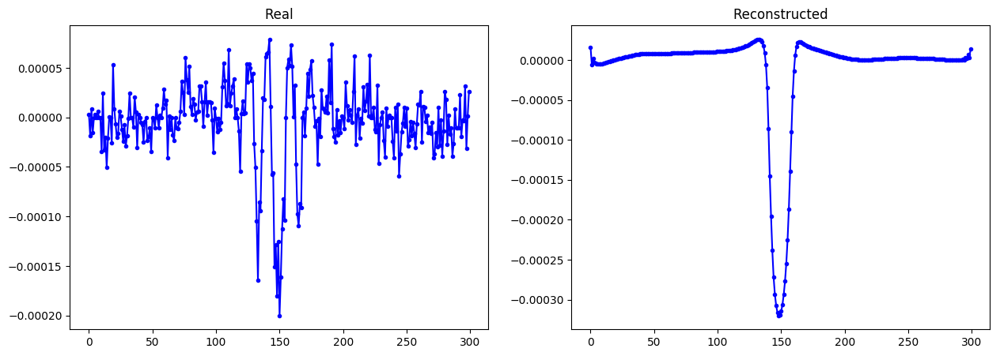

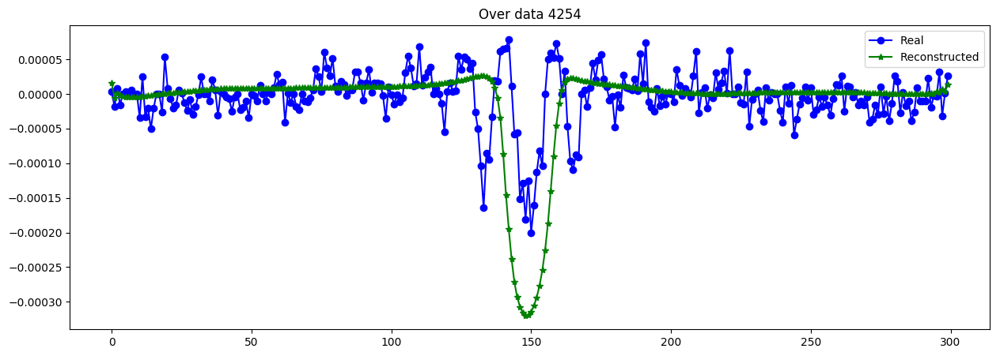

----------------------------------------------------------------


In [34]:
evaluate_reconst(X_data[:N_trans,:]*Sinv_data[:N_trans,None], X_data_CVAE*Sinv_data_hat[:N_trans,None])

evaluate_reconst(X_data[:N_trans,:]*Sinv_data[:N_trans,None], X_data_CVAE*Sinv_data[:N_trans,None])
print("MSE de escala escalado= ",mean_squared_error(Sinv_data[:N_trans],Sinv_data_hat)*(1/Sinv_std)**2)

plot_n_lc(X_data[:N_trans], X_data_CVAE, n= 15, s=[Sinv_data[:N_trans],Sinv_data_hat]) #as MA-5

In [45]:
## generate random

X_MA = []
for _ in range(N_trans):
    n_sampled = np.random.randint(0, N_trans)
    
    time_i = np.cumsum(X_data_t[n_sampled,:,0])
    
    #Simular MA
    sim_dat = {v: df_meta_transit.iloc[n_sampled][v] for v in MA_sim_names if v != "Inclination" and v!= "T0"} #get metadata
    sim_dat["T0"] = time_i[int(np.round(len(time_i)/2))] #trabajando con folds global ...
    sim_dat["Inclination"] = df_meta_transit.iloc[n_sampled]["Comp_I"]
    x_MA = simulate_MA(time_i, sim_dat, plot_m=False)-1
    X_MA.append(x_MA)
X_MA = np.asarray(X_MA)
X_MA.shape

ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.650637,17.325318,0.027,8.5,6.58,0.973,0.271,0.322


ERROR GENERACION DE CURVA:  Object does not transit the star.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.875197,0.437599,0.004,2.175,27.48,1.004,0.413,0.26


ERROR GENERACION DE CURVA:  Object does not transit the star.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.875197,0.437599,0.004,2.175,27.48,1.004,0.413,0.26


(4317, 300)

,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.529122,4.264561,0.017,16.44,2.11,0.606,0.469,0.224


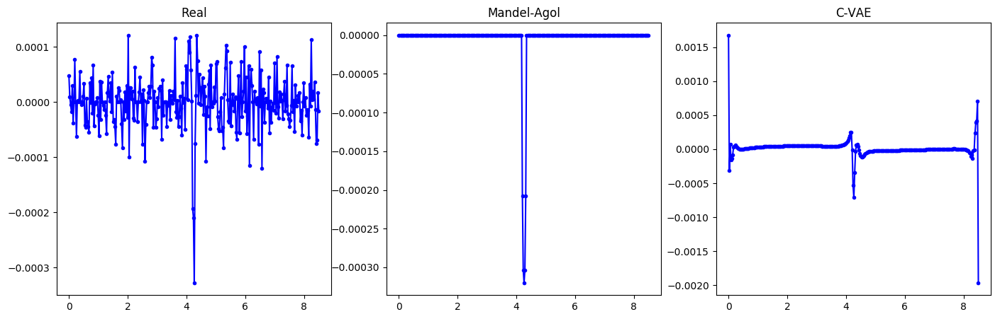

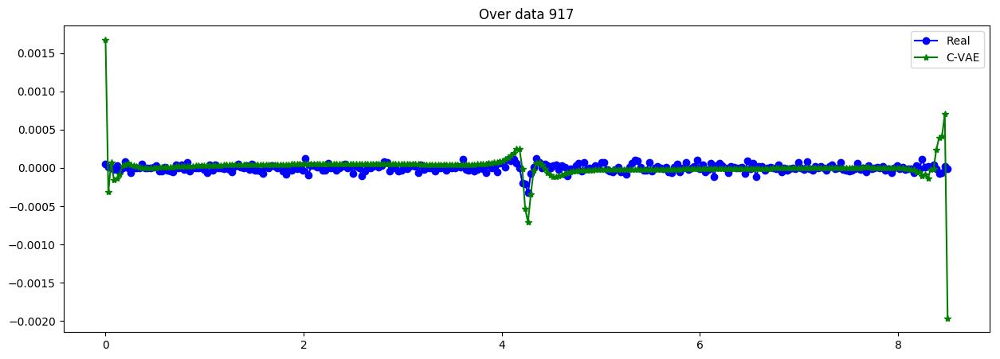

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.244916,2.622458,0.005,4.849,0.22,0.019,0.373,0.279


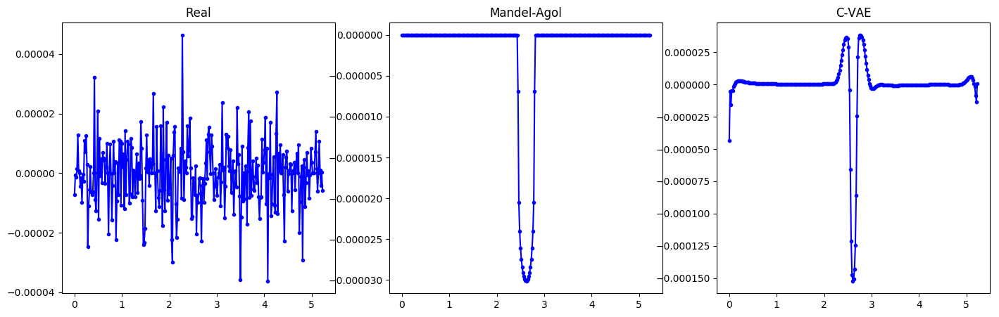

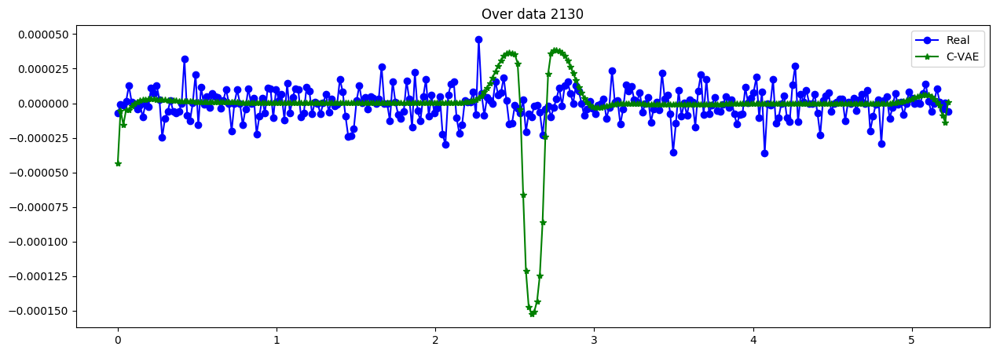

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.296556,2.648278,0.011,9.7,2.19,0.37,0.329,0.302


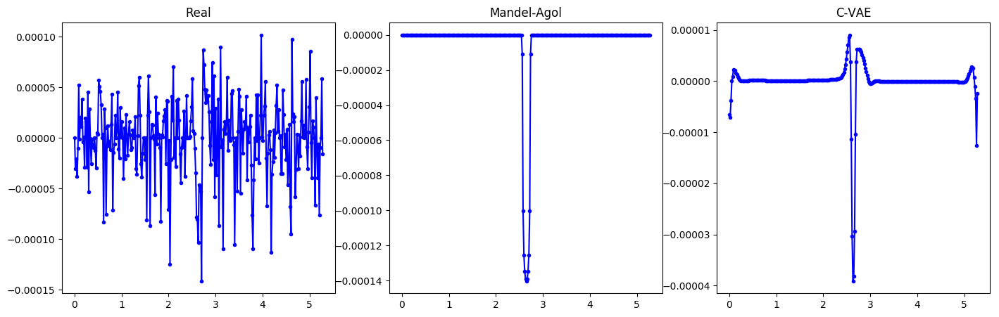

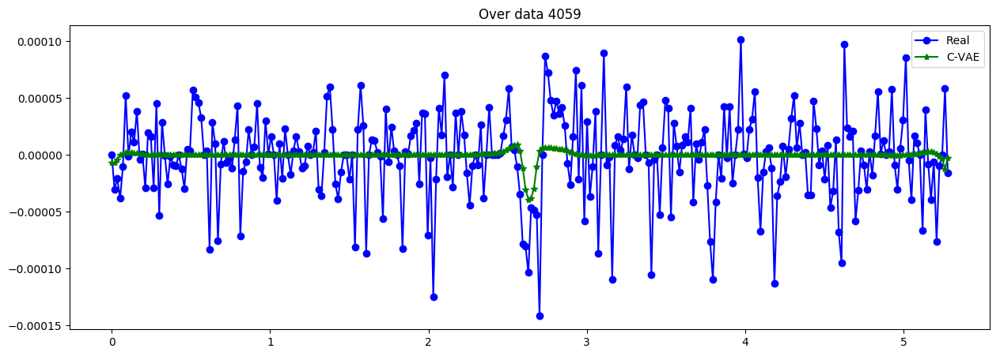

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.787263,6.893631,0.01,7.65,6.91,0.921,0.421,0.257


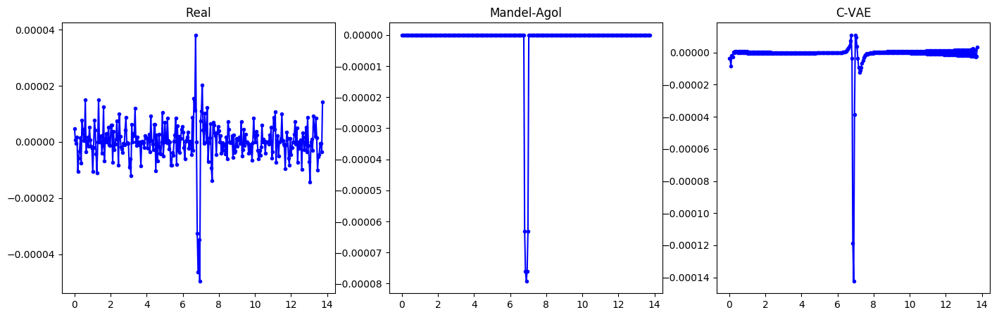

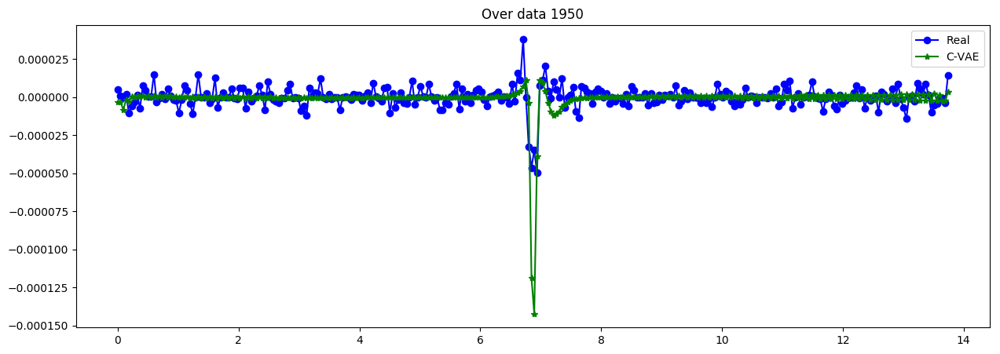

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.039047,0.519523,0.004,4.736,1.16,0.096,0.393,0.268


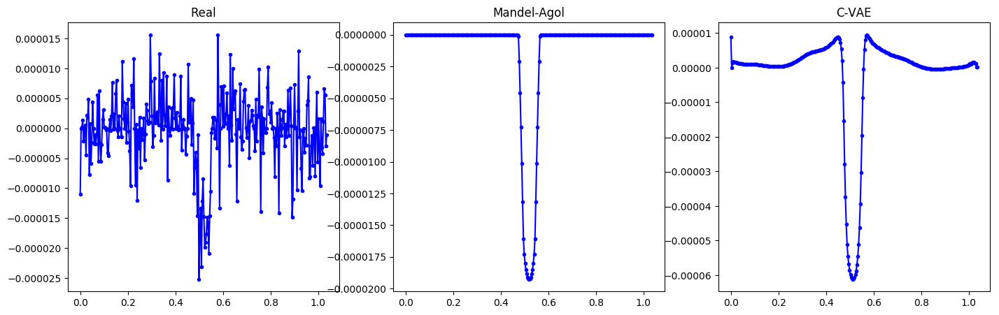

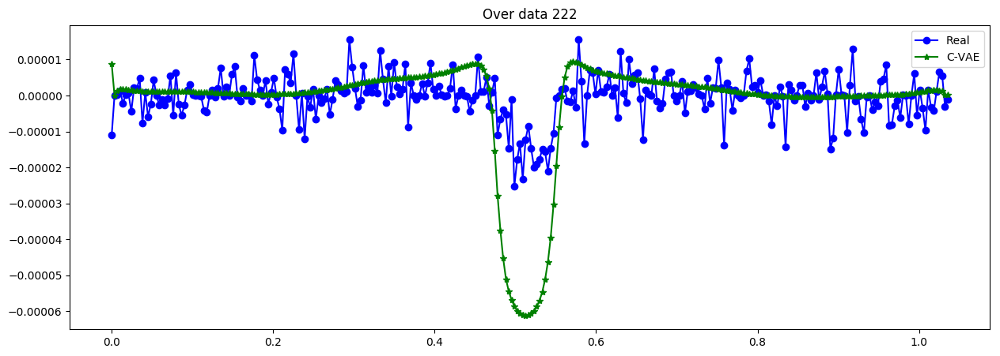

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.647545,3.323772,0.016,25.6,0.53,0.235,0.366,0.284


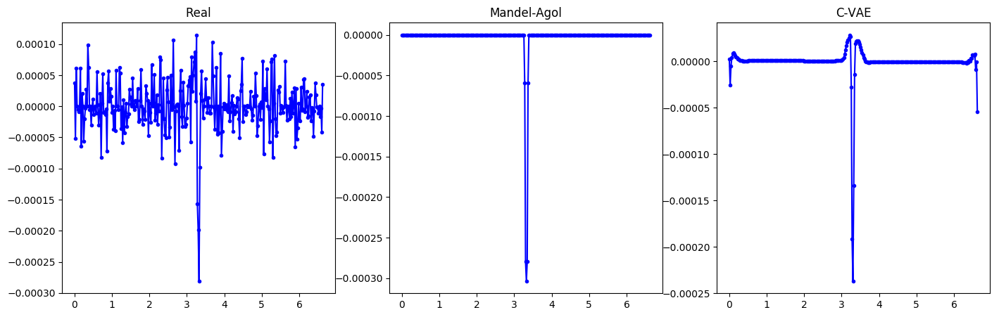

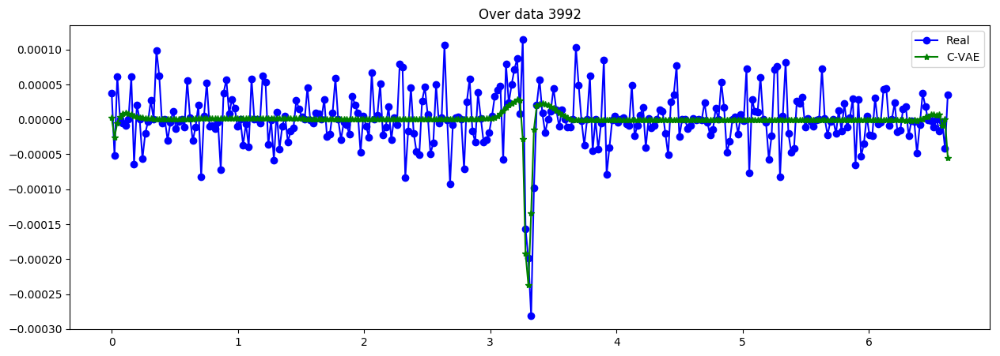

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.583521,2.29176,0.056,13.672,0.19,0.045,0.393,0.268


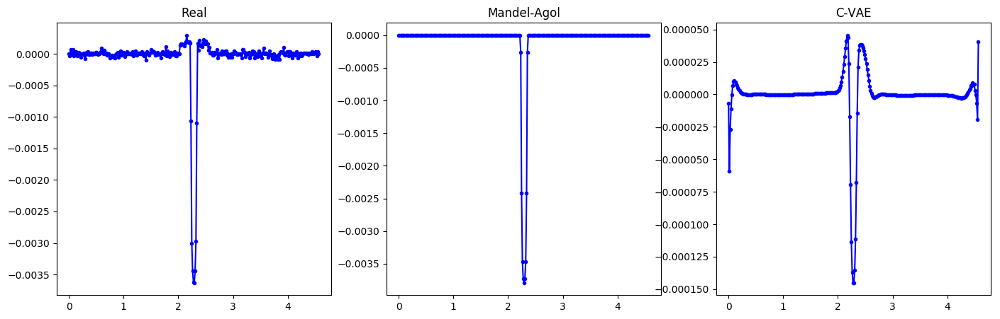

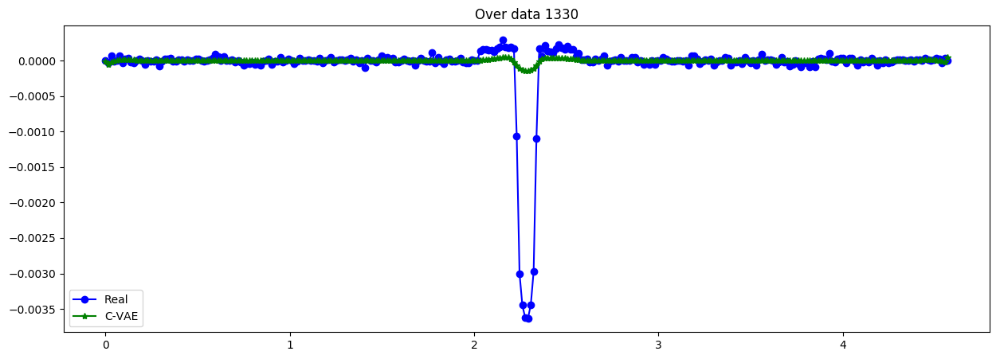

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.460565,6.230282,0.011,24.65,0.03,0.015,0.46,0.229


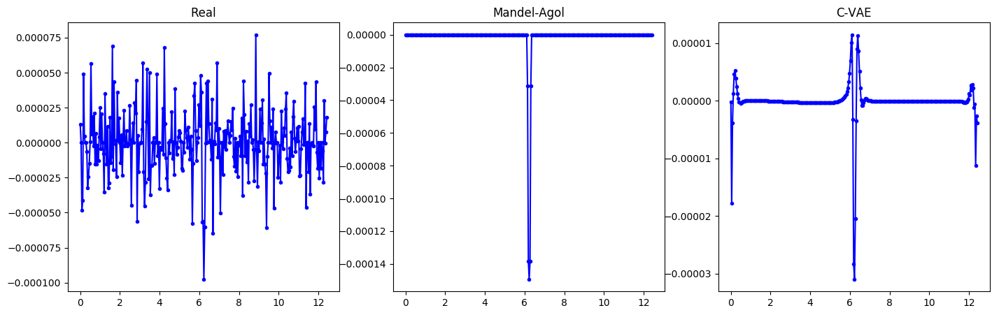

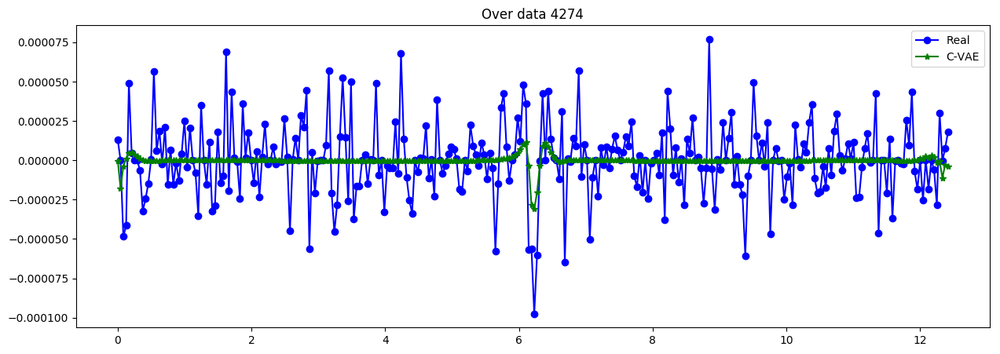

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.925408,10.462704,0.01,23.32,0.49,0.201,0.41,0.26


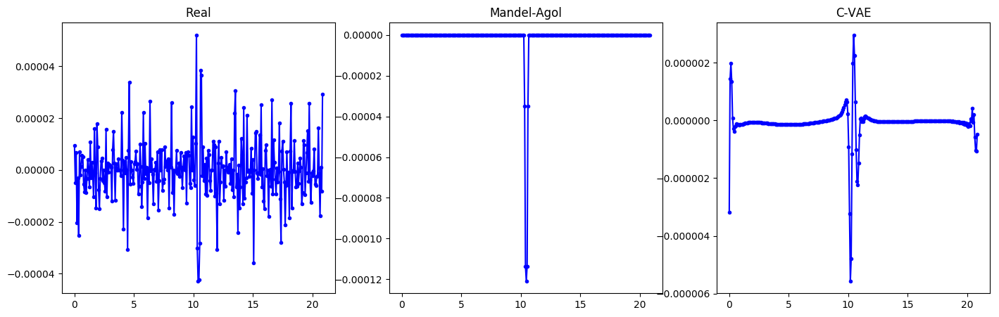

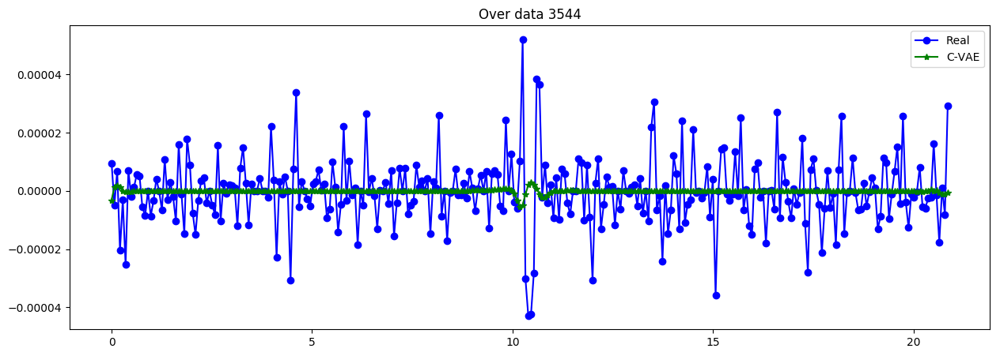

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.717907,3.858953,0.016,32.37,0.2,0.112,0.277,0.401


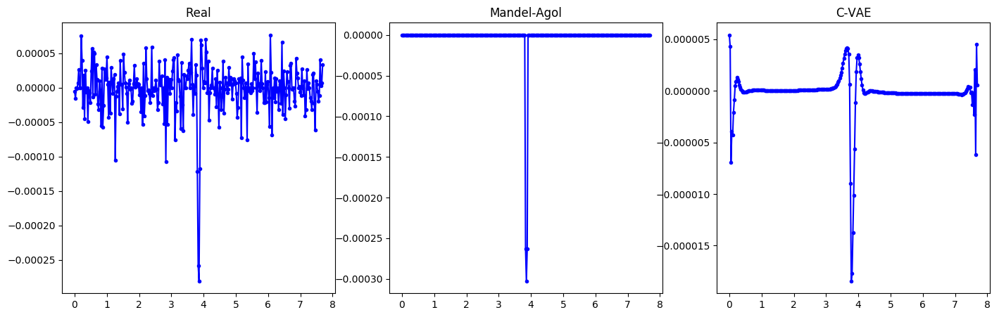

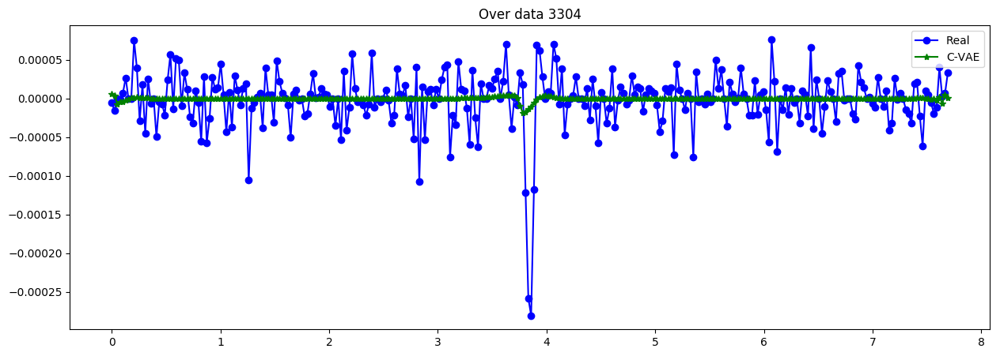

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.606906,2.303453,0.011,8.37,1.39,0.203,0.421,0.252


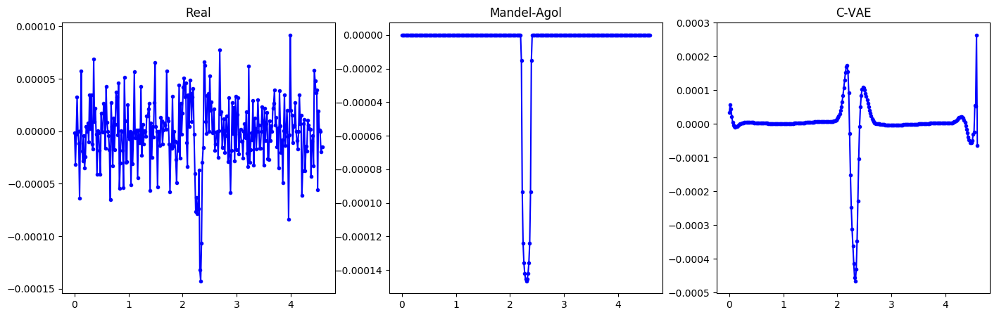

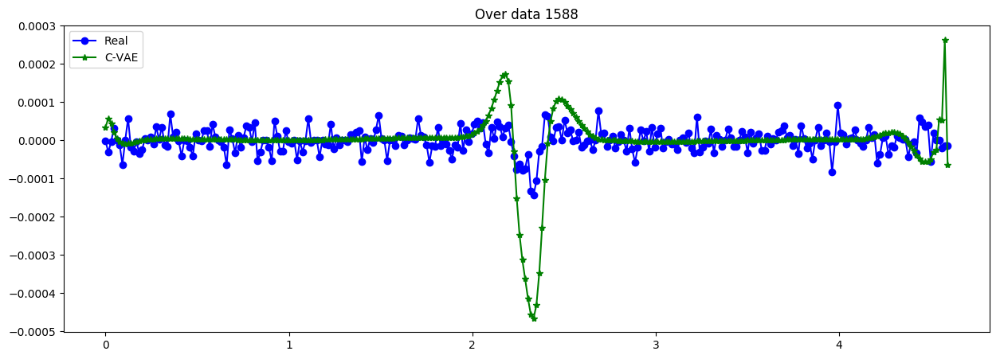

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.067925,10.033962,0.023,16.73,2.91,0.849,0.345,0.292


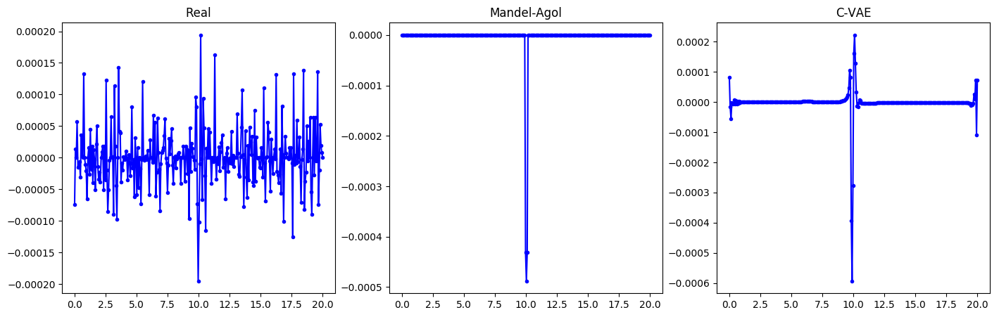

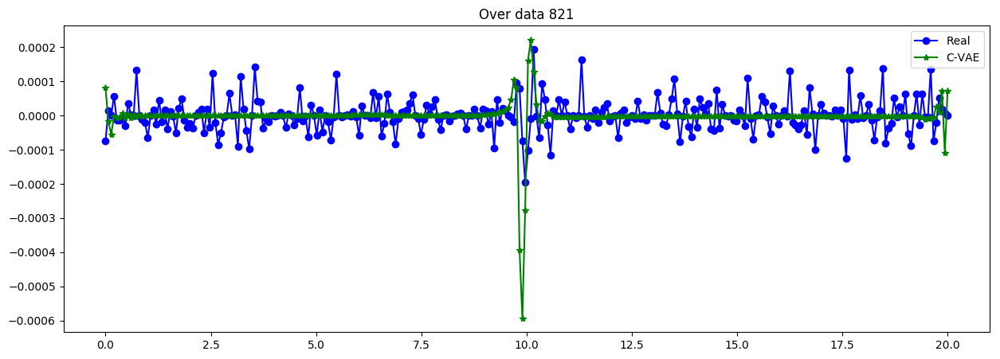

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.125806,6.062903,0.019,17.59,2.62,0.805,0.455,0.233


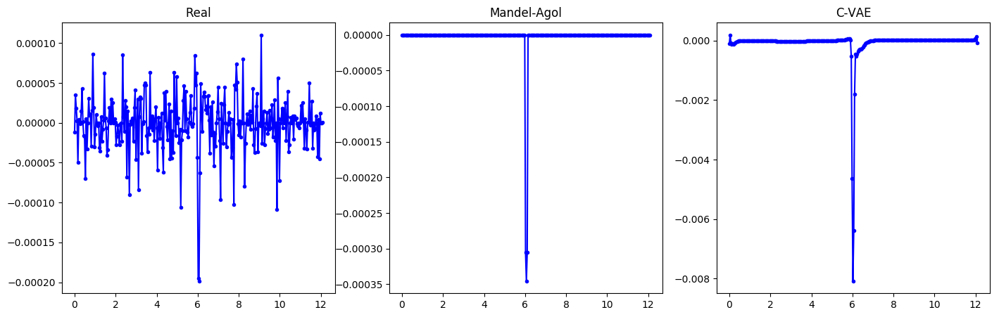

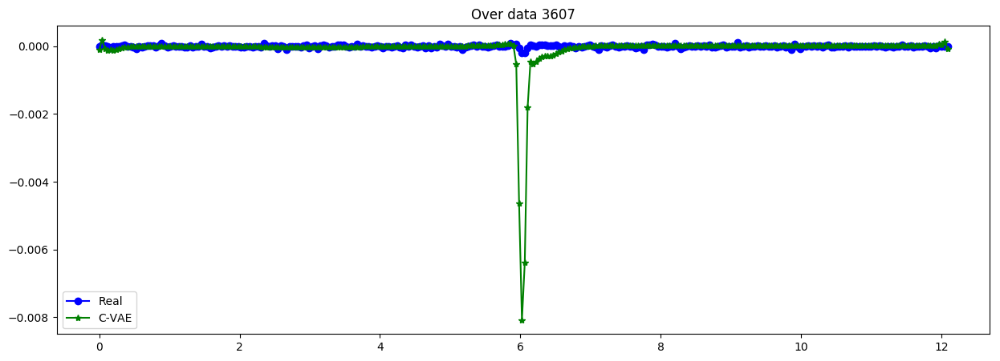

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.208529,0.604264,0.012,7.02,0.32,0.039,0.345,0.292


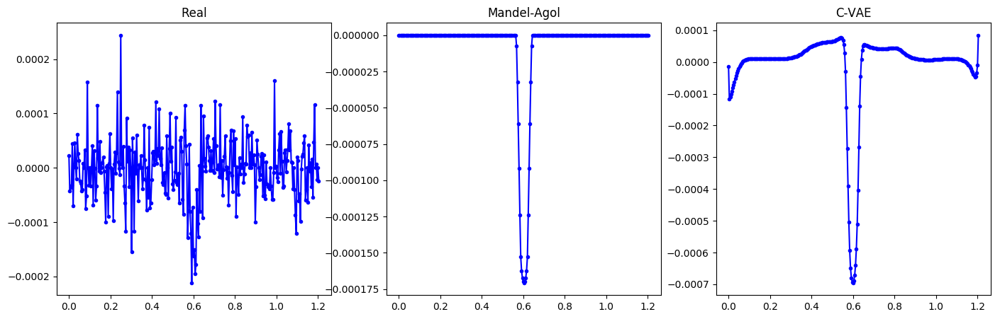

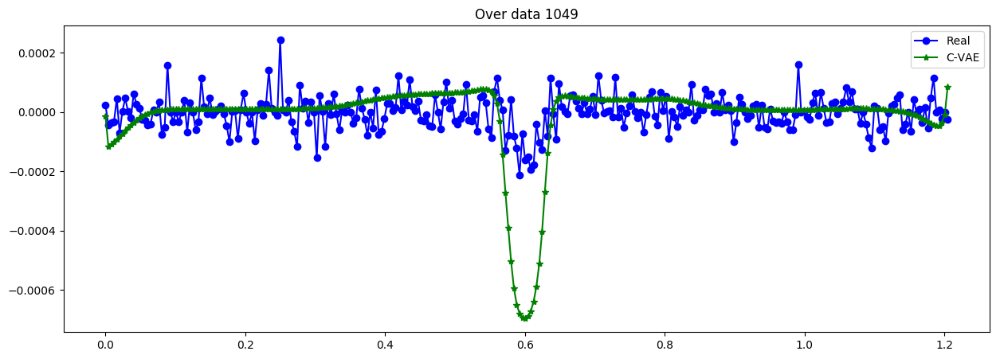

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,144.551628,72.275814,0.035,35.5,1.43,0.887,0.434,0.243


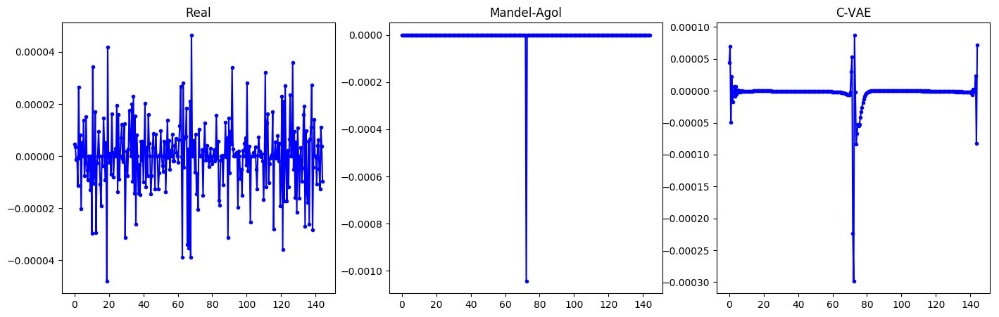

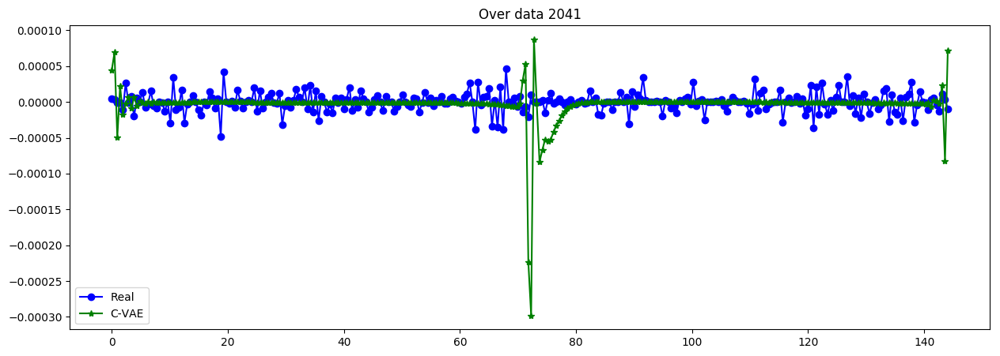

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.136941,8.56847,0.017,20.762,0.08,0.03,0.324,0.303


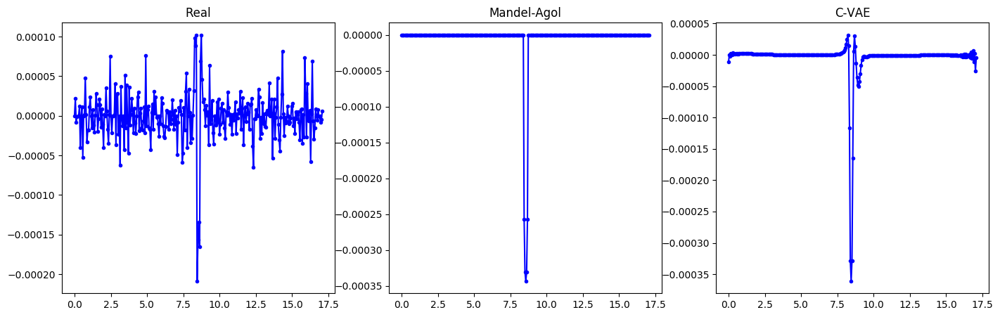

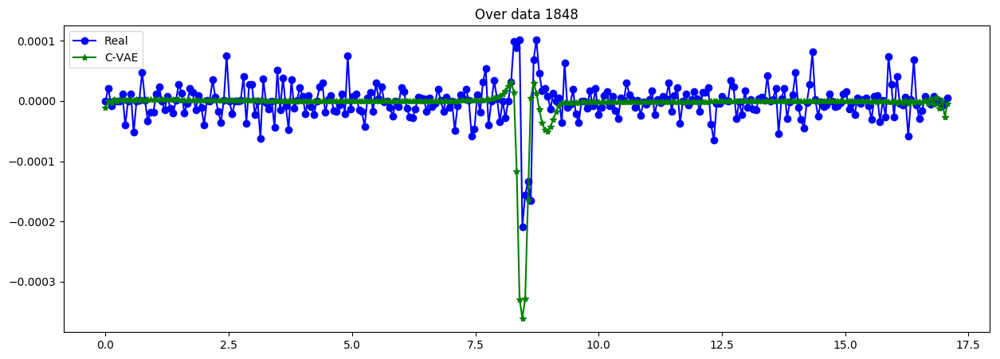

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.247549,1.623774,0.013,9.54,1.86,0.31,0.428,0.251


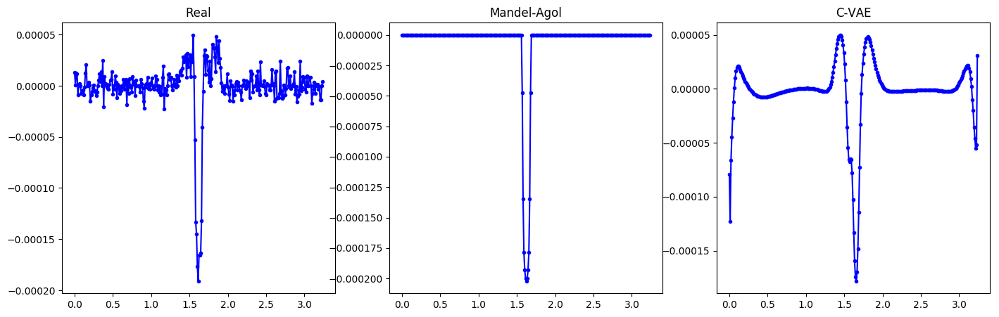

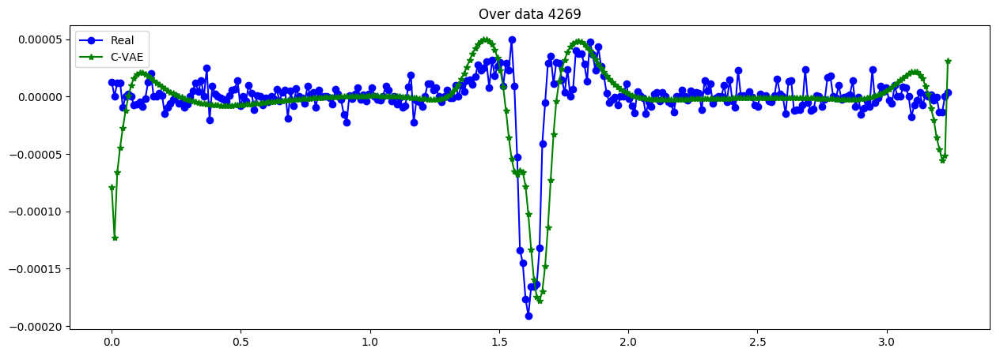

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.360597,4.680299,0.016,13.92,3.31,0.802,0.386,0.271


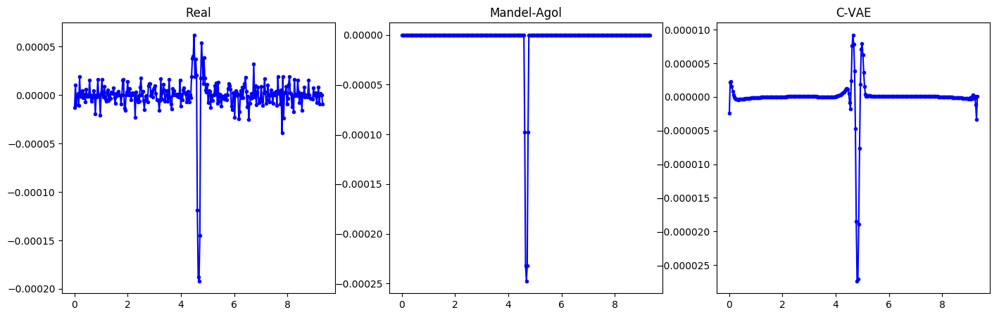

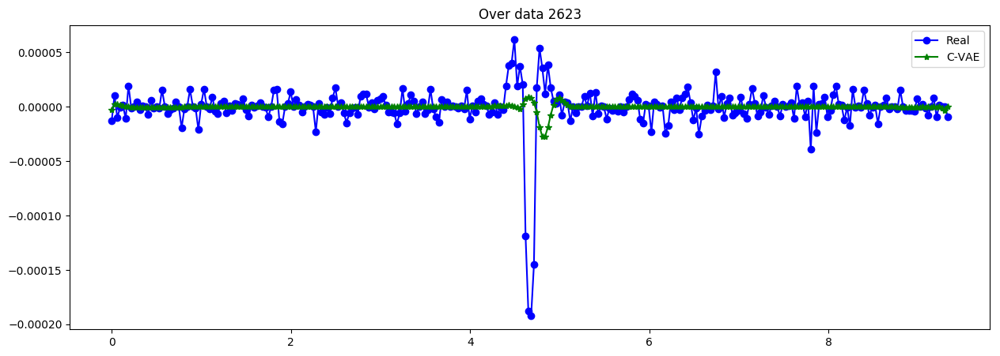

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.423936,8.711968,0.031,12.22,4.35,0.927,0.345,0.292


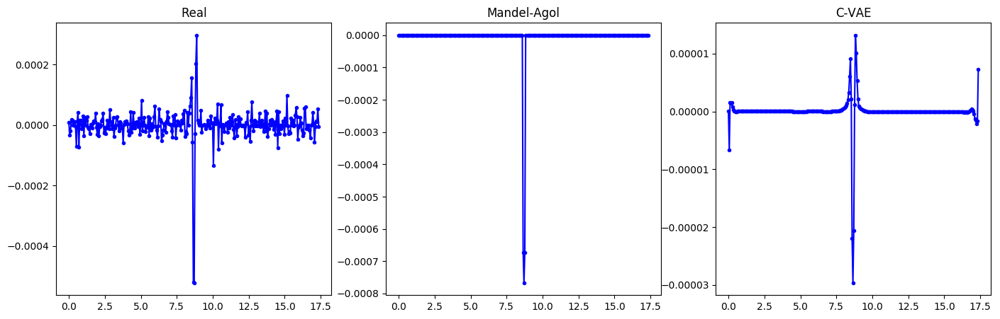

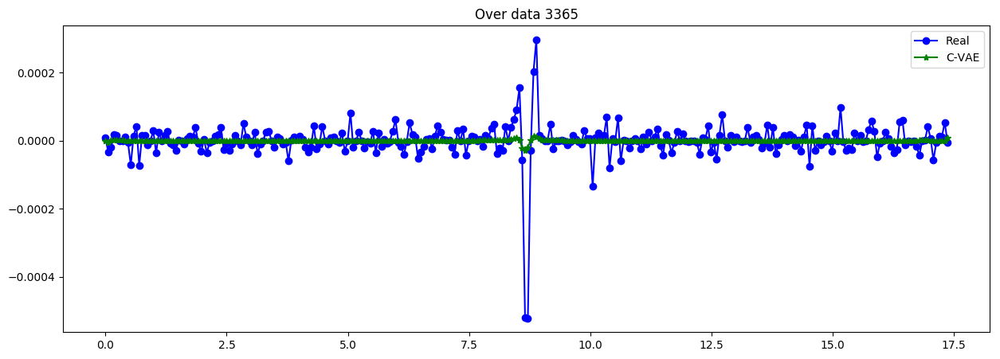

----------------------------------------------------------------


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.578781,1.78939,0.096,10.287,0.44,0.079,0.469,0.224


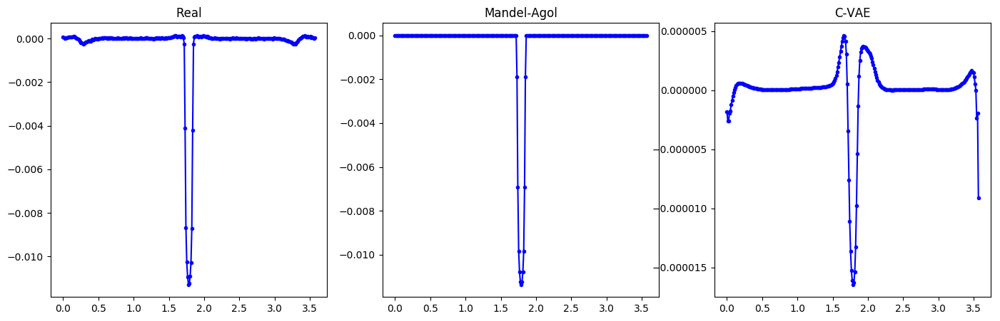

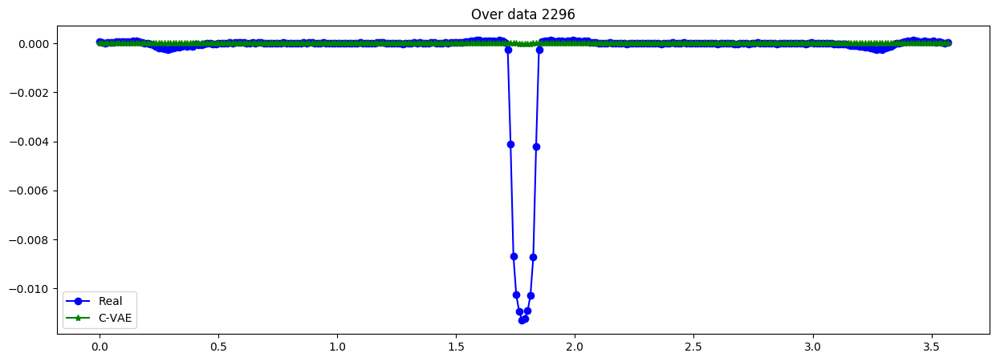

----------------------------------------------------------------


In [54]:
## generate random
n = 20

for _ in range(n):
    n_sampled = np.random.randint(0, N_trans)
    
    time_i = np.cumsum(X_data_t[n_sampled,:,0])

    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True,figsize= (17,5))
    ax1.plot(time_i, X_data[n_sampled], 'b.-')
    ax1.set_title("Real")
    
    #Simular MA
    sim_dat = {v: df_meta_transit.iloc[n_sampled][v] for v in MA_sim_names if v != "Inclination" and v!= "T0"} #get metadata
    sim_dat["T0"] = time_i[int(np.round(len(time_i)/2))] #trabajando con folds global ...
    sim_dat["Inclination"] = df_meta_transit.iloc[n_sampled]["Comp_I"]
    x_MA = simulate_MA(time_i, sim_dat)-1
    
    ax2.plot(time_i, x_MA, 'b.-')
    ax2.set_title("Mandel-Agol")
    
    #Simular con C_VAE
    z_sampled = np.random.normal(0, 1, size=(1,latent_dim))
    Dtime_i = transform_delta(time_i)[None,:,None]
    #meta_T = Ystd_transit[n_sampled][None,:]
    meta_T = Y_transit[n_sampled][None,:]
    x_CVAE = generator.predict([Dtime_i, z_sampled, meta_T] )
    
    ax3.plot(time_i, x_CVAE[0], 'b.-')
    ax3.set_title("C-VAE")
    plt.show()   

    plt.figure(figsize=(15,5))
    plt.plot(time_i, X_data[n_sampled], 'bo-', label="Real")
    plt.plot(time_i, x_CVAE[0], 'g*-', label="C-VAE")
    plt.title("Over data "+str(n_sampled))
    plt.legend()
    plt.show()
    print("----------------------------------------------------------------")